In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import TimeSeriesSplit

In [6]:
data_dict = pd.read_excel('database/20-08-14_EPA_Data_Dictionnary_Campstat.xlsx')
data_dict.rename(columns={data_dict.columns[0]: 'feature', data_dict.columns[1]:'definition'}, inplace=True)
data_dict = data_dict.iloc[1:, :]

# Loading data dictionary

In [7]:
pd.set_option('display.max_colwidth', 0)
pd.set_option('display.max_columns', None)
data_dict

,feature,definition
1,idstay,Internal ID for each booking
2,idstay_to,External ID for a booking coming from a distributor
3,type_stay_lbl,INDIV RESID : stock from a Unit belowing to a owner - INDIV ALLOT : stock from a distributor allotment - INDIV DIRECT : stock directly managed by the campsite
4,resinternet,Internal ID for each booking. Beginning with U means a booking made by phone or on site by the campsite. Beginning with O means a Internet Booking
5,type_guest,Not very use : A = Allotment - N = Individual customer
6,extract_date,Date of the last export (ie creation/modification) of the booking from the PMS. System Date
7,resdate,Date of the booking
8,camping_code,Internal ID for each campsite
9,camping_label,Name of the campsite
10,Région,Region of the Campsite


In [11]:
from pyxlsb import open_workbook as open_xlsb

In [13]:
df = []

with open_xlsb('database/19-01-04_Séjours_2018.xlsb') as wb:
    with wb.get_sheet(1) as sheet:
        for row in sheet.rows():
            df.append([item.v for item in row])

df = pd.DataFrame(df[1:], columns=df[0])

In [14]:
df.head()

,idstay,idstay_to,type_stay_lbl,resinternet,type_guest,extract_date,resdate,camping_code,camping_label,Région,...,region,fidelisation,date_fid,camping_fid,creation_date,segment,scode1,scode2,hebergement_camping_id,hebergement_camping_lbl
0,320-14150,None,INDIV DIRECT,U20130628DEBUR932214355,N,43220.0,43040.0,59.0,TURISCAMPO,Portugal,...,7322,Y,42005.0,100.0,41212.0,DIRECT,Village,Village,999999.0,LOCA - Not Defined
1,320-19097,None,INDIV DIRECT,U20131119GRIME393582153,N,43136.0,42675.0,59.0,TURISCAMPO,Portugal,...,PO381NX,Y,41275.0,59.0,40835.0,DIRECT,Village,Village,999998.0,EMPL - Not Defined
2,320-20471,None,INDIV DIRECT,U20140228HINDL599191284,N,43327.0,43040.0,59.0,TURISCAMPO,Portugal,...,None,Y,42736.0,59.0,40835.0,DIRECT,Village,Village,22.0,Empla. Super Deluxe *** Luz
3,320-22588,None,INDIV DIRECT,U20140528ENGEL311651611,N,43261.0,43040.0,59.0,TURISCAMPO,Portugal,...,49740,Y,43101.0,100.0,40835.0,DIRECT,Village,Village,999998.0,EMPL - Not Defined
4,320-22610,None,INDIV DIRECT,U20140529SRCOL428189086,N,43078.0,42675.0,59.0,TURISCAMPO,Portugal,...,None,N,NaN,0.0,39721.0,DIRECT,Village,Village,999999.0,LOCA - Not Defined


### Summary statistics

In [18]:
df.head()

,idstay,idstay_to,type_stay_lbl,resinternet,type_guest,extract_date,resdate,camping_code,camping_label,Région,type_hebergement,hebergement,hebergement_label,datein,dateout,los,nbroom,nbguest,nb_nuit_fid,Séjour Gratuit,Nb Nuits Payantes,vrai_date_resa,client_id_grp,client_name,rev1,rev2,rev3,rev4,rev5,rev,fid_id,pays,region,fidelisation,date_fid,camping_fid,creation_date,segment,scode1,scode2,hebergement_camping_id,hebergement_camping_lbl
0,320-14150,None,INDIV DIRECT,U20130628DEBUR932214355,N,43220.0,43040.0,59.0,TURISCAMPO,Portugal,LOCA,8.0,Locatif 3 ch. 4 *,43191.0,43220.0,29.0,1.0,1.0,0.0,0.0,29.0,41453.0,1939194.0,XXXXX,670.00,0.0,70.0,0.0,0.0,740.00,1.001500e+11,BE,7322,Y,42005.0,100.0,41212.0,DIRECT,Village,Village,999999.0,LOCA - Not Defined
1,320-19097,None,INDIV DIRECT,U20131119GRIME393582153,N,43136.0,42675.0,59.0,TURISCAMPO,Portugal,EMPL,2.0,Emplacement nu de 0 à 3 *,43072.0,43136.0,64.0,1.0,2.0,0.0,0.0,64.0,41597.0,1675500.0,XXXXX,915.64,0.0,0.0,0.0,0.0,915.64,5.912000e+10,GB,PO381NX,Y,41275.0,59.0,40835.0,DIRECT,Village,Village,999998.0,EMPL - Not Defined
2,320-20471,None,INDIV DIRECT,U20140228HINDL599191284,N,43327.0,43040.0,59.0,TURISCAMPO,Portugal,EMPL,2.0,Emplacement nu de 0 à 3 *,43101.0,43165.0,64.0,1.0,2.0,0.0,0.0,64.0,41698.0,1664127.0,XXXXX,1074.66,0.0,64.0,0.0,0.0,1138.66,5.917000e+10,GB,None,Y,42736.0,59.0,40835.0,DIRECT,Village,Village,22.0,Empla. Super Deluxe *** Luz
3,320-22588,None,INDIV DIRECT,U20140528ENGEL311651611,N,43261.0,43040.0,59.0,TURISCAMPO,Portugal,EMPL,2.0,Emplacement nu de 0 à 3 *,43191.0,43252.0,61.0,1.0,2.0,0.0,0.0,61.0,41787.0,1686399.0,XXXXX,901.00,0.0,0.0,0.0,0.0,901.00,1.001700e+11,DE,49740,Y,43101.0,100.0,40835.0,DIRECT,Village,Village,999998.0,EMPL - Not Defined
4,320-22610,None,INDIV DIRECT,U20140529SRCOL428189086,N,43078.0,42675.0,59.0,TURISCAMPO,Portugal,LOCA,10.0,Locatif 2 ch. PREMIUM,43074.0,43078.0,4.0,1.0,2.0,0.0,0.0,4.0,41788.0,-1.0,XXXXX,0.00,0.0,0.0,0.0,0.0,0.00,0.000000e+00,PT,None,N,NaN,0.0,39721.0,DIRECT,Village,Village,999999.0,LOCA - Not Defined


In [19]:
df.shape

(312552, 42)

In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 312552 entries, 0 to 312551
Data columns (total 42 columns):
idstay                     305235 non-null object
idstay_to                  3116 non-null object
type_stay_lbl              305235 non-null object
resinternet                304637 non-null object
type_guest                 305235 non-null object
extract_date               305235 non-null float64
resdate                    305235 non-null float64
camping_code               305235 non-null float64
camping_label              305235 non-null object
Région                     305235 non-null object
type_hebergement           305235 non-null object
hebergement                305235 non-null float64
hebergement_label          305235 non-null object
datein                     305235 non-null float64
dateout                    305235 non-null float64
los                        305235 non-null float64
nbroom                     305235 non-null float64
nbguest                    305235

In [26]:
df.describe()

,extract_date,resdate,camping_code,hebergement,datein,dateout,los,nbroom,nbguest,nb_nuit_fid,Séjour Gratuit,Nb Nuits Payantes,vrai_date_resa,client_id_grp,rev1,rev2,rev3,rev4,rev5,rev,fid_id,date_fid,camping_fid,creation_date,hebergement_camping_id
count,305235.000000,305235.000000,305235.000000,305235.000000,305235.000000,305235.000000,305235.00000,305235.0,305235.000000,305235.000000,305235.000000,305235.000000,305235.000000,3.052350e+05,305235.000000,305235.000000,305235.00000,305235.000000,305235.000000,305235.000000,3.052350e+05,118366.000000,305235.000000,305235.000000,305235.000000
mean,43299.119341,43212.494268,45.445725,4.789746,43289.007031,43295.507881,6.50085,1.0,3.460612,0.072908,0.005452,6.427942,43210.936000,2.643037e+06,583.742852,3.932891,38.68114,8.233819,0.000885,634.591586,2.966033e+10,42208.776591,31.281232,42286.529530,286923.124783
std,51.286247,91.420644,31.288675,3.000703,49.553522,50.072155,7.00520,0.0,1.336851,0.464705,0.073633,7.002484,95.699663,1.032134e+06,739.653708,9.569056,85.01661,9.042442,0.162899,765.081456,4.334142e+10,992.933777,44.115905,1250.907792,452318.103607
min,43041.000000,42675.000000,1.000000,2.000000,43040.000000,43041.000000,1.00000,1.0,1.000000,0.000000,0.000000,-4.000000,41031.000000,-1.000000e+00,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000e+00,39814.000000,0.000000,36555.000000,1.000000
25%,43261.000000,43139.000000,18.000000,2.000000,43253.000000,43259.000000,2.00000,1.0,2.000000,0.000000,0.000000,2.000000,43139.000000,2.135159e+06,102.000000,0.000000,0.00000,2.400000,0.000000,121.600000,0.000000e+00,41640.000000,0.000000,41655.000000,4.000000
50%,43308.000000,43220.000000,39.000000,5.000000,43295.000000,43303.000000,5.00000,1.0,4.000000,0.000000,0.000000,5.000000,43220.000000,3.199374e+06,288.000000,0.000000,0.00000,6.000000,0.000000,329.040000,0.000000e+00,42736.000000,0.000000,42956.000000,12.000000
75%,43338.000000,43284.000000,67.000000,6.000000,43327.000000,43335.000000,8.00000,1.0,4.000000,0.000000,0.000000,8.000000,43284.000000,3.381626e+06,777.000000,0.000000,38.00000,11.000000,0.000000,885.600000,9.817000e+10,43101.000000,100.000000,43229.000000,999998.000000
max,43467.000000,43404.000000,111.000000,15.000000,43404.000000,43658.000000,364.00000,1.0,54.000000,10.000000,1.000000,364.000000,43448.000000,3.539606e+06,12753.000000,138.000000,4699.53000,274.560000,30.000000,12810.720000,1.140900e+11,43466.000000,114.000000,43433.000000,999999.000000


# EDA

Removing rows that have NaN for idstay:

Removing **idstay** column

In [24]:
df.drop(columns=['idstay'], inplace=True)

# Managing categorical features

In [29]:
df.select_dtypes(include=['object']).info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 305235 entries, 0 to 305234
Data columns (total 16 columns):
idstay_to                  3116 non-null object
type_stay_lbl              305235 non-null object
resinternet                304637 non-null object
type_guest                 305235 non-null object
camping_label              305235 non-null object
Région                     305235 non-null object
type_hebergement           305235 non-null object
hebergement_label          305235 non-null object
client_name                305235 non-null object
pays                       305235 non-null object
region                     86419 non-null object
fidelisation               305235 non-null object
segment                    305235 non-null object
scode1                     305235 non-null object
scode2                     305023 non-null object
hebergement_camping_lbl    305235 non-null object
dtypes: object(16)
memory usage: 39.6+ MB


1. Feature **idstay_to**: External ID for a booking coming from a distributor

1 if booking comes from a distributor, 0 otherwise

In [30]:
df['idstay_to'].loc[~df['idstay_to'].isnull()] = 1
df['idstay_to'].loc[df['idstay_to'].isnull()] = 0

/Users/tal/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:190: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)


2. Removing **type_stay_lbl** and **client_name** because it has a single value

In [31]:
df.drop(columns=['type_stay_lbl', 'client_name'], inplace=True)

3. Feature **resinternet**: Internal ID for each booking. Beginning with U means a booking made by phone or on site by the campsite. Beginning with O means a Internet Booking

In [32]:
df['resinternet'] = df['resinternet'].astype(str).str[0]

In [33]:
df['resinternet'].value_counts()

O    175426
U    129211
N    598   
Name: resinternet, dtype: int64

4. Feature **type_guest**

In [34]:
df['type_guest'].value_counts()

N    295615
A    9620  
Name: type_guest, dtype: int64

5. Feature **camping_label**: nothing to change, it gives the name of the camping

In [35]:
df.camping_label.value_counts()

TOURNELS                   14216
TURISCAMPO                 13142
SERIGNAN PLAGE             12022
PETITS CAMARGUAIS          11666
SYLVAMAR                   11387
PANORAMA DU PYLA           10318
CLUB FARRET                9794 
RANOLIEN                   9404 
BRASILIA                   7554 
GRANDS PINS                7527 
PETITE CAMARGUE            6690 
LOUS SEURROTS              6548 
MANE GUERNEHUE             5976 
PARC DU VAL DE LOIRE       5809 
MOUETTES                   5733 
ILBARRITZ                  5510 
SOLEIL VIVARAIS            5437 
PTIT BOIS                  5093 
DOMAINE DU COLOMBIER       4819 
MER ET SOLEIL              4770 
SAINT-EMILION              4348 
FAYOLAN                    4299 
PARC DE LA COTE SAUVAGE    4248 
PORT DE PLAISANCE          4108 
DOMAINE DE LOUVAREL        4092 
ALOHA                      4027 
PRÉ BAS                    3956 
MIMOSAS                    3946 
PLAGE                      3736 
BALEARES SON BOU           3725 
          

6. Feature **Région**: nothing to change as well

In [36]:
df.Région.value_counts()

LR                  63605
Atlantique Sud      50167
Bretagne            45199
PACA                29342
Atlantique Loire    17129
Sud Ouest           16750
Rhones Alpes        14693
Espagne             13278
Portugal            13142
Centre              12615
Jura-Vosges         11241
Centre Sud          8772 
Normandie           4077 
Picardie            2824 
Corse               2401 
Name: Région, dtype: int64

7. Feature **type_hebergement**: nothing to change

In [141]:
df.type_hebergement.value_counts()

LOCA    178089
EMPL    127146
Name: type_hebergement, dtype: int64

8.Feature **hebergement_label**: consider to keep it as it is, or remove it, with instead 2 columns:

- column **type_hebergement** that already makes the difference between LOCA and EMPL

- new column **nb_stars** (see below), that gives the quality of the room (< 3 stars vs. > 4 stars)

In [38]:
df.hebergement_label.value_counts()

Emplacement nu de 0 à 3 *         121564
Locatif 2 ch. de 0 à 3 *          76080 
Locatif 2 ch. 4 *                 29515 
Locatif 3 ch. de 0 à 3 *          19717 
Locatif 3 ch. 4 *                 16582 
Locatif 2 ch. PREMIUM             13912 
Locatif 3 ch. PREMIUM             11022 
Locatif 1 ch. de 0 à 3 *          9297  
Emplacement nu 4 * et PREMIUM     5582  
Locatif 1 ch. 4 *                 553   
Tente et locatif 1 ch. PREMIUM    508   
Locatif 4 ch. PREMIUM             376   
Locatif 4 ch. 4 *                 350   
Locatif 4 ch. de 0 à 3 *          177   
Name: hebergement_label, dtype: int64

Creating new column nb_stars that gives **3_stars** or **4_stars_or_premium**:

In [39]:
df['nb_stars'] = np.where(df['hebergement_label'].
                          str.contains('0 à 3'),
                          '3_stars_or_less',
                          '4_stars_or_premium')

In [40]:
df['nb_stars'].value_counts()

3_stars_or_less       226835
4_stars_or_premium    78400 
Name: nb_stars, dtype: int64

In [41]:
df.hebergement_camping_lbl.value_counts()

LOCA - Not Defined                          58855
EMPL - Not Defined                          28722
Emplacement **                              10636
Emplacement ***                             7702 
Emplacement ** + Eau                        3718 
Emplacement Camping **                      3669 
Installation Camping-Car **                 3020 
EMPLACEMENT **                              2946 
Empla. 70 mÂ² et + Luz**                    2336 
Emplacements **                             2194 
Installation Tente **                       2130 
Emplacement tente **                        1950 
Emplacement 2 pers **                       1873 
Emplacement Caravane/Camping-car **         1760 
EMPLACEMENT *** - de 200m plage             1691 
Emplacement Camping                         1640 
Empl. camping 2 pers **                     1577 
Forfait Plage 2p **                         1476 
EMPLACEMENT *** 200 Ã  400m plage           1428 
Cottage 2/4p 1ch *** climatisÃ©             1409 


In [42]:
df2 = df.copy()

9. Feature **pays**: replacing outliers with "Other"

In [43]:
df2.pays.nunique()

86

In [44]:
def replace_outliers(df, col, rate_cumsum, value_replace):
    low_elements_prob = list(df[col].value_counts().loc[df[col].value_counts(ascending=False, normalize=True).cumsum() > rate_cumsum].index)
    df[col].loc[df2[col].isin(low_elements_prob)] = value_replace

In [45]:
replace_outliers(df2, 'pays', 0.97, 'Other')

/Users/tal/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:190: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)


In [46]:
df2.pays.value_counts()

FR       167197
DE       35856 
NL       27127 
ES       22371 
GB       19382 
BE       13532 
Other    10684 
CH       9086  
Name: pays, dtype: int64

# 10. WARNING -->  Feature **region**: to be determined

In [47]:
df2.region.value_counts()

0.0         396
29200.0     259
33000.0     181
29800.0     164
29260.0     128
29280.0     121
69100.0     115
26000.0     113
29860.0     111
22300.0     107
69003.0     107
31200.0     106
31000.0     105
29000.0     105
35000.0     105
38100.0     104
31400.0     103
38500.0     101
38000.0     100
31600.0     100
42100.0     100
20100.0     100
6200.0      98 
26400.0     96 
13008.0     95 
26120.0     94 
29290.0     92 
72000.0     90 
6000.0      90 
29400.0     88 
            .. 
BN17 6UZ    1  
HP22 5JX    1  
26629.0     1  
5425 RX     1  
4386 AR     1  
HG13EJ      1  
CV358RD     1  
1245 HH     1  
26570.0     1  
1276 KZ     1  
6524 NK     1  
59329.0     1  
HR 9 JD     1  
59294.0     1  
5021 HS     1  
46450.0     1  
CF64 2SP    1  
59299.0     1  
815.0       1  
3862 KG     1  
4197 HD     1  
9203 TJ     1  
TN39 3QD    1  
Bt499eg     1  
82360.0     1  
1532.0      1  
3741HX      1  
4207 VL     1  
26548.0     1  
NP263PH     1  
Name: region, Length: 18

In [48]:
df2 = df2.drop(['region'], axis=1)

11. Feature **fidelisation**: nothing to change

In [49]:
df2.fidelisation.value_counts()

N    186869
Y    118366
Name: fidelisation, dtype: int64

# Feature segment: TBD

In [50]:
df2.segment.value_counts()

Internet    170309
DIRECT      121432
TO          9765  
INTERNET    3602  
CE          105   
RESID       22    
Name: segment, dtype: int64

In [51]:
df2['segment'].replace('INTERNET', 'Internet', inplace=True)

In [52]:
df2.segment.value_counts().index

Index(['Internet', 'DIRECT', 'TO', 'CE', 'RESID'], dtype='object')

In [53]:
def cumsum_valuecounts(df, col):
    return df[col].value_counts().loc[df[col]].value_counts(ascending=False, normalize=True).cumsum()

In [54]:
def cumsum_valuecounts_v2(df, col):
    indices = pd.Series(df[col].value_counts().index)
    values = pd.Series(df[col].value_counts().loc[df[col]].value_counts(ascending=False, normalize=True).cumsum().values)
    return pd.concat([indices, values], axis=1)

In [55]:
cumsum_valuecounts_v2(df2, 'segment')

,0,1
0,Internet,0.569761
1,DIRECT,0.967592
2,TO,0.999584
3,CE,0.999928
4,RESID,1.000000


Replacing rare elements by "Other"

In [56]:
replace_outliers(df2, 'segment', 0.98, "Other")

/Users/tal/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:190: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)


In [57]:
df2['segment'].value_counts()

Internet    173911
DIRECT      121432
Other       9892  
Name: segment, dtype: int64

# 12. Feature scode1 & scode2: TBD

In [58]:
df.scode1.value_counts()

Village       151133
Yelloh        144202
TO            9607  
CTV           147   
CE            105   
RESID         22    
Odesia        8     
Opensystem    6     
CDT           5     
Name: scode1, dtype: int64

Deleting meanwhile:

In [59]:
df2 = df2.drop(['scode1'], axis=1)

In [60]:
df2 = df2.drop(['scode2'], axis=1)

In [61]:
df2.select_dtypes(include=['object']).info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 305235 entries, 0 to 305234
Data columns (total 11 columns):
resinternet                305235 non-null object
type_guest                 305235 non-null object
camping_label              305235 non-null object
Région                     305235 non-null object
type_hebergement           305235 non-null object
hebergement_label          305235 non-null object
pays                       305235 non-null object
fidelisation               305235 non-null object
segment                    305235 non-null object
hebergement_camping_lbl    305235 non-null object
nb_stars                   305235 non-null object
dtypes: object(11)
memory usage: 27.9+ MB


# Managing numerical features

In [62]:
df2.select_dtypes(include=['float64']).info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 305235 entries, 0 to 305234
Data columns (total 25 columns):
extract_date              305235 non-null float64
resdate                   305235 non-null float64
camping_code              305235 non-null float64
hebergement               305235 non-null float64
datein                    305235 non-null float64
dateout                   305235 non-null float64
los                       305235 non-null float64
nbroom                    305235 non-null float64
nbguest                   305235 non-null float64
nb_nuit_fid               305235 non-null float64
Séjour Gratuit            305235 non-null float64
Nb Nuits Payantes         305235 non-null float64
vrai_date_resa            305235 non-null float64
client_id_grp             305235 non-null float64
rev1                      305235 non-null float64
rev2                      305235 non-null float64
rev3                      305235 non-null float64
rev4                      305235 non-nu

Deleting extract_date:

In [63]:
df2 = df2.drop(['extract_date'], axis=1)

Deleting feature camping_code:

In [64]:
df2 = df2.drop(['camping_code'], axis=1)

Feature hebergement: ask for what it means (delete meanwhile)

In [65]:
df2 = df2.drop(['hebergement'], axis=1)

Feature datein: checking that it is indeed one year

In [75]:
import datetime
from dateutil import parser

In [76]:
def serial_date_to_string(srl_no):
    new_date = datetime.datetime(1900,1,1,0,0) + datetime.timedelta(srl_no - 1)
    date_parsed = parser.parse(new_date.strftime("%Y-%m-%d"))
    return pd.Series(date_parsed).dt.dayofyear[0]

In [77]:
def epoch_day_to_time(srl_no):
    new_date = datetime.datetime(1900,1,1,0,0) + datetime.timedelta(srl_no - 1)
    return new_date.strftime("%Y-%m-%d")

In [78]:
serial_date_to_string(43404)

305

In [79]:
epoch_day_to_time(43404)

'2018-11-01'

Deleting dayin and dayout for the revenue:

Feature los: all outliers over 20 days are put to 20


In [80]:
df2.los.min()

1.0

In [81]:
df2.loc[df2['los'] >= 20, 'los'] = 20

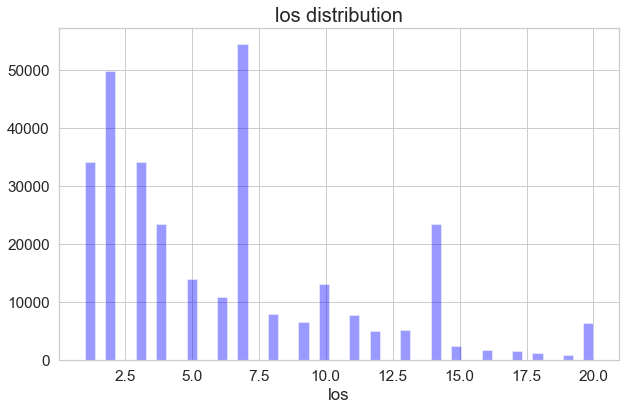

In [82]:
NBplot.distribution_plot(df2,['los'])

In [83]:
df2.los.value_counts()

7.0     54556
2.0     49922
1.0     34181
3.0     34176
4.0     23497
14.0    23484
5.0     13963
10.0    13096
6.0     11000
8.0     8021 
11.0    7839 
9.0     6674 
20.0    6352 
13.0    5152 
12.0    5136 
15.0    2474 
16.0    1770 
17.0    1681 
18.0    1290 
19.0    971  
Name: los, dtype: int64

Feature nbrooms:

In [84]:
df2 = df2.drop(['nbroom'], axis=1)

Feature nbguest: removing outliers when it's over 8 guests

In [85]:
df3 = df2[~(df2['nbguest'] >= 8)] 

In [86]:
df3.nbguest.value_counts()

4.0    107130
2.0    82381 
3.0    50789 
5.0    36067 
6.0    15708 
1.0    9793  
7.0    1875  
Name: nbguest, dtype: int64

Removing nbx_nuit_fid, Séjour Gratuit and Nb Nuits Payantes, because there will be no more free nights

In [87]:
df3 = df3.drop(['nb_nuit_fid', 'Séjour Gratuit', 'Nb Nuits Payantes'], axis=1)

For calculating revenue, I also remove vrai_date_resa

In [88]:
df3 = df3.drop(['vrai_date_resa'], axis=1)

Removing client_id_grp:

In [89]:
df3 = df3.drop(['client_id_grp'], axis=1)

Removing all columns revX:

In [90]:
df3 = df3.drop(['rev1', 'rev2', 'rev3', 'rev4', 'rev5'], axis=1)

Removing id columns:

In [91]:
df3 = df3.drop(['fid_id', 'date_fid'], axis=1)

In [92]:
df3.camping_fid.nunique()

100

In [93]:
df3 = df3.drop(['camping_fid'], axis=1)

In [94]:
df3 = df3.drop(['hebergement_camping_id'], axis=1)

In [95]:
df3 = df3.drop(['creation_date'], axis=1)

In [96]:
df3.select_dtypes(include=['float64']).info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 303743 entries, 0 to 305234
Data columns (total 6 columns):
resdate    303743 non-null float64
datein     303743 non-null float64
dateout    303743 non-null float64
los        303743 non-null float64
nbguest    303743 non-null float64
rev        303743 non-null float64
dtypes: float64(6)
memory usage: 16.2 MB


In [97]:
df3.head()

,idstay_to,resinternet,type_guest,resdate,camping_label,Région,type_hebergement,hebergement_label,datein,dateout,los,nbguest,rev,pays,fidelisation,segment,hebergement_camping_lbl,nb_stars
0,0,U,N,43040.0,TURISCAMPO,Portugal,LOCA,Locatif 3 ch. 4 *,43191.0,43220.0,20.0,1.0,740.00,BE,Y,DIRECT,LOCA - Not Defined,4_stars_or_premium
1,0,U,N,42675.0,TURISCAMPO,Portugal,EMPL,Emplacement nu de 0 à 3 *,43072.0,43136.0,20.0,2.0,915.64,GB,Y,DIRECT,EMPL - Not Defined,3_stars_or_less
2,0,U,N,43040.0,TURISCAMPO,Portugal,EMPL,Emplacement nu de 0 à 3 *,43101.0,43165.0,20.0,2.0,1138.66,GB,Y,DIRECT,Empla. Super Deluxe *** Luz,3_stars_or_less
3,0,U,N,43040.0,TURISCAMPO,Portugal,EMPL,Emplacement nu de 0 à 3 *,43191.0,43252.0,20.0,2.0,901.00,DE,Y,DIRECT,EMPL - Not Defined,3_stars_or_less
4,0,U,N,42675.0,TURISCAMPO,Portugal,LOCA,Locatif 2 ch. PREMIUM,43074.0,43078.0,4.0,2.0,0.00,Other,N,DIRECT,LOCA - Not Defined,4_stars_or_premium


In [98]:
def epoch_day_to_time(srl_no):
    new_date = (datetime.datetime(1900,1,1,0,0) + (srl_no - 1).map(datetime.timedelta)).to_timestamp
    print(type(new_date))
    return new_date.datetime.strftime('%Y-%m-%d')

In [99]:
df3.shape

(303743, 18)

In [100]:
df3['date_in'] = pd.to_datetime(df3['datein'])

In [101]:
43136-43072.0

64.0

In [102]:
df3

,idstay_to,resinternet,type_guest,resdate,camping_label,Région,type_hebergement,hebergement_label,datein,dateout,los,nbguest,rev,pays,fidelisation,segment,hebergement_camping_lbl,nb_stars,date_in
0,0,U,N,43040.0,TURISCAMPO,Portugal,LOCA,Locatif 3 ch. 4 *,43191.0,43220.0,20.0,1.0,740.00,BE,Y,DIRECT,LOCA - Not Defined,4_stars_or_premium,1970-01-01 00:00:00.000043191
1,0,U,N,42675.0,TURISCAMPO,Portugal,EMPL,Emplacement nu de 0 à 3 *,43072.0,43136.0,20.0,2.0,915.64,GB,Y,DIRECT,EMPL - Not Defined,3_stars_or_less,1970-01-01 00:00:00.000043072
2,0,U,N,43040.0,TURISCAMPO,Portugal,EMPL,Emplacement nu de 0 à 3 *,43101.0,43165.0,20.0,2.0,1138.66,GB,Y,DIRECT,Empla. Super Deluxe *** Luz,3_stars_or_less,1970-01-01 00:00:00.000043101
3,0,U,N,43040.0,TURISCAMPO,Portugal,EMPL,Emplacement nu de 0 à 3 *,43191.0,43252.0,20.0,2.0,901.00,DE,Y,DIRECT,EMPL - Not Defined,3_stars_or_less,1970-01-01 00:00:00.000043191
4,0,U,N,42675.0,TURISCAMPO,Portugal,LOCA,Locatif 2 ch. PREMIUM,43074.0,43078.0,4.0,2.0,0.00,Other,N,DIRECT,LOCA - Not Defined,4_stars_or_premium,1970-01-01 00:00:00.000043074
5,0,U,N,43040.0,TURISCAMPO,Portugal,EMPL,Emplacement nu de 0 à 3 *,43203.0,43264.0,20.0,2.0,1111.75,GB,Y,DIRECT,EMPL - Not Defined,3_stars_or_less,1970-01-01 00:00:00.000043203
6,0,U,N,43040.0,TURISCAMPO,Portugal,LOCA,Locatif 2 ch. 4 *,43375.0,43405.0,20.0,2.0,563.00,DE,Y,DIRECT,Cottage Ipanema 5p 2ch****clim,4_stars_or_premium,1970-01-01 00:00:00.000043375
7,0,U,N,43040.0,TURISCAMPO,Portugal,EMPL,Emplacement nu de 0 à 3 *,43392.0,43466.0,20.0,2.0,1175.96,DE,Y,DIRECT,Empla. Super Deluxe *** Luz,3_stars_or_less,1970-01-01 00:00:00.000043392
8,0,U,N,43040.0,TURISCAMPO,Portugal,EMPL,Emplacement nu de 0 à 3 *,43101.0,43167.0,20.0,2.0,917.32,DE,Y,DIRECT,EMPL - Not Defined,3_stars_or_less,1970-01-01 00:00:00.000043101
9,0,U,N,43040.0,TURISCAMPO,Portugal,EMPL,Emplacement nu de 0 à 3 *,43101.0,43193.0,20.0,2.0,1610.30,Other,Y,DIRECT,EMPL - Not Defined,3_stars_or_less,1970-01-01 00:00:00.000043101


In [103]:
def serial_date_to_string(srl_no):
    new_date = datetime.datetime(1900,1,1,0,0) + datetime.timedelta(srl_no - 1)
    date_parsed = parser.parse(new_date.strftime("%Y-%m-%d"))
    return date_parsed
  #  return pd.Series(date_parsed).dt.dayofyear[0]

In [104]:
serial_date_to_string(43000)

datetime.datetime(2017, 9, 23, 0, 0)

In [105]:
def epoch_day_to_time(srl_no):
    new_date = datetime.datetime(1900,1,1,0,0) + datetime.timedelta(srl_no - 1)
    return new_date.strftime("%Y-%m-%d")

In [106]:
epoch_day_to_time(43000)

'2017-09-23'

In [107]:
df['new_date_in'] = df['datein'].apply(lambda x: epoch_day_to_time(x))

In [108]:
df['new_date_out'] = df['dateout'].apply(lambda x: epoch_day_to_time(x))

In [109]:
df['new_date_in']

0         2018-04-02
1         2017-12-04
2         2018-01-02
3         2018-04-02
4         2017-12-06
5         2018-04-14
6         2018-10-03
7         2018-10-20
8         2018-01-02
9         2018-01-02
10        2018-01-26
11        2018-01-02
12        2017-11-23
13        2017-12-02
14        2018-02-06
15        2018-01-04
16        2018-03-16
17        2018-04-01
18        2017-11-07
19        2017-12-31
20        2018-05-24
21        2018-05-13
22        2017-12-08
23        2017-11-27
24        2018-01-02
25        2017-11-02
26        2018-03-07
27        2018-02-07
28        2018-10-31
29        2018-03-11
             ...    
305205    2018-10-28
305206    2018-10-28
305207    2018-10-28
305208    2018-10-28
305209    2018-10-31
305210    2018-10-31
305211    2018-10-28
305212    2018-10-02
305213    2018-10-22
305214    2018-11-01
305215    2018-10-21
305216    2018-10-23
305217    2018-10-20
305218    2018-10-22
305219    2018-10-28
305220    2018-10-20
305221    201

In [110]:
df['new_date_out']

0         2018-05-01
1         2018-02-06
2         2018-03-07
3         2018-06-02
4         2017-12-10
5         2018-06-14
6         2018-11-02
7         2019-01-02
8         2018-03-09
9         2018-04-04
10        2018-04-03
11        2018-04-25
12        2018-03-23
13        2018-01-02
14        2018-04-02
15        2018-03-22
16        2018-05-01
17        2018-06-02
18        2018-01-02
19        2018-01-03
20        2018-05-28
21        2018-06-02
22        2018-03-05
23        2018-01-02
24        2018-04-16
25        2018-03-27
26        2018-03-16
27        2018-04-20
28        2018-11-10
29        2018-04-02
             ...    
305205    2018-10-29
305206    2018-10-29
305207    2018-10-29
305208    2018-10-30
305209    2018-11-01
305210    2018-11-01
305211    2018-10-29
305212    2019-07-13
305213    2018-10-27
305214    2018-11-05
305215    2018-10-26
305216    2018-10-27
305217    2018-10-22
305218    2018-10-27
305219    2018-10-31
305220    2018-10-22
305221    201

In [111]:
df['los']

0         29.0 
1         64.0 
2         64.0 
3         61.0 
4         4.0  
5         61.0 
6         30.0 
7         74.0 
8         66.0 
9         92.0 
10        67.0 
11        113.0
12        120.0
13        31.0 
14        55.0 
15        77.0 
16        46.0 
17        62.0 
18        56.0 
19        3.0  
20        4.0  
21        20.0 
22        87.0 
23        36.0 
24        104.0
25        145.0
26        9.0  
27        72.0 
28        10.0 
29        22.0 
          ...  
305205    1.0  
305206    1.0  
305207    1.0  
305208    2.0  
305209    1.0  
305210    1.0  
305211    1.0  
305212    284.0
305213    5.0  
305214    4.0  
305215    5.0  
305216    4.0  
305217    2.0  
305218    5.0  
305219    3.0  
305220    2.0  
305221    5.0  
305222    2.0  
305223    2.0  
305224    2.0  
305225    2.0  
305226    31.0 
305227    31.0 
305228    31.0 
305229    31.0 
305230    31.0 
305231    31.0 
305232    31.0 
305233    16.0 
305234    16.0 
Name: los, Length: 30523

In [112]:
df_gavina = df[df['camping_label'] == 'GAVINA']

In [115]:
df_gavina.head()

,idstay_to,resinternet,type_guest,extract_date,resdate,camping_code,camping_label,Région,type_hebergement,hebergement,hebergement_label,datein,dateout,los,nbroom,nbguest,nb_nuit_fid,Séjour Gratuit,Nb Nuits Payantes,vrai_date_resa,client_id_grp,rev1,rev2,rev3,rev4,rev5,rev,fid_id,pays,region,fidelisation,date_fid,camping_fid,creation_date,segment,scode1,scode2,hebergement_camping_id,hebergement_camping_lbl,nb_stars,new_date_in,new_date_out
138949,0,U,N,43400.0,43040.0,109.0,GAVINA,Espagne,EMPL,2.0,Emplacement nu de 0 à 3 *,43182.0,43401.0,219.0,1.0,2.0,0.0,0.0,219.0,43035.0,3287372.0,3040.0,0.0,380.0,7.0,0.0,3427.0,1.091700e+11,ES,None,Y,43101.0,109.0,43035.0,DIRECT,Village,Village,1.0,Parcela 2p * 3Âª LÃ­nea,3_stars_or_less,2018-03-24,2018-10-29
138950,0,O,N,43330.0,43137.0,109.0,GAVINA,Espagne,EMPL,2.0,Emplacement nu de 0 à 3 *,43197.0,43210.0,13.0,1.0,5.0,0.0,0.0,13.0,43137.0,3331204.0,327.6,15.0,0.0,7.0,0.0,349.6,1.091700e+11,FR,None,Y,43101.0,109.0,43137.0,INTERNET,Village,Wvillage,2.0,Parcela 2p * Frente de mar 1Âª LÃ­nea,3_stars_or_less,2018-04-08,2018-04-21
138951,0,O,N,43379.0,43137.0,109.0,GAVINA,Espagne,EMPL,2.0,Emplacement nu de 0 à 3 *,43276.0,43283.0,7.0,1.0,2.0,0.0,0.0,7.0,43137.0,3202963.0,265.0,15.0,0.0,7.0,0.0,287.0,1.091700e+11,BE,None,Y,43101.0,109.0,42962.0,Internet,Yelloh,Wyelloh,1.0,Parcela 2p * 3Âª LÃ­nea,3_stars_or_less,2018-06-26,2018-07-03
138952,0,O,N,43295.0,43137.0,109.0,GAVINA,Espagne,LOCA,5.0,Locatif 2 ch. de 0 à 3 *,43281.0,43295.0,14.0,1.0,5.0,0.0,0.0,14.0,43137.0,3331219.0,2240.0,0.0,0.0,7.0,0.0,2247.0,1.091700e+11,DE,None,Y,43101.0,109.0,43137.0,INTERNET,Village,Wvillage,11.0,Chalet Beach 4/5p 2Hab ***,3_stars_or_less,2018-07-01,2018-07-15
138953,0,O,N,43287.0,43138.0,109.0,GAVINA,Espagne,LOCA,5.0,Locatif 2 ch. de 0 à 3 *,43281.0,43287.0,6.0,1.0,2.0,0.0,0.0,6.0,43138.0,3331661.0,930.0,0.0,0.0,6.0,0.0,936.0,1.091700e+11,CZ,None,Y,43101.0,109.0,43138.0,Internet,Yelloh,Wyelloh,9.0,Tienda Lodge Safari 6p2Hab+entresuelo***,3_stars_or_less,2018-07-01,2018-07-07


In [117]:
from collections import defaultdict
season = pd.date_range(start=min(df['new_date_in']),end=max(df['new_date_out']))
dict_dates = defaultdict(int)
for date in season:
    dict_dates[date] = 0

In [140]:
df_gavina

,idstay_to,resinternet,type_guest,extract_date,resdate,camping_code,camping_label,Région,type_hebergement,hebergement,hebergement_label,datein,dateout,los,nbroom,nbguest,nb_nuit_fid,Séjour Gratuit,Nb Nuits Payantes,vrai_date_resa,client_id_grp,rev1,rev2,rev3,rev4,rev5,rev,fid_id,pays,region,fidelisation,date_fid,camping_fid,creation_date,segment,scode1,scode2,hebergement_camping_id,hebergement_camping_lbl,nb_stars,new_date_in,new_date_out
138949,0,U,N,43400.0,43040.0,109.0,GAVINA,Espagne,EMPL,2.0,Emplacement nu de 0 à 3 *,43182.0,43401.0,219.0,1.0,2.0,0.0,0.0,219.0,43035.0,3287372.0,3040.00,0.0,380.0,7.0,0.0,3427.00,1.091700e+11,ES,None,Y,43101.0,109.0,43035.0,DIRECT,Village,Village,1.0,Parcela 2p * 3Âª LÃ­nea,3_stars_or_less,2018-03-24,2018-10-29
138950,0,O,N,43330.0,43137.0,109.0,GAVINA,Espagne,EMPL,2.0,Emplacement nu de 0 à 3 *,43197.0,43210.0,13.0,1.0,5.0,0.0,0.0,13.0,43137.0,3331204.0,327.60,15.0,0.0,7.0,0.0,349.60,1.091700e+11,FR,None,Y,43101.0,109.0,43137.0,INTERNET,Village,Wvillage,2.0,Parcela 2p * Frente de mar 1Âª LÃ­nea,3_stars_or_less,2018-04-08,2018-04-21
138951,0,O,N,43379.0,43137.0,109.0,GAVINA,Espagne,EMPL,2.0,Emplacement nu de 0 à 3 *,43276.0,43283.0,7.0,1.0,2.0,0.0,0.0,7.0,43137.0,3202963.0,265.00,15.0,0.0,7.0,0.0,287.00,1.091700e+11,BE,None,Y,43101.0,109.0,42962.0,Internet,Yelloh,Wyelloh,1.0,Parcela 2p * 3Âª LÃ­nea,3_stars_or_less,2018-06-26,2018-07-03
138952,0,O,N,43295.0,43137.0,109.0,GAVINA,Espagne,LOCA,5.0,Locatif 2 ch. de 0 à 3 *,43281.0,43295.0,14.0,1.0,5.0,0.0,0.0,14.0,43137.0,3331219.0,2240.00,0.0,0.0,7.0,0.0,2247.00,1.091700e+11,DE,None,Y,43101.0,109.0,43137.0,INTERNET,Village,Wvillage,11.0,Chalet Beach 4/5p 2Hab ***,3_stars_or_less,2018-07-01,2018-07-15
138953,0,O,N,43287.0,43138.0,109.0,GAVINA,Espagne,LOCA,5.0,Locatif 2 ch. de 0 à 3 *,43281.0,43287.0,6.0,1.0,2.0,0.0,0.0,6.0,43138.0,3331661.0,930.00,0.0,0.0,6.0,0.0,936.00,1.091700e+11,CZ,None,Y,43101.0,109.0,43138.0,Internet,Yelloh,Wyelloh,9.0,Tienda Lodge Safari 6p2Hab+entresuelo***,3_stars_or_less,2018-07-01,2018-07-07
138954,0,O,N,43306.0,43138.0,109.0,GAVINA,Espagne,LOCA,5.0,Locatif 2 ch. de 0 à 3 *,43289.0,43306.0,17.0,1.0,6.0,0.0,0.0,17.0,43138.0,1981799.0,2655.00,51.0,70.0,7.0,0.0,2783.00,1.091700e+11,NL,None,Y,43101.0,109.0,41352.0,INTERNET,Village,Wvillage,17.0,Tienda Lodge Luna 6p 2Hab **,3_stars_or_less,2018-07-09,2018-07-26
138955,0,O,N,43288.0,43138.0,109.0,GAVINA,Espagne,LOCA,5.0,Locatif 2 ch. de 0 à 3 *,43281.0,43288.0,7.0,1.0,4.0,0.0,0.0,7.0,43138.0,3331509.0,1015.00,0.0,30.0,10.5,0.0,1055.50,1.001700e+11,FR,None,Y,43101.0,100.0,43137.0,INTERNET,Village,Wvillage,15.0,CabaÃ±a Pl 5p 2Hab ** Vista al Mar,3_stars_or_less,2018-07-01,2018-07-08
138956,0,O,N,43379.0,43138.0,109.0,GAVINA,Espagne,EMPL,2.0,Emplacement nu de 0 à 3 *,43294.0,43301.0,7.0,1.0,4.0,0.0,0.0,7.0,43138.0,3331682.0,400.00,15.0,112.0,7.0,0.0,534.00,1.091700e+11,FR,None,Y,43101.0,109.0,43138.0,Internet,Yelloh,Wyelloh,3.0,Parcela 2p * Frente de Mar 2Âª LÃ­nea,3_stars_or_less,2018-07-14,2018-07-21
138957,0,O,N,43338.0,43138.0,109.0,GAVINA,Espagne,LOCA,5.0,Locatif 2 ch. de 0 à 3 *,43329.0,43338.0,9.0,1.0,5.0,0.0,0.0,9.0,43138.0,1719064.0,1619.00,0.0,0.0,7.0,0.0,1626.00,1.001700e+11,FR,None,Y,42736.0,100.0,40915.0,Internet,Yelloh,Call Center,15.0,CabaÃ±a Pl 5p 2Hab ** Vista al Mar,3_stars_or_less,2018-08-18,2018-08-27
138958,0,O,N,43379.0,43138.0,109.0,GAVINA,Espagne,EMPL,2.0,Emplacement nu de 0 à 3 *,43297.0,43313.0,16.0,1.0,4.0,0.0,0.0,16.0,43138.0,3292720.0,924.00,15.0,174.0,7.0,0.0,1120.00,1.091700e+11,DE,None,Y,43101.0,109.0,43035.0,INTERNET,Village,Wvillage,1.0,Parcela 2p * 3Âª LÃ­nea,3_stars_or_less,2018-07-17,2018-08-02


In [120]:
pd.Timestamp(df['new_date_in'][138949])

Timestamp('2018-03-24 00:00:00')

In [121]:
for index in df_gavina.index:
    for j in range(int(df['los'][index])):
        dict_dates[pd.Timestamp(df_gavina['new_date_in'][index]) + pd.DateOffset(days=j)] += 1 

/Users/tal/anaconda3/lib/python3.6/site-packages/pandas/plotting/_converter.py:129: FutureWarning:

Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()



(array([736634., 736695., 736754., 736815., 736876., 736938., 736999.,
        737060., 737119., 737180., 737241.]),
 <a list of 11 Text xticklabel objects>)

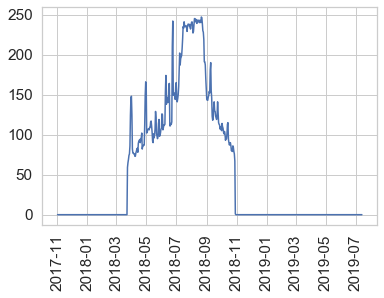

In [122]:
date = list(dict_dates.keys())
n_cust = list(dict_dates.values())
df_occ = pd.DataFrame(date)
df_occ['n_cust'] = n_cust
df_occ = df_occ.set_index(0)
plt.plot(df_occ['n_cust'])
plt.xticks(rotation=90)

In [123]:
import datetime

In [125]:
date_str3 = df_gavina['new_date_in'][138949]

In [126]:
date = datetime.datetime.strptime(date_str3, '%Y-%m-%d')
date

datetime.datetime(2018, 3, 24, 0, 0)

In [127]:
type(pd.DateOffset(days=int(df_gavina['los'][138949])))

pandas.tseries.offsets.DateOffset

In [129]:
# dict_dates

In [130]:
NUMBER_NIGHTS = 73960

In [131]:
list(dict_dates.keys())[-1] - list(dict_dates.keys())[0]

Timedelta('618 days 00:00:00')

In [132]:
CAPACITY_DAY = NUMBER_NIGHTS/220

In [133]:
int(CAPACITY_DAY)

336

# Time Analysis

In [247]:
import warnings
warnings.filterwarnings('ignore')
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score

In [406]:
df_2018 = df.copy()

In [223]:
df_2019 = pd.read_excel('database/20-01-02_Séjours_2019.xlsx')

In [328]:
months = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
months_occ = ['March', 'April', 'May', 'June', 'July', 'August', 'September', 'October']

### Time Analysis Functions

In [517]:
def serial_date_to_string(srl_no):
    new_date = datetime.datetime(1900,1,1,0,0) + datetime.timedelta(srl_no - 1)
    date_parsed = parser.parse(new_date.strftime("%Y-%m-%d"))
    return date_parsed

    
def epoch_day_to_time(srl_no):
    new_date = datetime.datetime(1900,1,1,0,0) + datetime.timedelta(srl_no - 1)
    return new_date.strftime("%Y-%m-%d")

# # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # 

def camp_occ_calculator(df, camp, plot=True):
    """
    gets df and camp name to calculate daily occ per specific date convertor.
    
    """
    df_camp = df[df['camping_label'] == camp]
    
    if np.dtype(df_camp['datein']) == float:
        df_camp['new_date_in'] = df_camp['datein'].apply(lambda x: serial_date_to_string(x))
        df_camp['new_date_out'] = df_camp['dateout'].apply(lambda x: serial_date_to_string(x))
    else:
        df_camp['new_date_in'] = df_camp['datein']
        df_camp['new_date_out'] = df_camp['dateout']

    season = pd.date_range(start=min(df_camp['new_date_in']),end=max(df_camp['new_date_out']))
    dict_dates = defaultdict(int)
    for date in season:
        dict_dates[date] = 0

    for index in df_camp.index:
        for j in range(int(df_camp['los'][index])):
            dict_dates[pd.Timestamp(df_camp['new_date_in'][index]) + pd.DateOffset(days=j)] += df_camp['nbguest'][index]
    df_date = pd.DataFrame(index=dict_dates.keys(), data=dict_dates.values())
    df_date = df_date[df_date[0] != 0]
    
    if plot:
        plot_occ(df_date, camp)
        plot_daliy_occ(df_date)
        plot_daliy_occ(df_date, time='day')
        
    return df_date

# # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # 

def plot_occ(df, camp):
    """
    plot summarize occ data per interval
    """
    interval = ['M', 'd']
    year = list(map(str, (df.index.year.min(), df.index.year.max())))
    for i, t in enumerate(interval, 1):
        plt.subplot(1,2,i)
        df[0].resample(t).mean().plot(figsize=(15,5))
        plt.title(camp, fontsize=20)
        plt.ylabel('Occ')
        

def plot_daliy_occ(df, time=None):
    """
    Gets Avg Occ per month for date indexed df
    params: df of specific camp for specific year
            time, if None plot by day of the month else by week
    return: daily avg occ plot
    """
    if time != None:
        time = df.index.dayofweek
        x_label = "Days of Week" 
    else:
        time = df.index.day
        x_label = "Days of Month" 
        
    df.groupby([time, df.index.month]).mean().unstack().plot(figsize=(10,5), label='Inline label')
    plt.title('Daily Occ')
    plt.ylabel('OCC')
    plt.xlabel(x_label)
    plt.legend(months, loc='best', bbox_to_anchor=(1,1))

# # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # 

def run_predicator(train, test, model, test_year=2019):
    """
    Combine train and test df i.e. past and the test future df, using specified model.
    shift data by 10 days to prepare new data frame for autoregressor models.
    params: train, past years of camp occupations data
            test, future year to test model on 
    returns: prediction score and sanity checks for splited data.
    """
    df = train.append(test)
    print(f'Dates range:\n{df.index.min()} - {df.index.max()}\n')
    shifted_data = pd.DataFrame({f't{k}': df[0].shift(k) for k in range(10)})
    shifted_data = shifted_data[~shifted_data.isna().any(axis=1)]
    X = shifted_data.drop(columns='t0')
    y = shifted_data.t0
    print(*list(zip(('X shape: ', 'y shape: '), (X.shape, y.shape))), sep='\n')

    # Split Train Test
    X_train = X[X.index.year != test_year]
    X_test = X[y.index.year == test_year]
    y_train = y[X.index.year != test_year]
    y_test = y[y.index.year == test_year]
    print(*list(zip(('X_train shape: ', 'X_test shape: ', 'y_train shape: ', 'y_test shape: '),(X_train.shape, X_test.shape, y_train.shape, y_test.shape))), sep='\n')
    
    # Run predictor
    reg= model()
    reg.fit(X_train, y_train)
    y_pred = reg.predict(X_test)
    print(f'R2:\t{round(r2_score(y_test, y_pred),3)}\nRMSE:\t{round(mean_squared_error(y_test, y_pred),2)}')
    
    f, a = plt.subplots(1,1,figsize = (10,5), sharex=True)
    plt.plot(y_test.index.month, y_test, label='Observed')
    plt.plot(y_test.index.month, y_pred, label='Forecast')
    plt.ylabel('Occ.')
    plt.xlabel('Date')
    plt.title('Prediction vs Past model Evaluation')
    plt.legend()
    
#     return X_train, X_test, y_train, y_test

# # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # 



## Analysis Per Camp

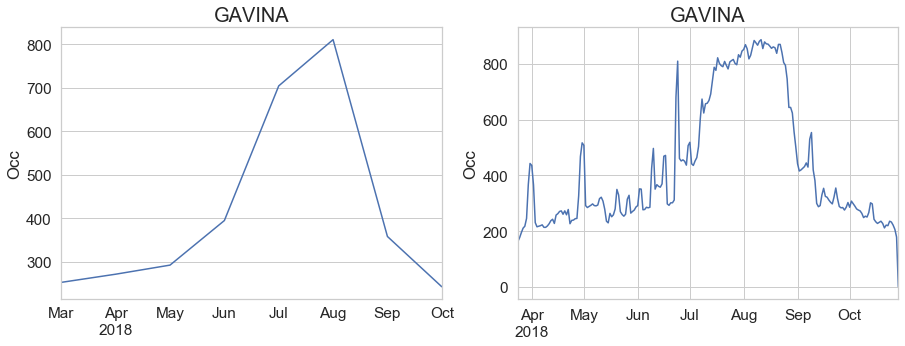

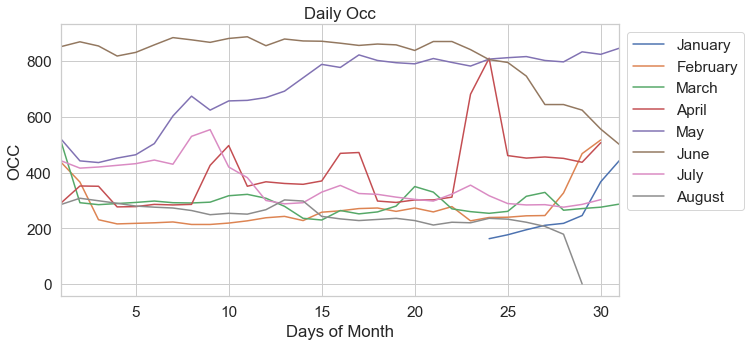

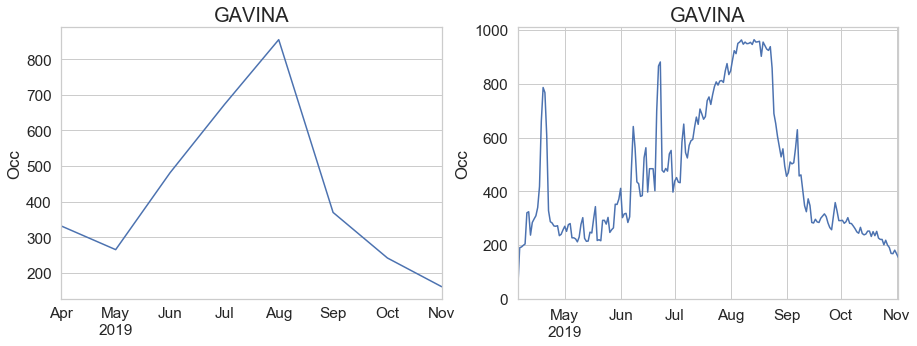

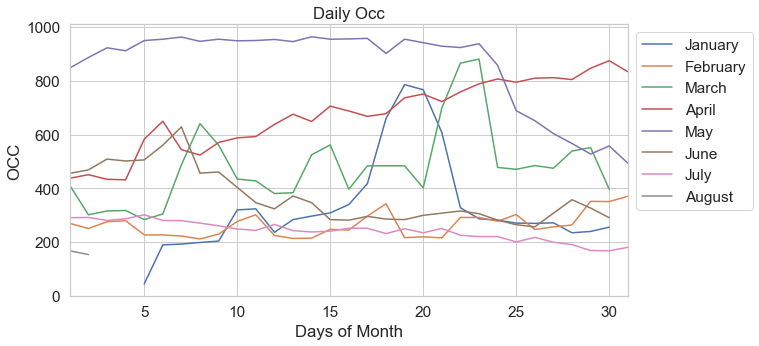

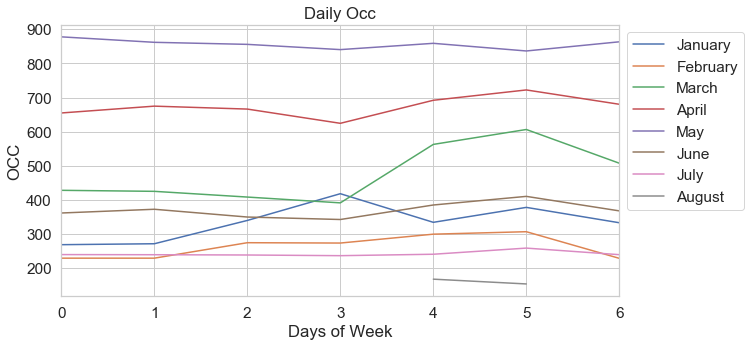

In [529]:
df_gavina_2018 = camp_occ_calculator(df_2018, "GAVINA")
df_gavina_2019 = camp_occ_calculator(df_2019, "GAVINA")

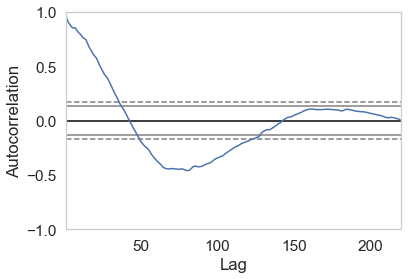

In [520]:
pd.plotting.autocorrelation_plot(df_gavina_2018)

<Figure size 1080x360 with 0 Axes>

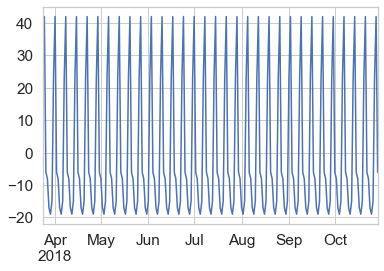

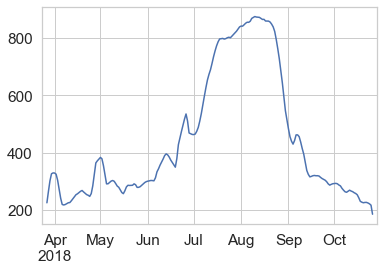

In [528]:
from statsmodels.tsa.seasonal import seasonal_decompose as sd
plt.figure(figsize=(15,5))
sd(df_gavina_2018, model='additive', freq=7).seasonal.plot(legend=False);
sd(df_gavina_2018, model='additive', freq=7).trend.plot(legend=False);

# plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1), fontsize=20);

Dates range:
2018-03-24 00:00:00 - 2019-11-02 00:00:00

('X shape: ', (423, 9))
('y shape: ', (423,))
('X_train shape: ', (211, 9))
('X_test shape: ', (212, 9))
('y_train shape: ', (211,))
('y_test shape: ', (212,))
R2:	0.9
RMSE:	6017.55


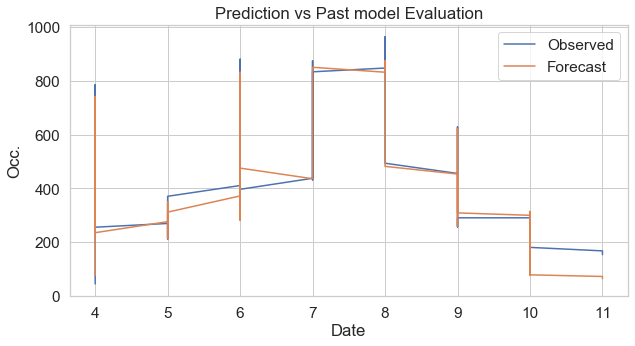

In [533]:
predict = run_predicator(df_gavina_2018, df_gavina_2019, RandomForestRegressor)

# All Camps



Train TS Analysis On 2018 TURISCAMPO Occ.




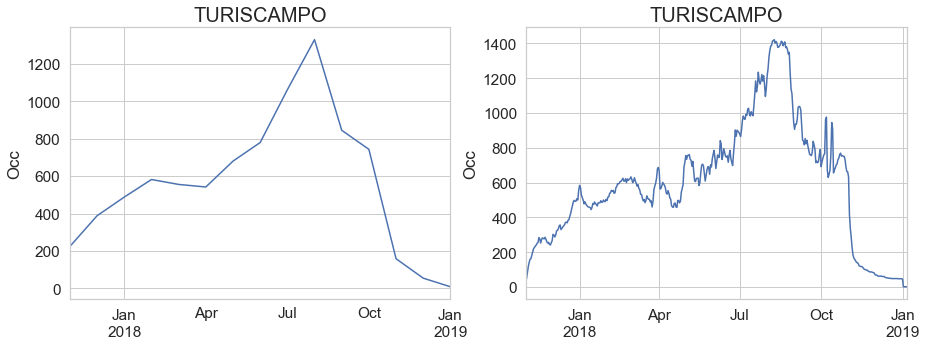

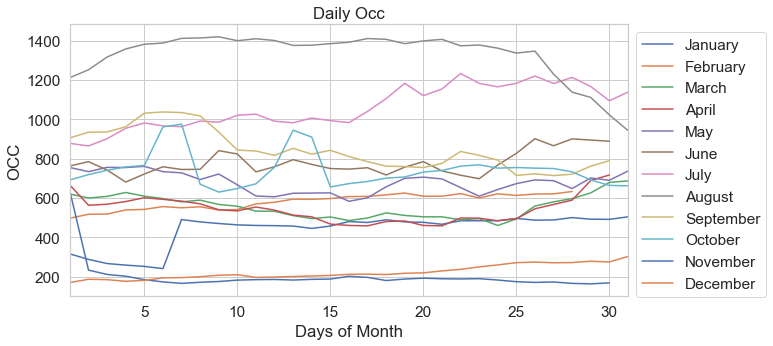

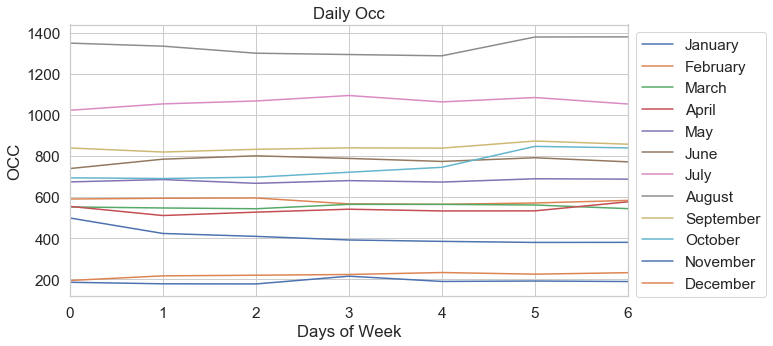



Test TS Analysis On 2019 TURISCAMPO Occ.




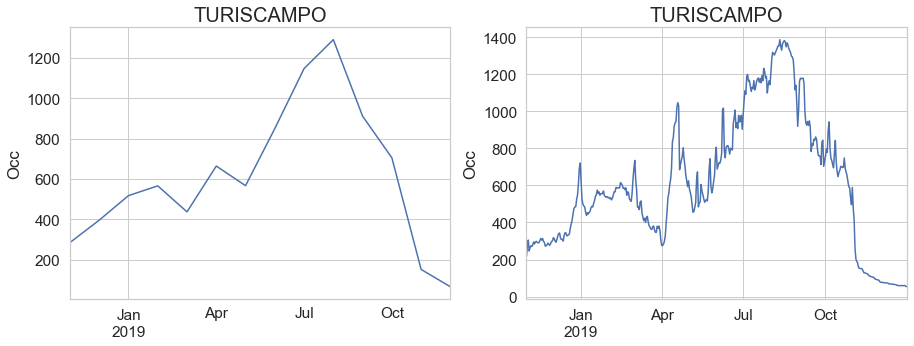

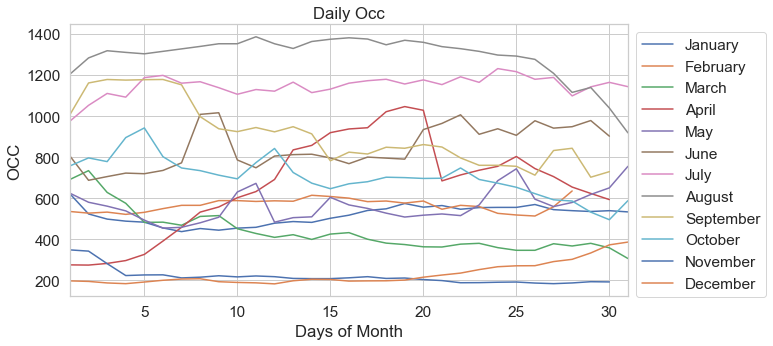

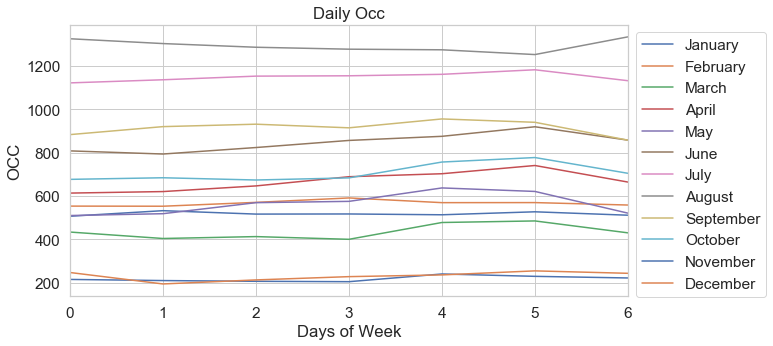

Dates range:
2017-11-02 00:00:00 - 2019-12-31 00:00:00

('X shape: ', (848, 9))
('y shape: ', (848,))
('X_train shape: ', (477, 9))
('X_test shape: ', (371, 9))
('y_train shape: ', (477,))
('y_test shape: ', (371,))
R2:	0.976
RMSE:	3217.34


Train TS Analysis On 2018 PETITS CAMARGUAIS Occ.




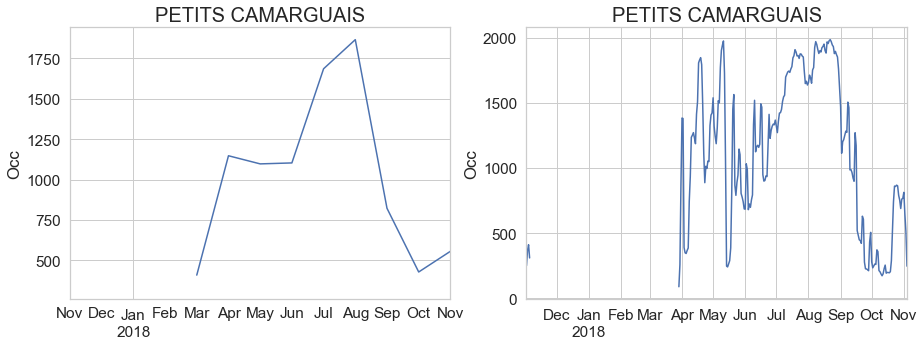

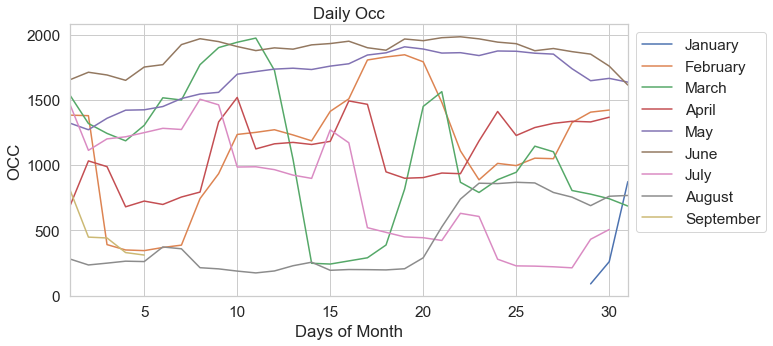

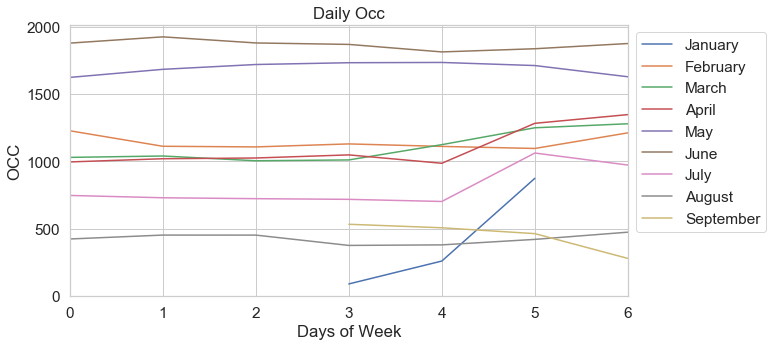



Test TS Analysis On 2019 PETITS CAMARGUAIS Occ.




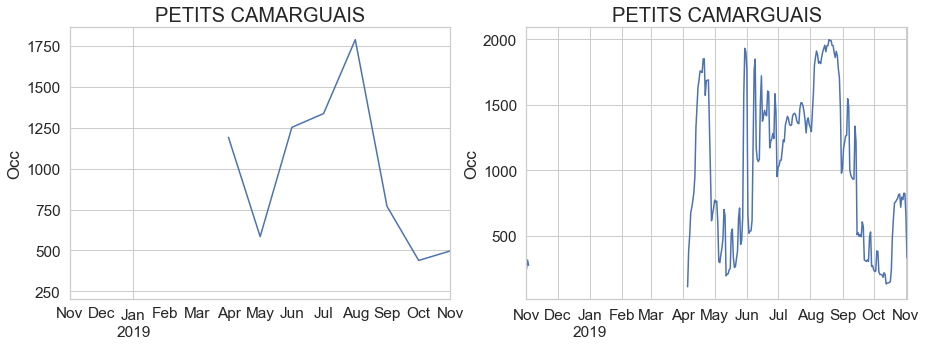

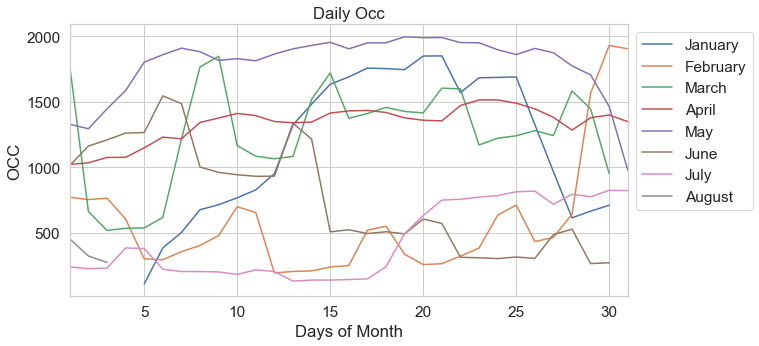

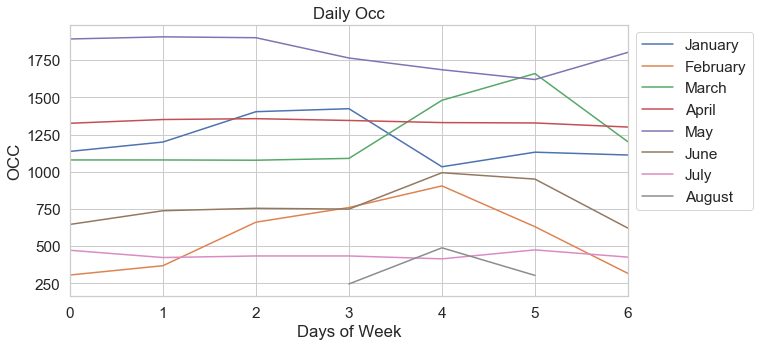

Dates range:
2017-11-02 00:00:00 - 2019-11-02 00:00:00

('X shape: ', (431, 9))
('y shape: ', (431,))
('X_train shape: ', (219, 9))
('X_test shape: ', (212, 9))
('y_train shape: ', (219,))
('y_test shape: ', (212,))
R2:	0.886
RMSE:	37408.95


Train TS Analysis On 2018 TOURNELS Occ.




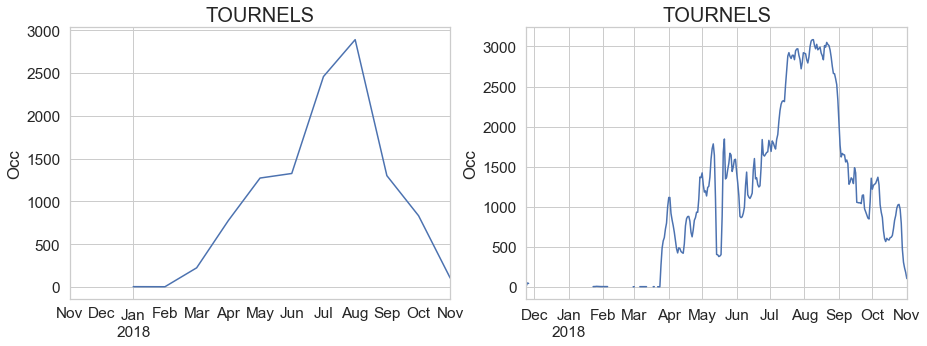

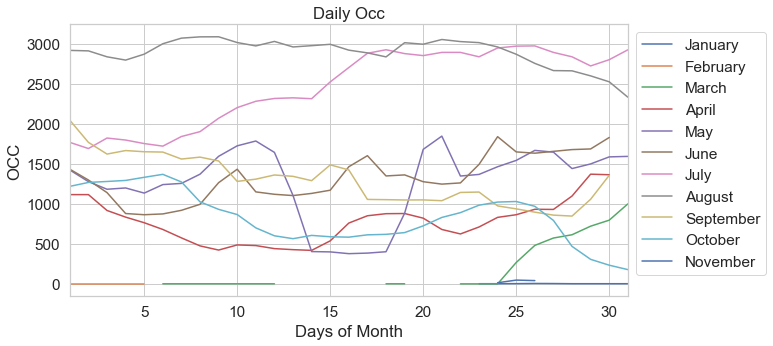

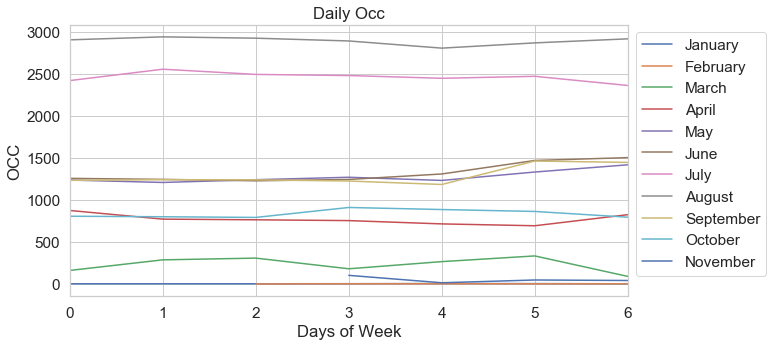



Test TS Analysis On 2019 TOURNELS Occ.




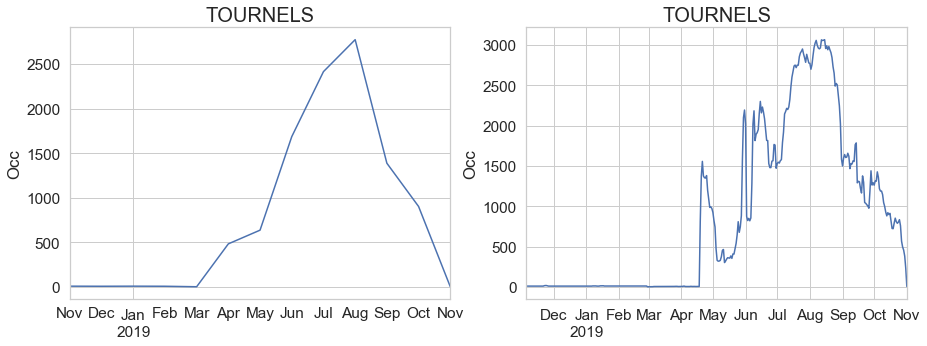

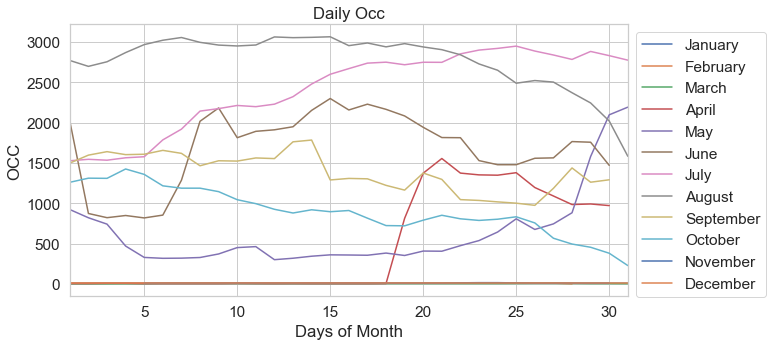

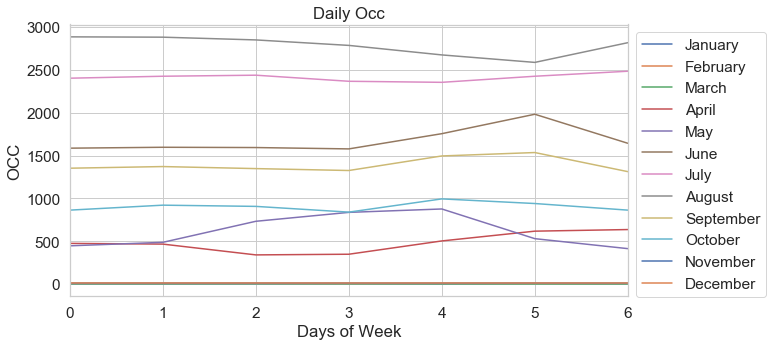

Dates range:
2017-11-24 00:00:00 - 2019-11-01 00:00:00

('X shape: ', (606, 9))
('y shape: ', (606,))
('X_train shape: ', (301, 9))
('X_test shape: ', (305, 9))
('y_train shape: ', (301,))
('y_test shape: ', (305,))
R2:	0.981
RMSE:	20047.03


Train TS Analysis On 2018 ETOILE DES NEIGES Occ.




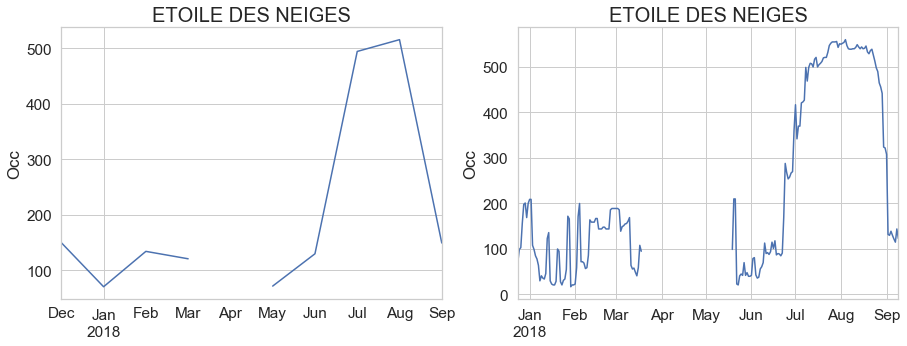

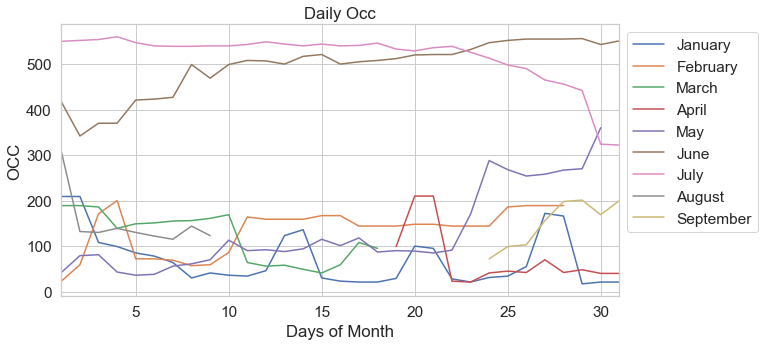

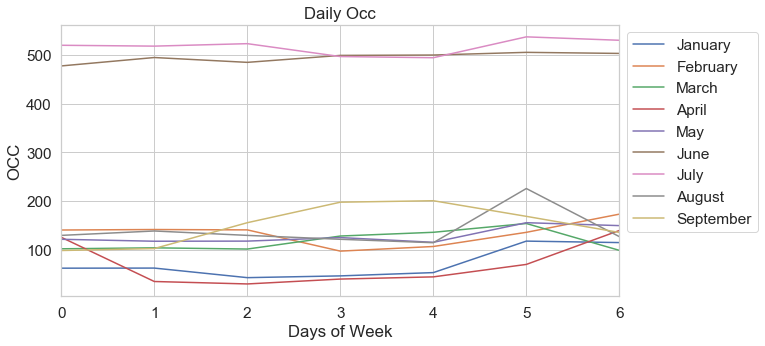



Test TS Analysis On 2019 ETOILE DES NEIGES Occ.




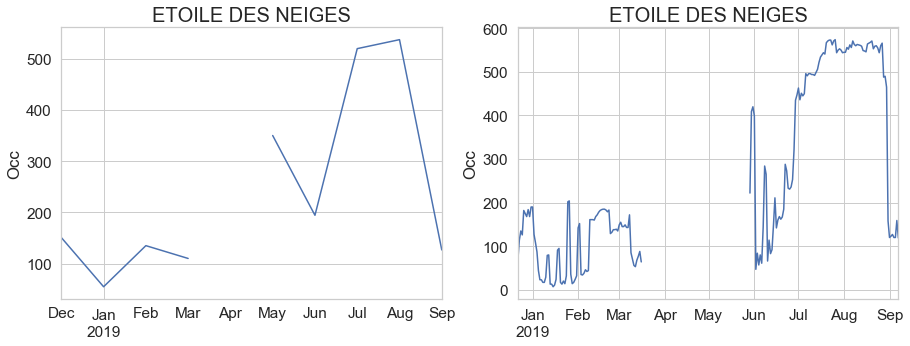

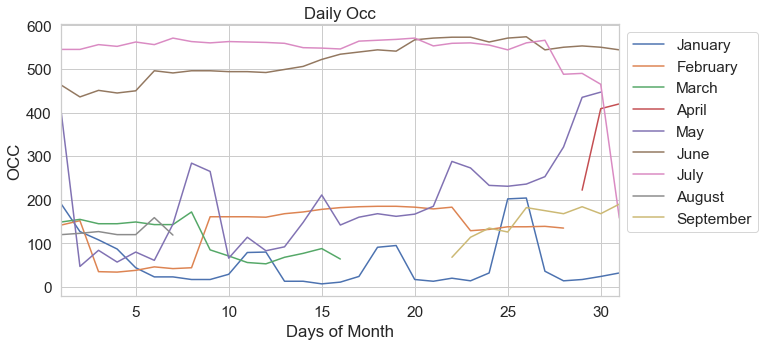

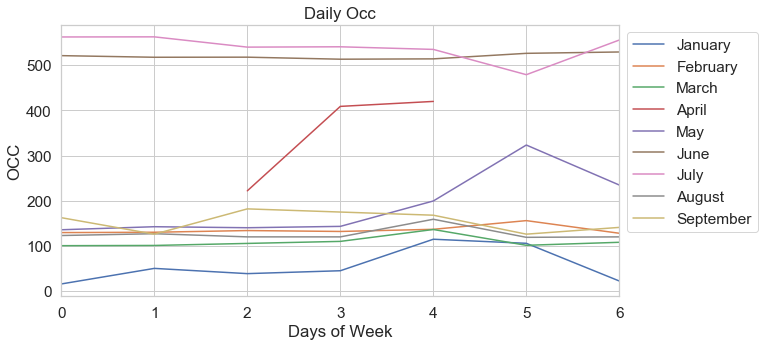

Dates range:
2017-12-24 00:00:00 - 2019-09-07 00:00:00

('X shape: ', (377, 9))
('y shape: ', (377,))
('X_train shape: ', (200, 9))
('X_test shape: ', (177, 9))
('y_train shape: ', (200,))
('y_test shape: ', (177,))
R2:	0.934
RMSE:	2868.19


Train TS Analysis On 2018 CLUB FARRET Occ.




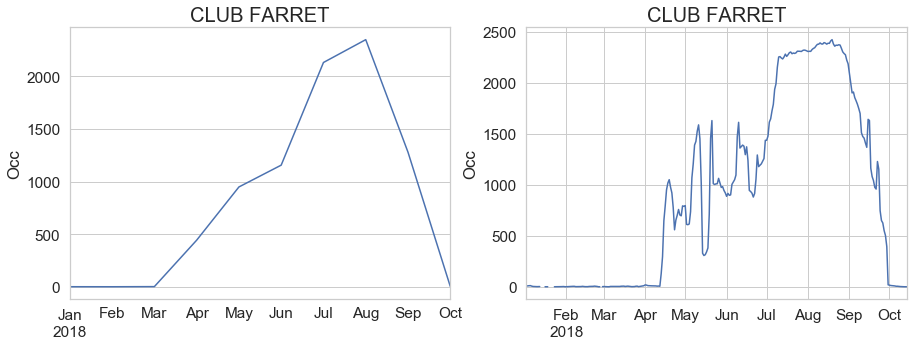

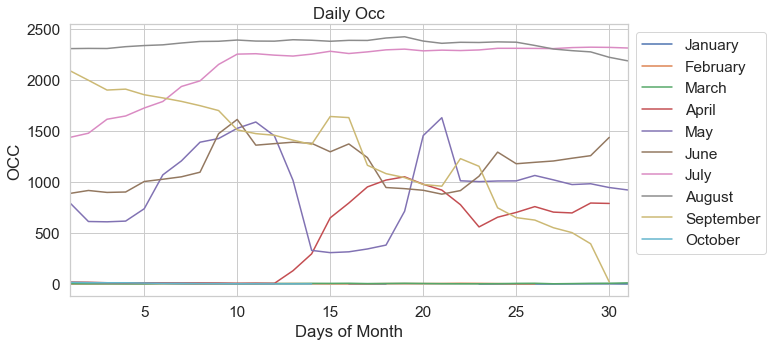

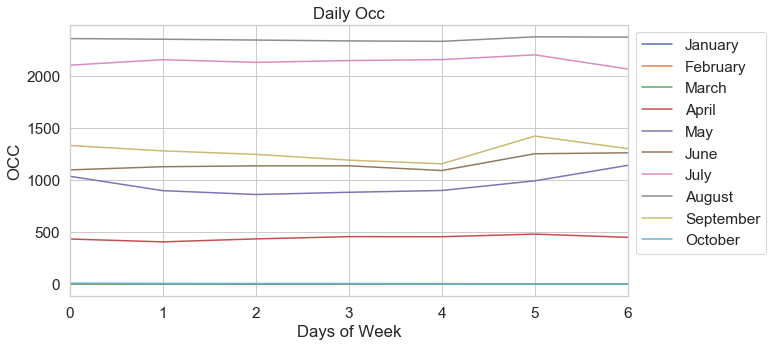



Test TS Analysis On 2019 CLUB FARRET Occ.




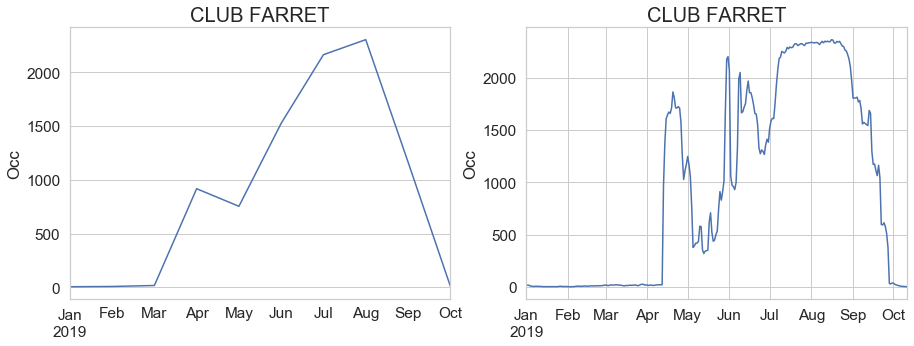

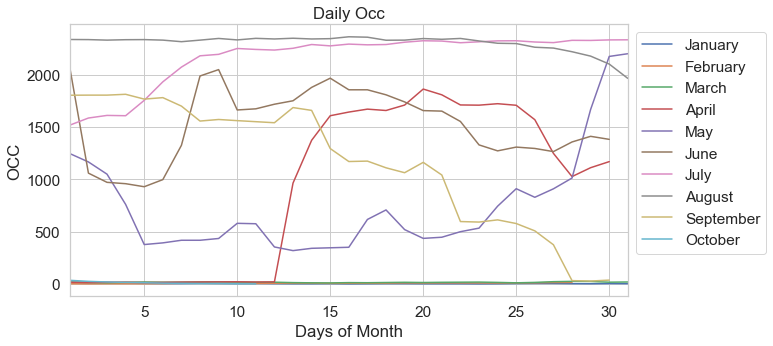

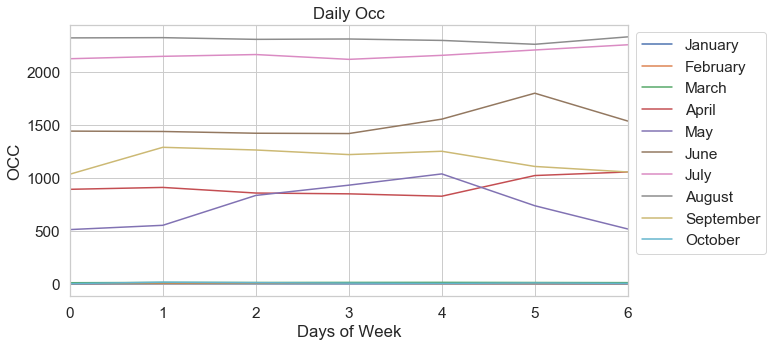

Dates range:
2018-01-02 00:00:00 - 2019-10-11 00:00:00

('X shape: ', (553, 9))
('y shape: ', (553,))
('X_train shape: ', (269, 9))
('X_test shape: ', (284, 9))
('y_train shape: ', (269,))
('y_test shape: ', (284,))
R2:	0.976
RMSE:	20720.75


Train TS Analysis On 2018 SYLVAMAR Occ.




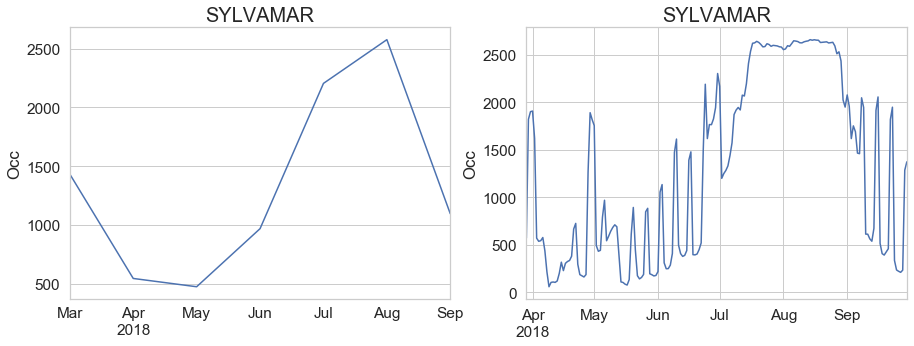

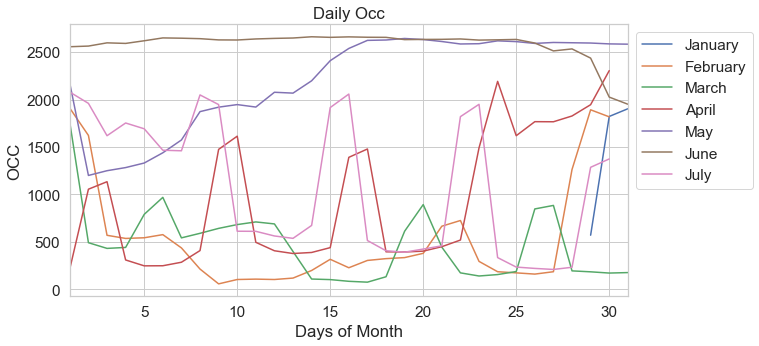

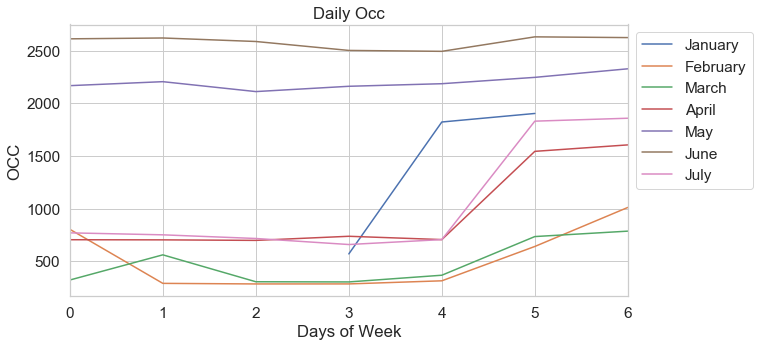



Test TS Analysis On 2019 SYLVAMAR Occ.




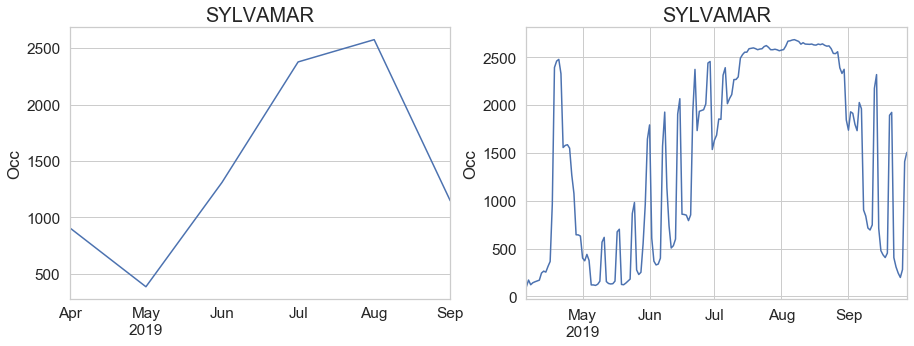

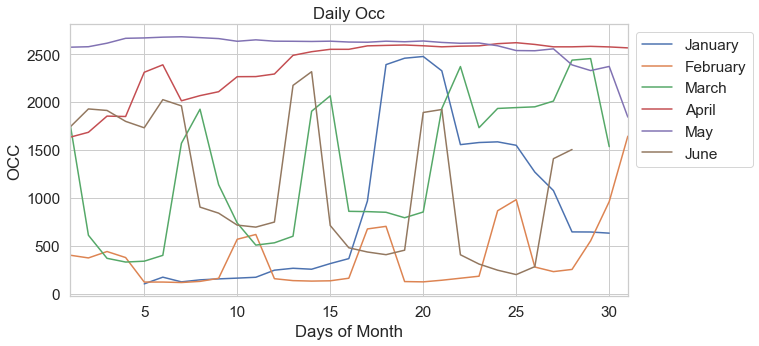

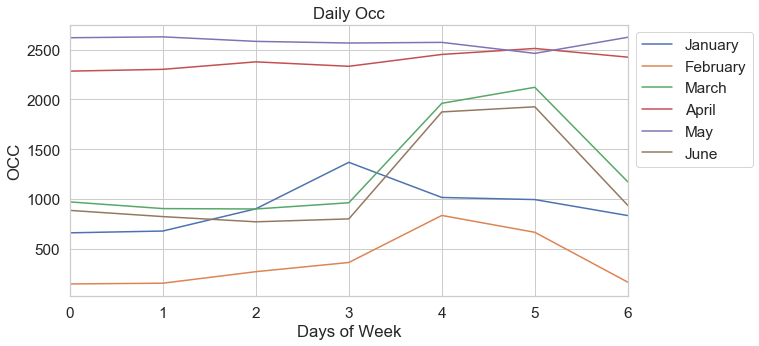

Dates range:
2018-03-29 00:00:00 - 2019-09-28 00:00:00

('X shape: ', (354, 9))
('y shape: ', (354,))
('X_train shape: ', (177, 9))
('X_test shape: ', (177, 9))
('y_train shape: ', (177,))
('y_test shape: ', (177,))
R2:	0.879
RMSE:	113338.28


Train TS Analysis On 2018 CHÂTEAU DE FONRIVES Occ.




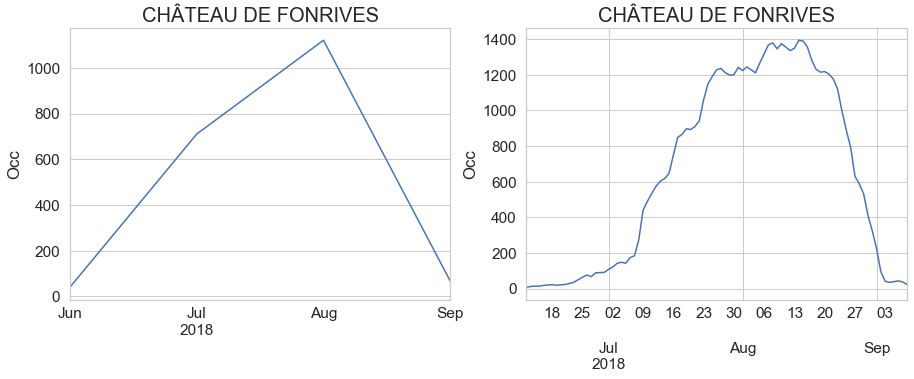

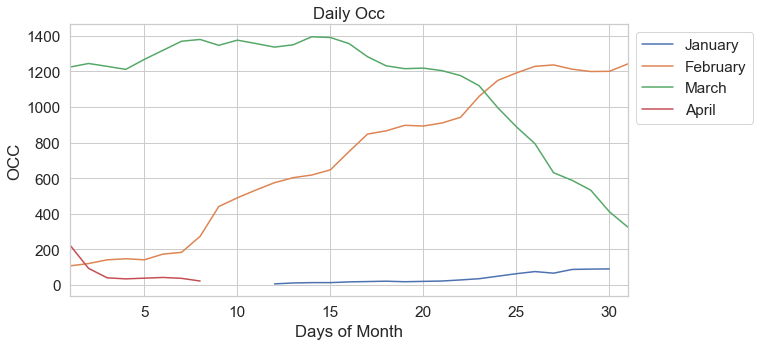

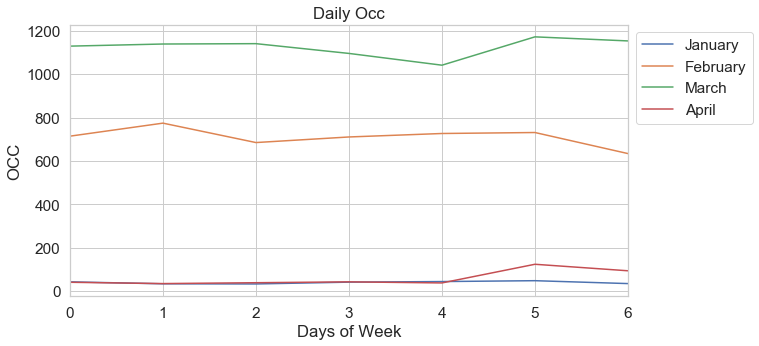



Test TS Analysis On 2019 CHÂTEAU DE FONRIVES Occ.




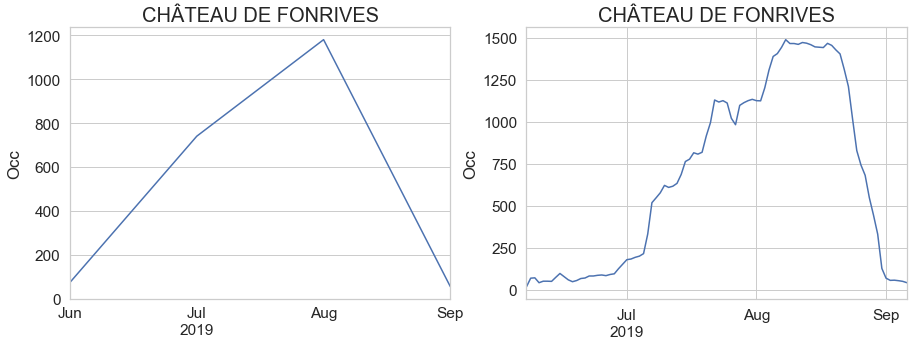

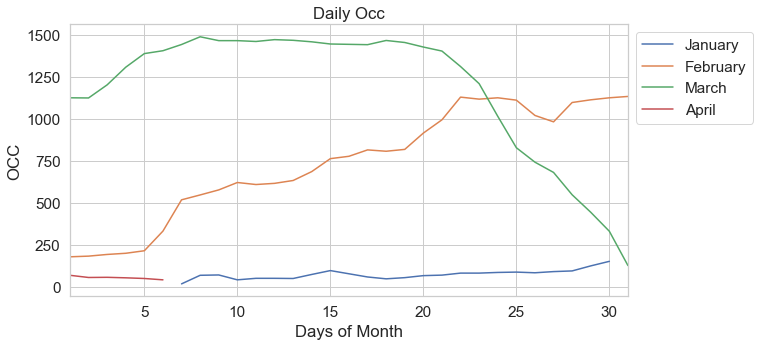

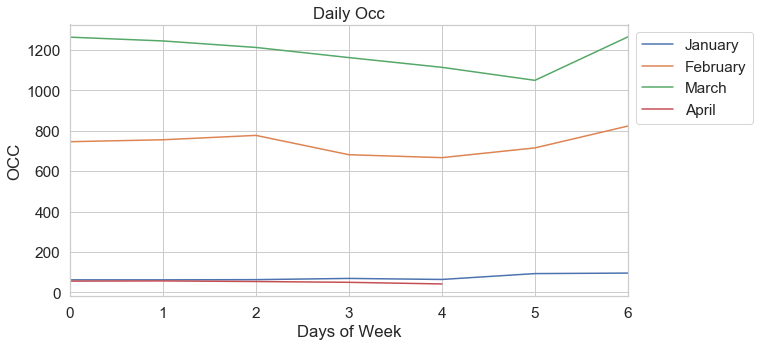

Dates range:
2018-06-12 00:00:00 - 2019-09-06 00:00:00

('X shape: ', (172, 9))
('y shape: ', (172,))
('X_train shape: ', (80, 9))
('X_test shape: ', (92, 9))
('y_train shape: ', (80,))
('y_test shape: ', (92,))
R2:	0.978
RMSE:	6414.28


Train TS Analysis On 2018 NATURE ET RIVIÈRE Occ.




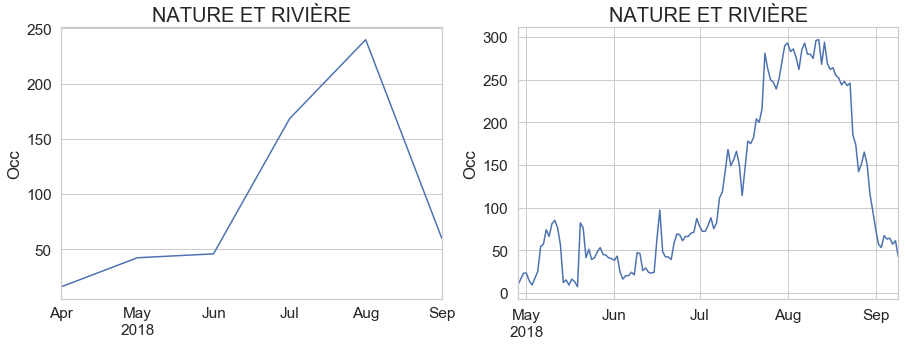

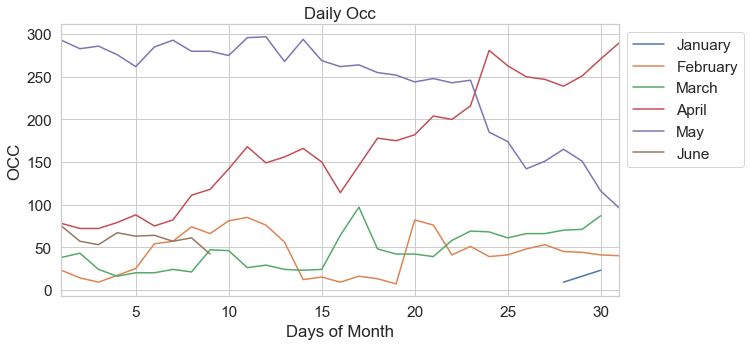

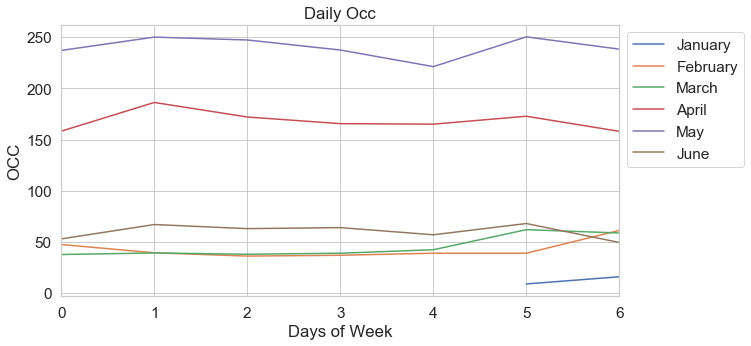



Test TS Analysis On 2019 NATURE ET RIVIÈRE Occ.




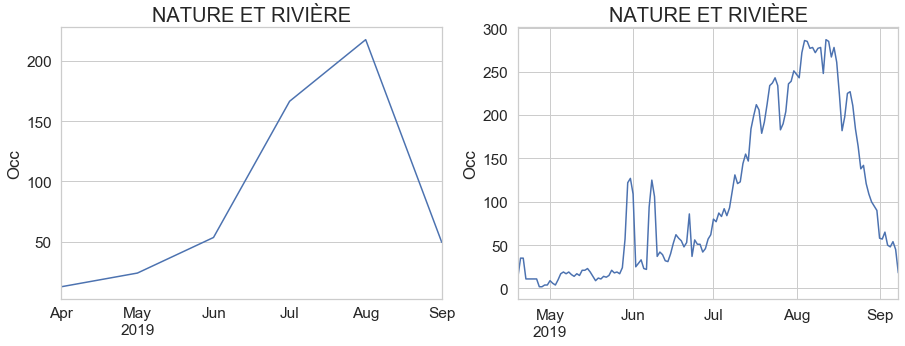

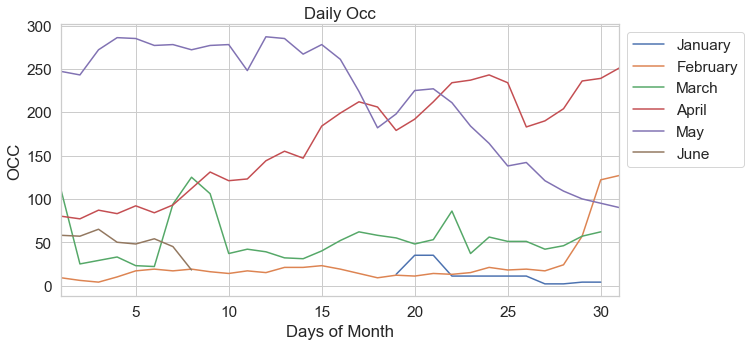

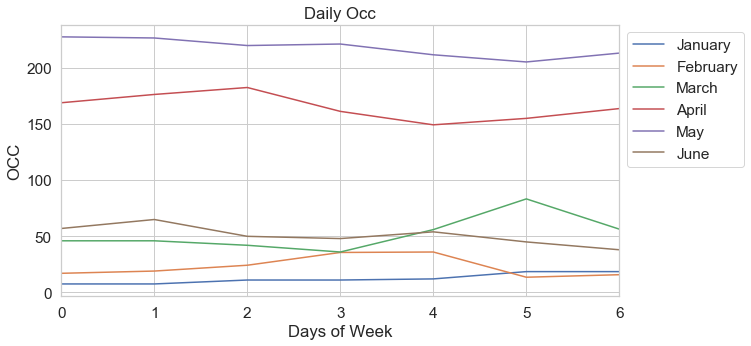

Dates range:
2018-04-28 00:00:00 - 2019-09-08 00:00:00

('X shape: ', (269, 9))
('y shape: ', (269,))
('X_train shape: ', (126, 9))
('X_test shape: ', (143, 9))
('y_train shape: ', (126,))
('y_test shape: ', (143,))
R2:	0.922
RMSE:	657.76


Train TS Analysis On 2018 DOMAINE DES BANS Occ.




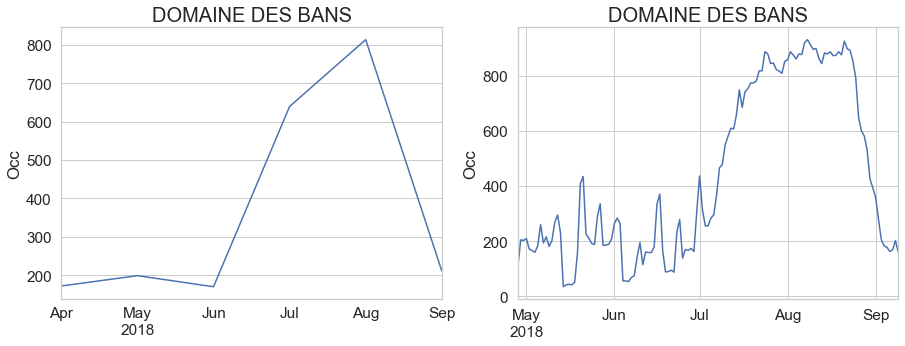

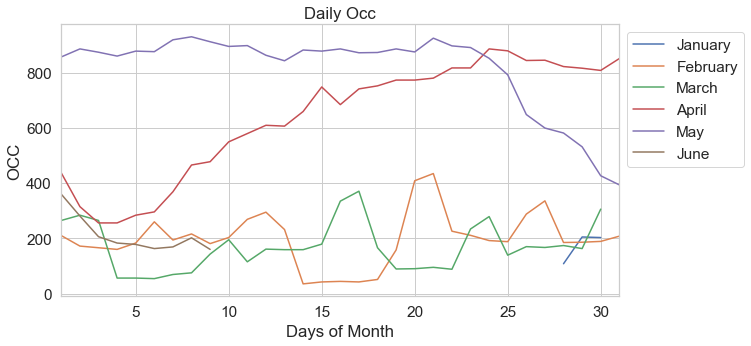

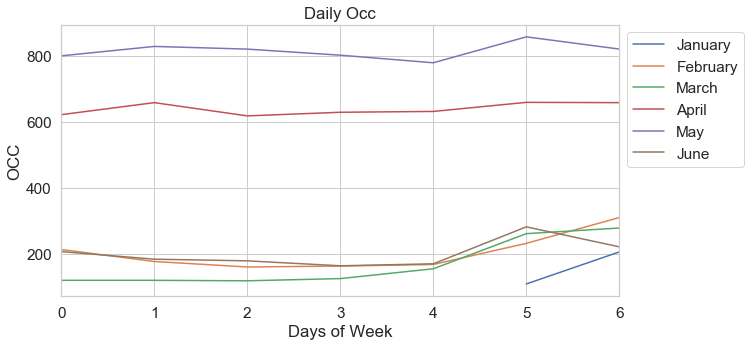



Test TS Analysis On 2019 DOMAINE DES BANS Occ.




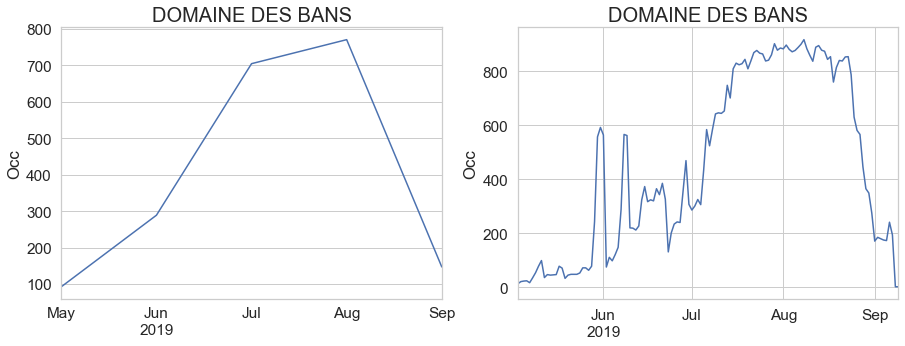

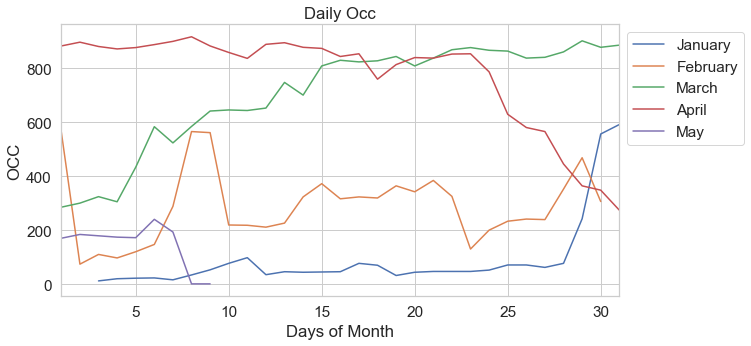

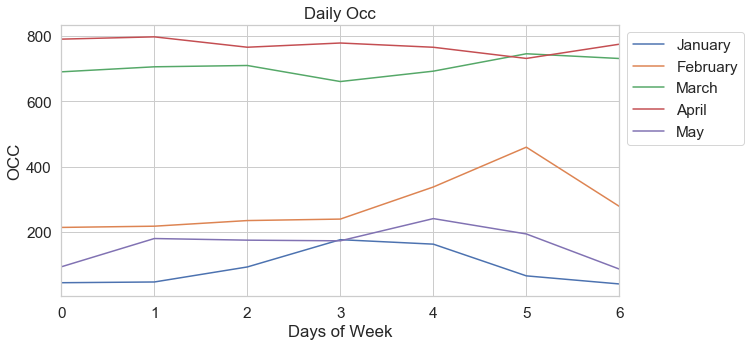

Dates range:
2018-04-28 00:00:00 - 2019-09-09 00:00:00

('X shape: ', (256, 9))
('y shape: ', (256,))
('X_train shape: ', (126, 9))
('X_test shape: ', (130, 9))
('y_train shape: ', (126,))
('y_test shape: ', (130,))
R2:	0.923
RMSE:	8143.89


Train TS Analysis On 2018 BOIS DU CHATELAS Occ.




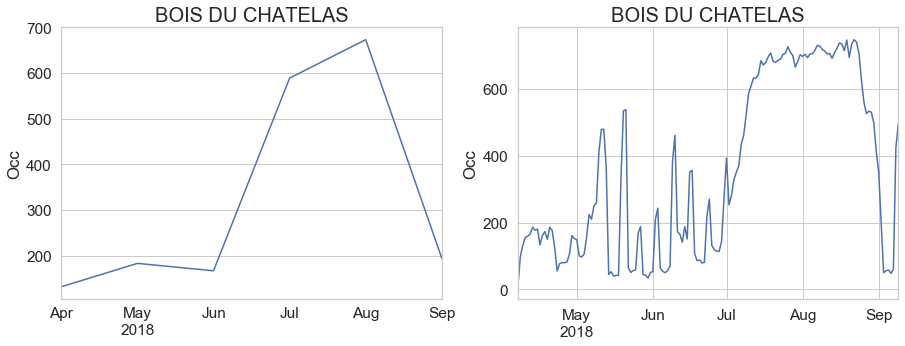

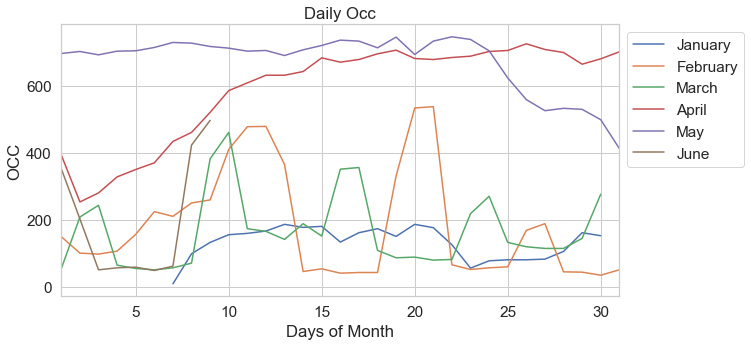

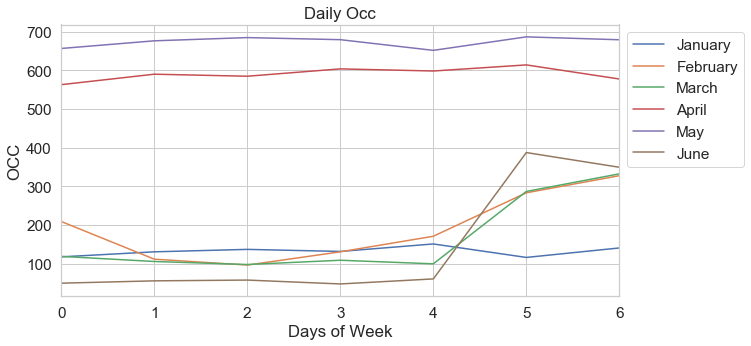



Test TS Analysis On 2019 BOIS DU CHATELAS Occ.




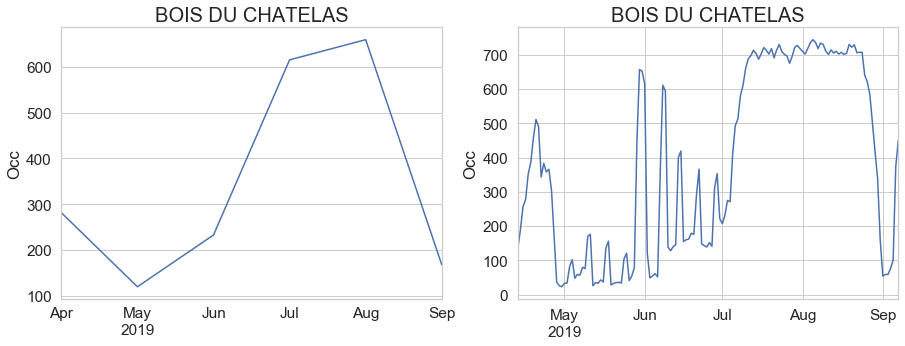

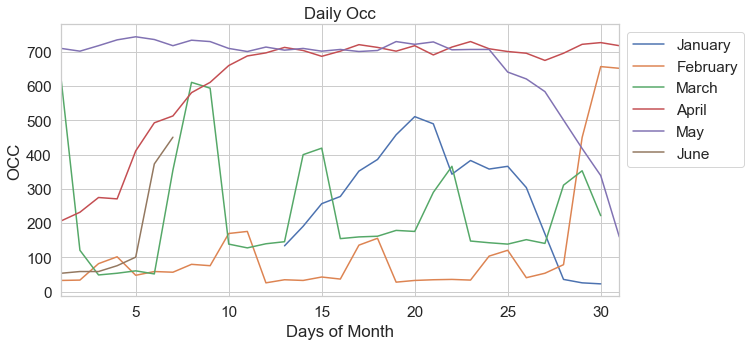

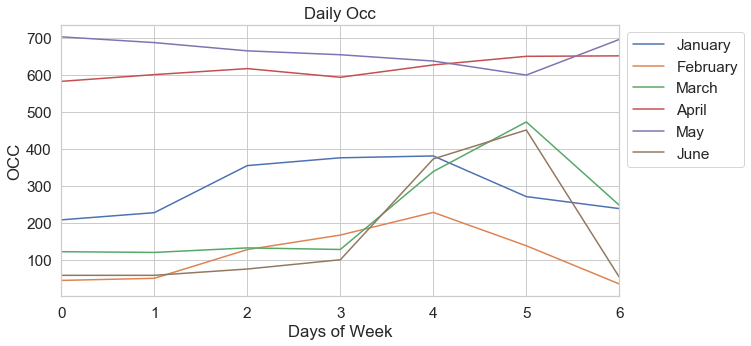

Dates range:
2018-04-07 00:00:00 - 2019-09-07 00:00:00

('X shape: ', (295, 9))
('y shape: ', (295,))
('X_train shape: ', (147, 9))
('X_test shape: ', (148, 9))
('y_train shape: ', (147,))
('y_test shape: ', (148,))
R2:	0.876
RMSE:	9127.83


Train TS Analysis On 2018 RAMIERES Occ.




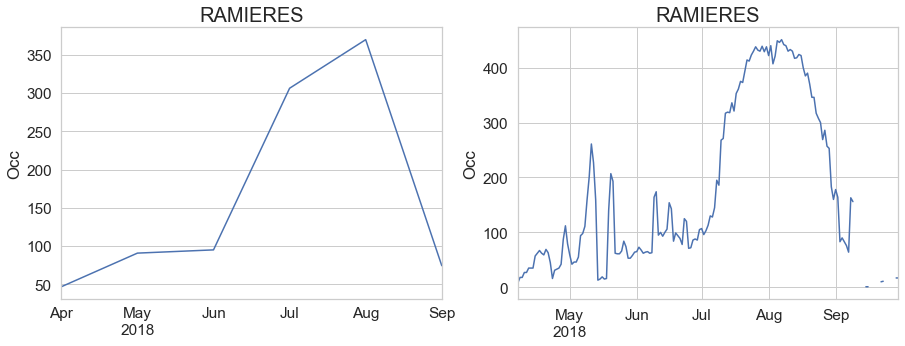

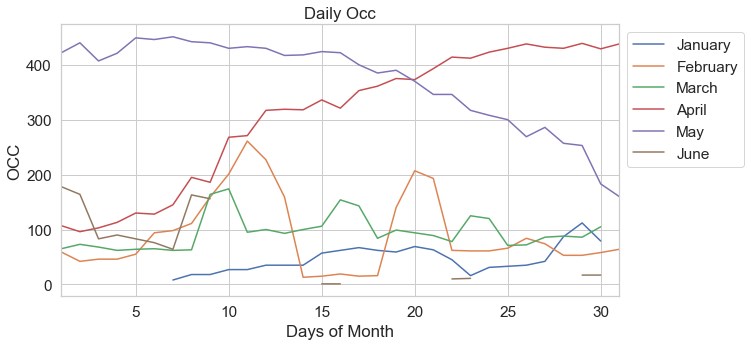

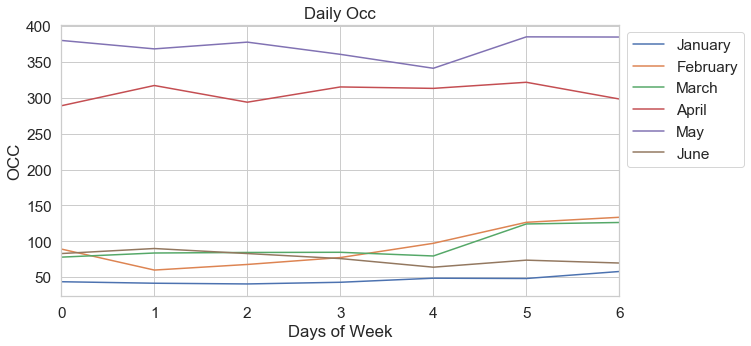



Test TS Analysis On 2019 RAMIERES Occ.




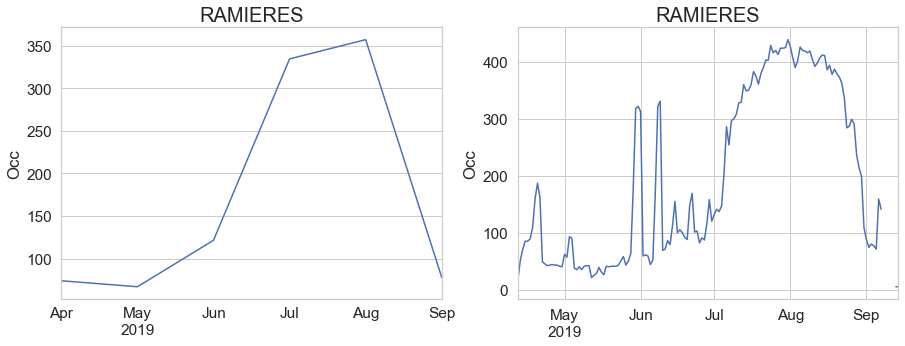

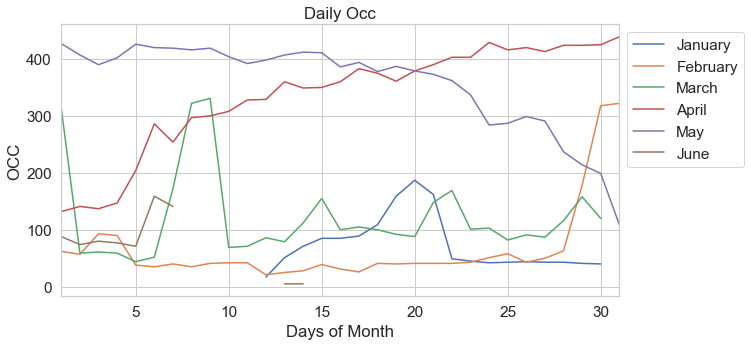

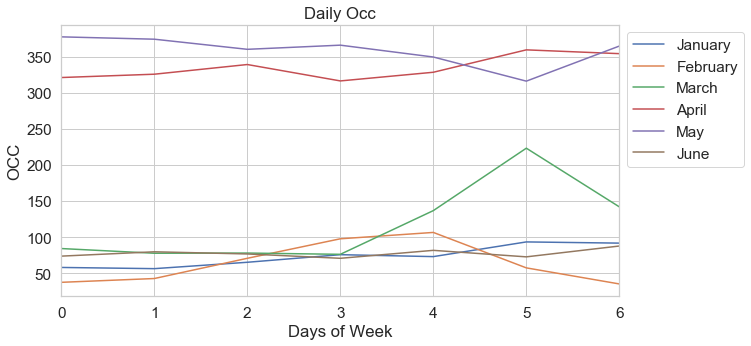

Dates range:
2018-04-07 00:00:00 - 2019-09-14 00:00:00

('X shape: ', (304, 9))
('y shape: ', (304,))
('X_train shape: ', (153, 9))
('X_test shape: ', (151, 9))
('y_train shape: ', (153,))
('y_test shape: ', (151,))
R2:	0.908
RMSE:	2029.46


Train TS Analysis On 2018 CASTEL ROSE Occ.




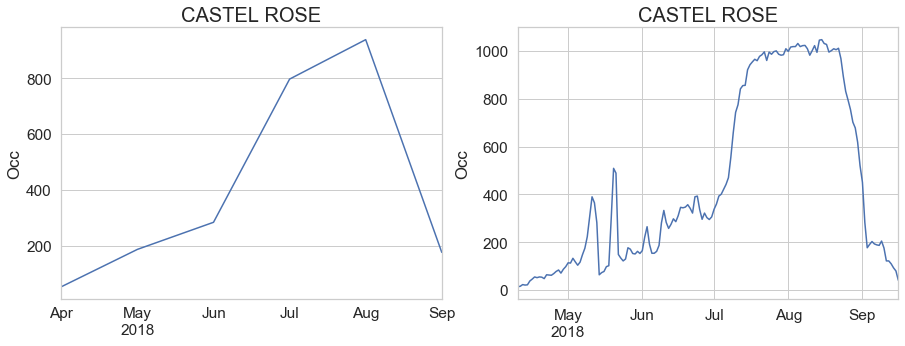

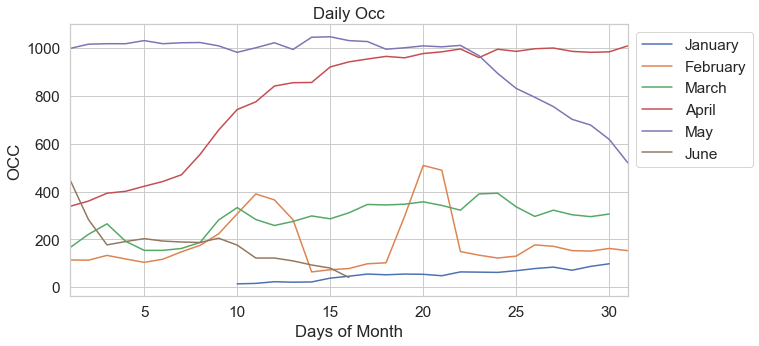

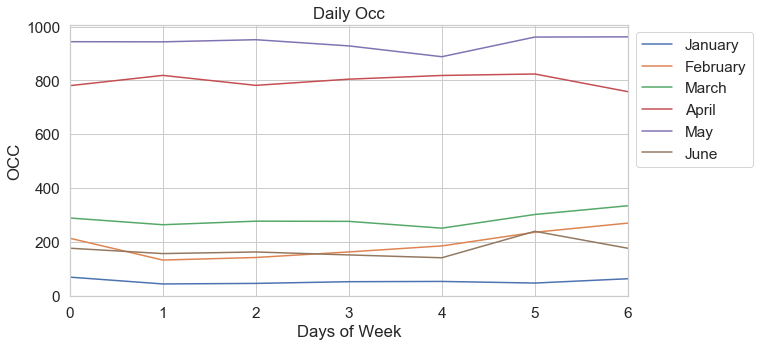



Test TS Analysis On 2019 CASTEL ROSE Occ.




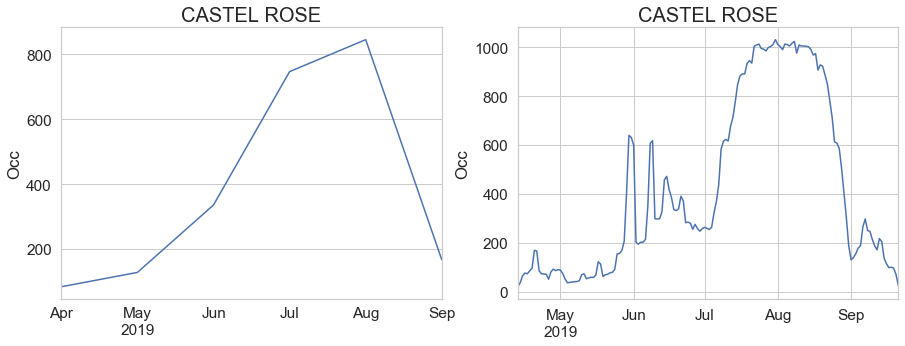

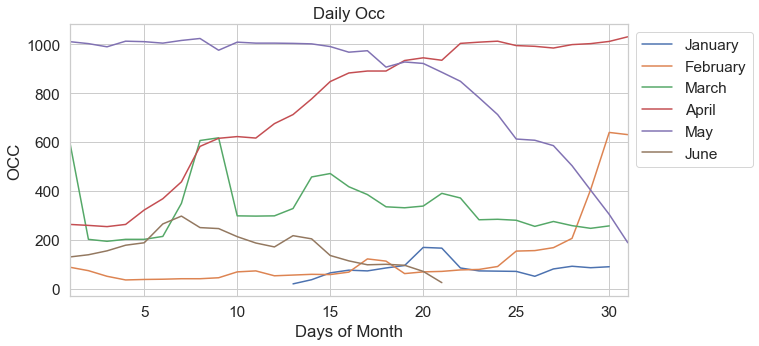

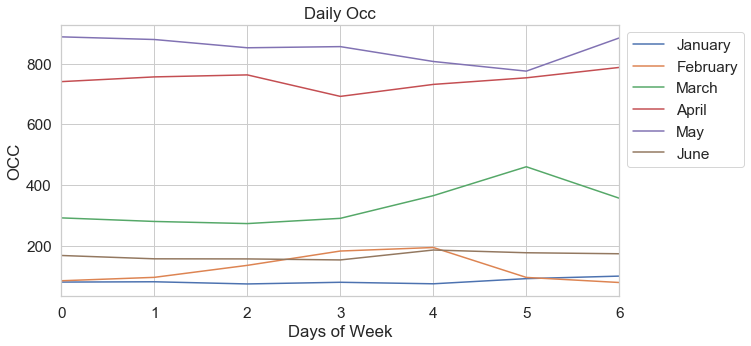

Dates range:
2018-04-10 00:00:00 - 2019-09-21 00:00:00

('X shape: ', (313, 9))
('y shape: ', (313,))
('X_train shape: ', (151, 9))
('X_test shape: ', (162, 9))
('y_train shape: ', (151,))
('y_test shape: ', (162,))
R2:	0.962
RMSE:	4731.54


Train TS Analysis On 2018 BELLE PLAGE Occ.




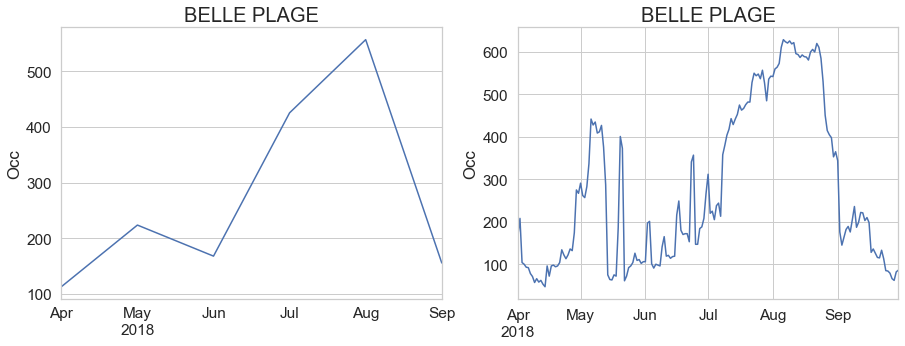

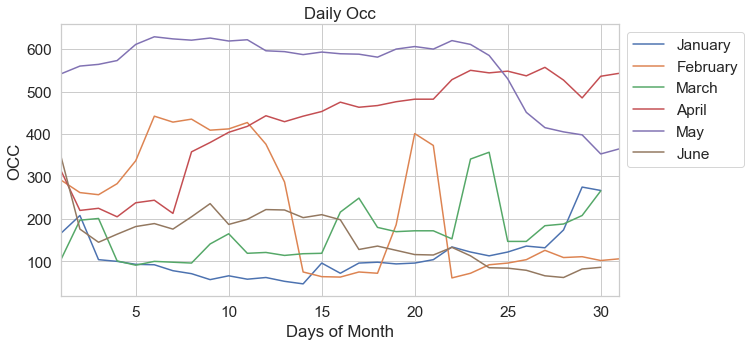

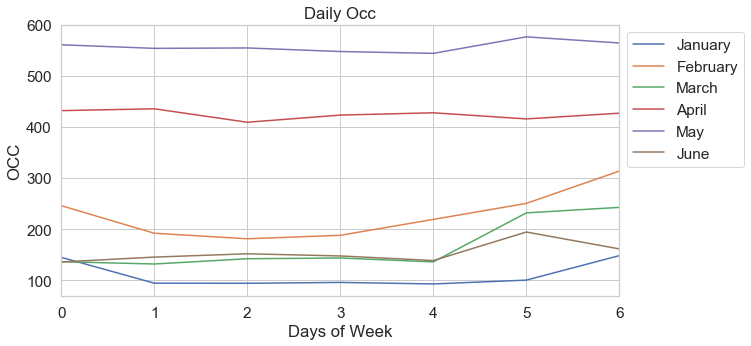



Test TS Analysis On 2019 BELLE PLAGE Occ.




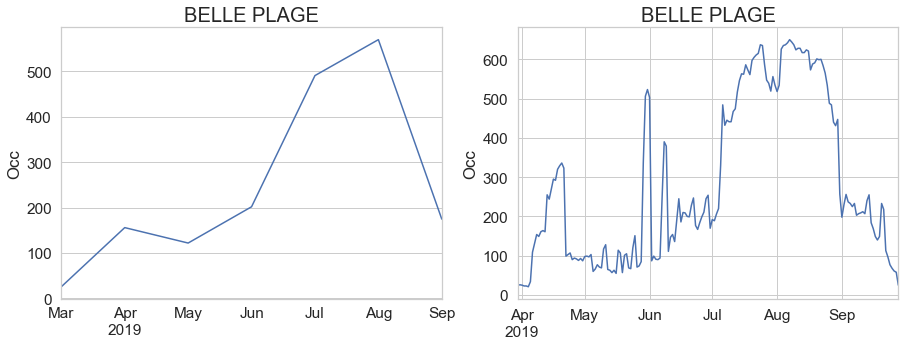

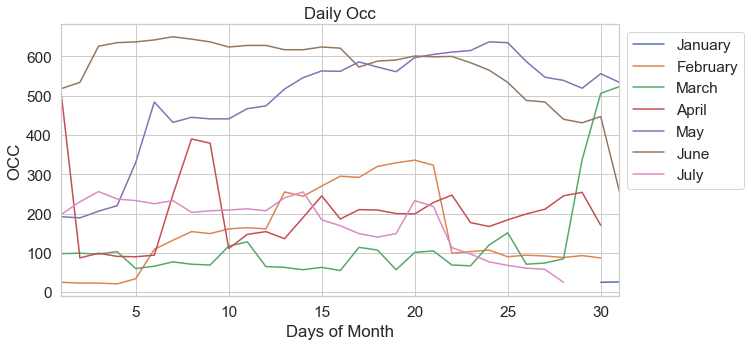

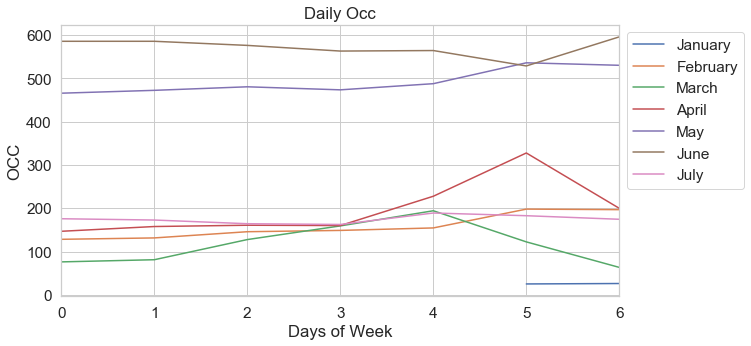

Dates range:
2018-04-01 00:00:00 - 2019-09-28 00:00:00

('X shape: ', (357, 9))
('y shape: ', (357,))
('X_train shape: ', (174, 9))
('X_test shape: ', (183, 9))
('y_train shape: ', (174,))
('y_test shape: ', (183,))
R2:	0.913
RMSE:	3640.21


Train TS Analysis On 2018 CHENAIE Occ.




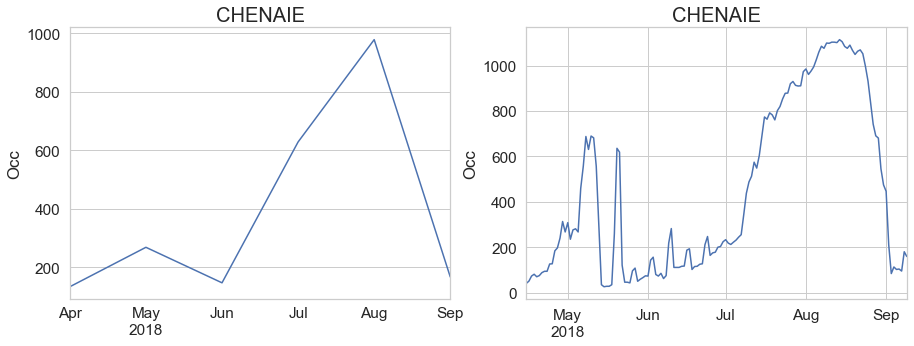

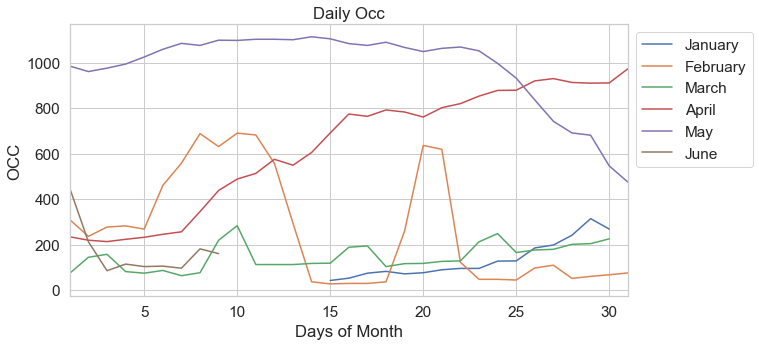

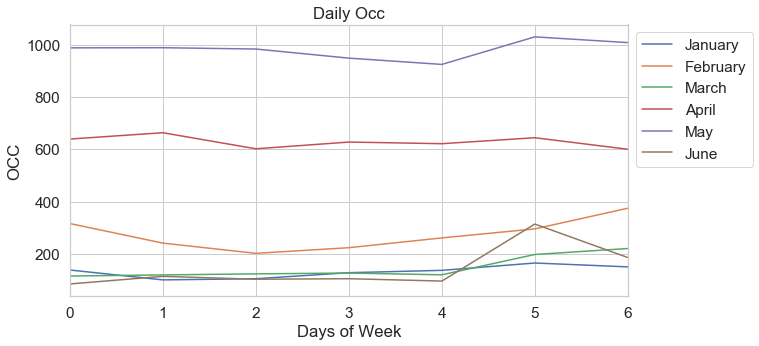



Test TS Analysis On 2019 CHENAIE Occ.




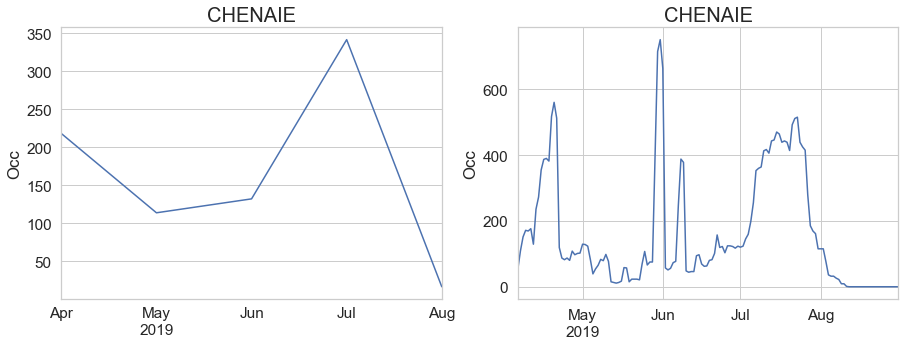

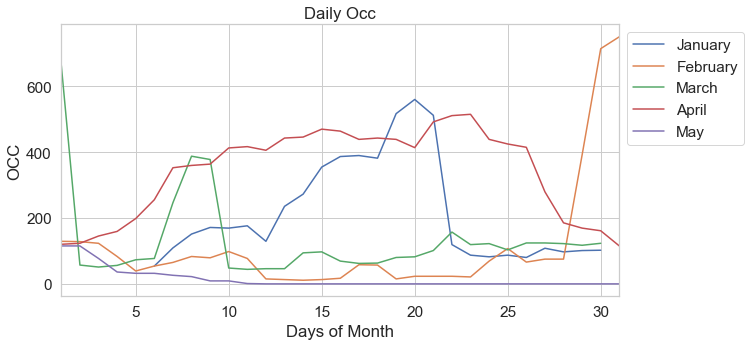

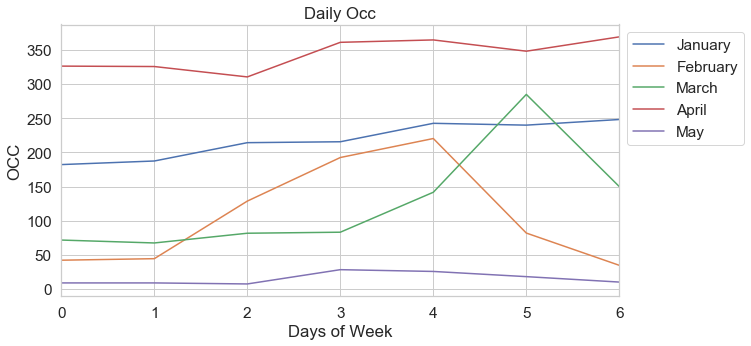

Dates range:
2018-04-15 00:00:00 - 2019-08-31 00:00:00

('X shape: ', (287, 9))
('y shape: ', (287,))
('X_train shape: ', (139, 9))
('X_test shape: ', (148, 9))
('y_train shape: ', (139,))
('y_test shape: ', (148,))
R2:	0.603
RMSE:	11945.42


Train TS Analysis On 2018 LOUS SEURROTS Occ.




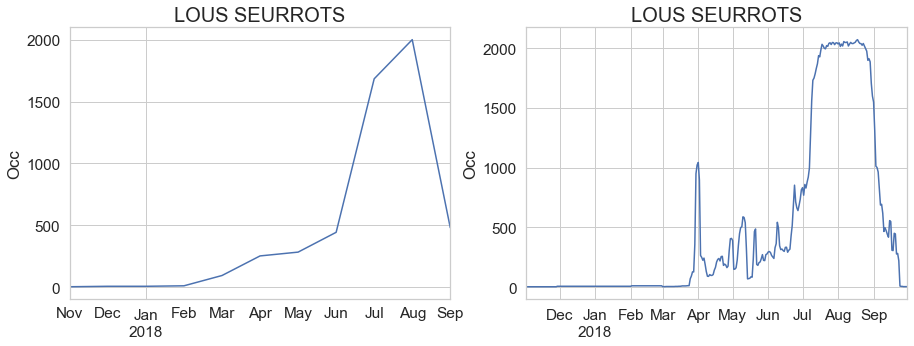

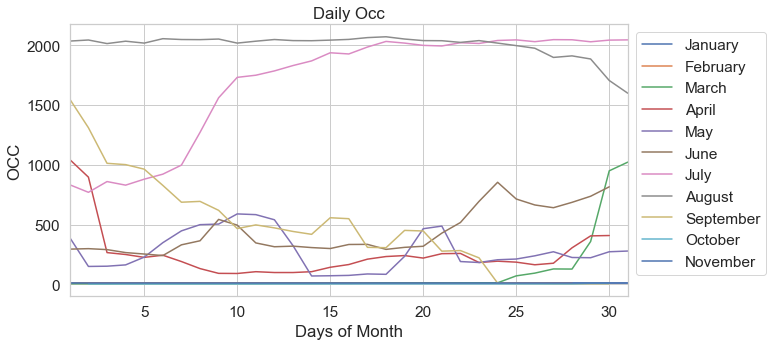

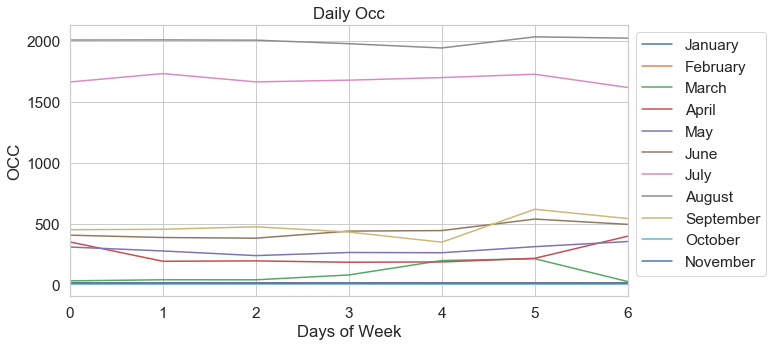



Test TS Analysis On 2019 LOUS SEURROTS Occ.




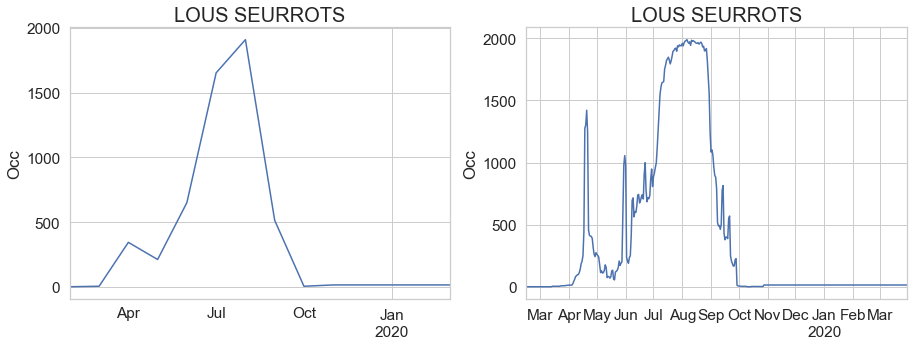

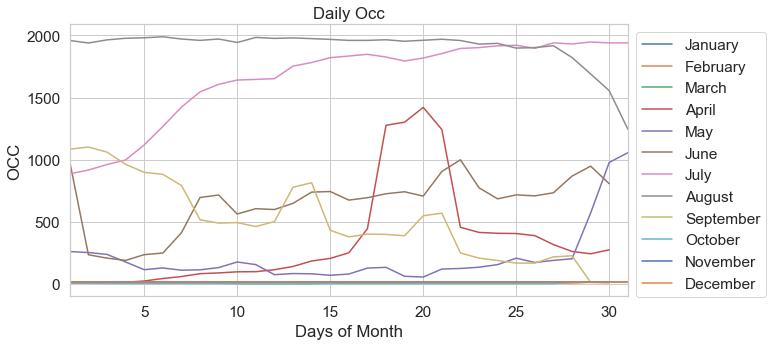

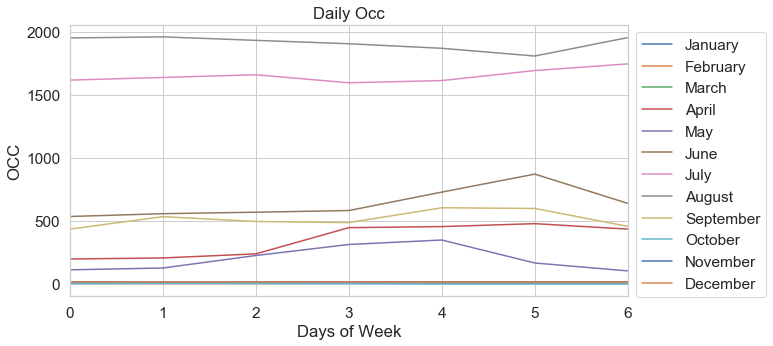

Dates range:
2017-11-02 00:00:00 - 2020-03-30 00:00:00

('X shape: ', (735, 9))
('y shape: ', (735,))
('X_train shape: ', (414, 9))
('X_test shape: ', (321, 9))
('y_train shape: ', (414,))
('y_test shape: ', (321,))
R2:	0.976
RMSE:	11506.77


Train TS Analysis On 2018 GRANGE DE MONTEILLAC Occ.




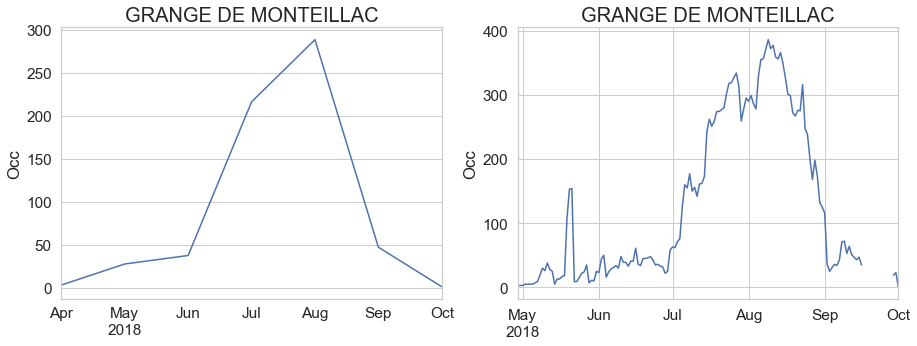

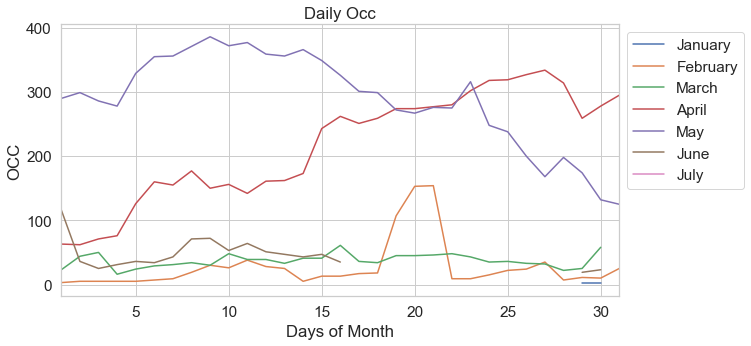

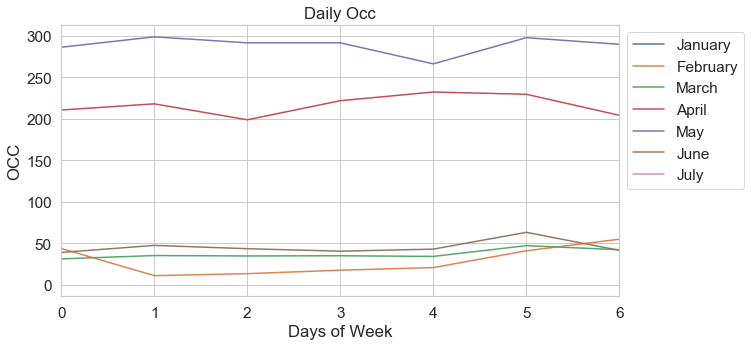



Test TS Analysis On 2019 GRANGE DE MONTEILLAC Occ.




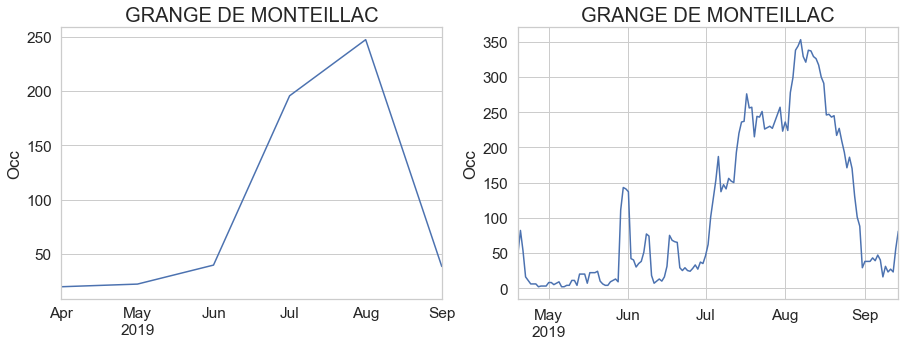

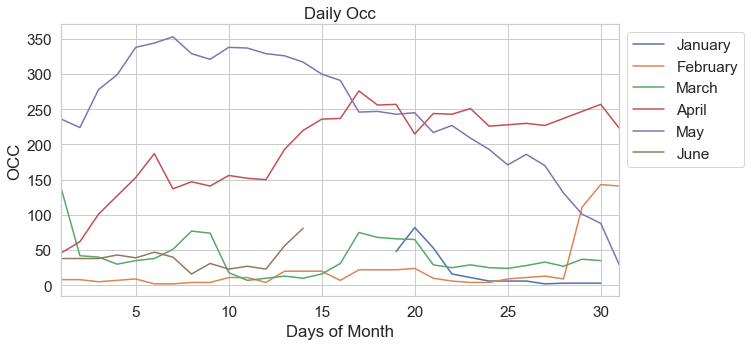

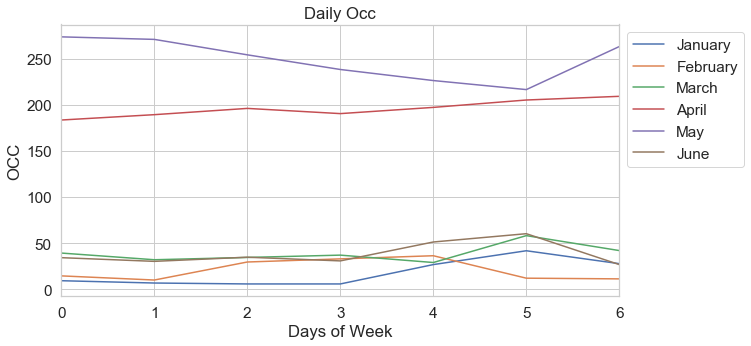

Dates range:
2018-04-29 00:00:00 - 2019-09-14 00:00:00

('X shape: ', (284, 9))
('y shape: ', (284,))
('X_train shape: ', (135, 9))
('X_test shape: ', (149, 9))
('y_train shape: ', (135,))
('y_test shape: ', (149,))
R2:	0.944
RMSE:	658.36


Train TS Analysis On 2018 LES 4 MONTAGNES Occ.




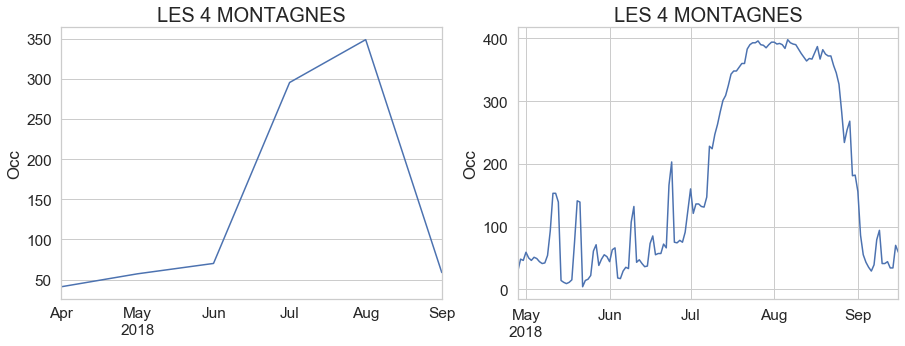

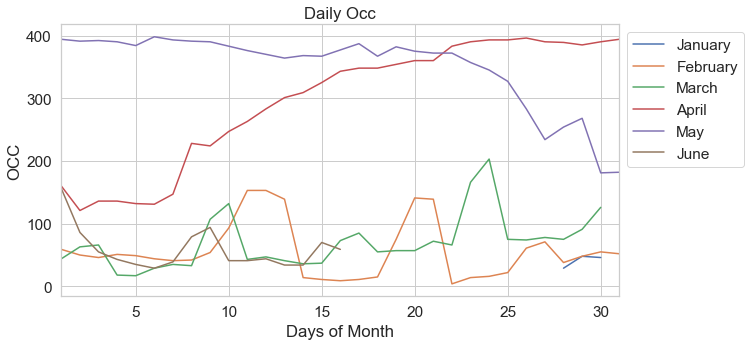

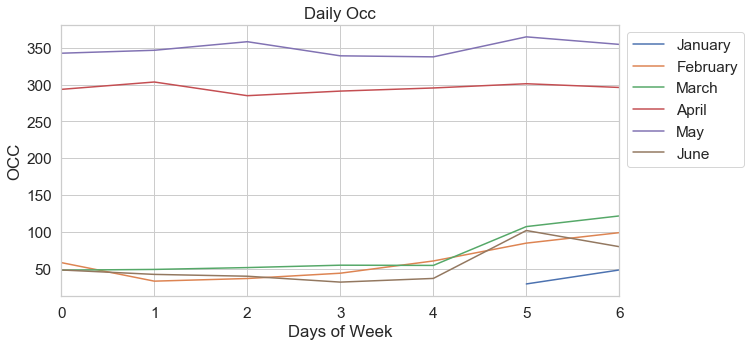



Test TS Analysis On 2019 LES 4 MONTAGNES Occ.




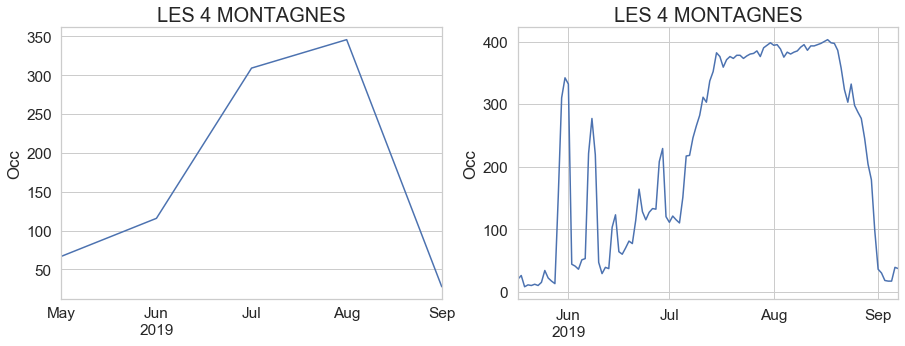

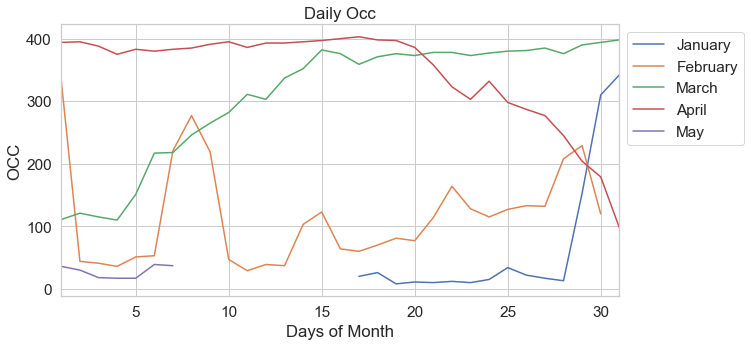

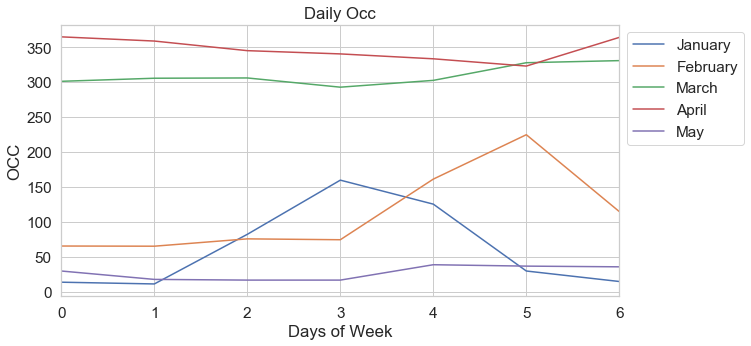

Dates range:
2018-04-28 00:00:00 - 2019-09-07 00:00:00

('X shape: ', (247, 9))
('y shape: ', (247,))
('X_train shape: ', (133, 9))
('X_test shape: ', (114, 9))
('y_train shape: ', (133,))
('y_test shape: ', (114,))
R2:	0.883
RMSE:	2563.13


Train TS Analysis On 2018 DOMAINE DE LA FORET Occ.




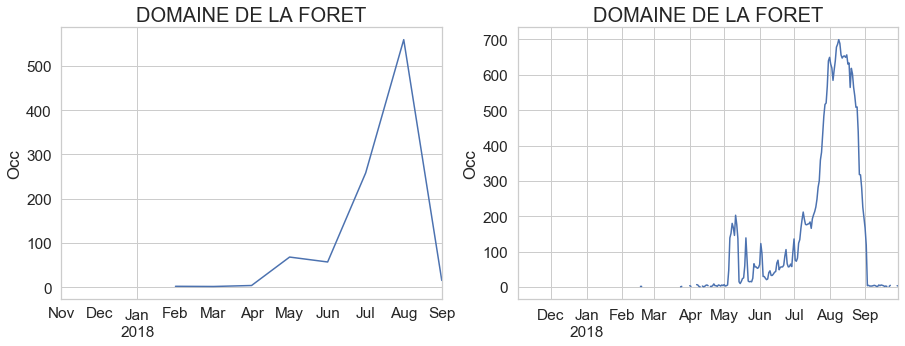

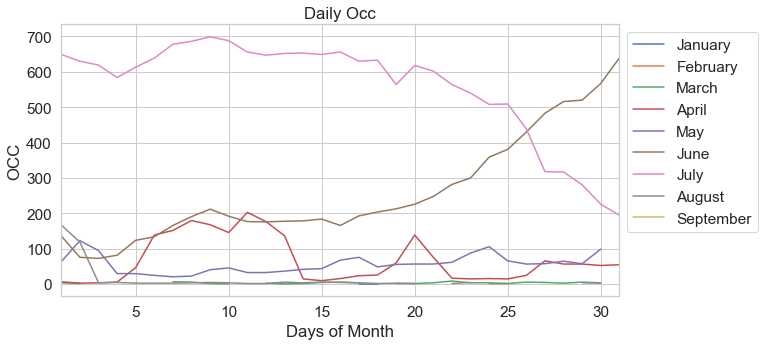

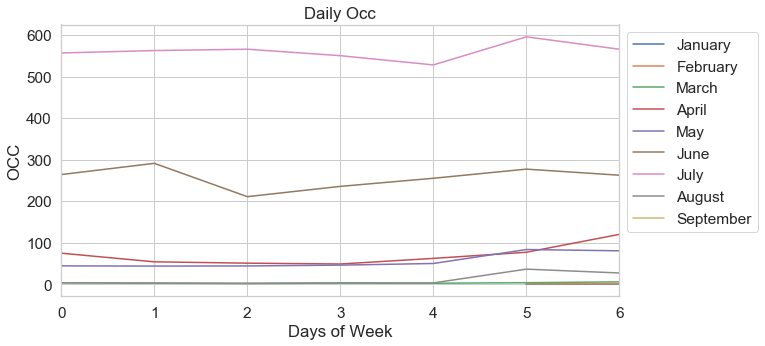



Test TS Analysis On 2019 DOMAINE DE LA FORET Occ.




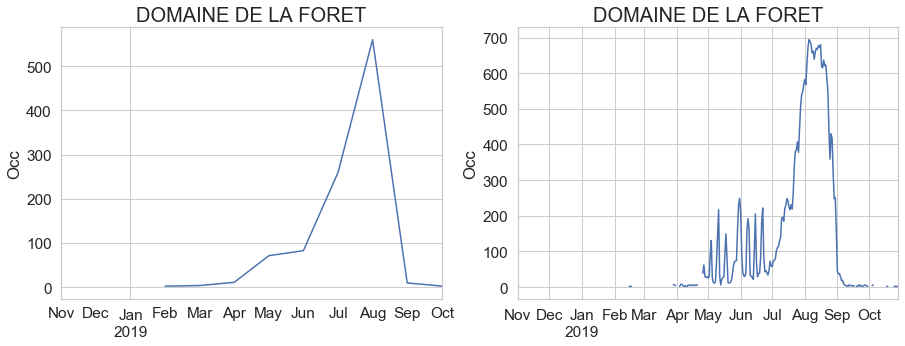

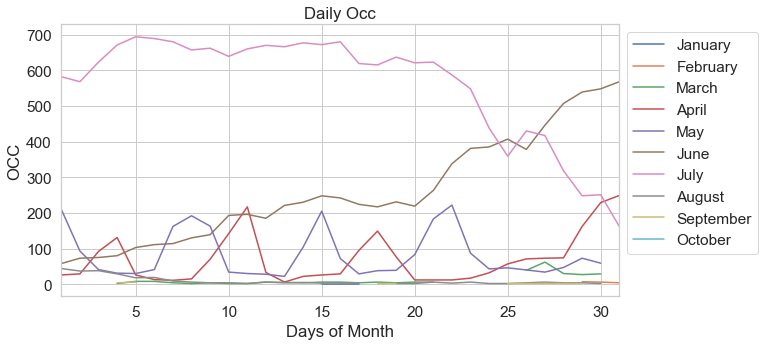

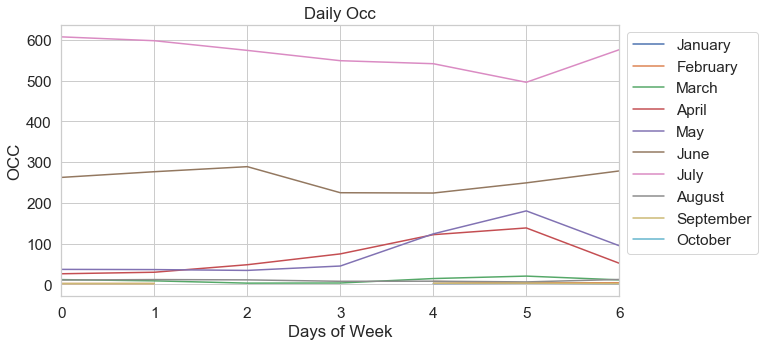

Dates range:
2017-11-02 00:00:00 - 2019-10-29 00:00:00

('X shape: ', (377, 9))
('y shape: ', (377,))
('X_train shape: ', (176, 9))
('X_test shape: ', (201, 9))
('y_train shape: ', (176,))
('y_test shape: ', (201,))
R2:	0.967
RMSE:	1496.1


Train TS Analysis On 2018 BALEARES SON BOU Occ.




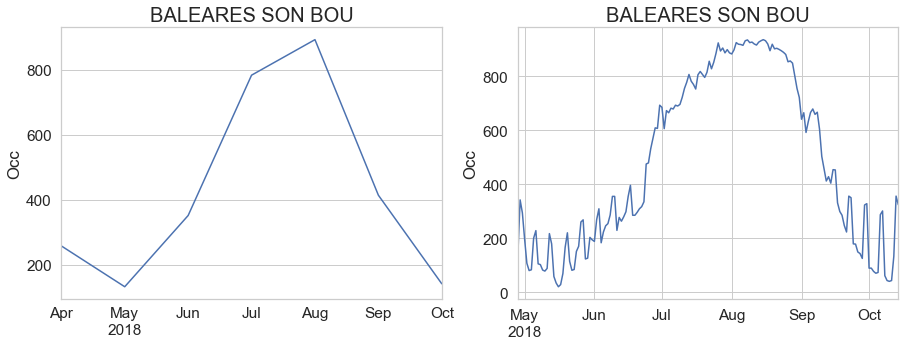

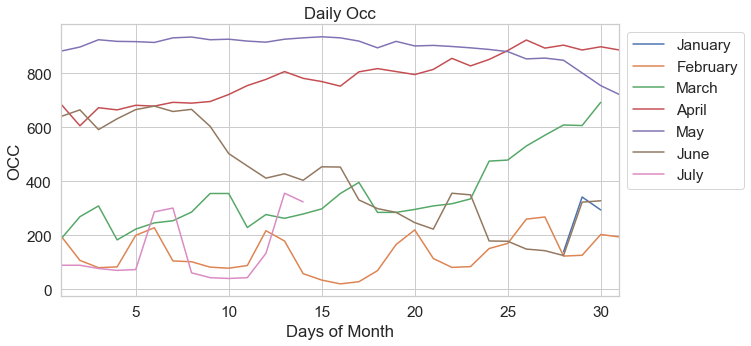

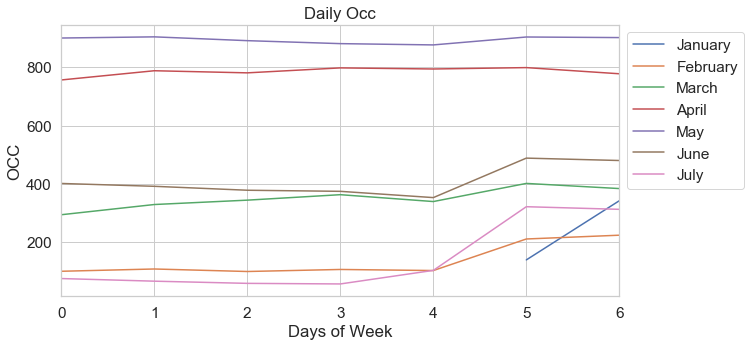



Test TS Analysis On 2019 BALEARES SON BOU Occ.




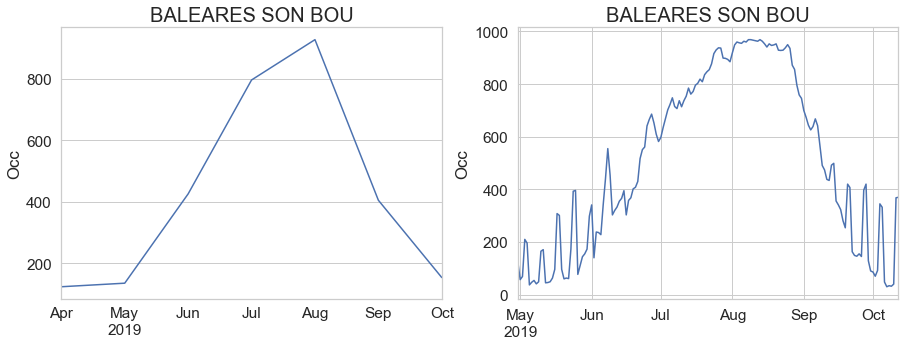

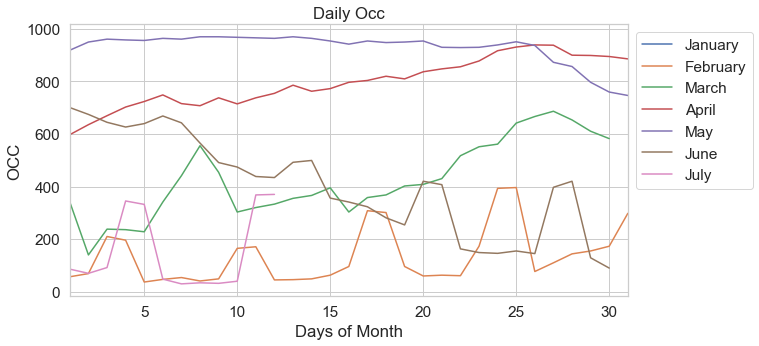

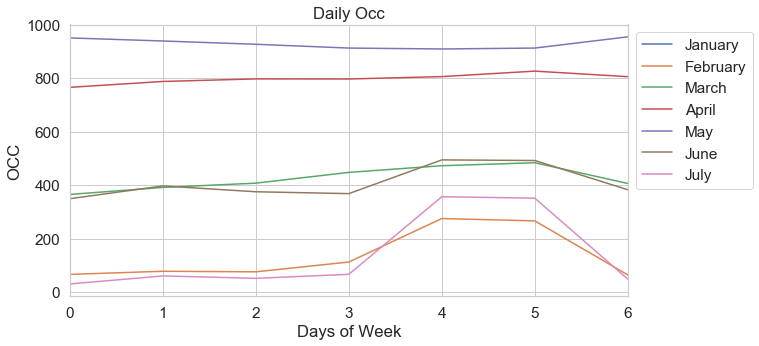

Dates range:
2018-04-28 00:00:00 - 2019-10-12 00:00:00

('X shape: ', (327, 9))
('y shape: ', (327,))
('X_train shape: ', (161, 9))
('X_test shape: ', (166, 9))
('y_train shape: ', (161,))
('y_test shape: ', (166,))
R2:	0.968
RMSE:	3257.45


Train TS Analysis On 2018 SOLEIL VIVARAIS Occ.




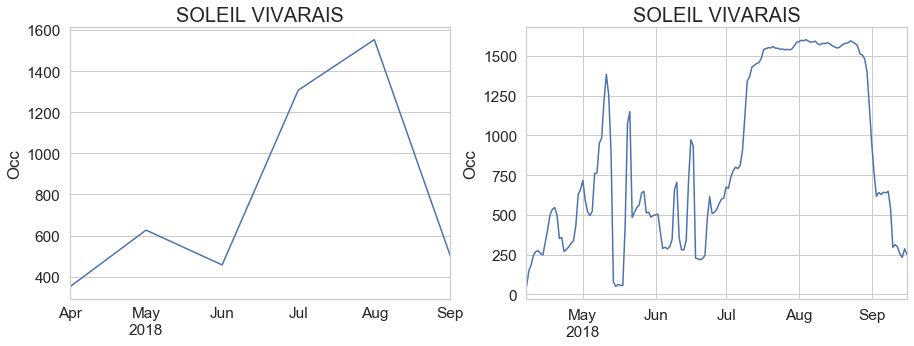

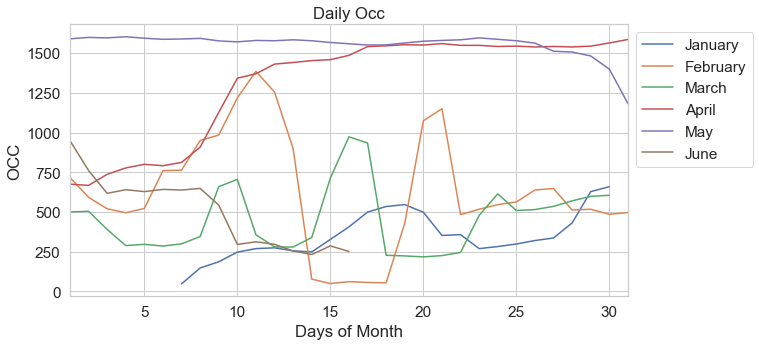

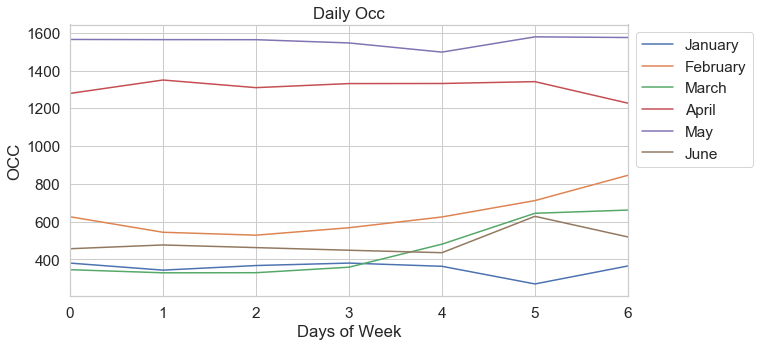



Test TS Analysis On 2019 SOLEIL VIVARAIS Occ.




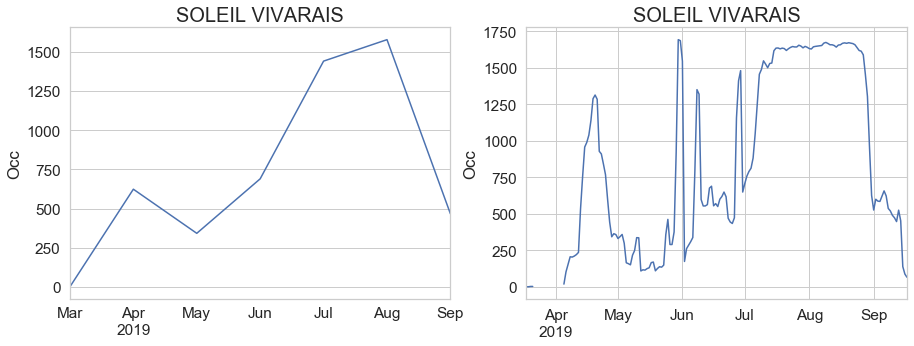

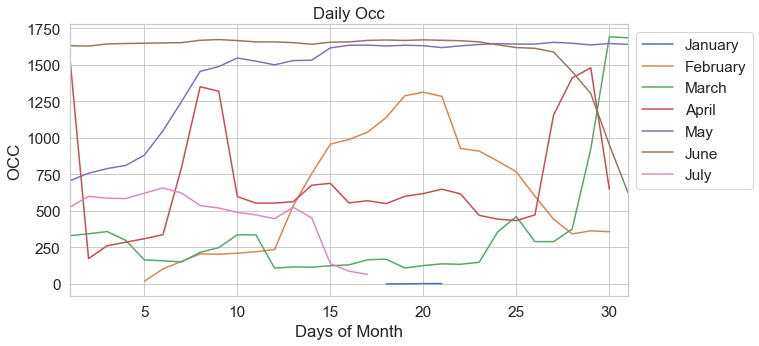

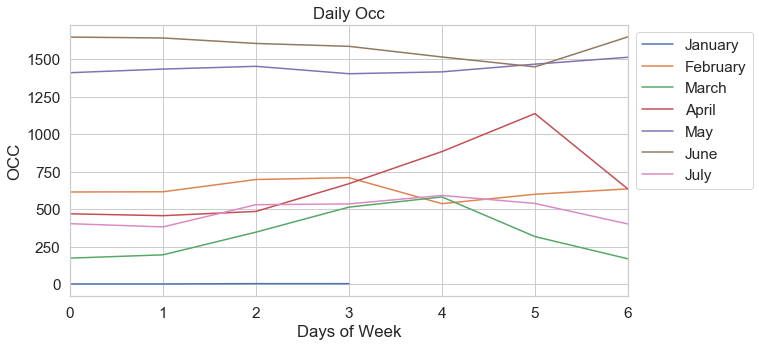

Dates range:
2018-04-07 00:00:00 - 2019-09-17 00:00:00

('X shape: ', (325, 9))
('y shape: ', (325,))
('X_train shape: ', (154, 9))
('X_test shape: ', (171, 9))
('y_train shape: ', (154,))
('y_test shape: ', (171,))
R2:	0.853
RMSE:	52746.12


Train TS Analysis On 2018 PARC DE MONTSABERT Occ.




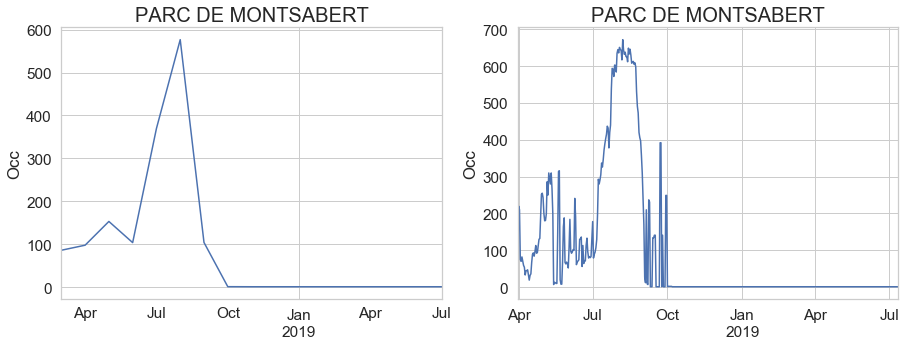

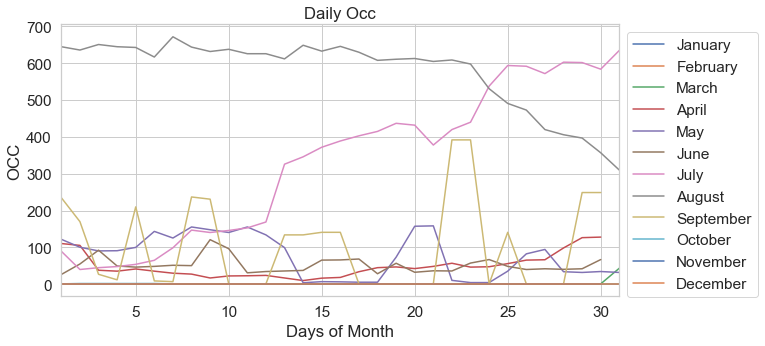

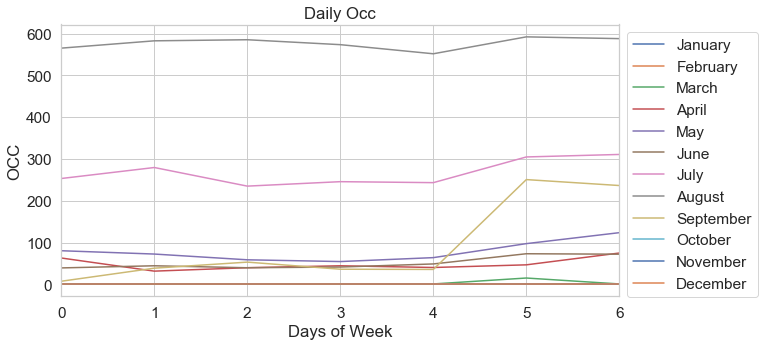



Test TS Analysis On 2019 PARC DE MONTSABERT Occ.




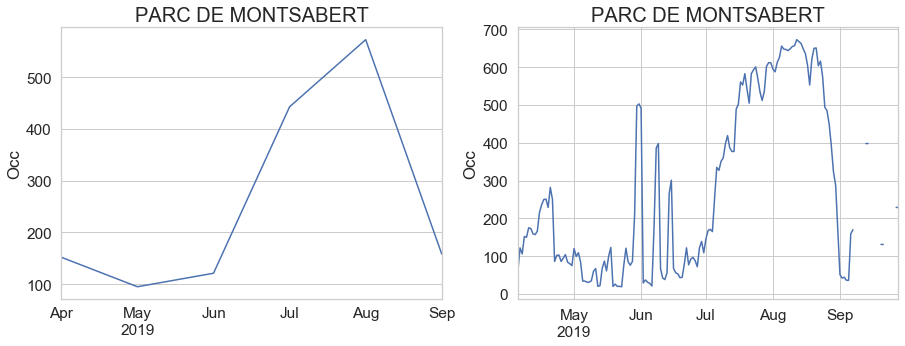

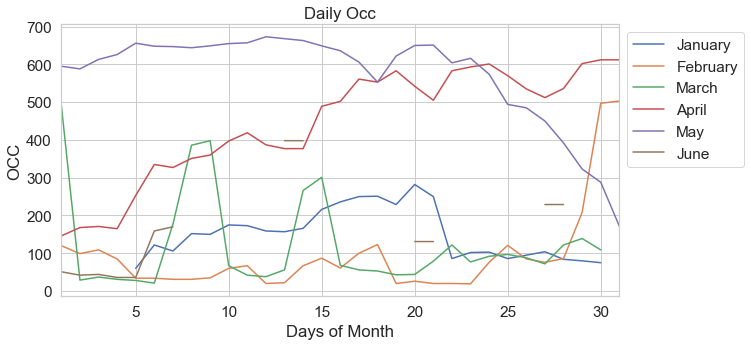

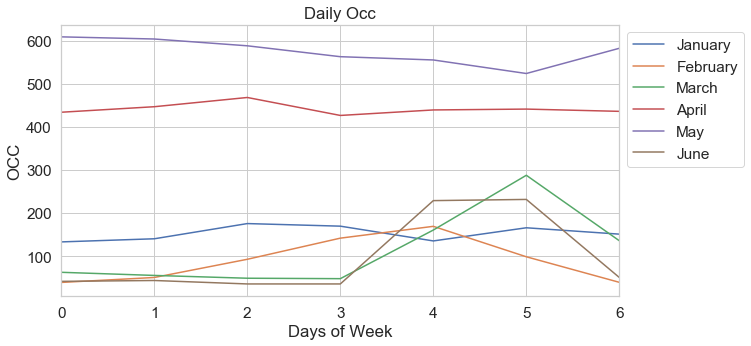

Dates range:
2018-03-31 00:00:00 - 2019-09-28 00:00:00

('X shape: ', (622, 9))
('y shape: ', (622,))
('X_train shape: ', (267, 9))
('X_test shape: ', (355, 9))
('y_train shape: ', (267,))
('y_test shape: ', (355,))
R2:	0.931
RMSE:	2857.25


Train TS Analysis On 2018 MOUETTES Occ.




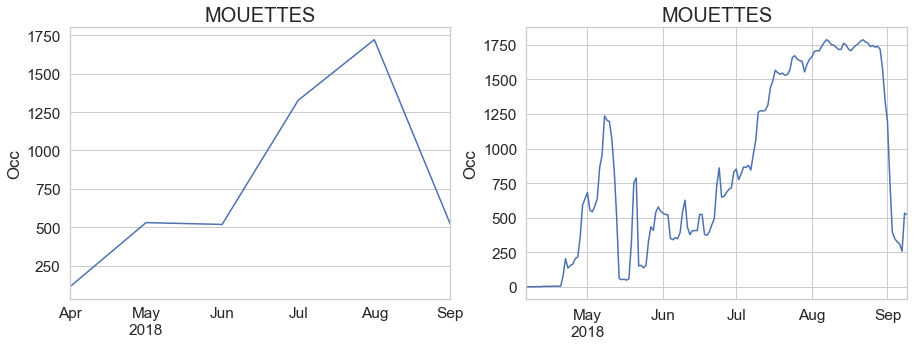

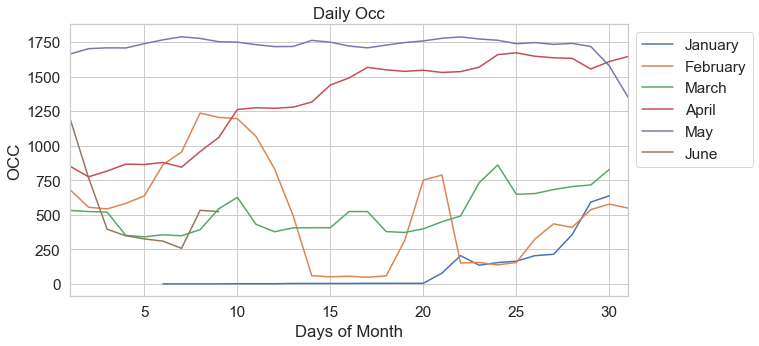

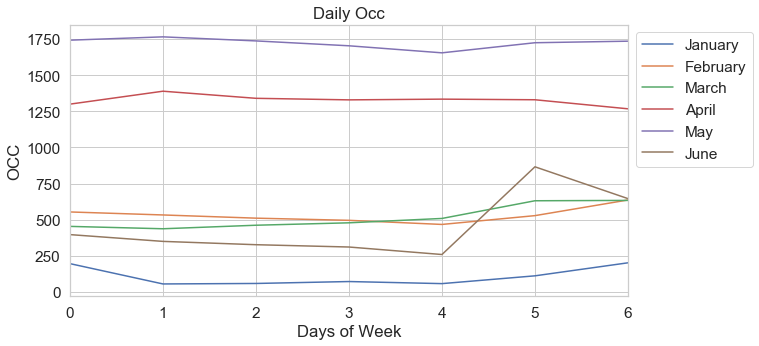



Test TS Analysis On 2019 MOUETTES Occ.




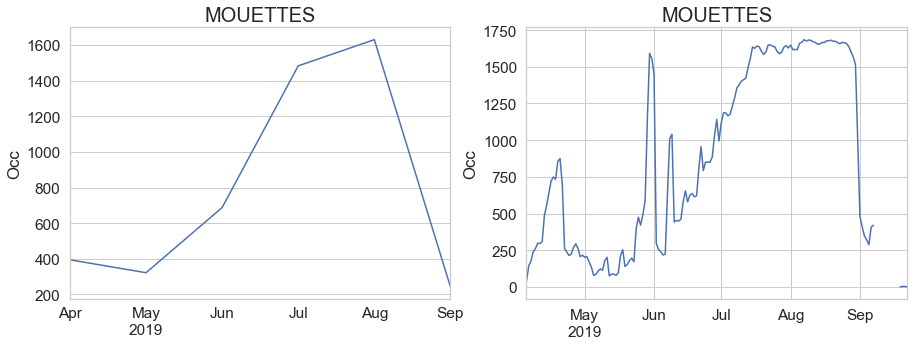

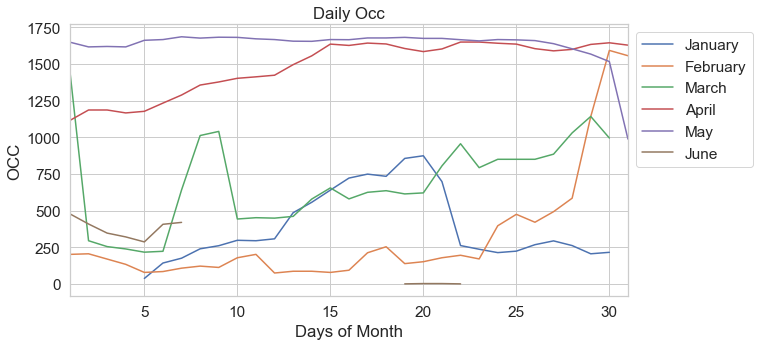

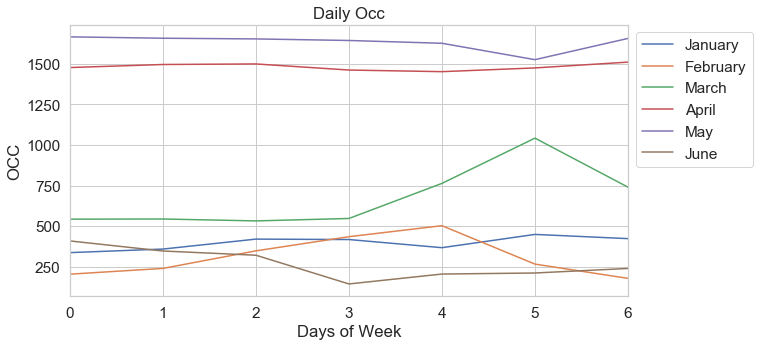

Dates range:
2018-04-06 00:00:00 - 2019-09-22 00:00:00

('X shape: ', (308, 9))
('y shape: ', (308,))
('X_train shape: ', (148, 9))
('X_test shape: ', (160, 9))
('y_train shape: ', (148,))
('y_test shape: ', (160,))
R2:	0.911
RMSE:	33885.02


Train TS Analysis On 2018 PORT DE PLAISANCE Occ.




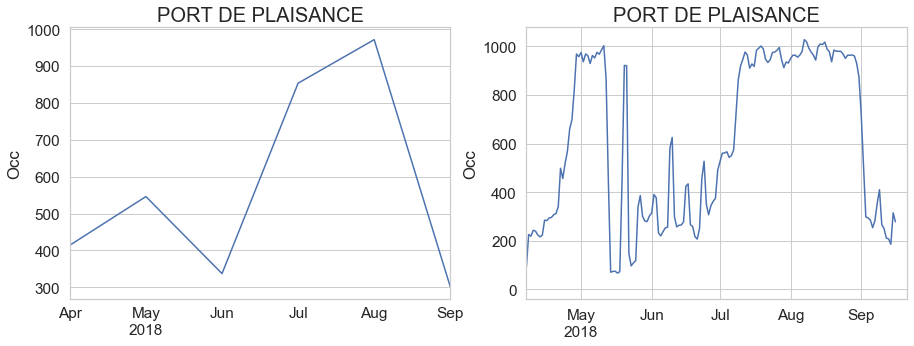

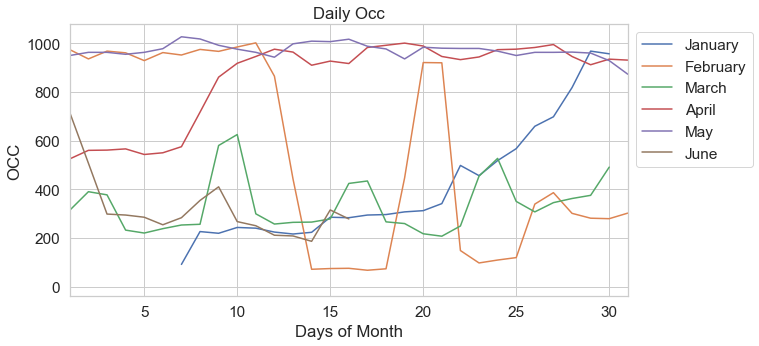

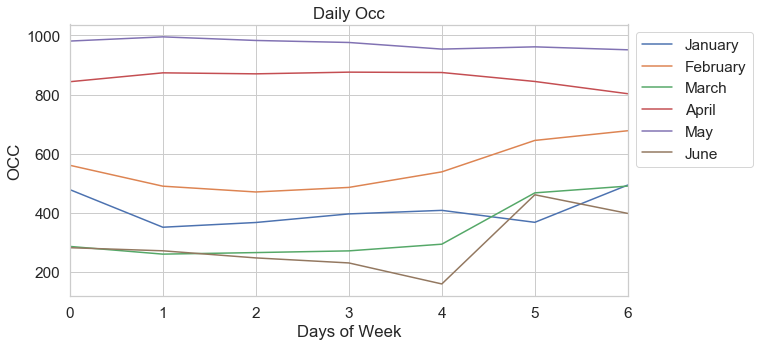



Test TS Analysis On 2019 PORT DE PLAISANCE Occ.




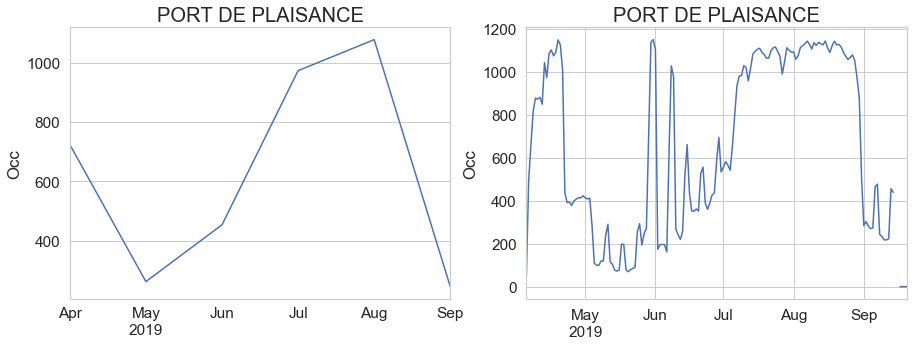

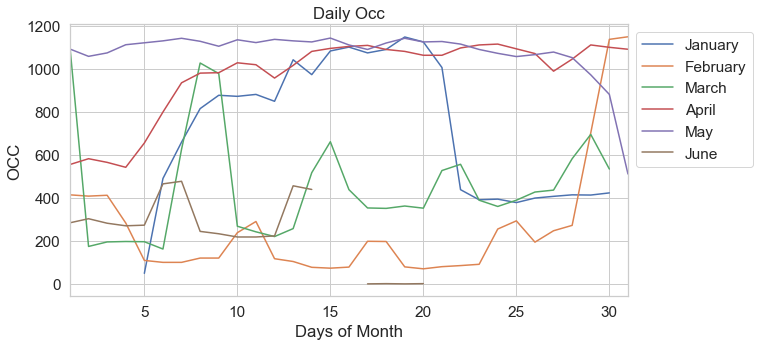

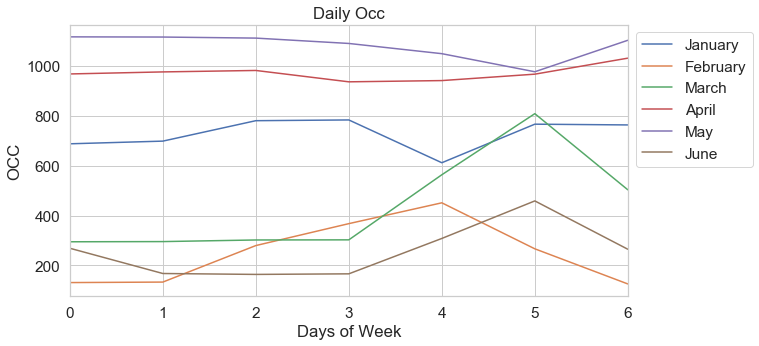

Dates range:
2018-04-07 00:00:00 - 2019-09-20 00:00:00

('X shape: ', (322, 9))
('y shape: ', (322,))
('X_train shape: ', (155, 9))
('X_test shape: ', (167, 9))
('y_train shape: ', (155,))
('y_test shape: ', (167,))
R2:	0.818
RMSE:	28693.89


Train TS Analysis On 2018 COUSPEAU Occ.




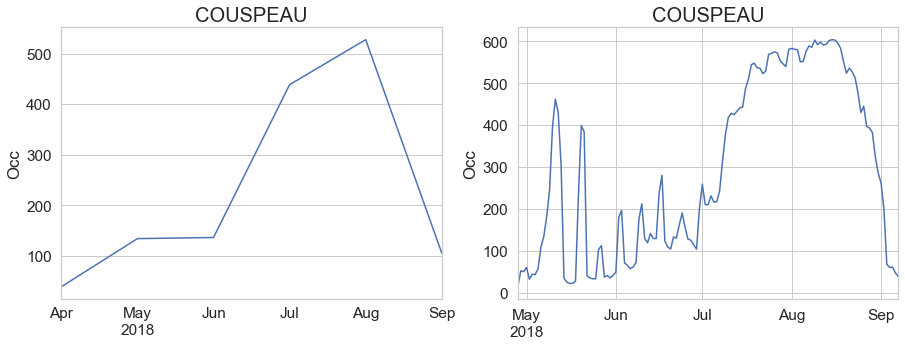

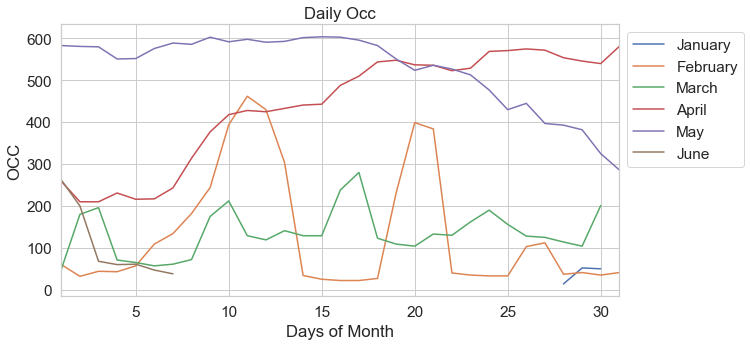

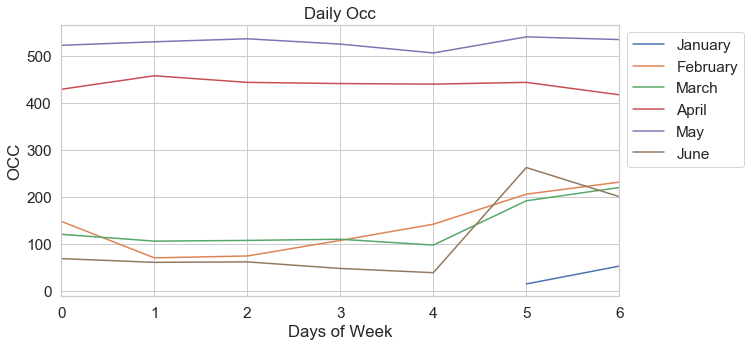



Test TS Analysis On 2019 COUSPEAU Occ.




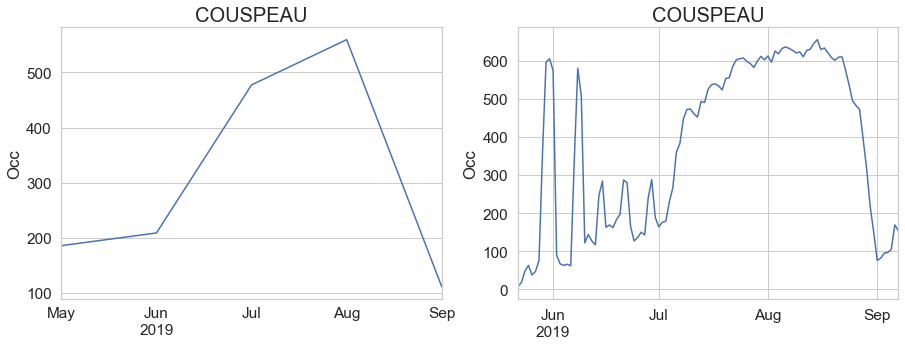

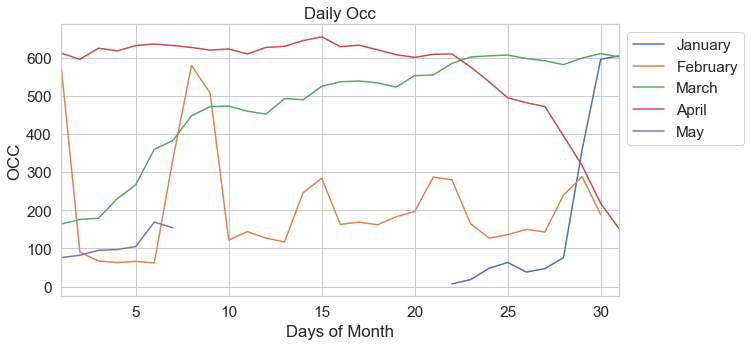

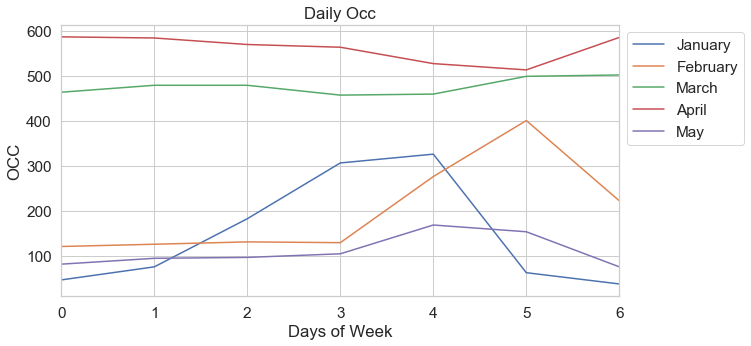

Dates range:
2018-04-28 00:00:00 - 2019-09-07 00:00:00

('X shape: ', (233, 9))
('y shape: ', (233,))
('X_train shape: ', (124, 9))
('X_test shape: ', (109, 9))
('y_train shape: ', (124,))
('y_test shape: ', (109,))
R2:	0.844
RMSE:	7462.32


Train TS Analysis On 2018 PLAINE Occ.




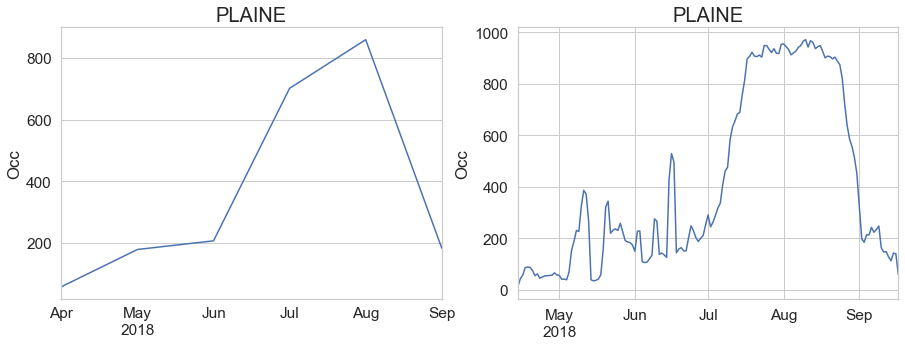

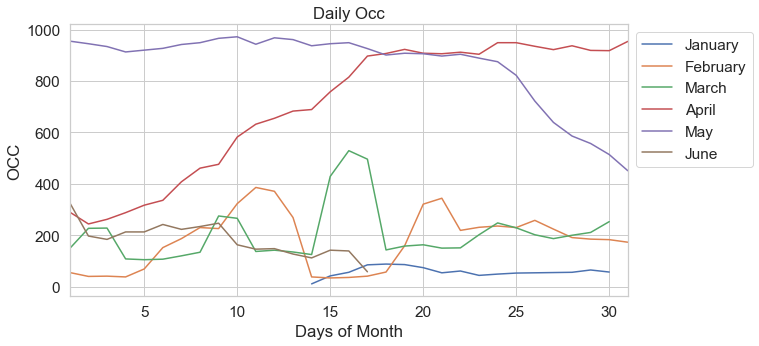

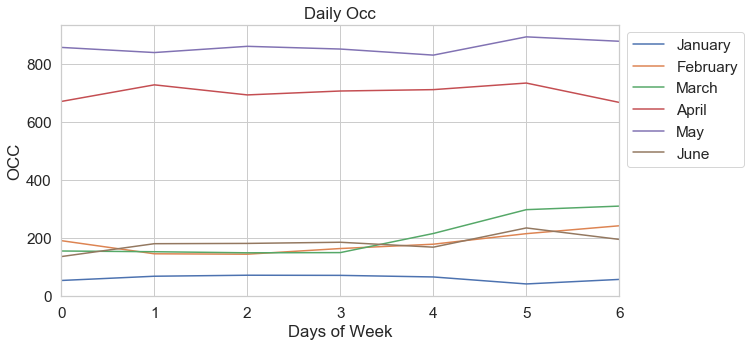



Test TS Analysis On 2019 PLAINE Occ.




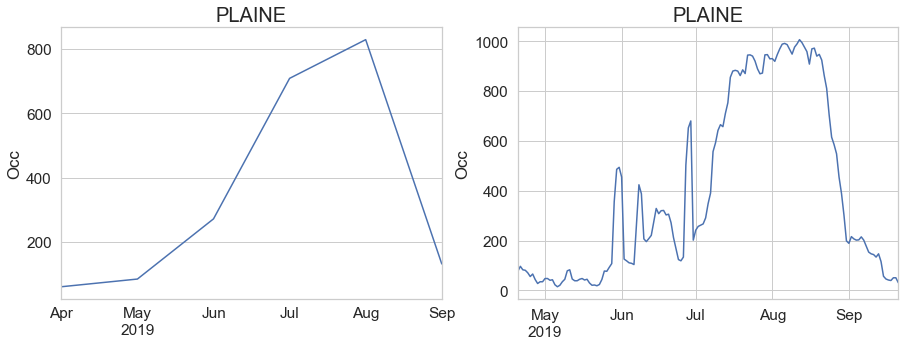

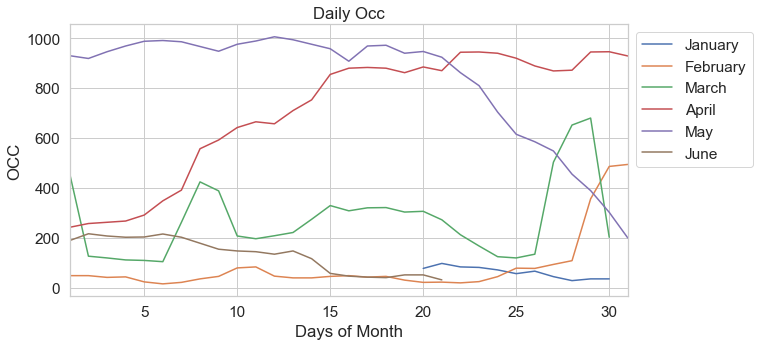

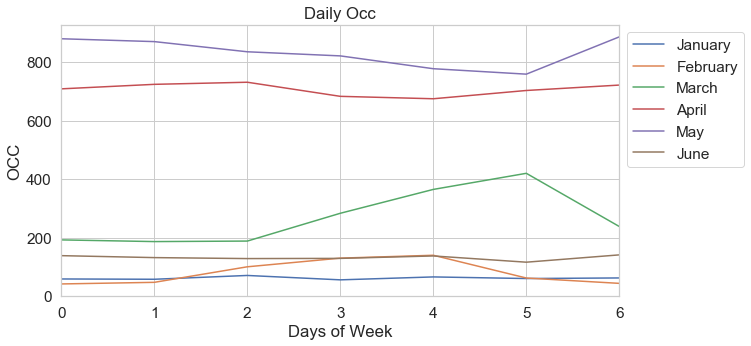

Dates range:
2018-04-14 00:00:00 - 2019-09-21 00:00:00

('X shape: ', (303, 9))
('y shape: ', (303,))
('X_train shape: ', (148, 9))
('X_test shape: ', (155, 9))
('y_train shape: ', (148,))
('y_test shape: ', (155,))
R2:	0.958
RMSE:	5314.02


Train TS Analysis On 2018 PRÉ BAS Occ.




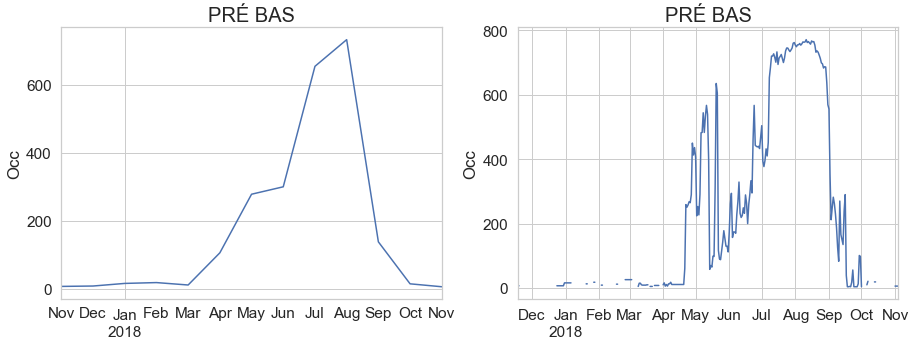

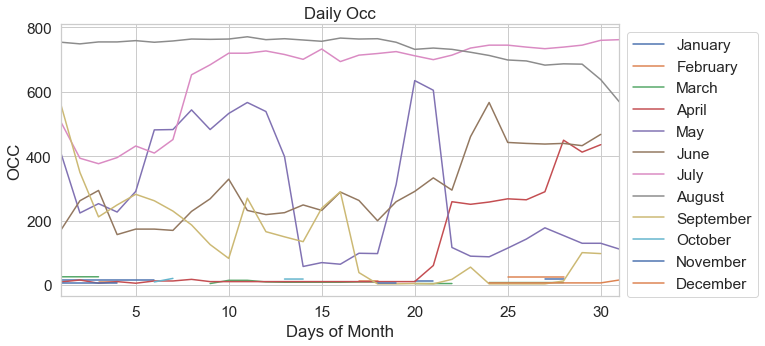

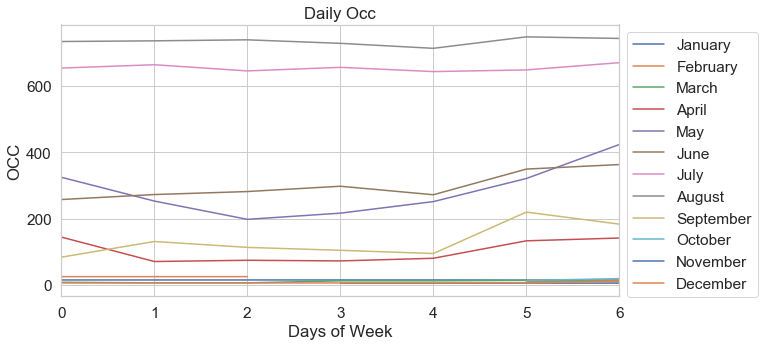



Test TS Analysis On 2019 PRÉ BAS Occ.




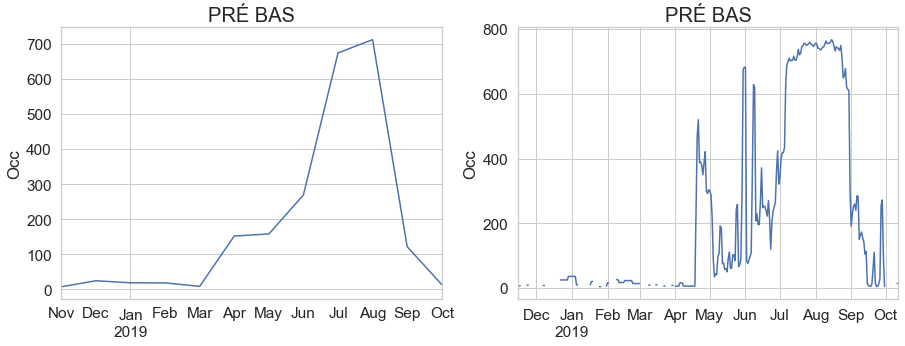

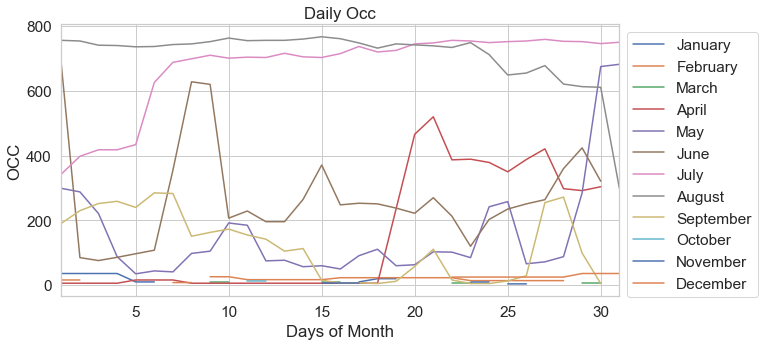

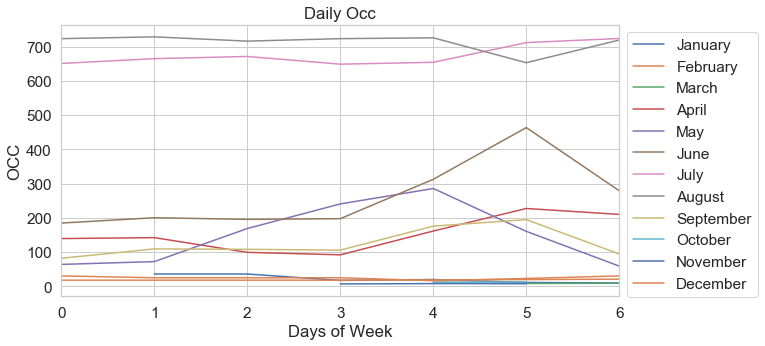

Dates range:
2017-11-18 00:00:00 - 2019-10-12 00:00:00

('X shape: ', (477, 9))
('y shape: ', (477,))
('X_train shape: ', (249, 9))
('X_test shape: ', (228, 9))
('y_train shape: ', (249,))
('y_test shape: ', (228,))
R2:	0.921
RMSE:	6503.41


Train TS Analysis On 2018 VIKINGS Occ.




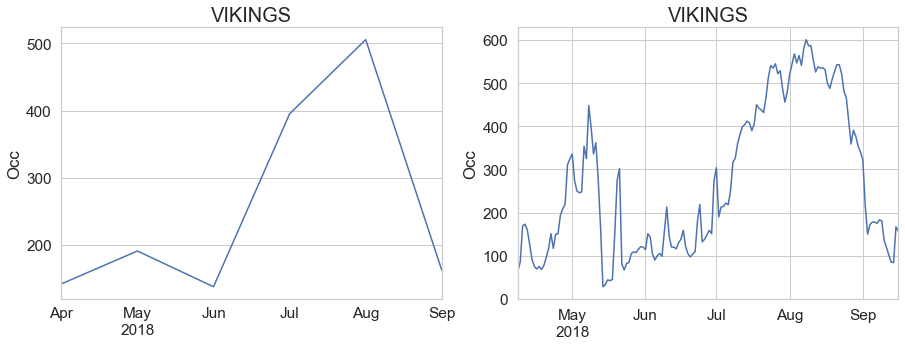

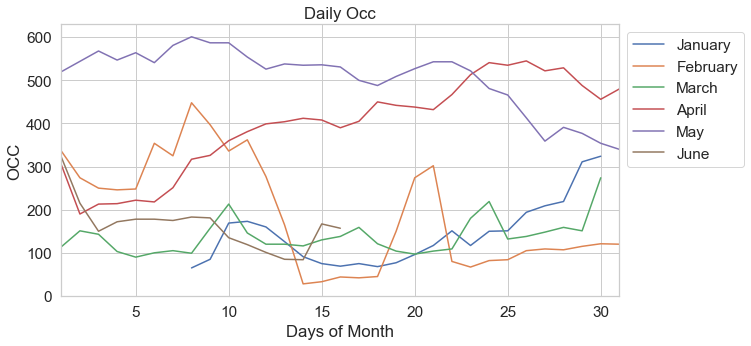

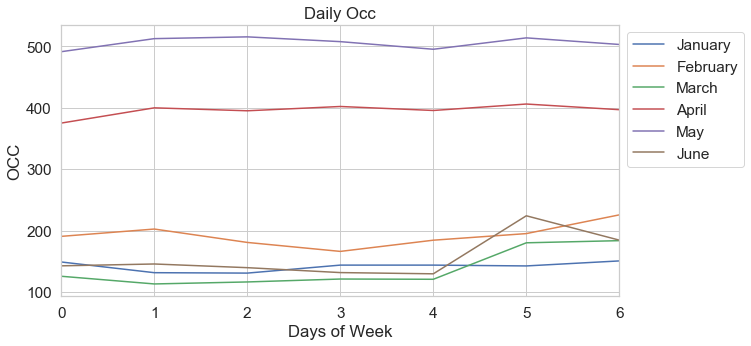



Test TS Analysis On 2019 VIKINGS Occ.




Error min() arg is an empty sequence for VIKINGS




Train TS Analysis On 2018 TALOUCH Occ.




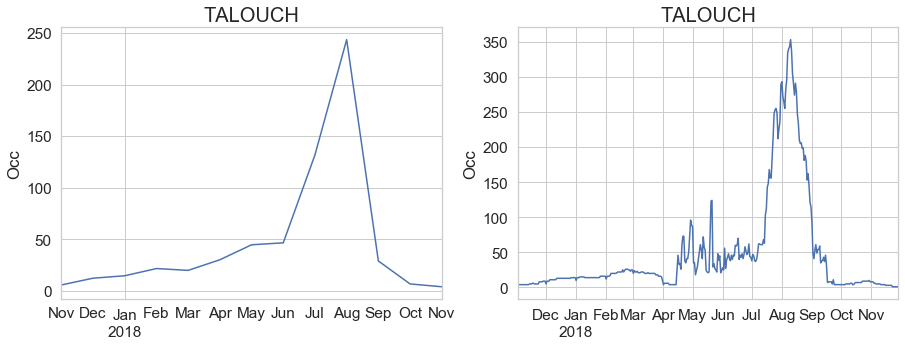

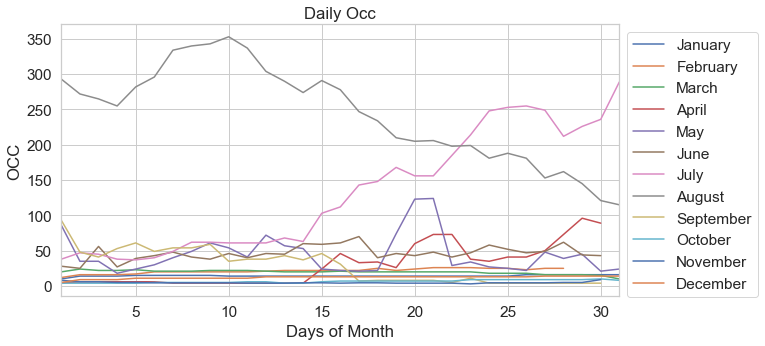

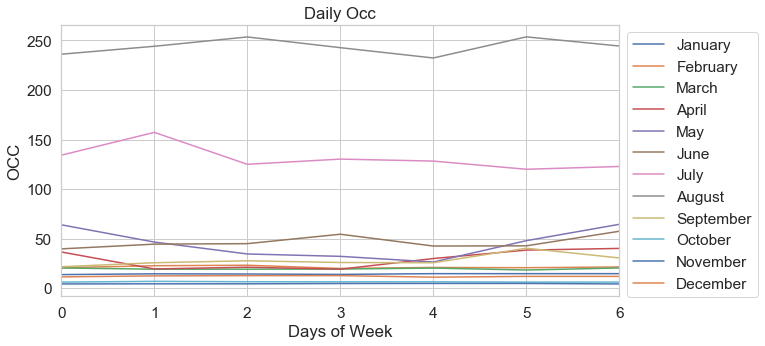



Test TS Analysis On 2019 TALOUCH Occ.




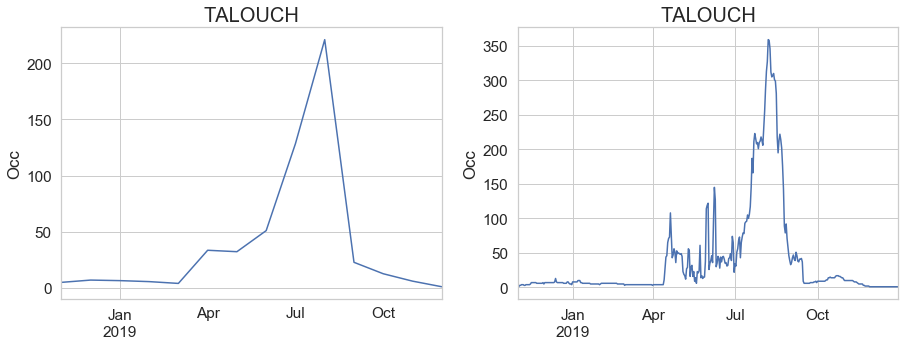

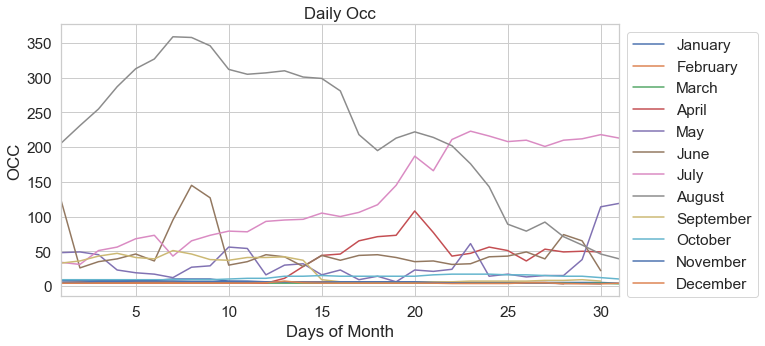

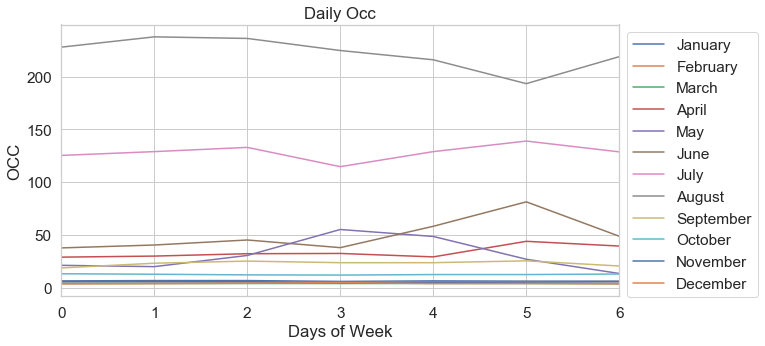

Dates range:
2017-11-02 00:00:00 - 2019-12-30 00:00:00

('X shape: ', (809, 9))
('y shape: ', (809,))
('X_train shape: ', (445, 9))
('X_test shape: ', (364, 9))
('y_train shape: ', (445,))
('y_test shape: ', (364,))
R2:	0.965
RMSE:	190.43


Train TS Analysis On 2018 FAYOLAN Occ.




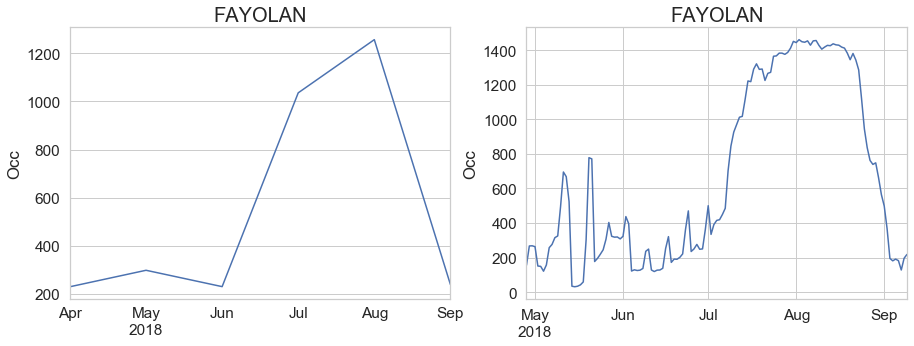

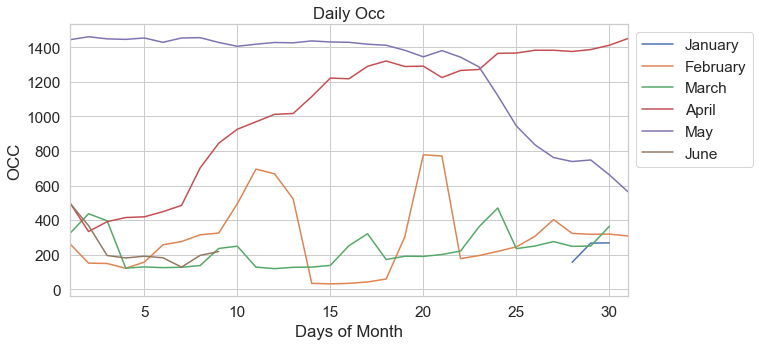

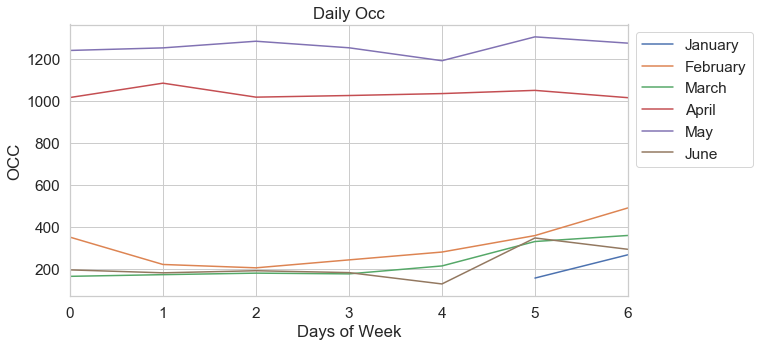



Test TS Analysis On 2019 FAYOLAN Occ.




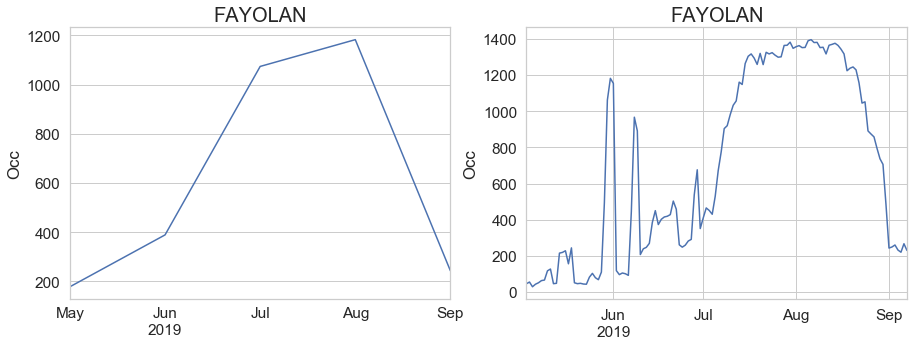

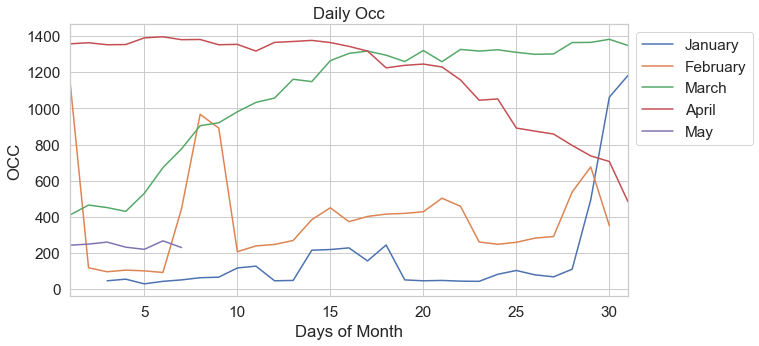

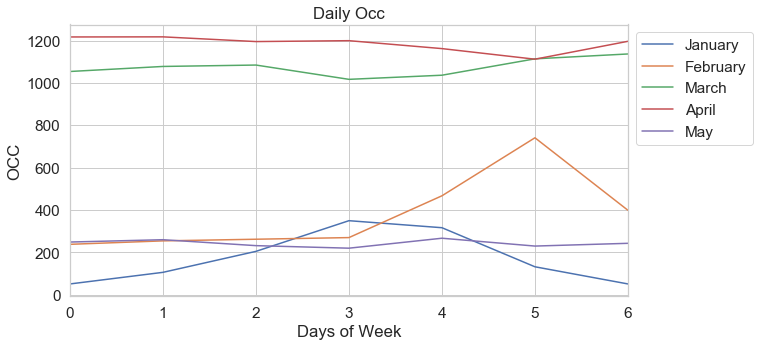

Dates range:
2018-04-28 00:00:00 - 2019-09-07 00:00:00

('X shape: ', (254, 9))
('y shape: ', (254,))
('X_train shape: ', (126, 9))
('X_test shape: ', (128, 9))
('y_train shape: ', (126,))
('y_test shape: ', (128,))
R2:	0.906
RMSE:	24334.45


Train TS Analysis On 2018 ILBARRITZ Occ.




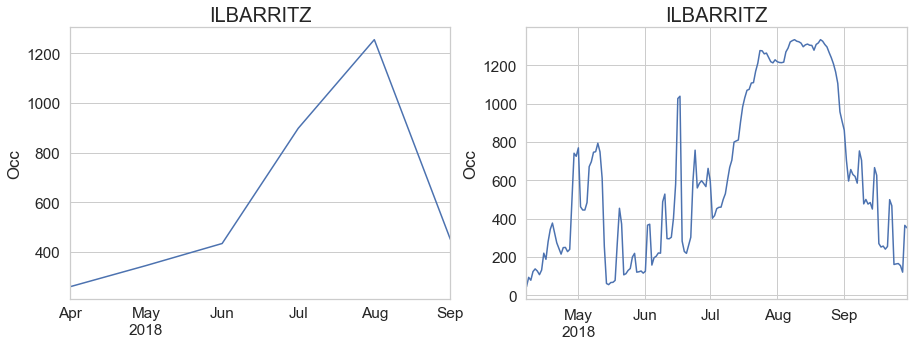

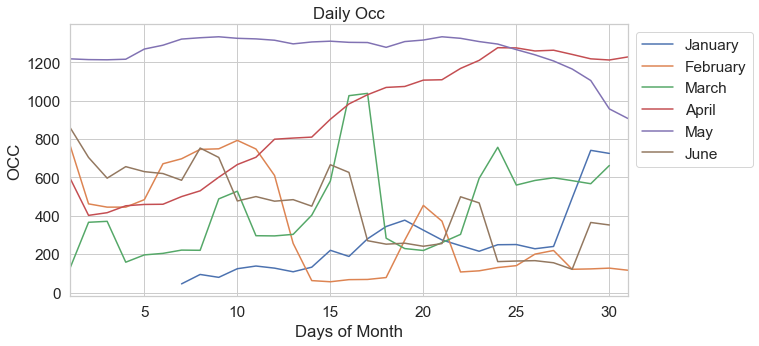

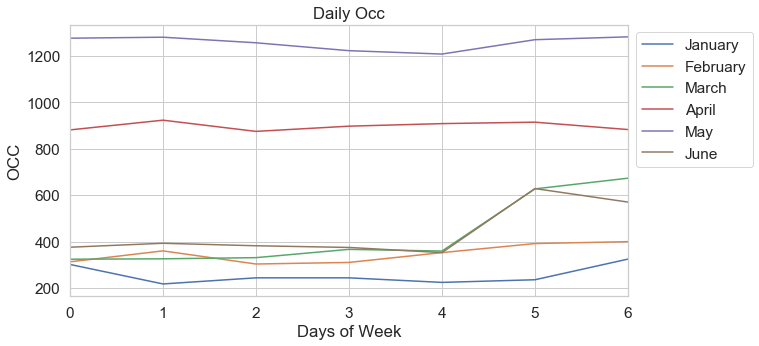



Test TS Analysis On 2019 ILBARRITZ Occ.




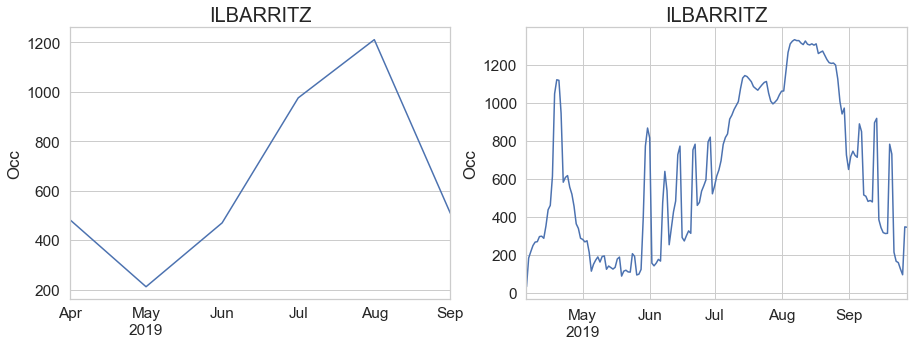

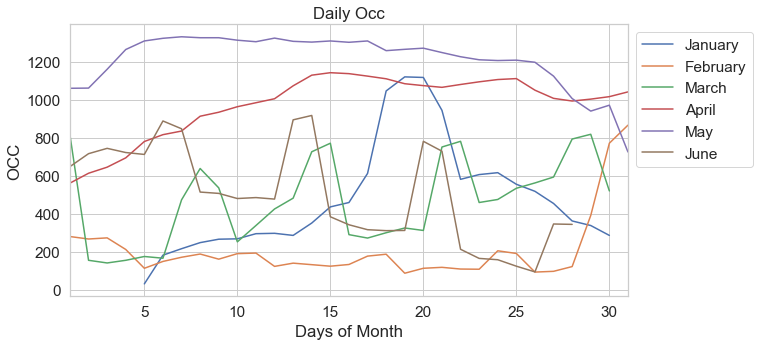

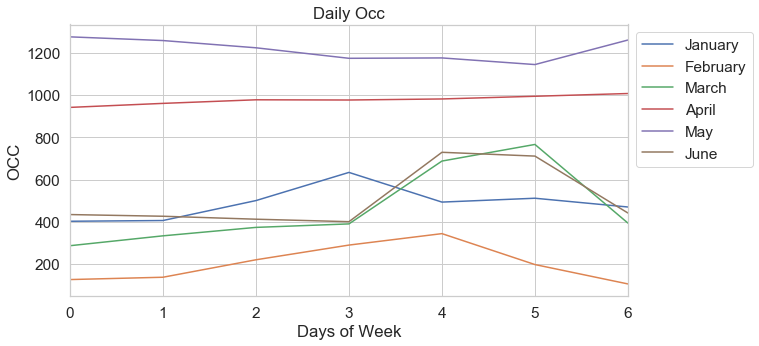

Dates range:
2018-04-07 00:00:00 - 2019-09-28 00:00:00

('X shape: ', (345, 9))
('y shape: ', (345,))
('X_train shape: ', (168, 9))
('X_test shape: ', (177, 9))
('y_train shape: ', (168,))
('y_test shape: ', (177,))
R2:	0.889
RMSE:	18184.72


Train TS Analysis On 2018 PAYRAC LES PINS Occ.




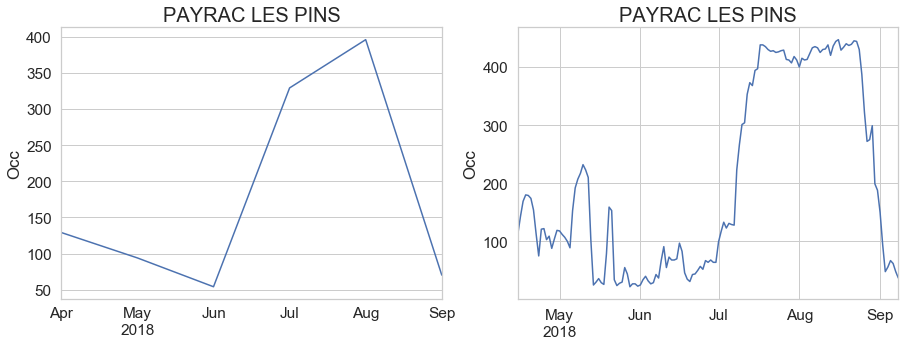

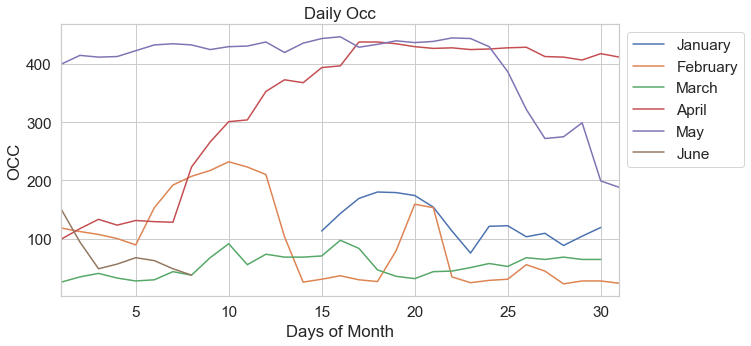

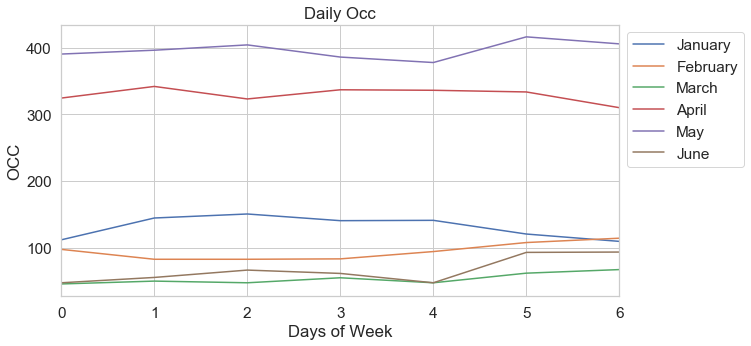



Test TS Analysis On 2019 PAYRAC LES PINS Occ.




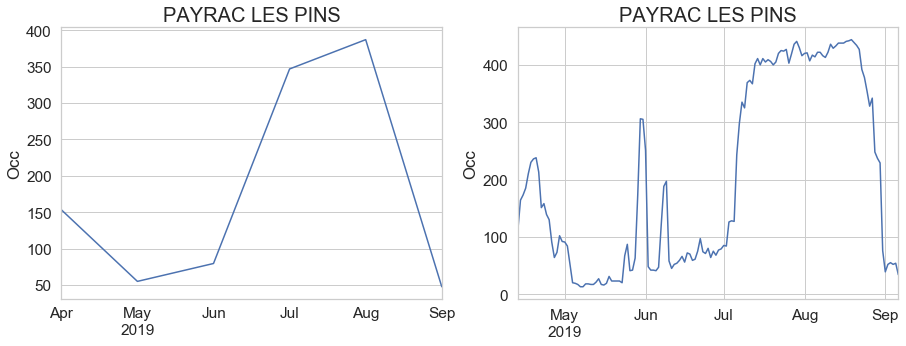

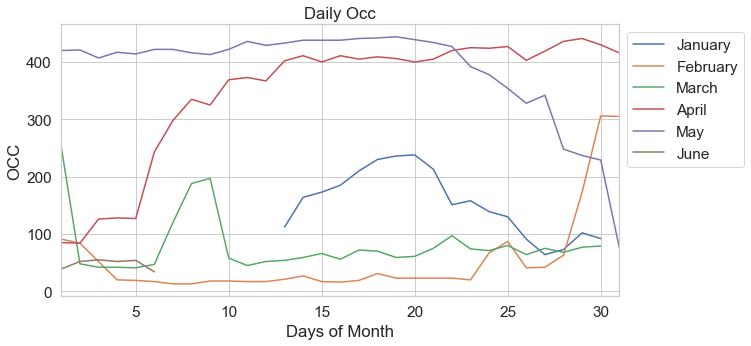

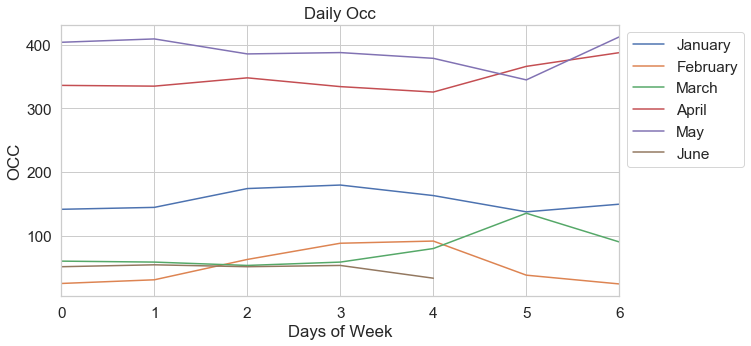

Dates range:
2018-04-15 00:00:00 - 2019-09-06 00:00:00

('X shape: ', (285, 9))
('y shape: ', (285,))
('X_train shape: ', (138, 9))
('X_test shape: ', (147, 9))
('y_train shape: ', (138,))
('y_test shape: ', (147,))
R2:	0.941
RMSE:	1574.4


Train TS Analysis On 2018 OCÉAN BRETON Occ.




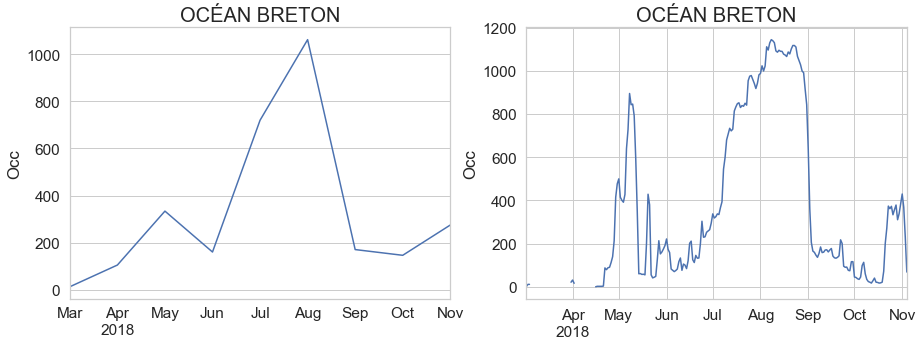

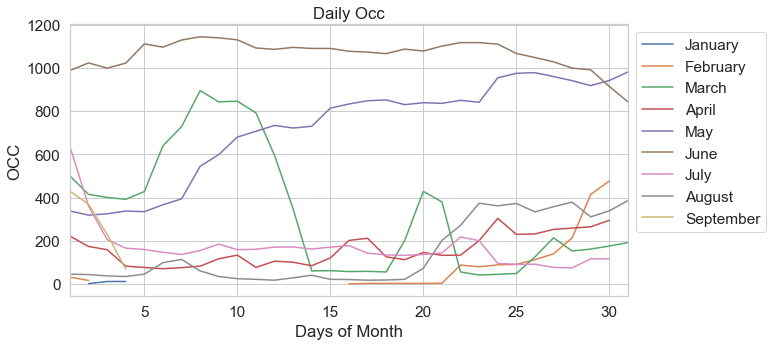

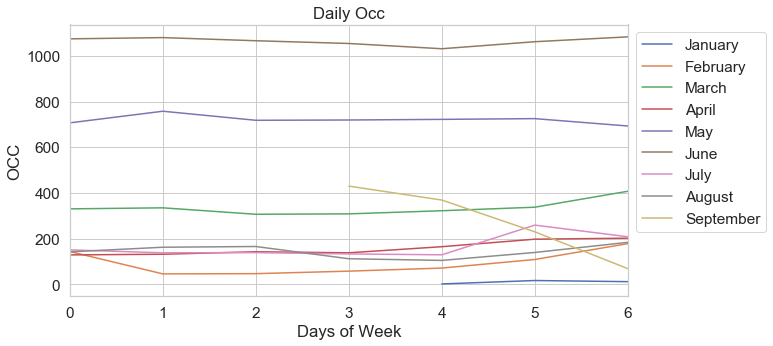



Test TS Analysis On 2019 OCÉAN BRETON Occ.




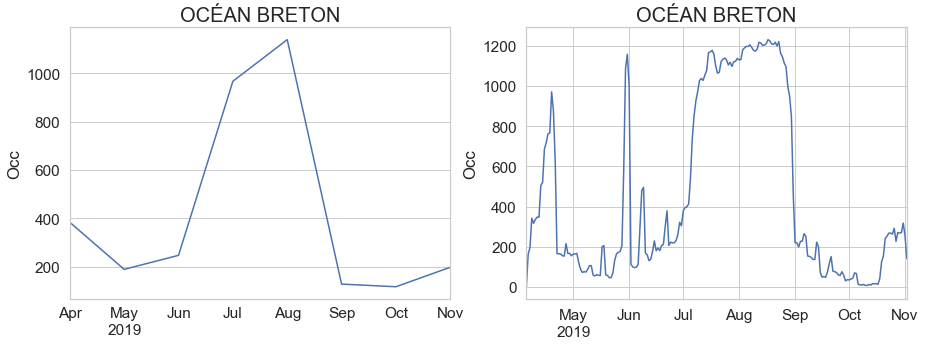

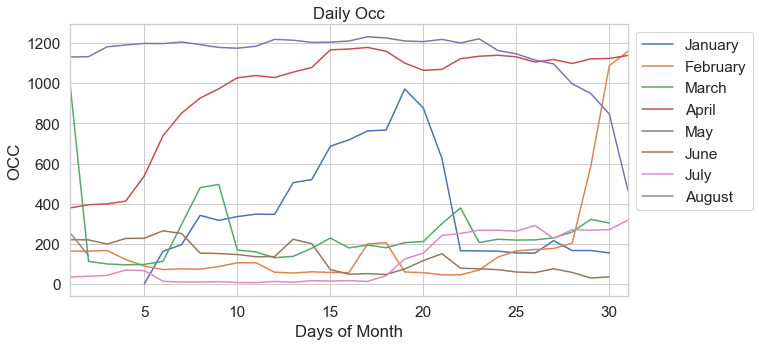

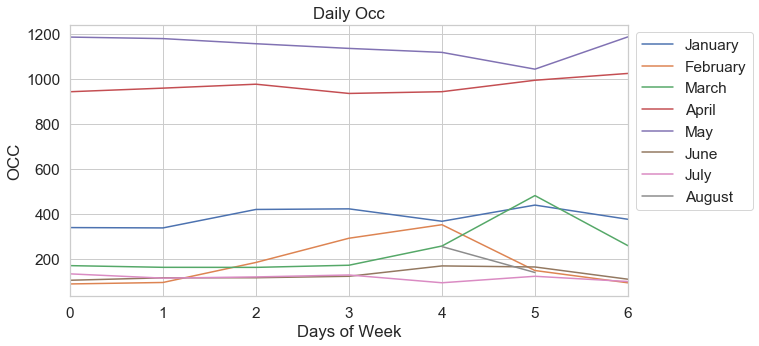

Dates range:
2018-03-02 00:00:00 - 2019-11-02 00:00:00

('X shape: ', (412, 9))
('y shape: ', (412,))
('X_train shape: ', (200, 9))
('X_test shape: ', (212, 9))
('y_train shape: ', (200,))
('y_test shape: ', (212,))
R2:	0.935
RMSE:	12584.21


Train TS Analysis On 2018 PLAGE Occ.




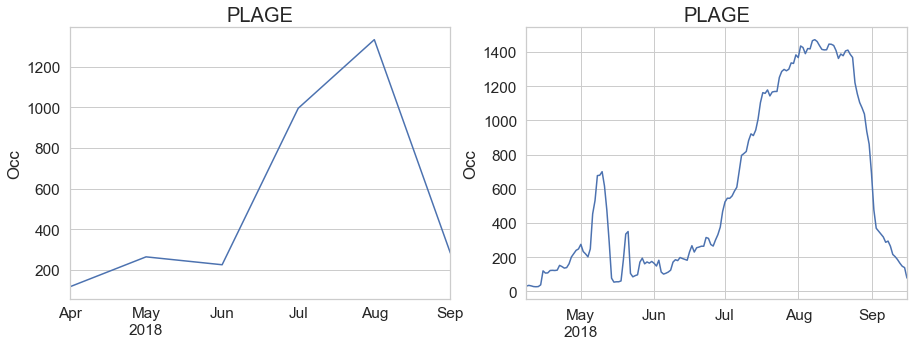

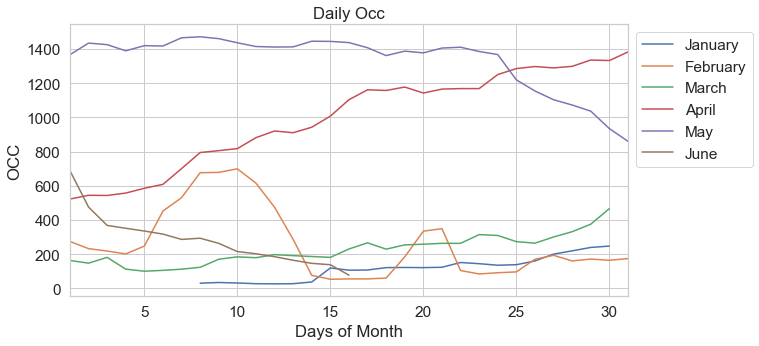

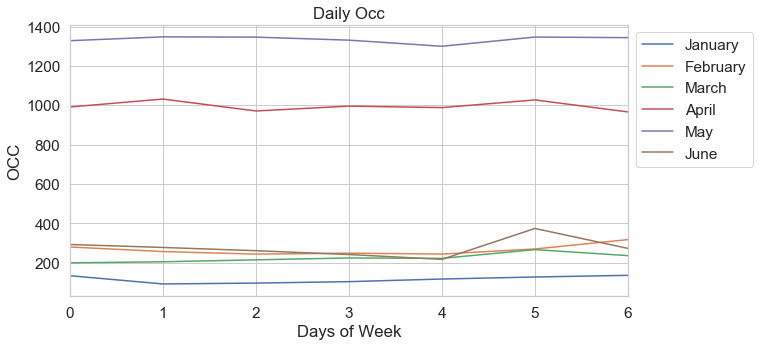



Test TS Analysis On 2019 PLAGE Occ.




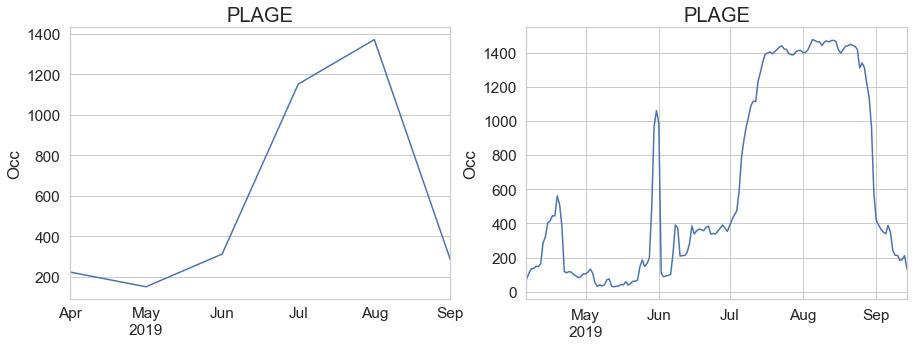

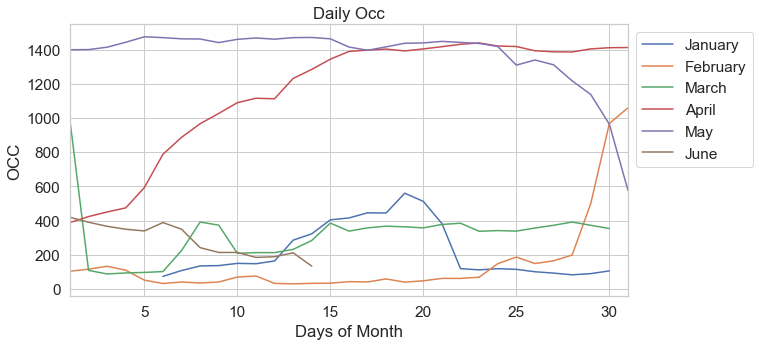

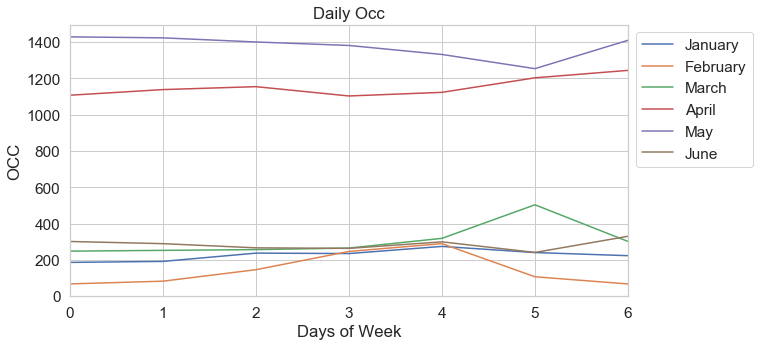

Dates range:
2018-04-08 00:00:00 - 2019-09-14 00:00:00

('X shape: ', (315, 9))
('y shape: ', (315,))
('X_train shape: ', (153, 9))
('X_test shape: ', (162, 9))
('y_train shape: ', (153,))
('y_test shape: ', (162,))
R2:	0.961
RMSE:	11770.89


Train TS Analysis On 2018 LAC DE BISCARROSSE Occ.




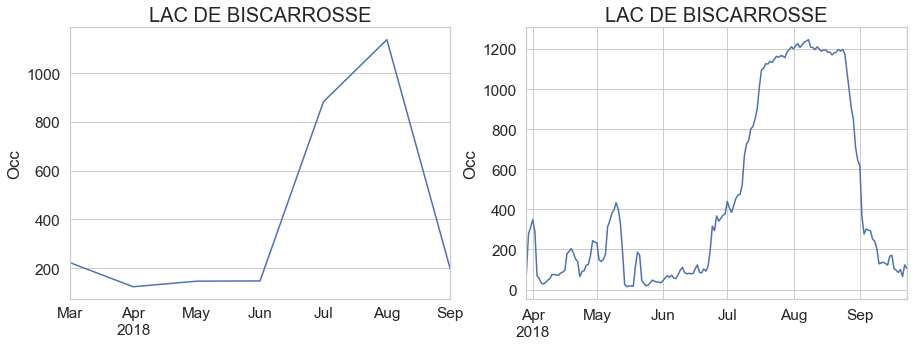

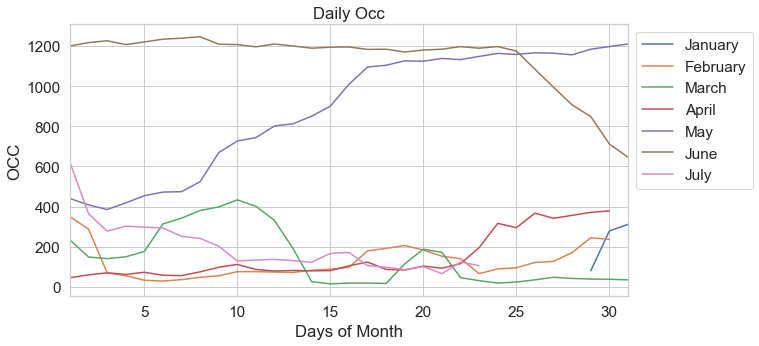

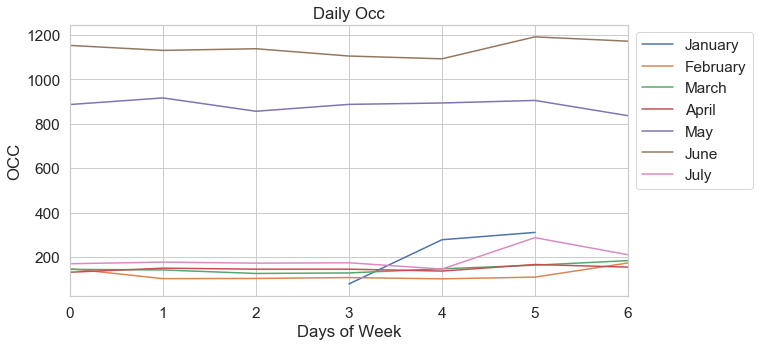



Test TS Analysis On 2019 LAC DE BISCARROSSE Occ.




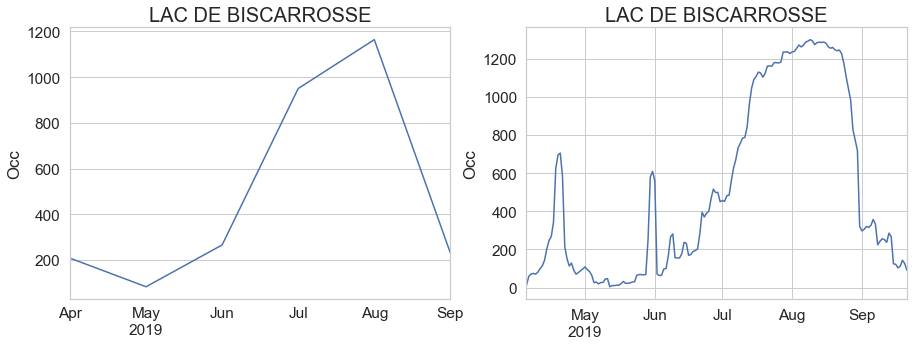

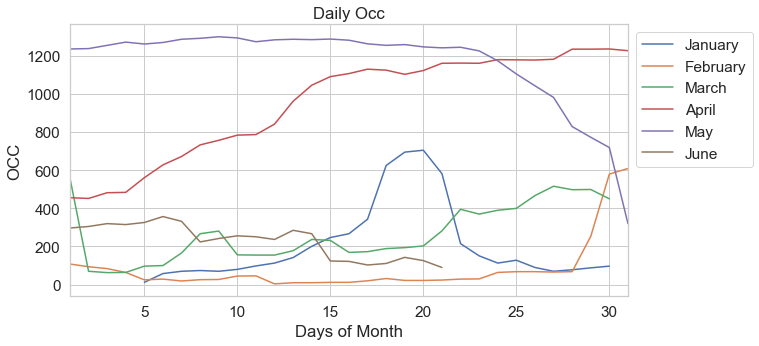

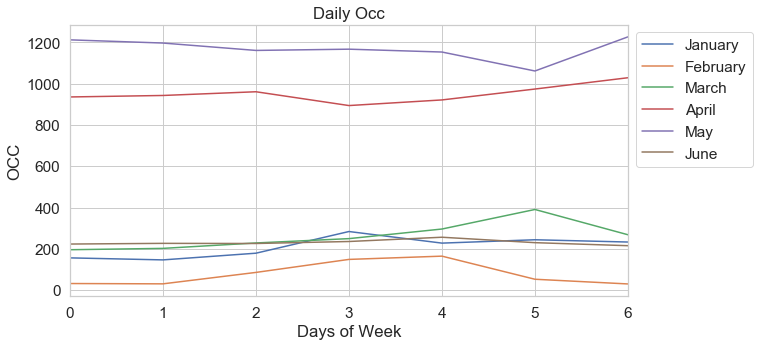

Dates range:
2018-03-29 00:00:00 - 2019-09-21 00:00:00

('X shape: ', (340, 9))
('y shape: ', (340,))
('X_train shape: ', (170, 9))
('X_test shape: ', (170, 9))
('y_train shape: ', (170,))
('y_test shape: ', (170,))
R2:	0.97
RMSE:	6501.96


Train TS Analysis On 2018 GRANDS PINS Occ.




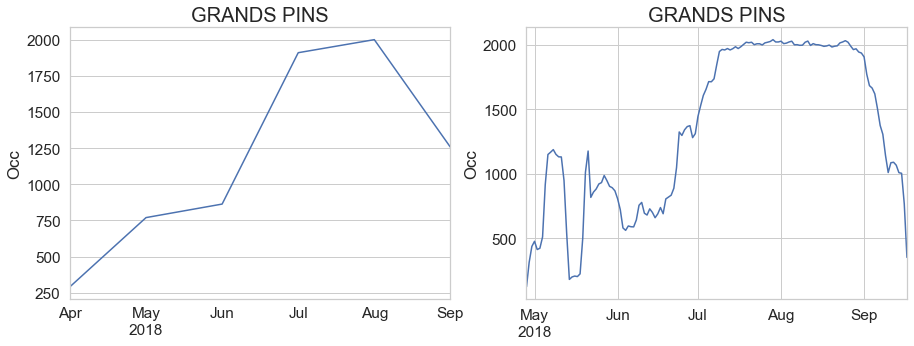

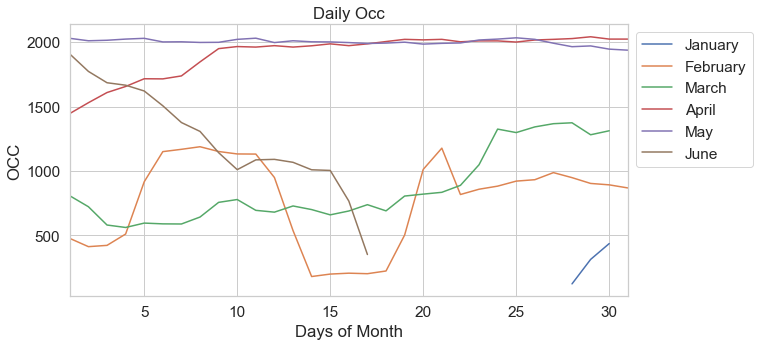

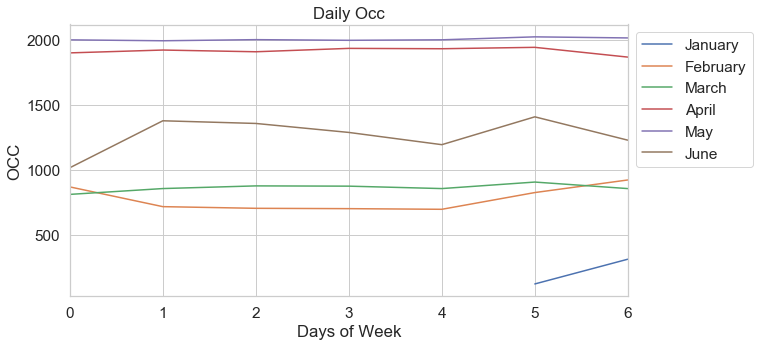



Test TS Analysis On 2019 GRANDS PINS Occ.




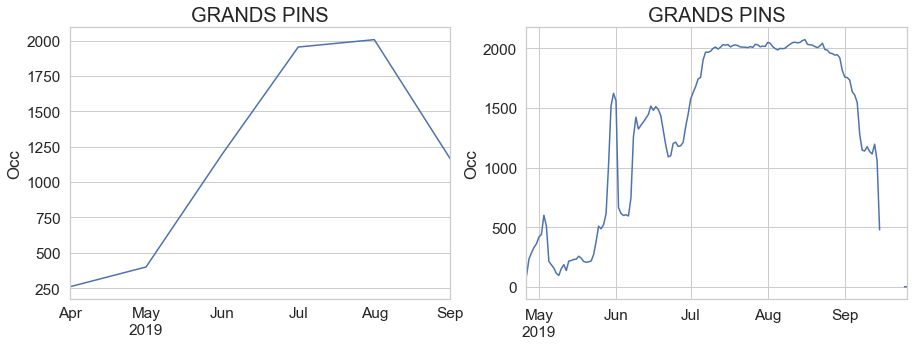

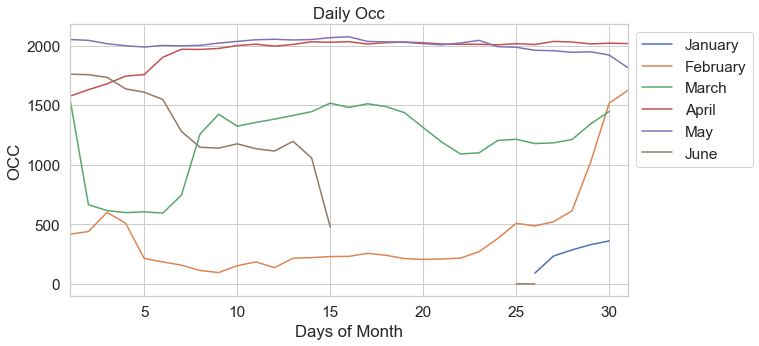

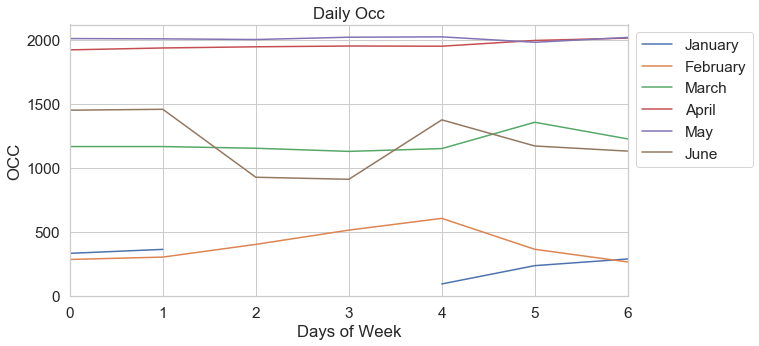

Dates range:
2018-04-28 00:00:00 - 2019-09-26 00:00:00

('X shape: ', (279, 9))
('y shape: ', (279,))
('X_train shape: ', (134, 9))
('X_test shape: ', (145, 9))
('y_train shape: ', (134,))
('y_test shape: ', (145,))
R2:	0.864
RMSE:	67771.26


Train TS Analysis On 2018 CHAPONNET Occ.




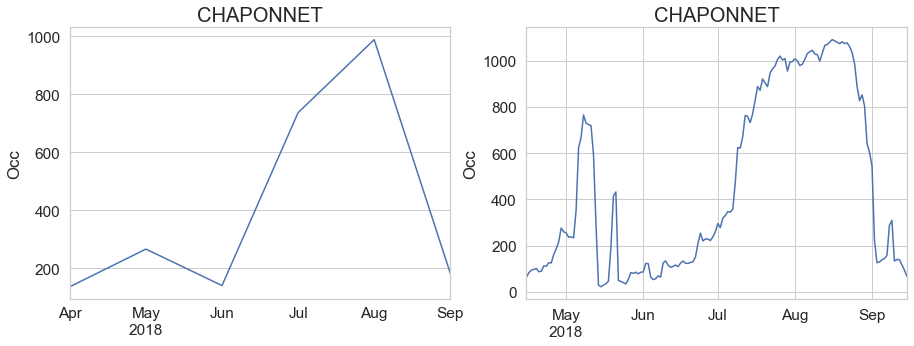

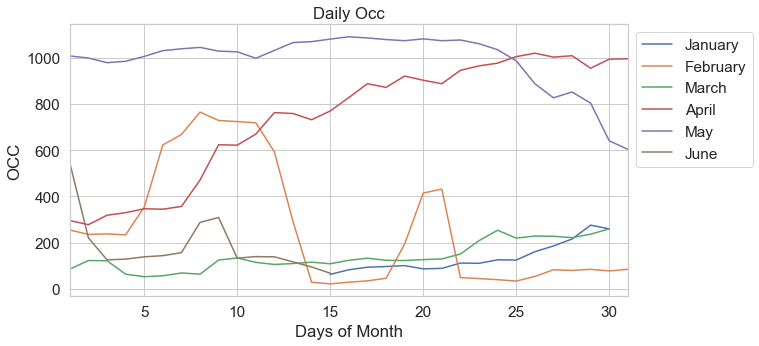

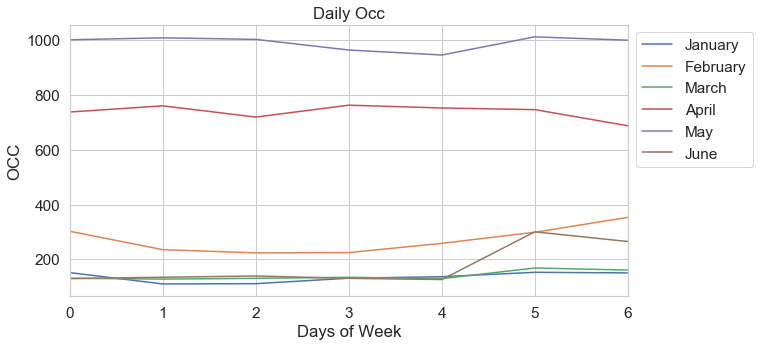



Test TS Analysis On 2019 CHAPONNET Occ.




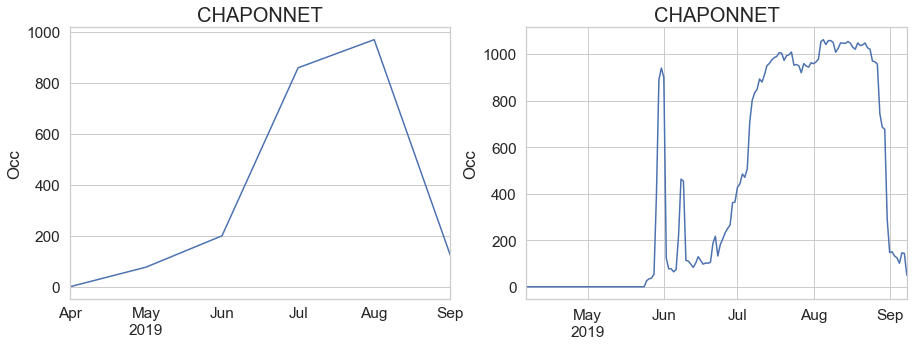

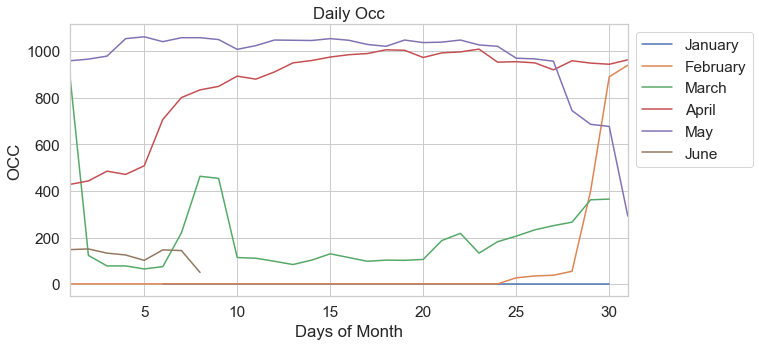

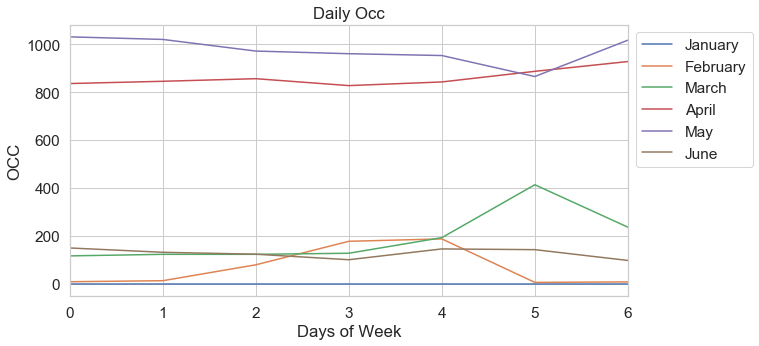

Dates range:
2018-04-15 00:00:00 - 2019-09-08 00:00:00

('X shape: ', (301, 9))
('y shape: ', (301,))
('X_train shape: ', (145, 9))
('X_test shape: ', (156, 9))
('y_train shape: ', (145,))
('y_test shape: ', (156,))
R2:	0.933
RMSE:	12865.89


Train TS Analysis On 2018 AVIGNON PARC Occ.




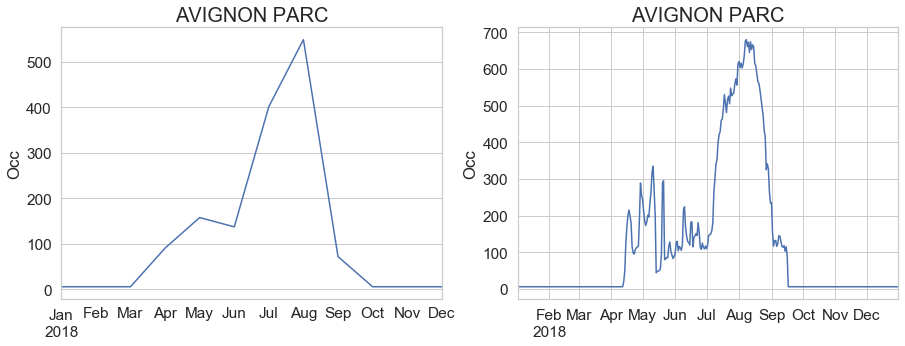

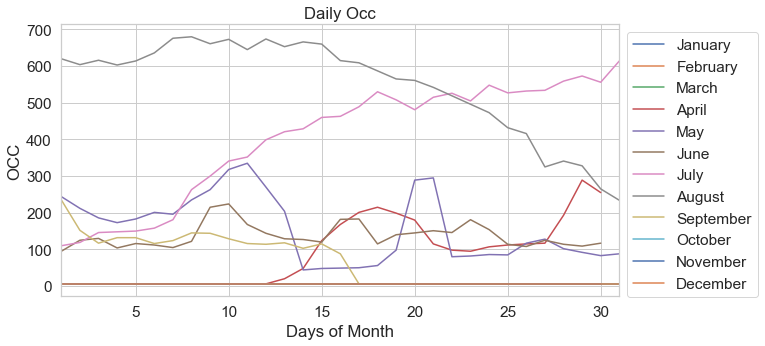

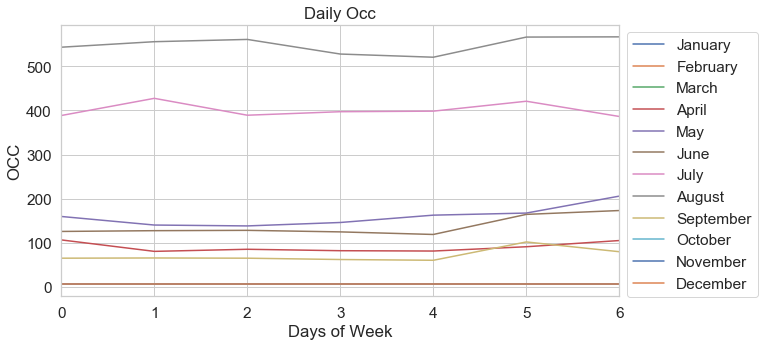



Test TS Analysis On 2019 AVIGNON PARC Occ.




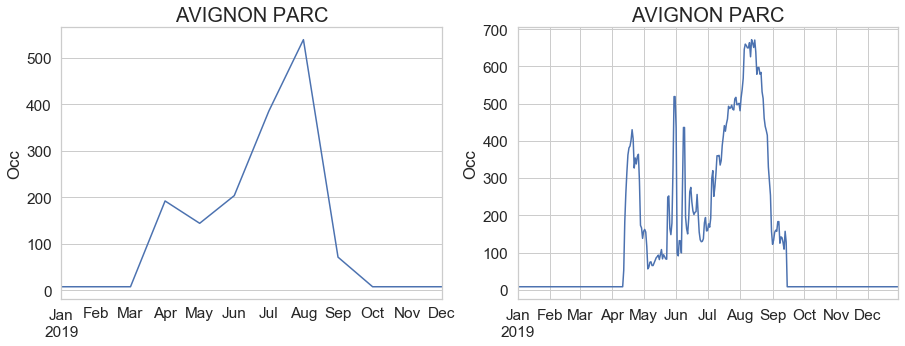

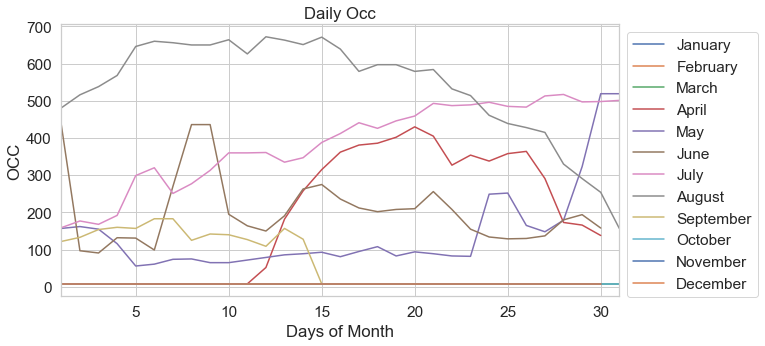

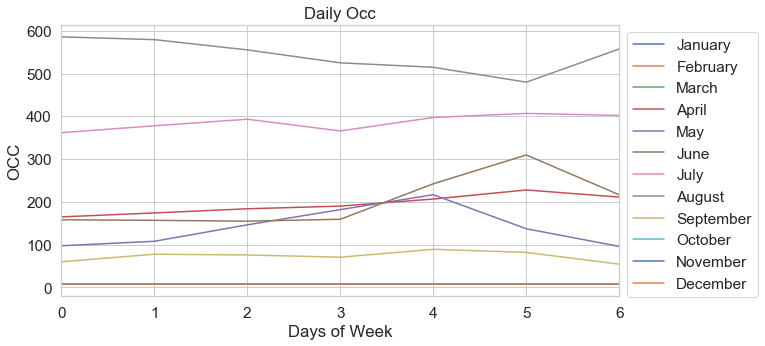

Dates range:
2018-01-02 00:00:00 - 2019-12-30 00:00:00

('X shape: ', (719, 9))
('y shape: ', (719,))
('X_train shape: ', (355, 9))
('X_test shape: ', (364, 9))
('y_train shape: ', (355,))
('y_test shape: ', (364,))
R2:	0.961
RMSE:	1370.33


Train TS Analysis On 2018 CHATEAU DE BOISSON Occ.




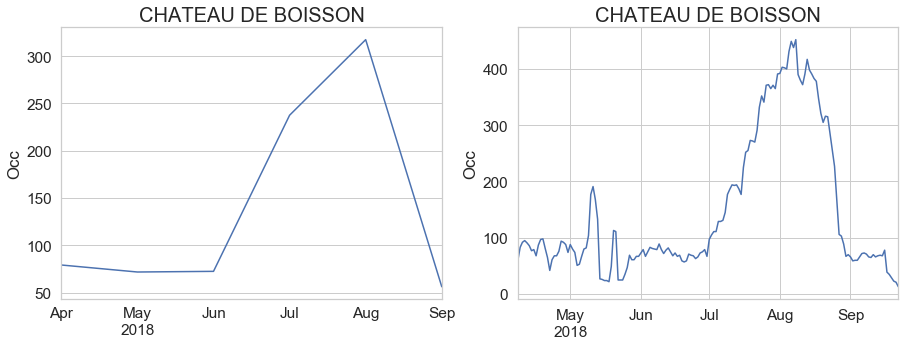

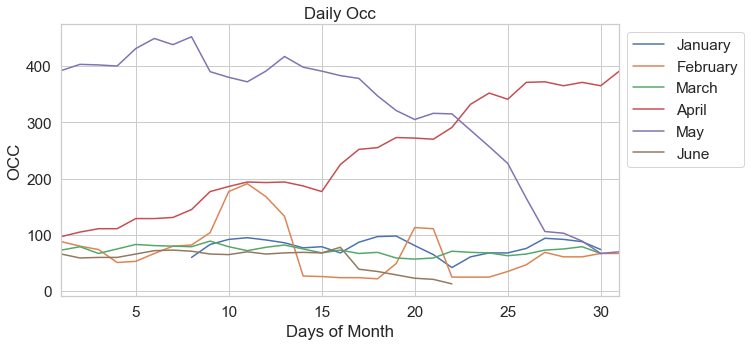

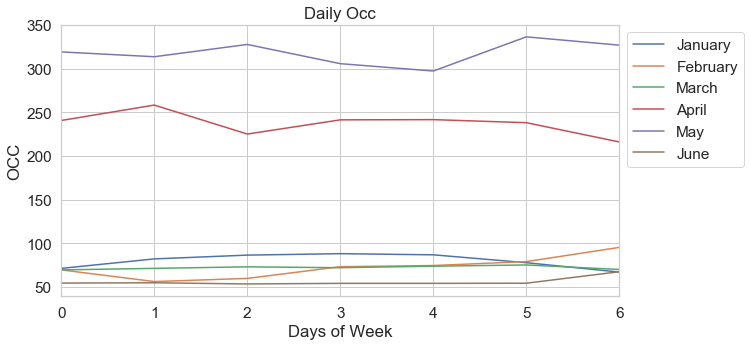



Test TS Analysis On 2019 CHATEAU DE BOISSON Occ.




Error min() arg is an empty sequence for CHATEAU DE BOISSON




Train TS Analysis On 2018 PTIT BOIS Occ.




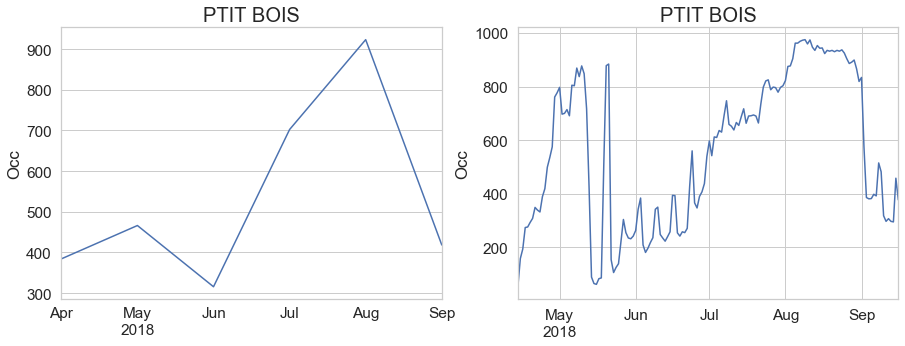

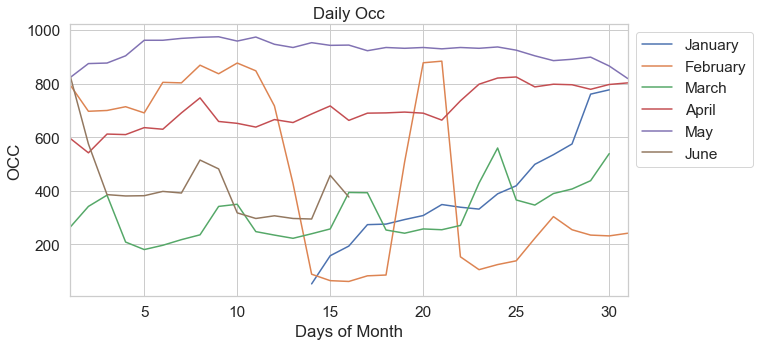

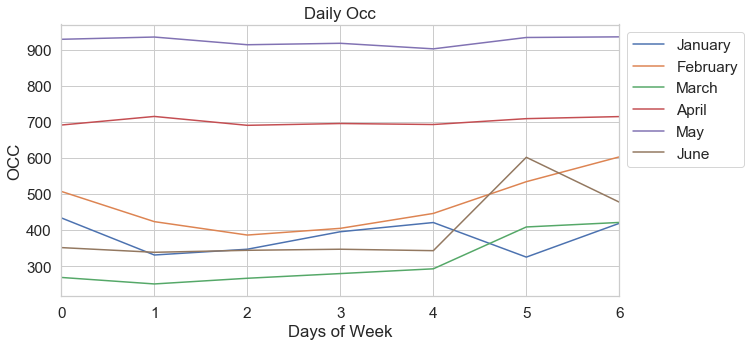



Test TS Analysis On 2019 PTIT BOIS Occ.




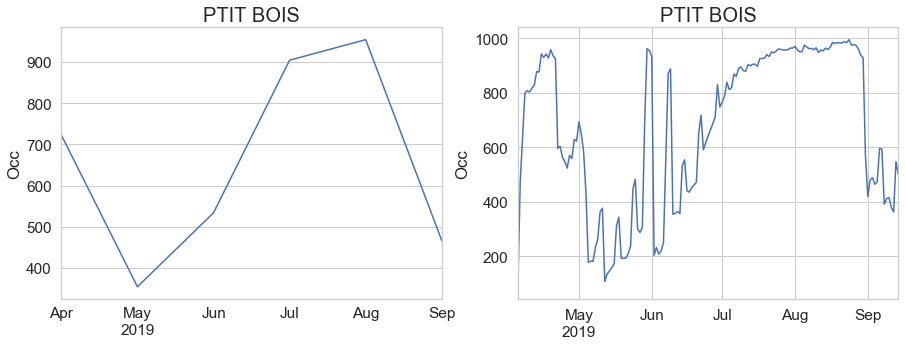

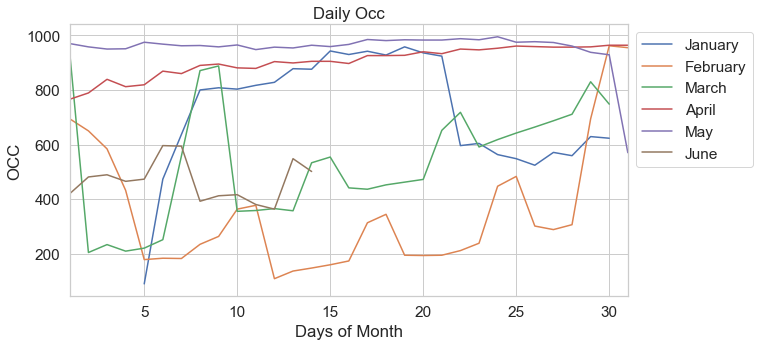

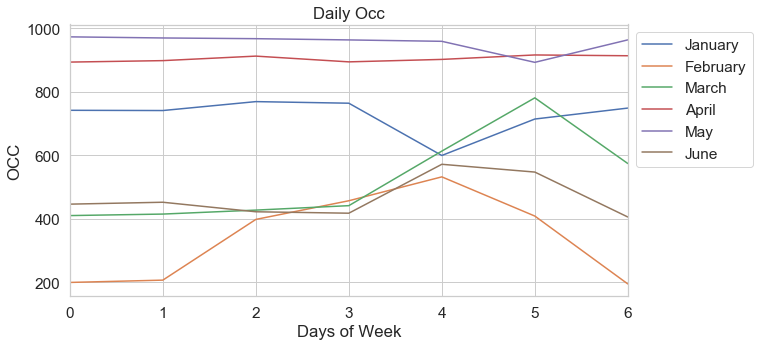

Dates range:
2018-04-14 00:00:00 - 2019-09-14 00:00:00

('X shape: ', (310, 9))
('y shape: ', (310,))
('X_train shape: ', (147, 9))
('X_test shape: ', (163, 9))
('y_train shape: ', (147,))
('y_test shape: ', (163,))
R2:	0.818
RMSE:	14265.59


Train TS Analysis On 2018 PRE CATALAN Occ.




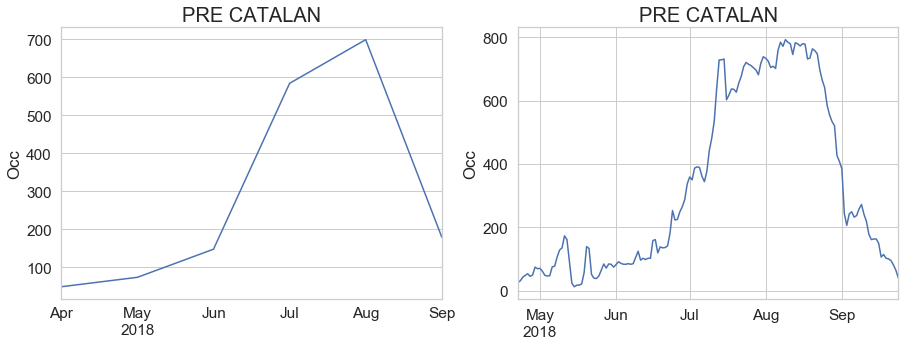

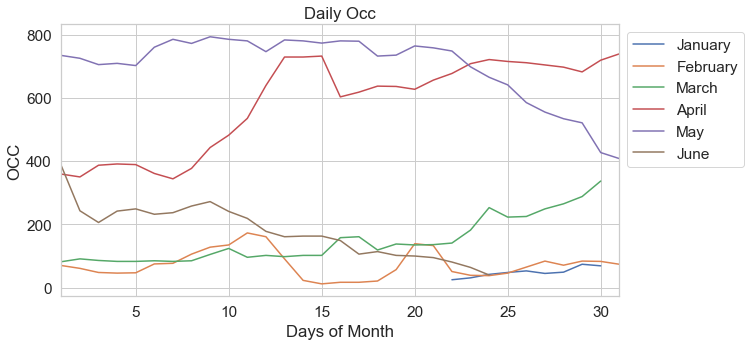

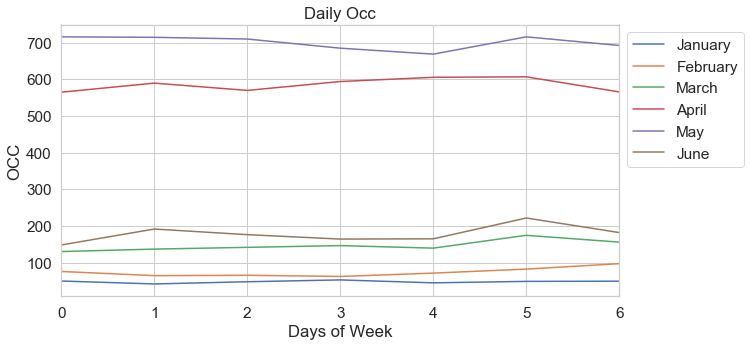



Test TS Analysis On 2019 PRE CATALAN Occ.




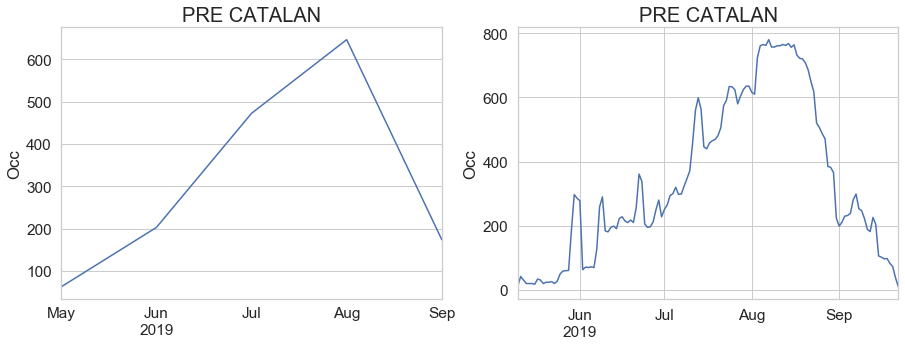

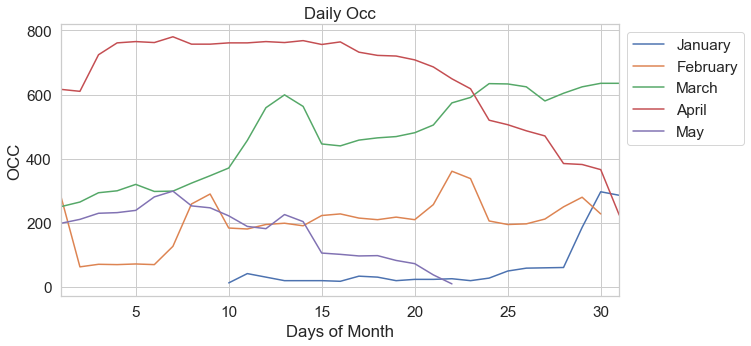

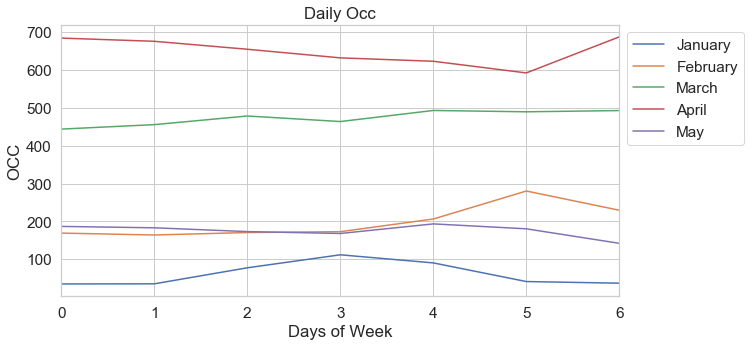

Dates range:
2018-04-22 00:00:00 - 2019-09-22 00:00:00

('X shape: ', (283, 9))
('y shape: ', (283,))
('X_train shape: ', (147, 9))
('X_test shape: ', (136, 9))
('y_train shape: ', (147,))
('y_test shape: ', (136,))
R2:	0.961
RMSE:	2313.34


Train TS Analysis On 2018 GAVINA Occ.




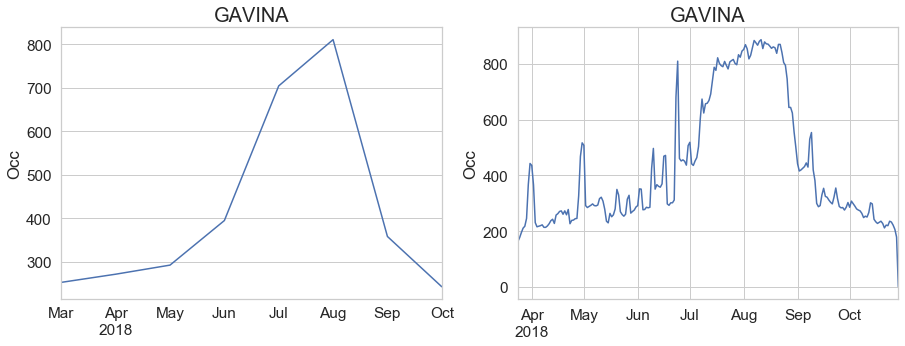

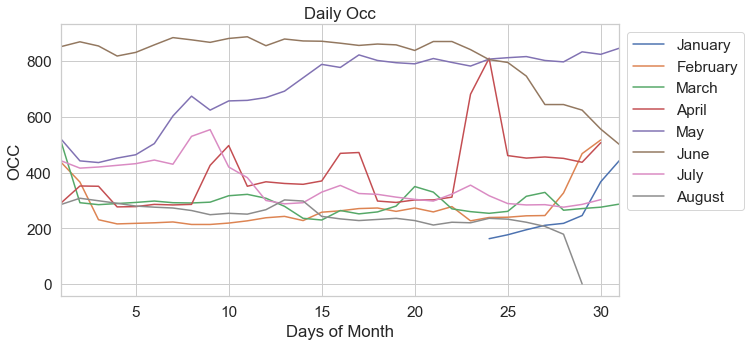

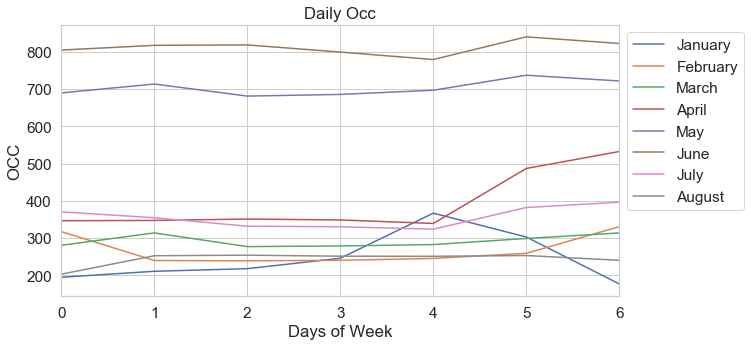



Test TS Analysis On 2019 GAVINA Occ.




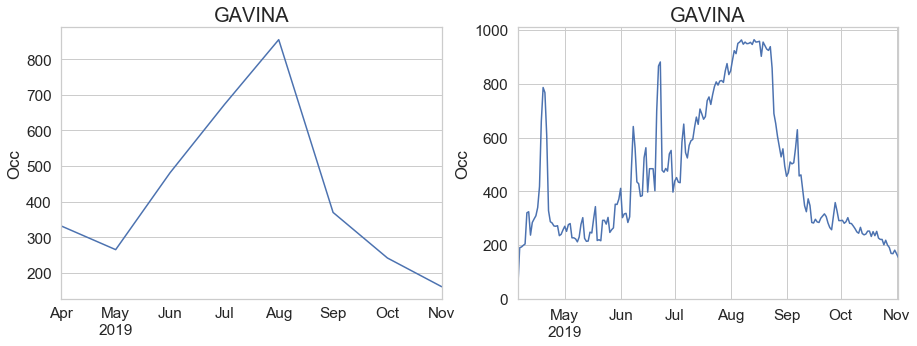

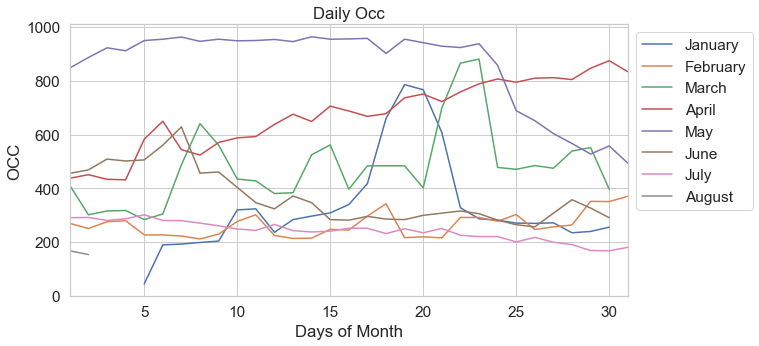

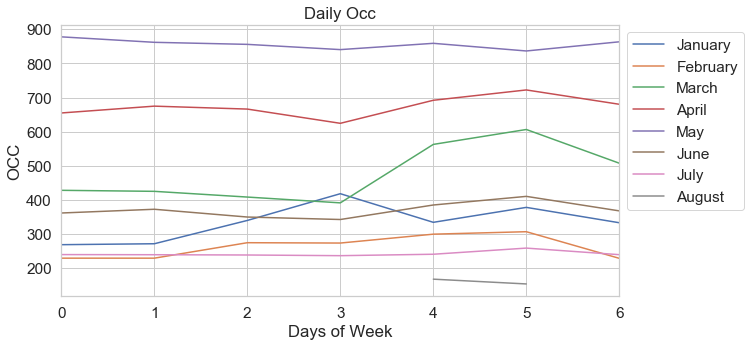

Dates range:
2018-03-24 00:00:00 - 2019-11-02 00:00:00

('X shape: ', (423, 9))
('y shape: ', (423,))
('X_train shape: ', (211, 9))
('X_test shape: ', (212, 9))
('y_train shape: ', (211,))
('y_test shape: ', (212,))
R2:	0.897
RMSE:	6226.75


Train TS Analysis On 2018 GORGES DU CHAMBON Occ.




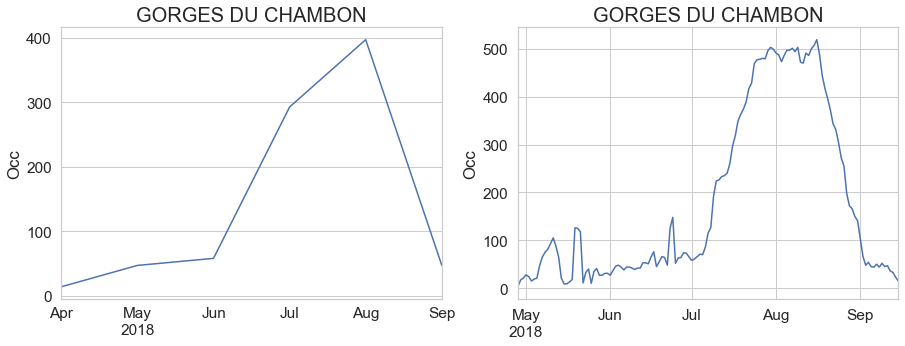

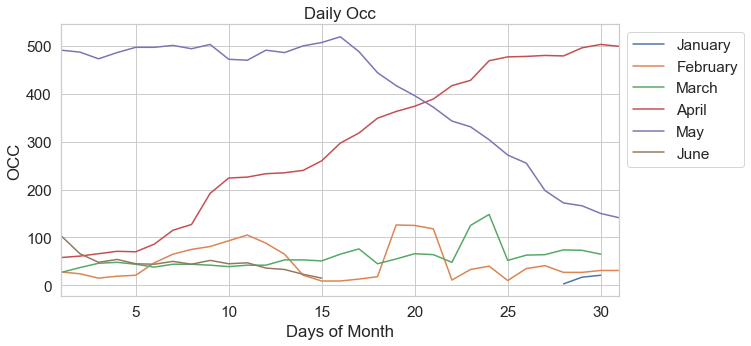

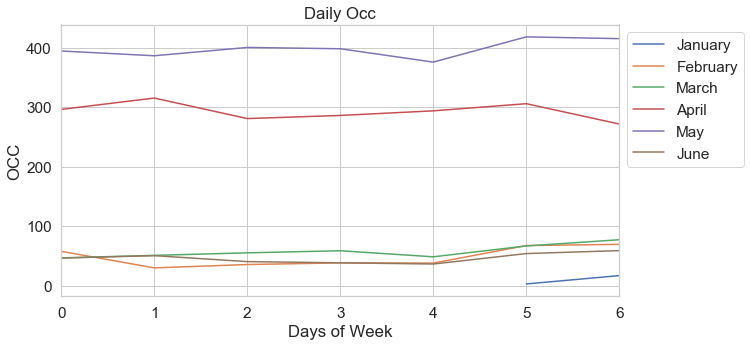



Test TS Analysis On 2019 GORGES DU CHAMBON Occ.




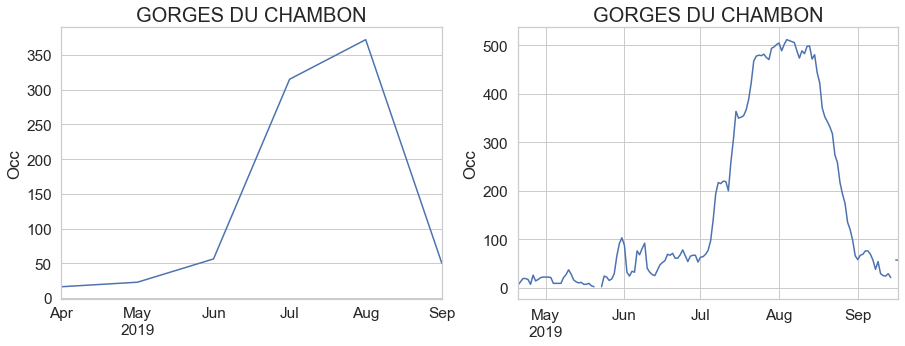

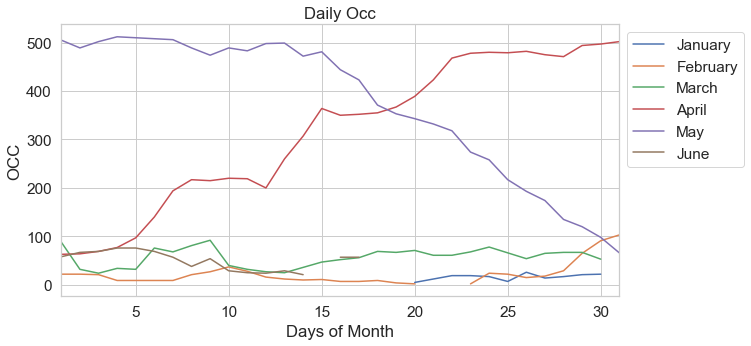

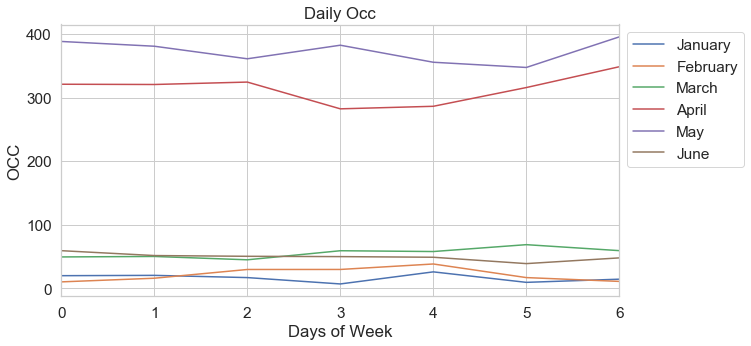

Dates range:
2018-04-28 00:00:00 - 2019-09-17 00:00:00

('X shape: ', (280, 9))
('y shape: ', (280,))
('X_train shape: ', (132, 9))
('X_test shape: ', (148, 9))
('y_train shape: ', (132,))
('y_test shape: ', (148,))
R2:	0.977
RMSE:	749.2


Train TS Analysis On 2018 RIDIN Occ.




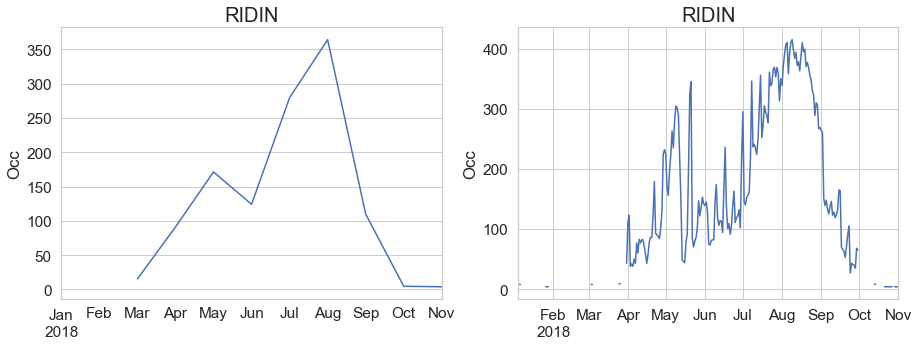

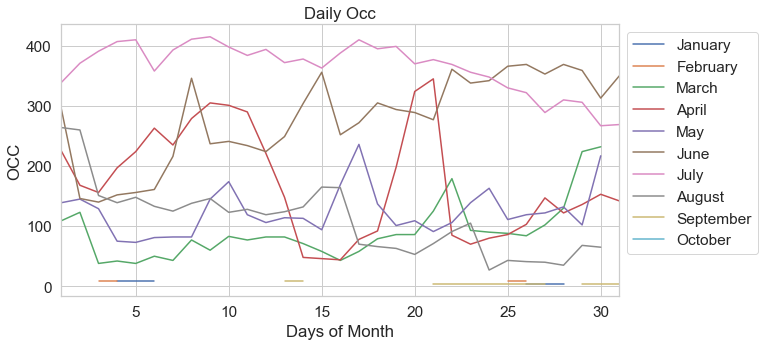

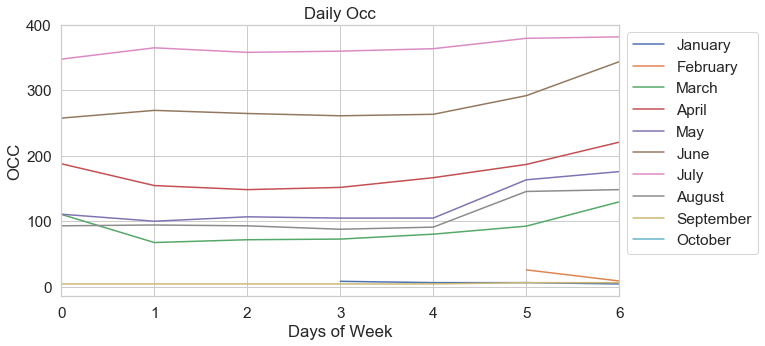



Test TS Analysis On 2019 RIDIN Occ.




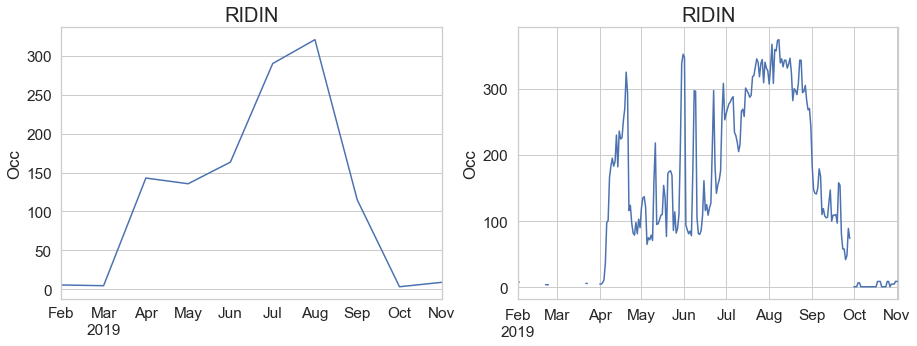

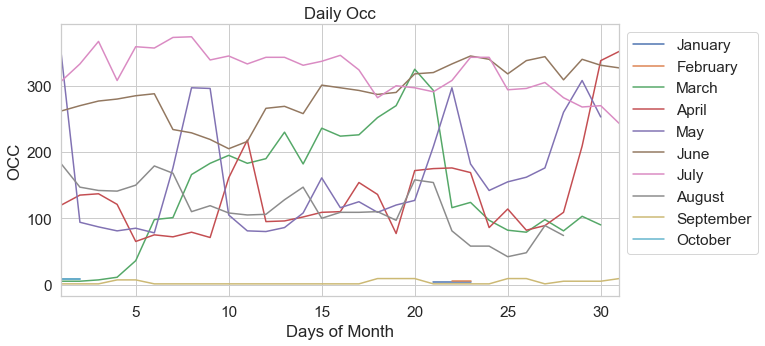

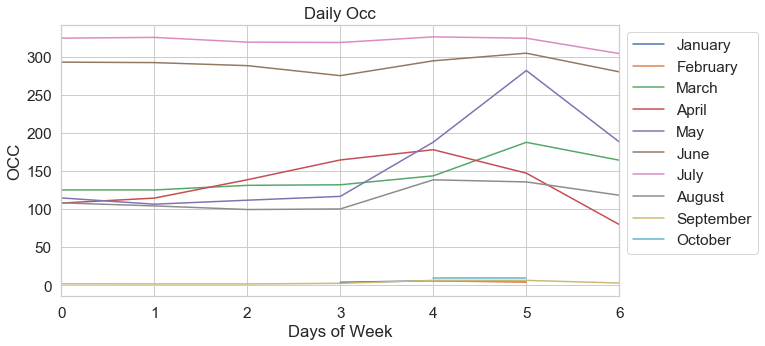

Dates range:
2018-01-04 00:00:00 - 2019-11-02 00:00:00

('X shape: ', (420, 9))
('y shape: ', (420,))
('X_train shape: ', (198, 9))
('X_test shape: ', (222, 9))
('y_train shape: ', (198,))
('y_test shape: ', (222,))
R2:	0.899
RMSE:	1418.45


Train TS Analysis On 2018 SERIGNAN PLAGE Occ.




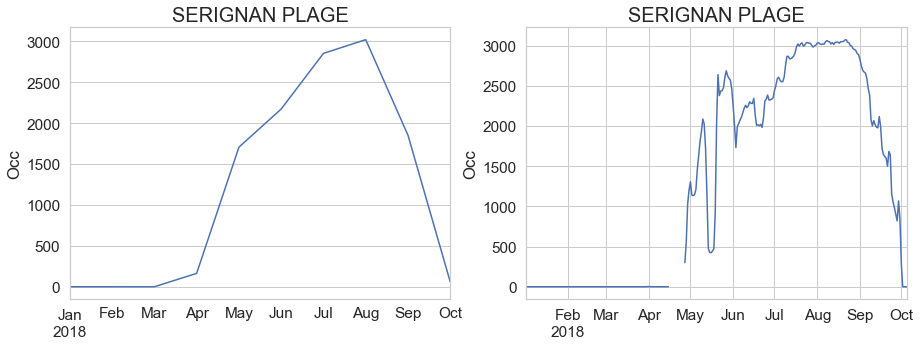

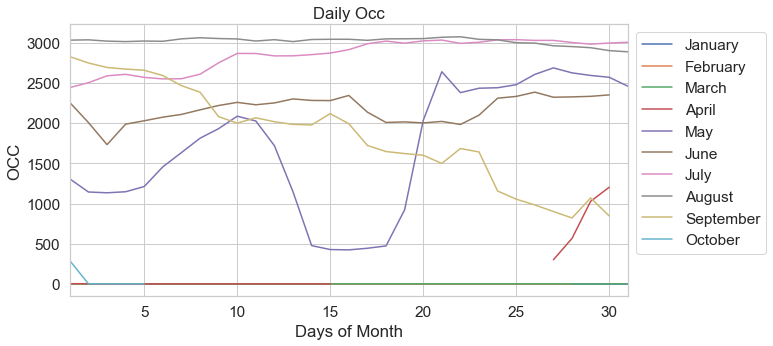

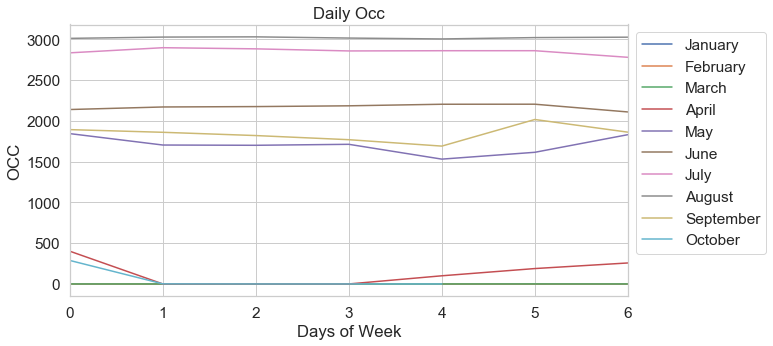



Test TS Analysis On 2019 SERIGNAN PLAGE Occ.




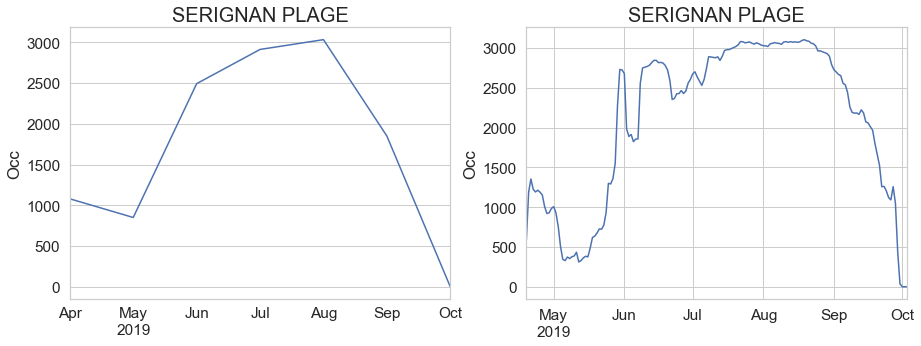

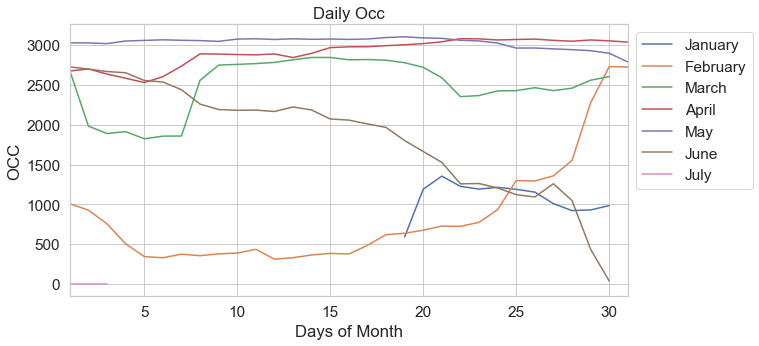

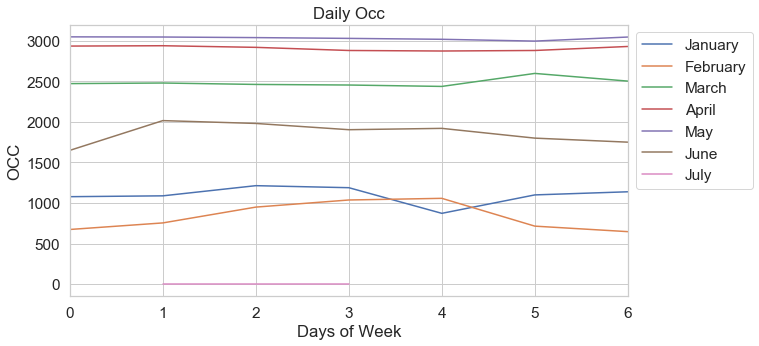

Dates range:
2018-01-02 00:00:00 - 2019-10-03 00:00:00

('X shape: ', (425, 9))
('y shape: ', (425,))
('X_train shape: ', (257, 9))
('X_test shape: ', (168, 9))
('y_train shape: ', (257,))
('y_test shape: ', (168,))
R2:	0.973
RMSE:	25672.4


Train TS Analysis On 2018 PARC DU VAL DE LOIRE Occ.




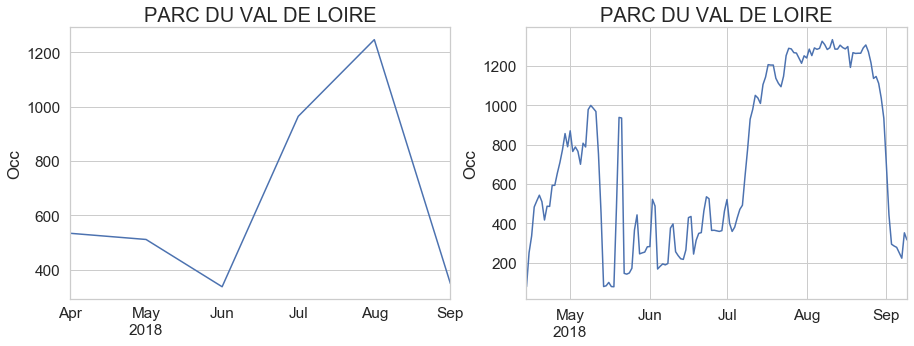

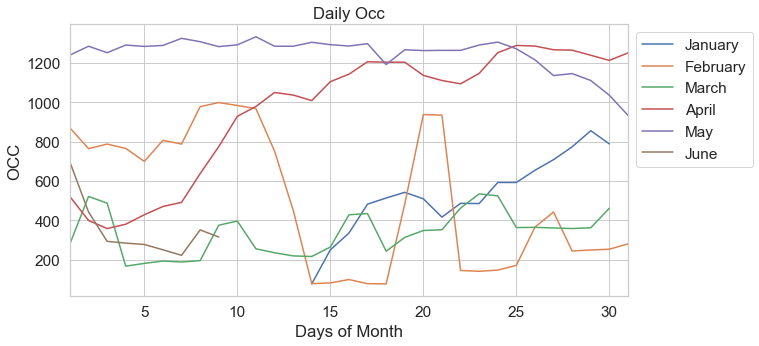

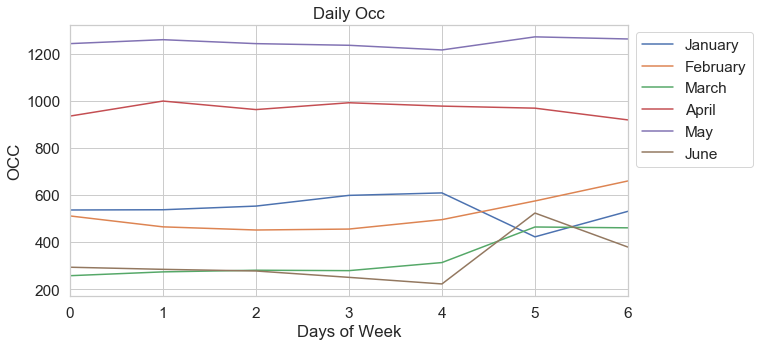



Test TS Analysis On 2019 PARC DU VAL DE LOIRE Occ.




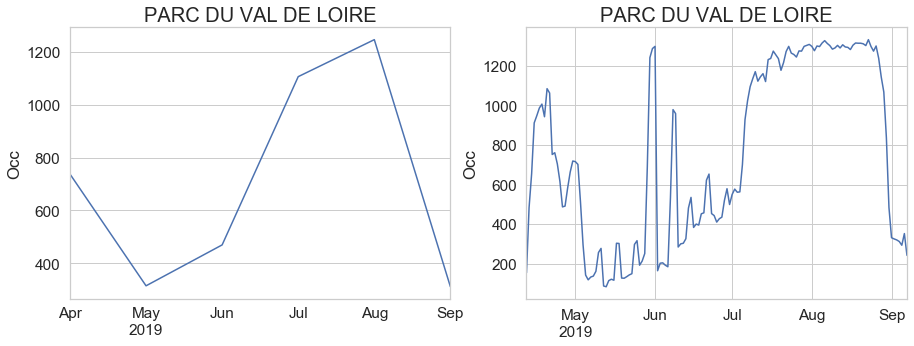

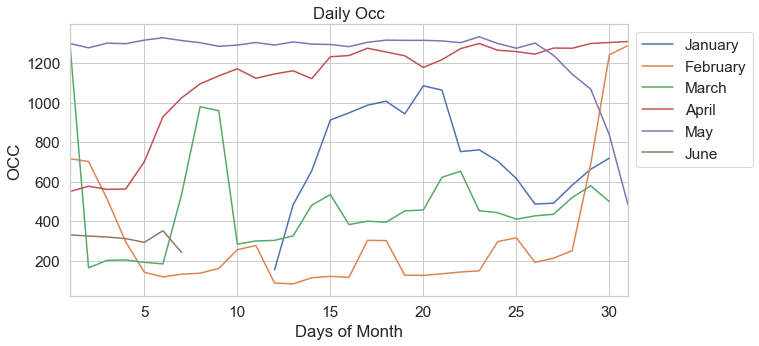

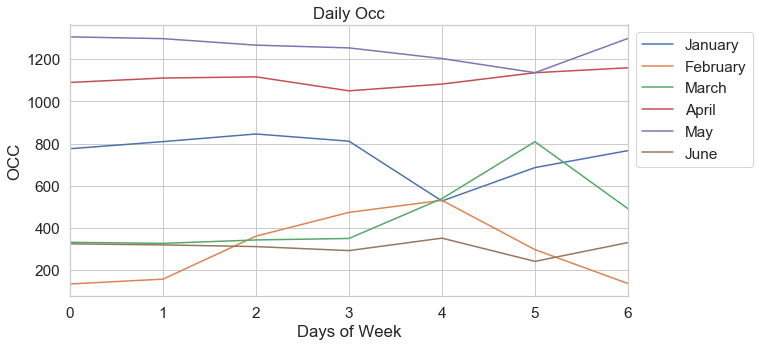

Dates range:
2018-04-14 00:00:00 - 2019-09-07 00:00:00

('X shape: ', (289, 9))
('y shape: ', (289,))
('X_train shape: ', (140, 9))
('X_test shape: ', (149, 9))
('y_train shape: ', (140,))
('y_test shape: ', (149,))
R2:	0.867
RMSE:	26399.05


Train TS Analysis On 2018 BAIE DE DOUARNENEZ Occ.




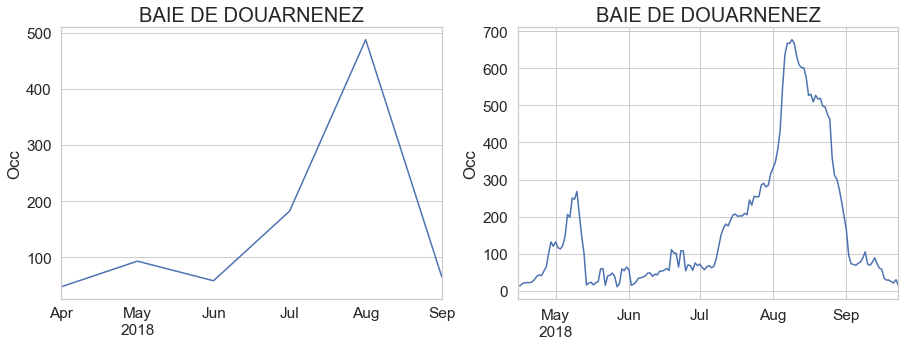

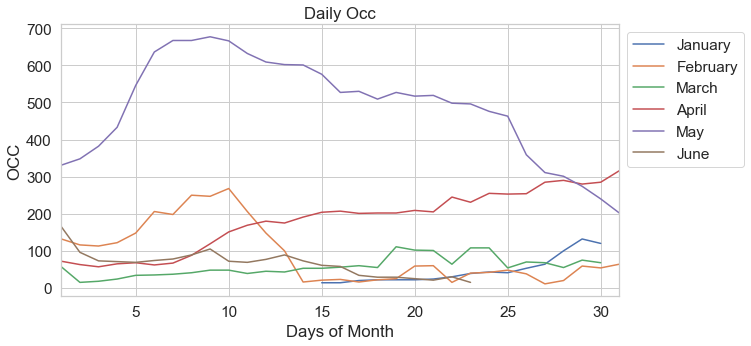

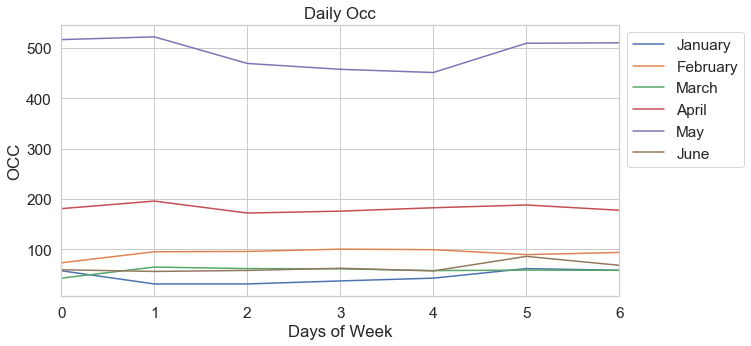



Test TS Analysis On 2019 BAIE DE DOUARNENEZ Occ.




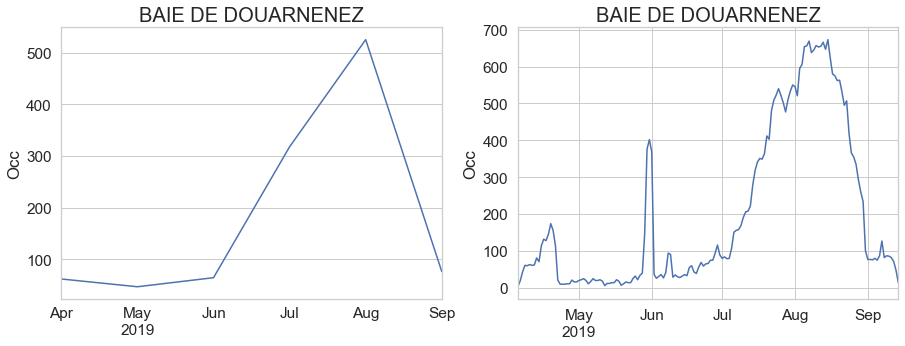

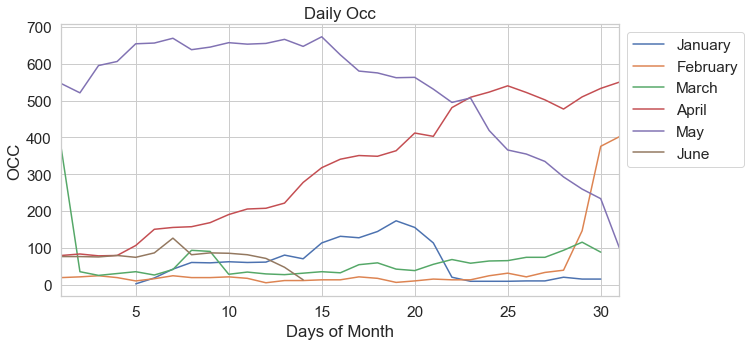

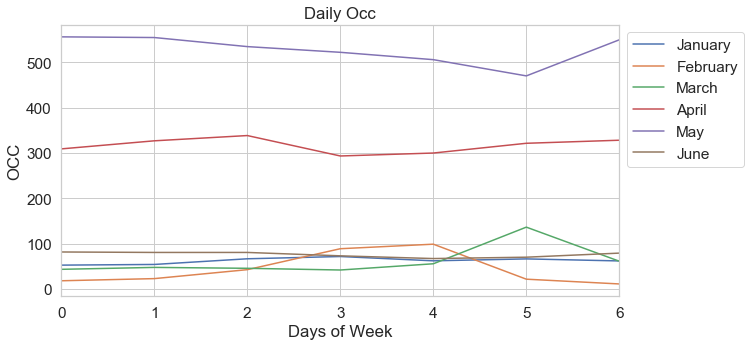

Dates range:
2018-04-15 00:00:00 - 2019-09-14 00:00:00

('X shape: ', (316, 9))
('y shape: ', (316,))
('X_train shape: ', (153, 9))
('X_test shape: ', (163, 9))
('y_train shape: ', (153,))
('y_test shape: ', (163,))
R2:	0.951
RMSE:	2299.94


Train TS Analysis On 2018 ALOHA Occ.




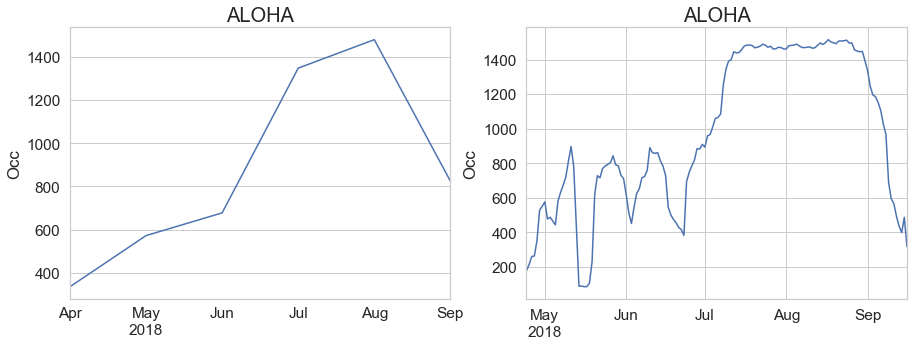

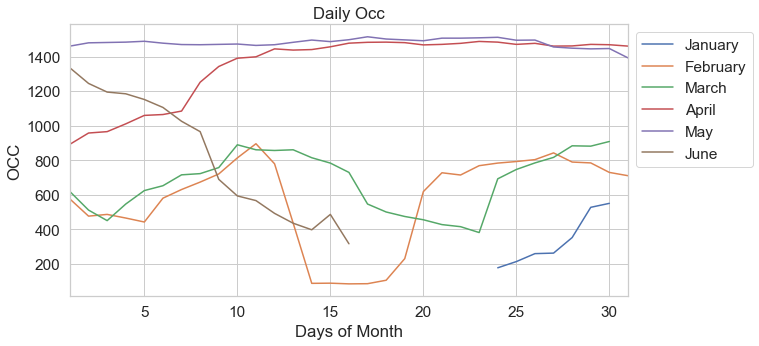

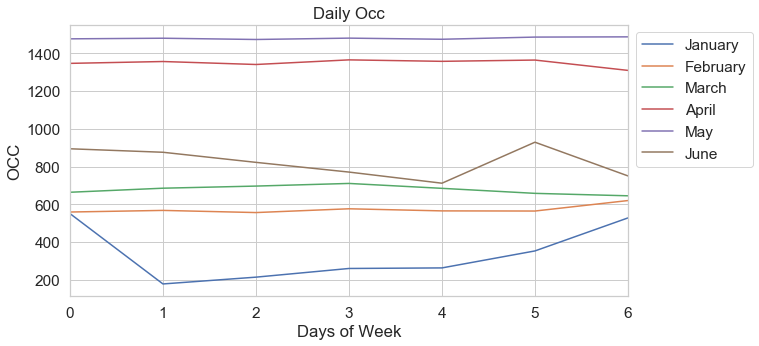



Test TS Analysis On 2019 ALOHA Occ.




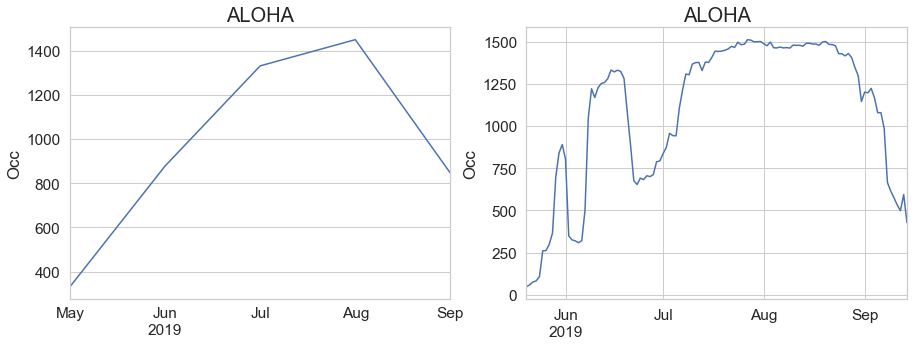

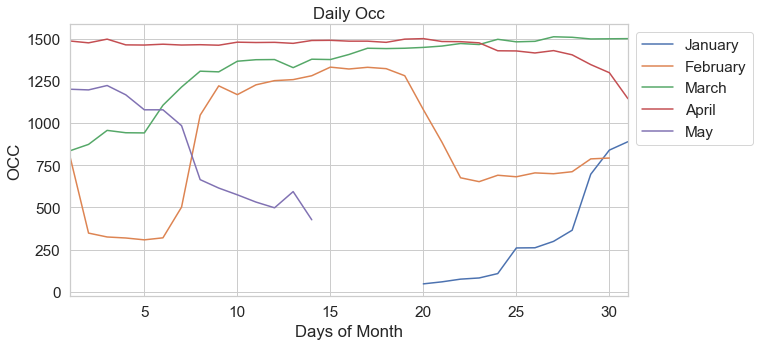

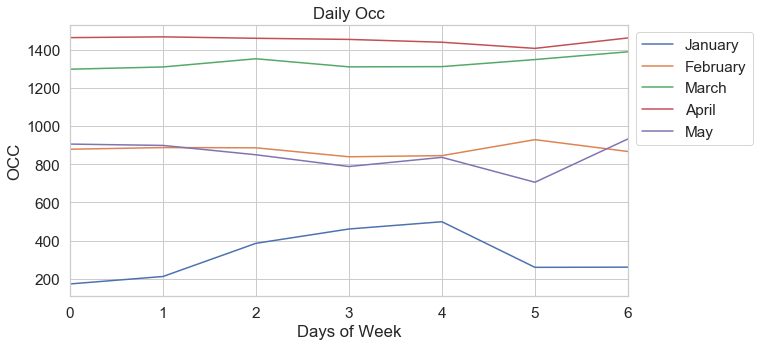

Dates range:
2018-04-24 00:00:00 - 2019-09-14 00:00:00

('X shape: ', (255, 9))
('y shape: ', (255,))
('X_train shape: ', (137, 9))
('X_test shape: ', (118, 9))
('y_train shape: ', (137,))
('y_test shape: ', (118,))
R2:	0.931
RMSE:	13057.93


Train TS Analysis On 2018 MANE GUERNEHUE Occ.




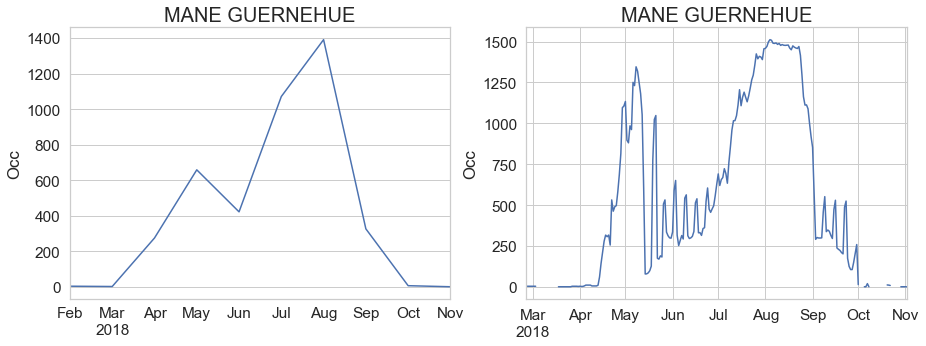

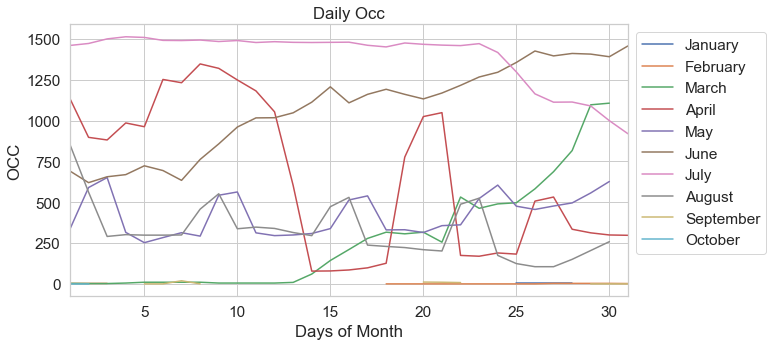

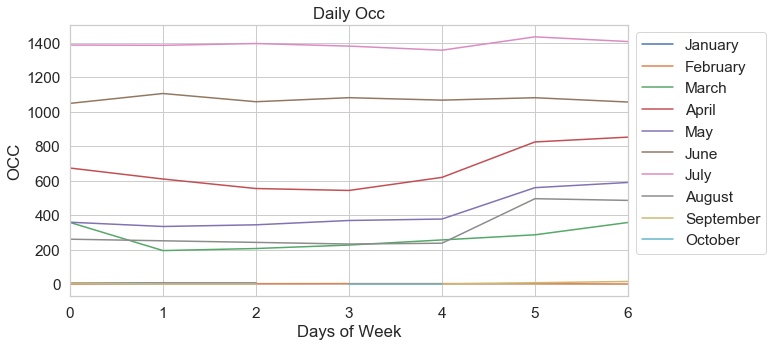



Test TS Analysis On 2019 MANE GUERNEHUE Occ.




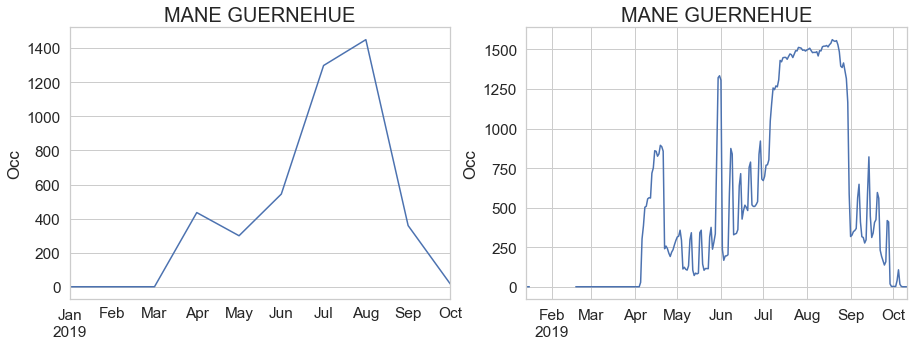

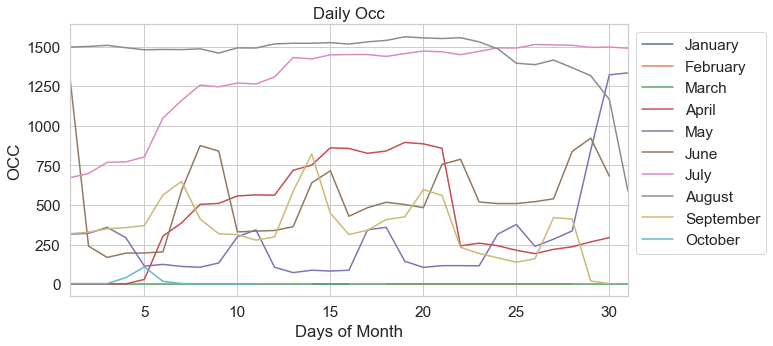

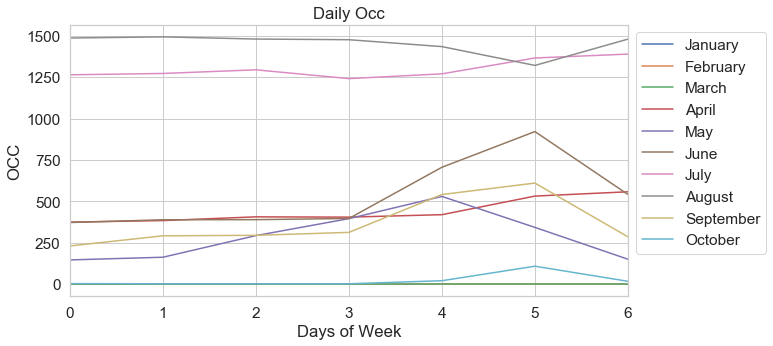

Dates range:
2018-02-25 00:00:00 - 2019-10-11 00:00:00

('X shape: ', (448, 9))
('y shape: ', (448,))
('X_train shape: ', (209, 9))
('X_test shape: ', (239, 9))
('y_train shape: ', (209,))
('y_test shape: ', (239,))
R2:	0.928
RMSE:	22460.44


Train TS Analysis On 2018 PIN PARASOL Occ.




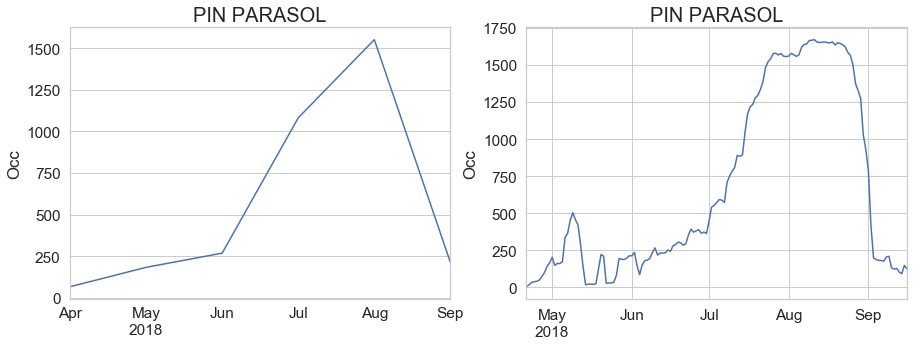

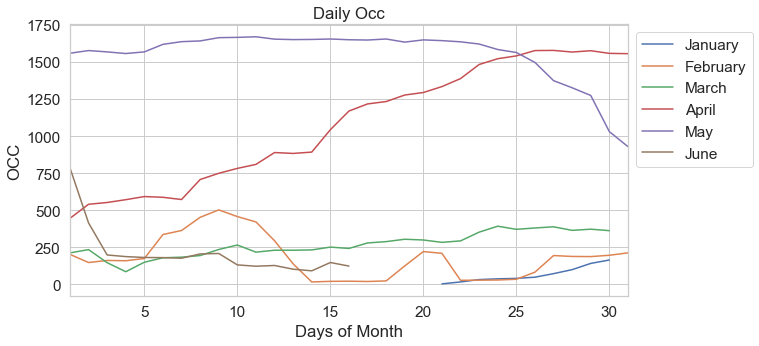

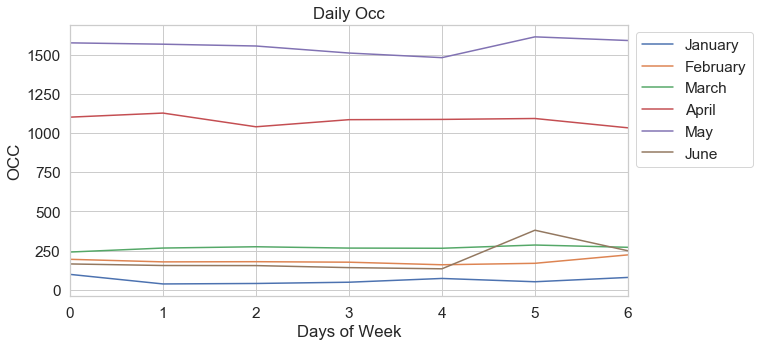



Test TS Analysis On 2019 PIN PARASOL Occ.




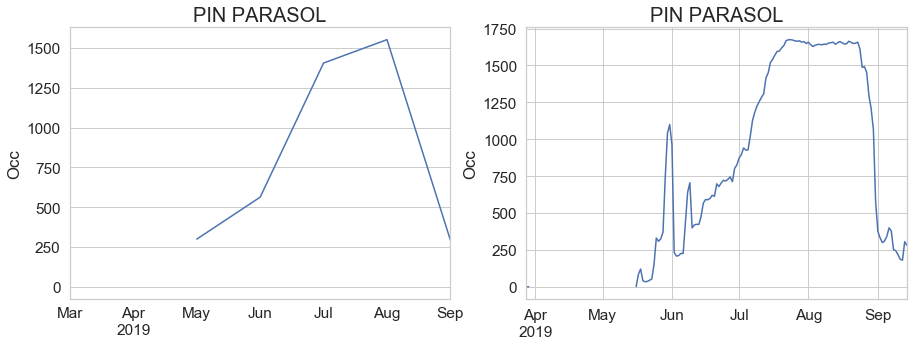

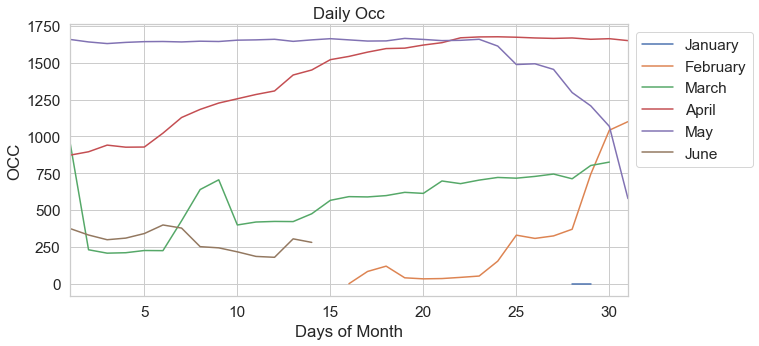

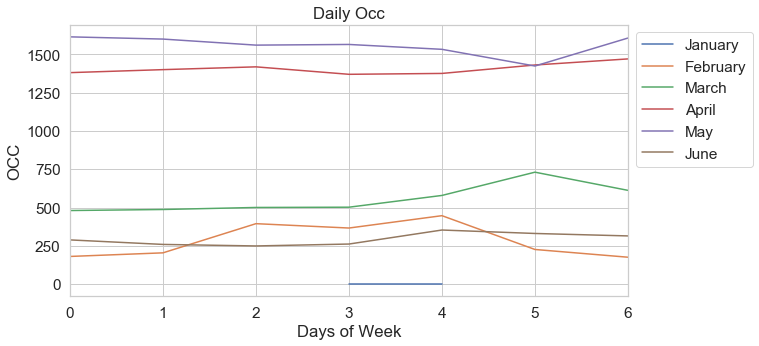

Dates range:
2018-04-21 00:00:00 - 2019-09-14 00:00:00

('X shape: ', (264, 9))
('y shape: ', (264,))
('X_train shape: ', (140, 9))
('X_test shape: ', (124, 9))
('y_train shape: ', (140,))
('y_test shape: ', (124,))
R2:	0.962
RMSE:	13657.04


Train TS Analysis On 2018 DOMAINE DARNAUTEILLE Occ.




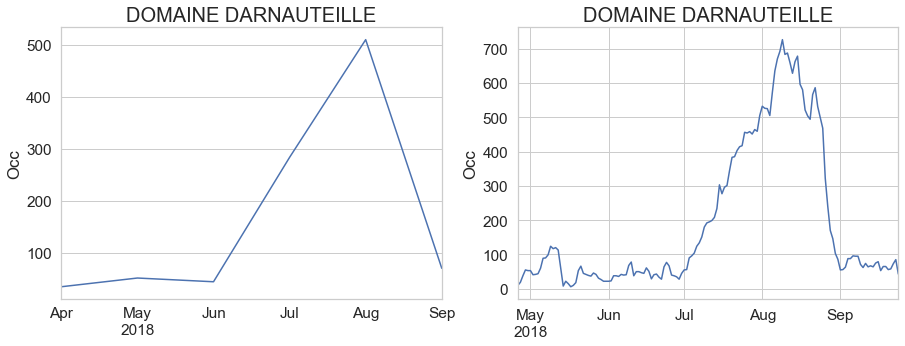

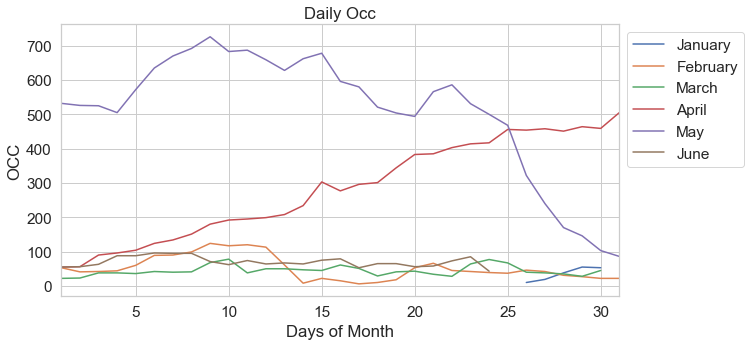

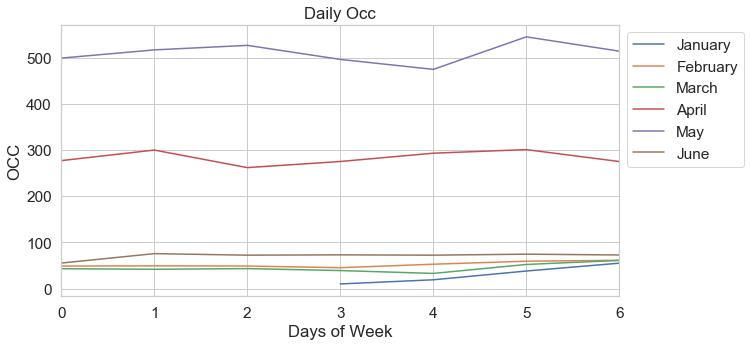



Test TS Analysis On 2019 DOMAINE DARNAUTEILLE Occ.




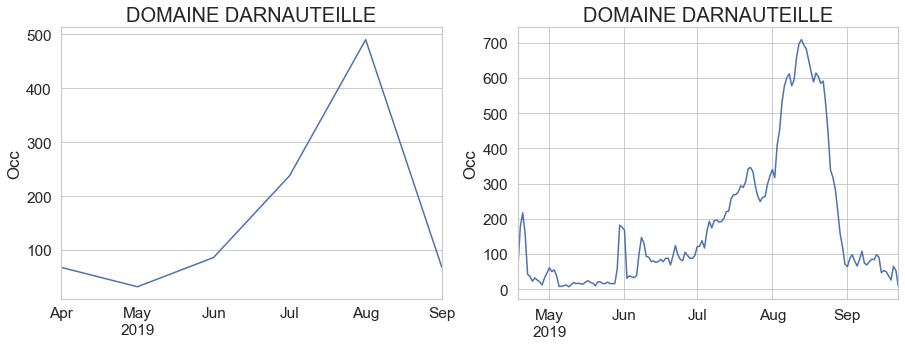

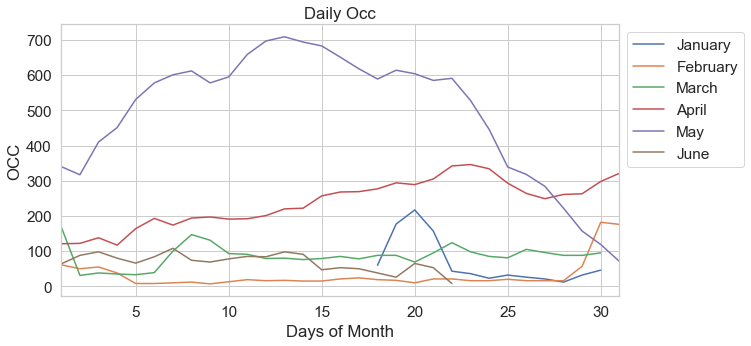

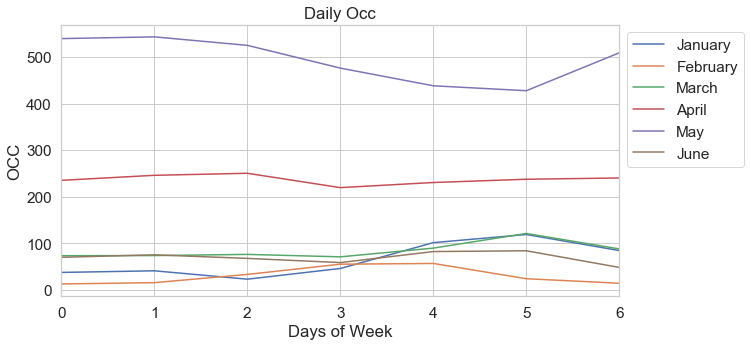

Dates range:
2018-04-26 00:00:00 - 2019-09-22 00:00:00

('X shape: ', (301, 9))
('y shape: ', (301,))
('X_train shape: ', (143, 9))
('X_test shape: ', (158, 9))
('y_train shape: ', (143,))
('y_test shape: ', (158,))
R2:	0.961
RMSE:	1436.92


Train TS Analysis On 2018 MER ET SOLEIL Occ.




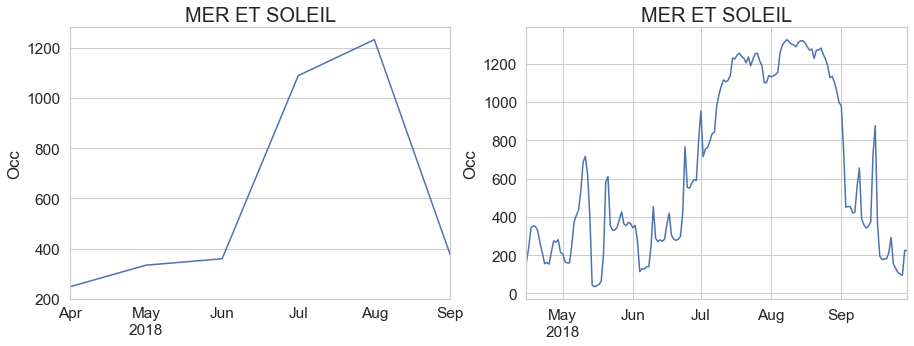

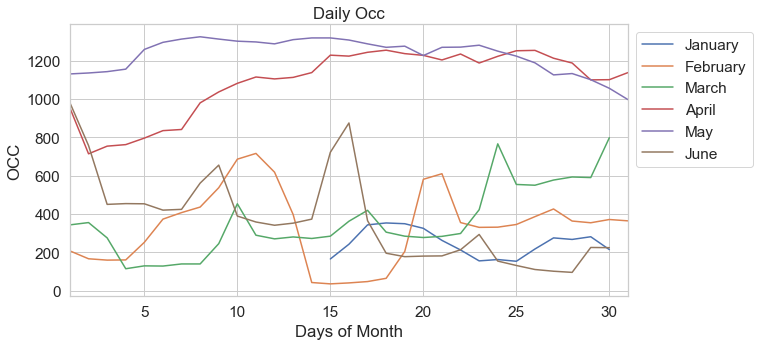

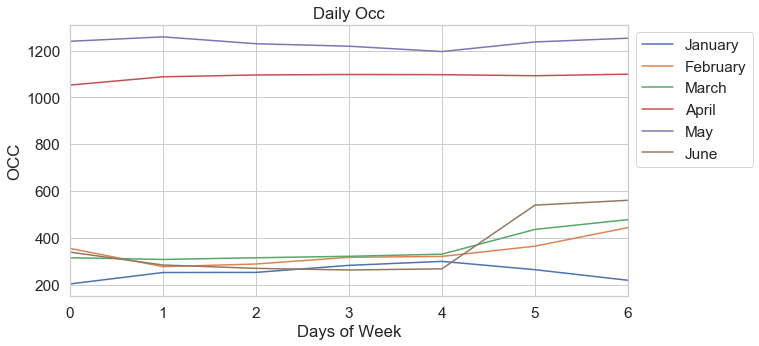



Test TS Analysis On 2019 MER ET SOLEIL Occ.




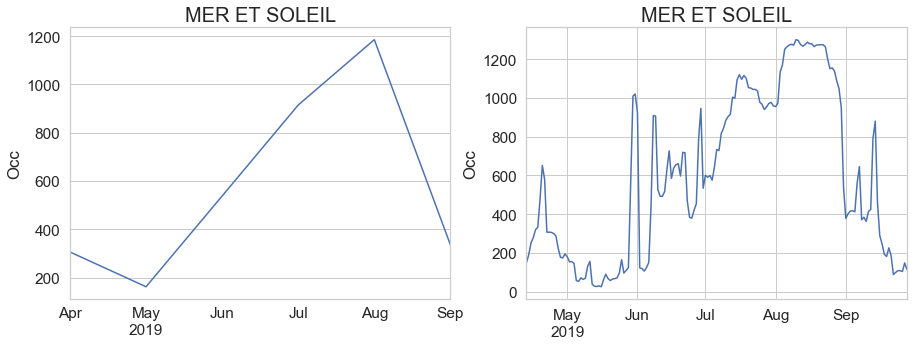

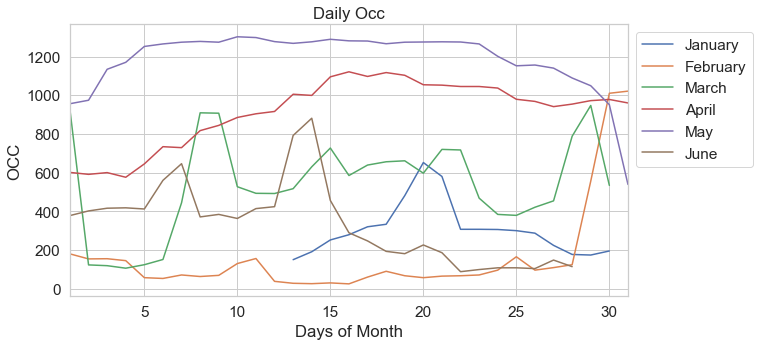

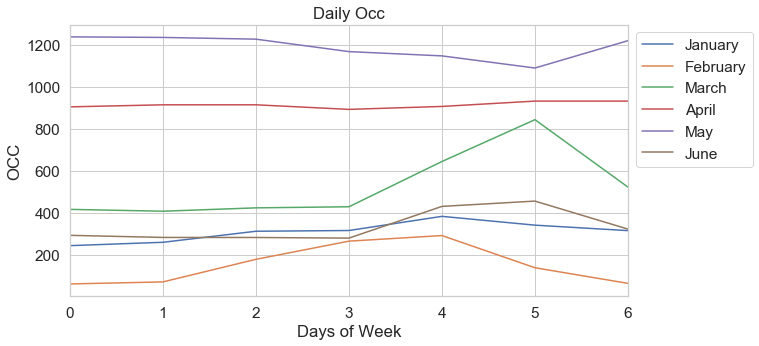

Dates range:
2018-04-15 00:00:00 - 2019-09-28 00:00:00

('X shape: ', (329, 9))
('y shape: ', (329,))
('X_train shape: ', (160, 9))
('X_test shape: ', (169, 9))
('y_train shape: ', (160,))
('y_test shape: ', (169,))
R2:	0.921
RMSE:	14075.71


Train TS Analysis On 2018 MAS SANT JOSEP Occ.




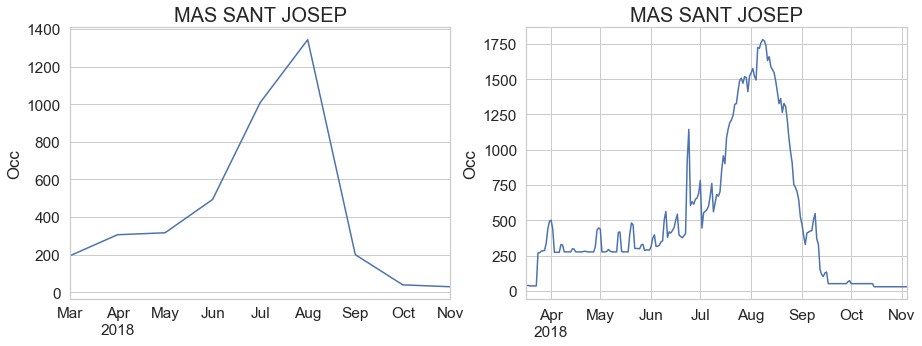

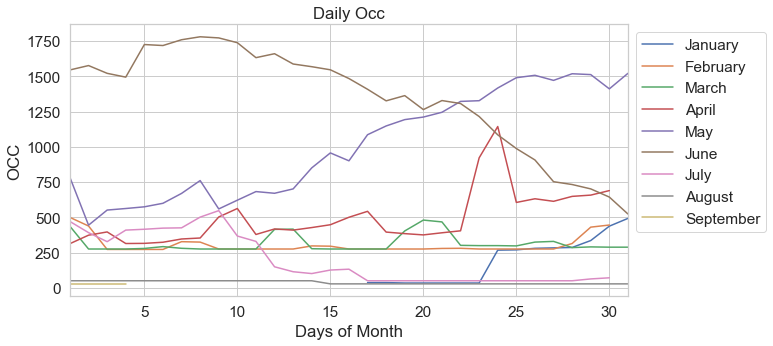

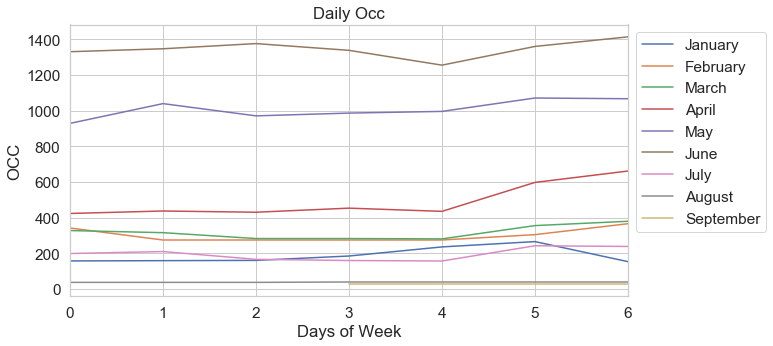



Test TS Analysis On 2019 MAS SANT JOSEP Occ.




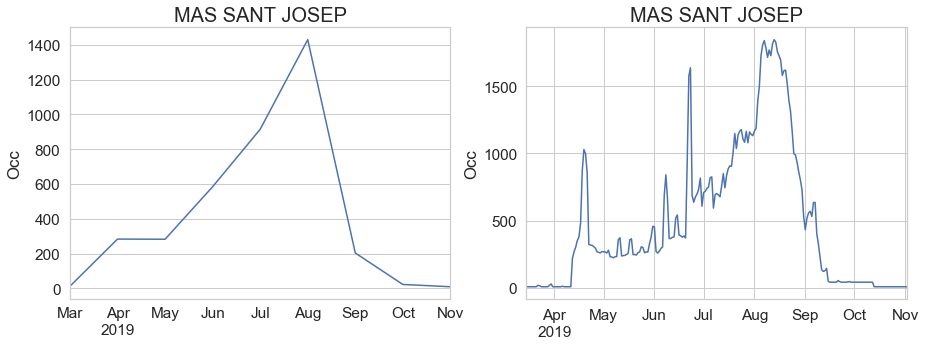

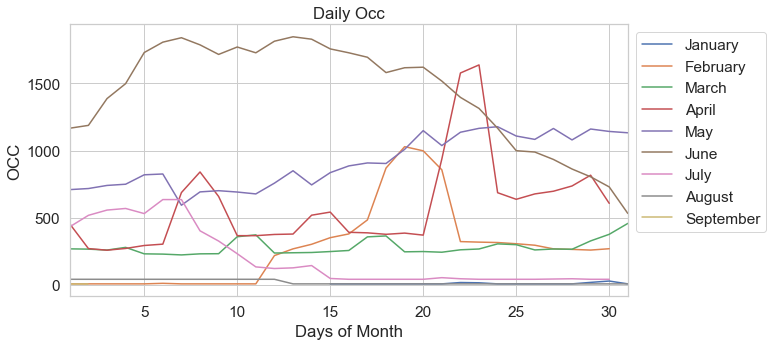

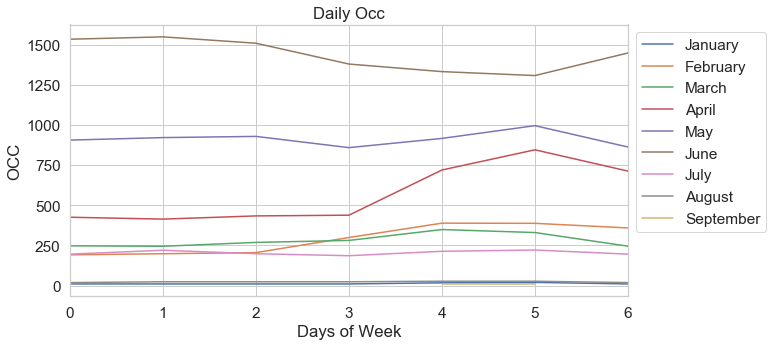

Dates range:
2018-03-17 00:00:00 - 2019-11-02 00:00:00

('X shape: ', (457, 9))
('y shape: ', (457,))
('X_train shape: ', (224, 9))
('X_test shape: ', (233, 9))
('y_train shape: ', (224,))
('y_test shape: ', (233,))
R2:	0.948
RMSE:	13983.27


Train TS Analysis On 2018 VOILES D'ANJOU Occ.




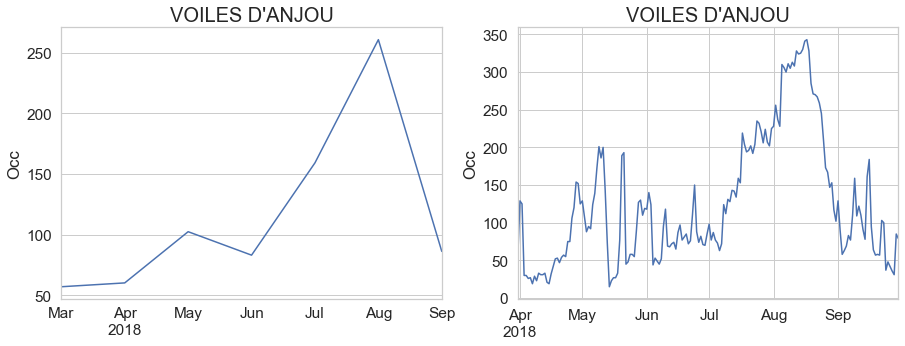

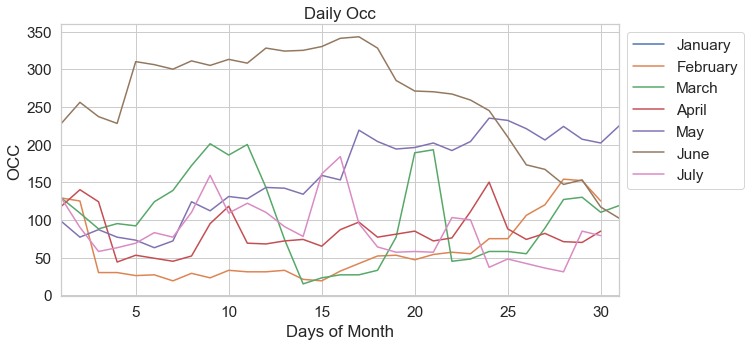

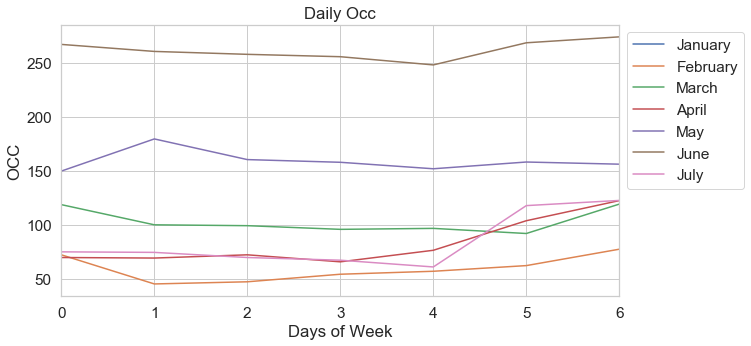



Test TS Analysis On 2019 VOILES D'ANJOU Occ.




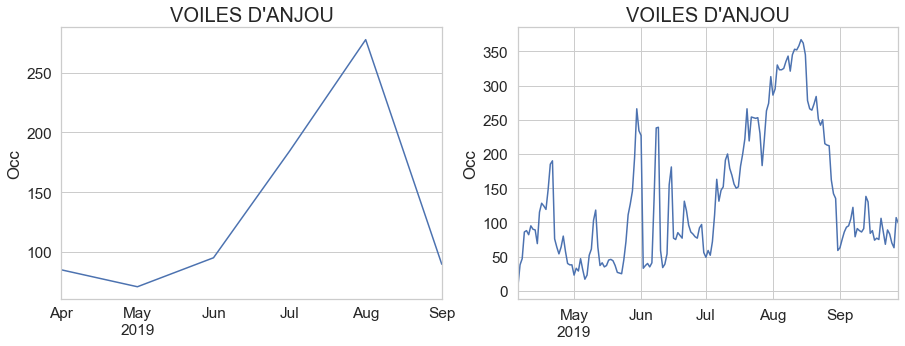

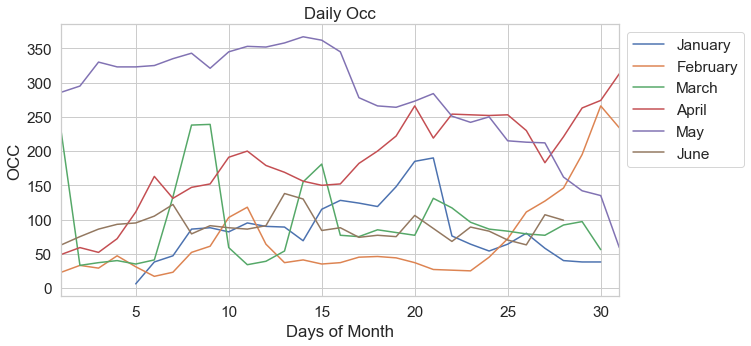

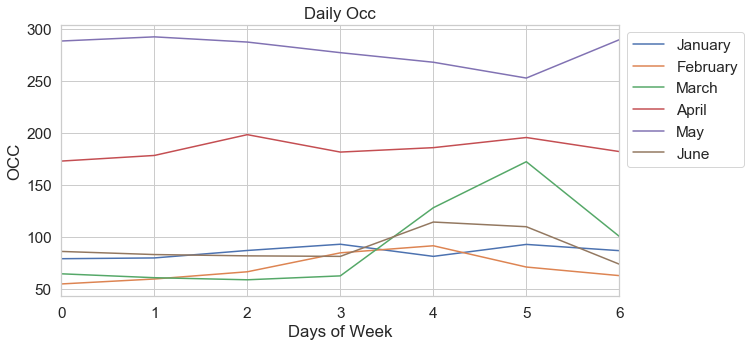

Dates range:
2018-03-31 00:00:00 - 2019-09-28 00:00:00

('X shape: ', (352, 9))
('y shape: ', (352,))
('X_train shape: ', (175, 9))
('X_test shape: ', (177, 9))
('y_train shape: ', (175,))
('y_test shape: ', (177,))
R2:	0.842
RMSE:	1429.54


Train TS Analysis On 2018 BASTIANE Occ.




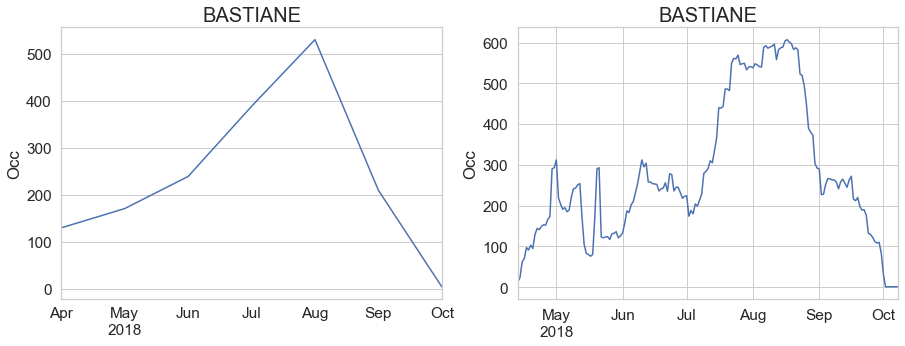

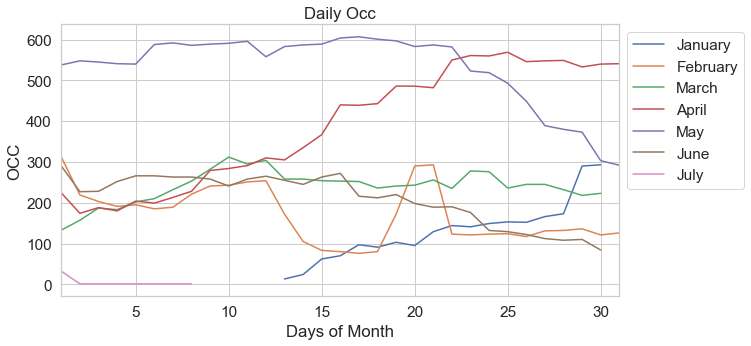

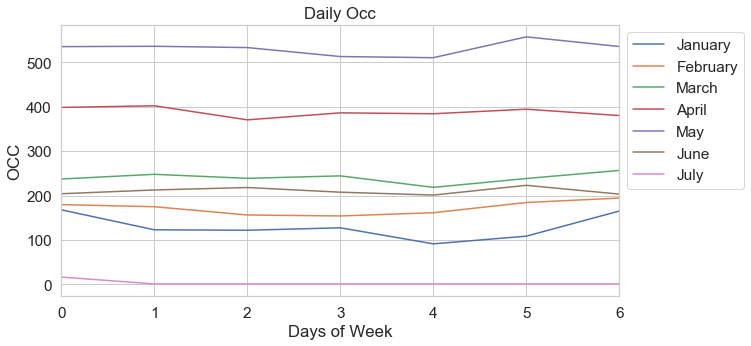



Test TS Analysis On 2019 BASTIANE Occ.




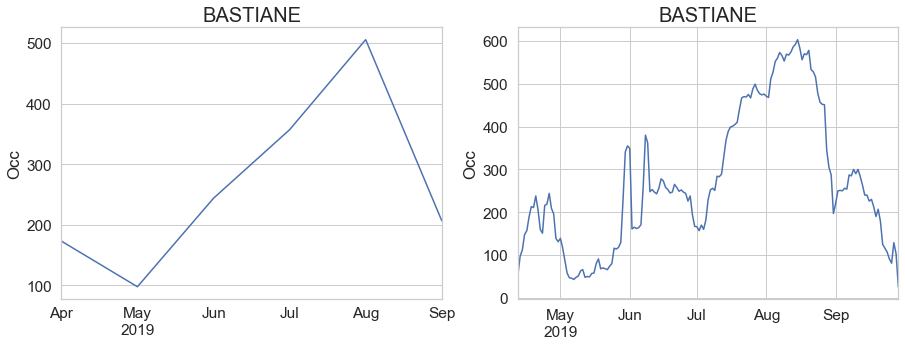

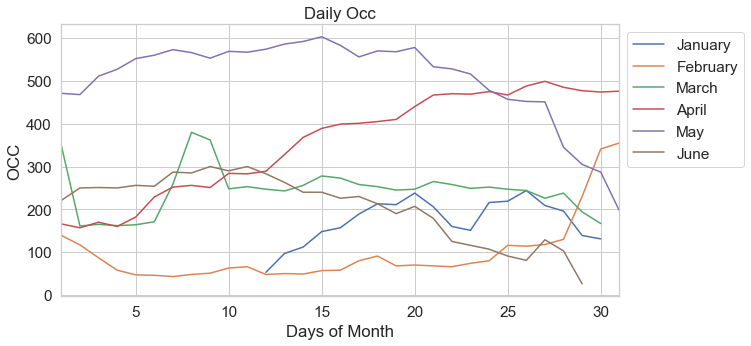

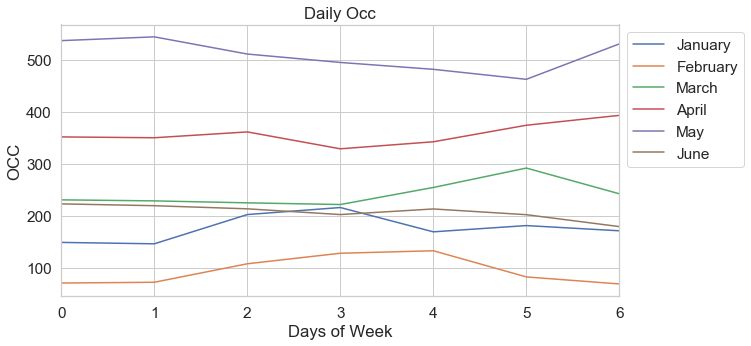

Dates range:
2018-04-13 00:00:00 - 2019-09-29 00:00:00

('X shape: ', (341, 9))
('y shape: ', (341,))
('X_train shape: ', (170, 9))
('X_test shape: ', (171, 9))
('y_train shape: ', (170,))
('y_test shape: ', (171,))
R2:	0.945
RMSE:	1405.43


Train TS Analysis On 2018 PETITE CAMARGUE Occ.




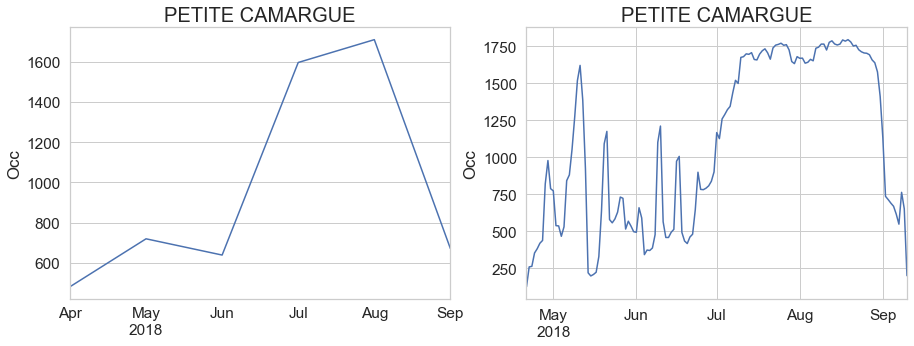

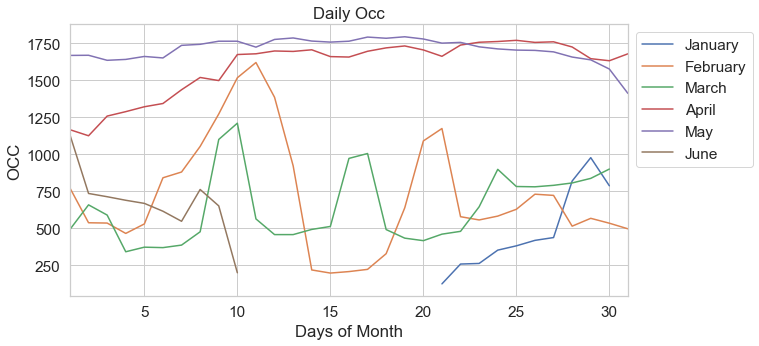

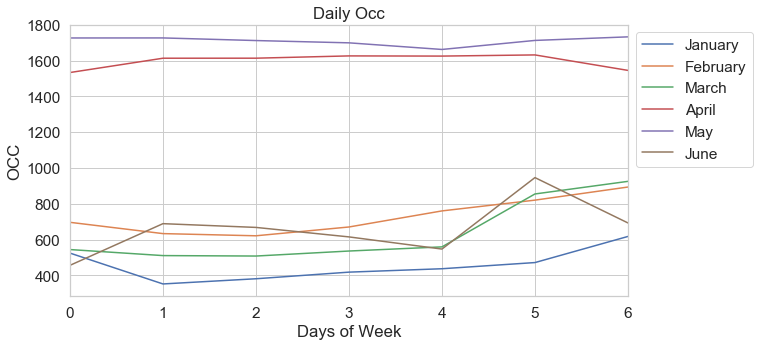



Test TS Analysis On 2019 PETITE CAMARGUE Occ.




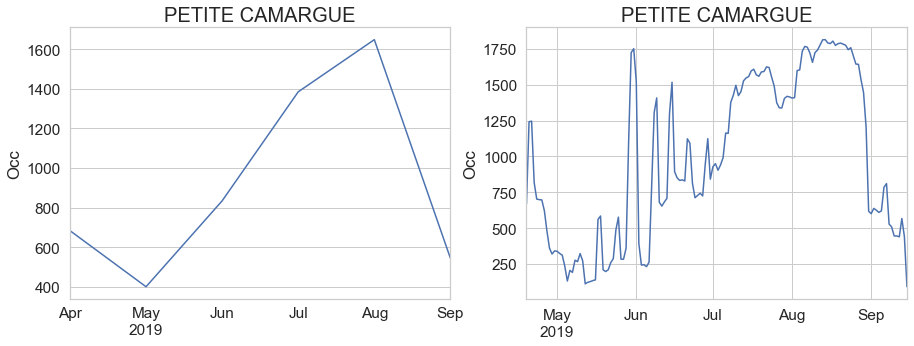

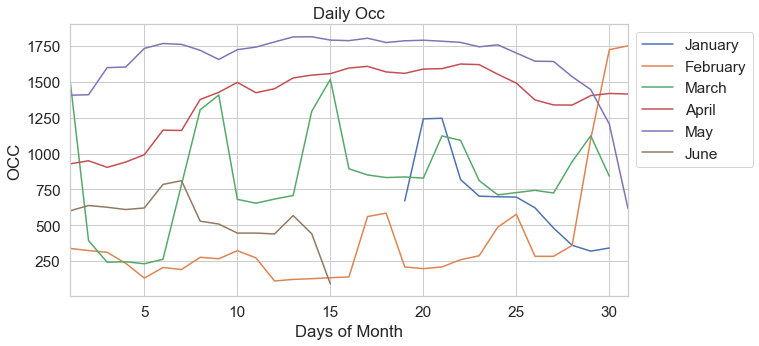

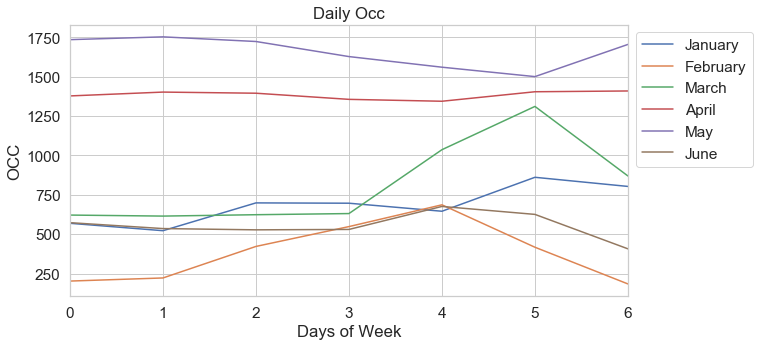

Dates range:
2018-04-21 00:00:00 - 2019-09-15 00:00:00

('X shape: ', (284, 9))
('y shape: ', (284,))
('X_train shape: ', (134, 9))
('X_test shape: ', (150, 9))
('y_train shape: ', (134,))
('y_test shape: ', (150,))
R2:	0.811
RMSE:	59498.76


Train TS Analysis On 2018 POMME DE PIN Occ.




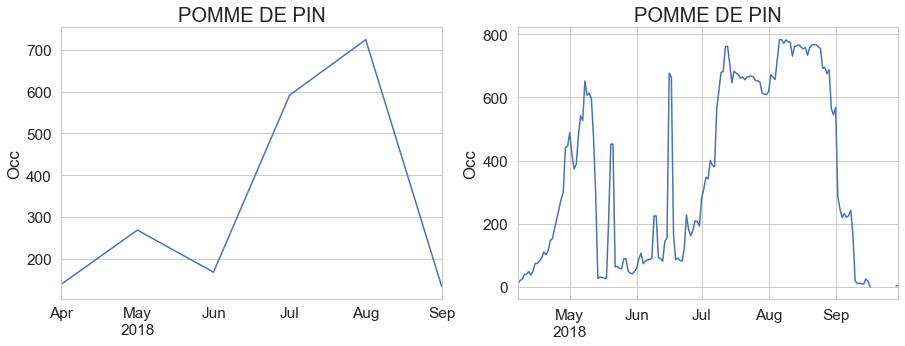

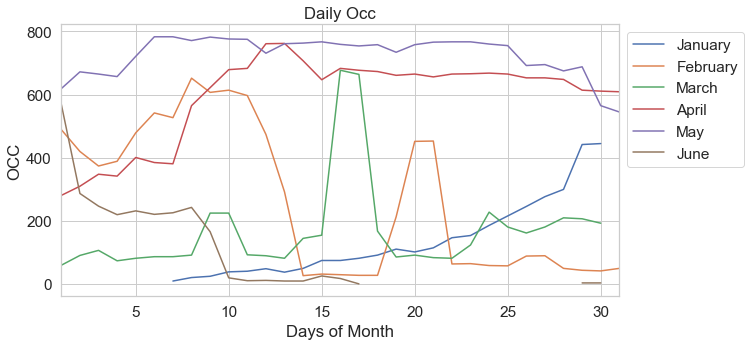

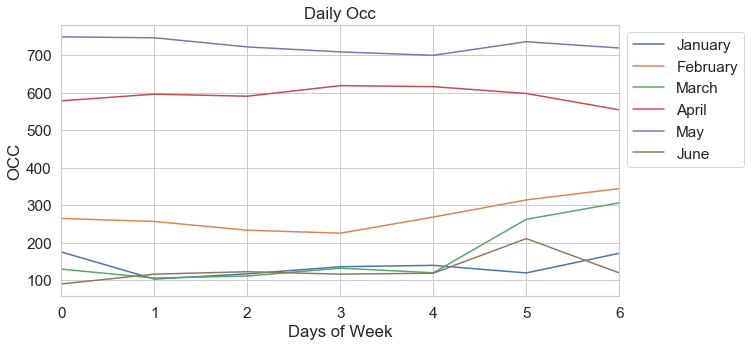



Test TS Analysis On 2019 POMME DE PIN Occ.




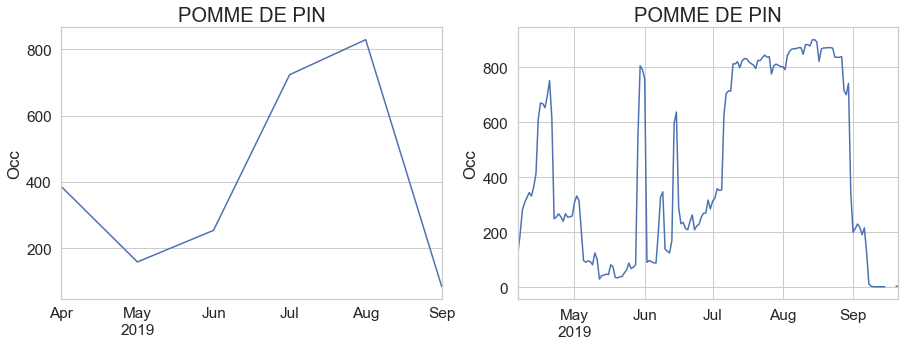

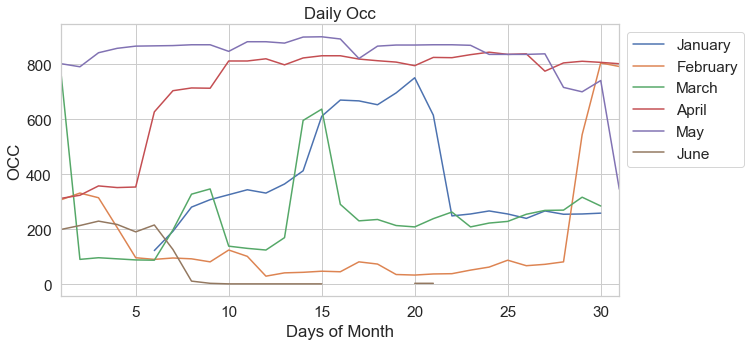

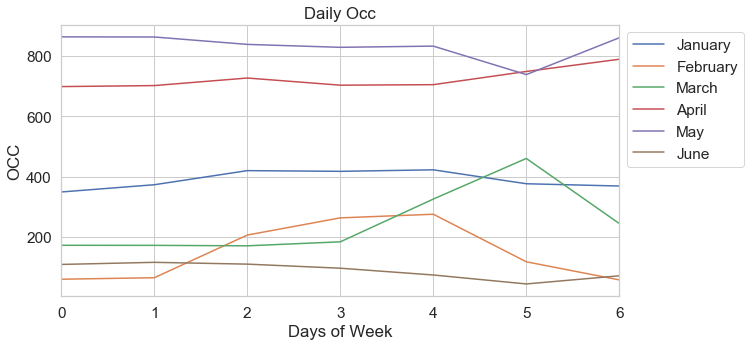

Dates range:
2018-04-07 00:00:00 - 2019-09-21 00:00:00

('X shape: ', (322, 9))
('y shape: ', (322,))
('X_train shape: ', (157, 9))
('X_test shape: ', (165, 9))
('y_train shape: ', (157,))
('y_test shape: ', (165,))
R2:	0.875
RMSE:	12951.2


Train TS Analysis On 2018 CAMPOLORO Occ.




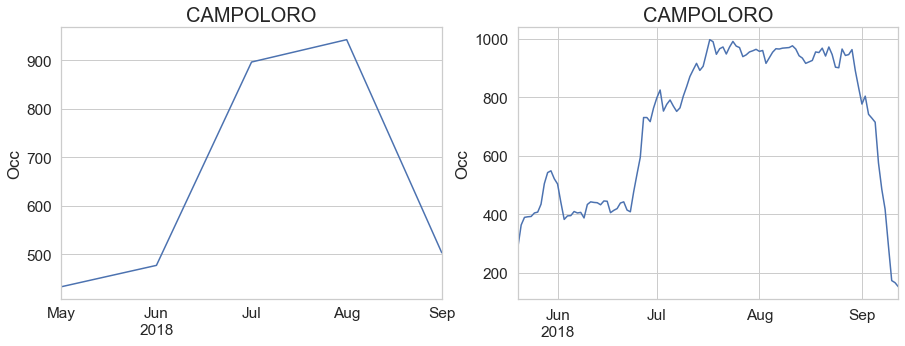

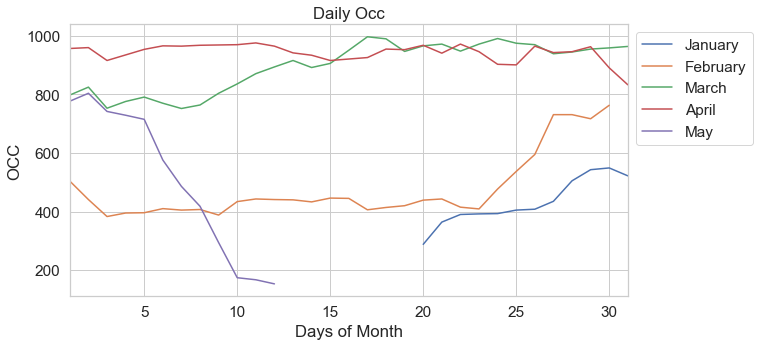

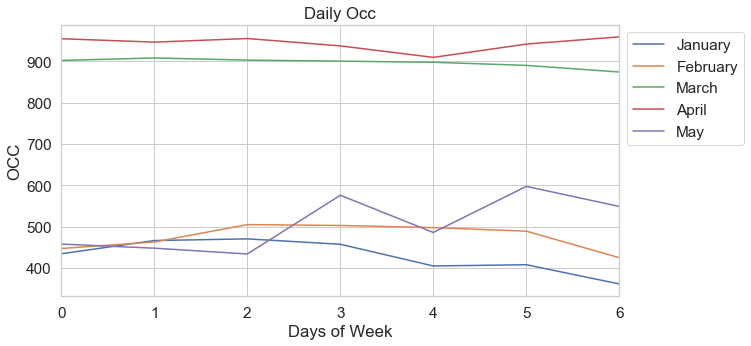



Test TS Analysis On 2019 CAMPOLORO Occ.




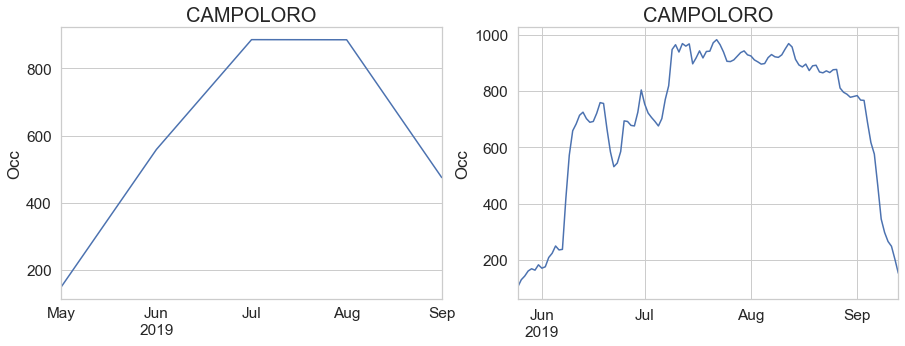

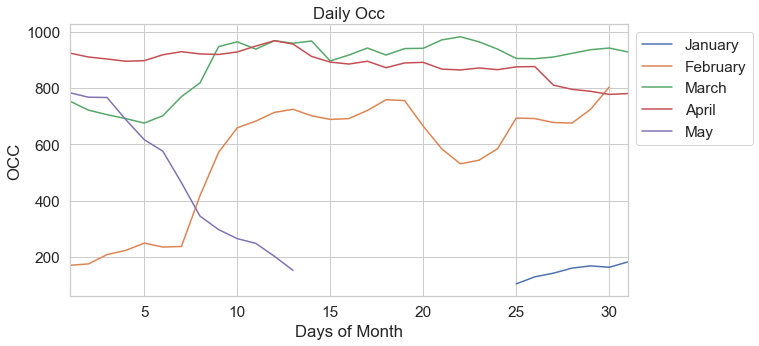

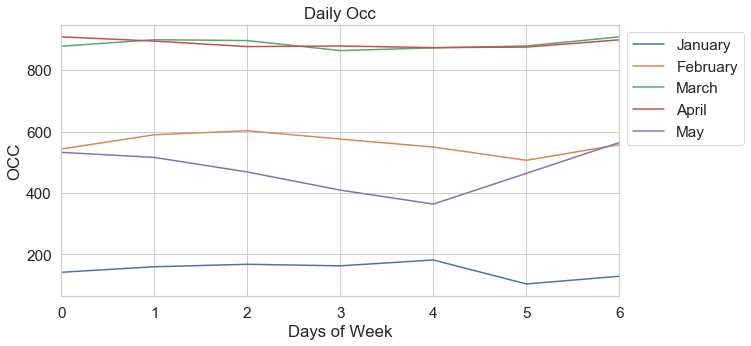

Dates range:
2018-05-20 00:00:00 - 2019-09-13 00:00:00

('X shape: ', (219, 9))
('y shape: ', (219,))
('X_train shape: ', (107, 9))
('X_test shape: ', (112, 9))
('y_train shape: ', (107,))
('y_test shape: ', (112,))
R2:	0.959
RMSE:	2878.35


Train TS Analysis On 2018 LAVEDAN Occ.




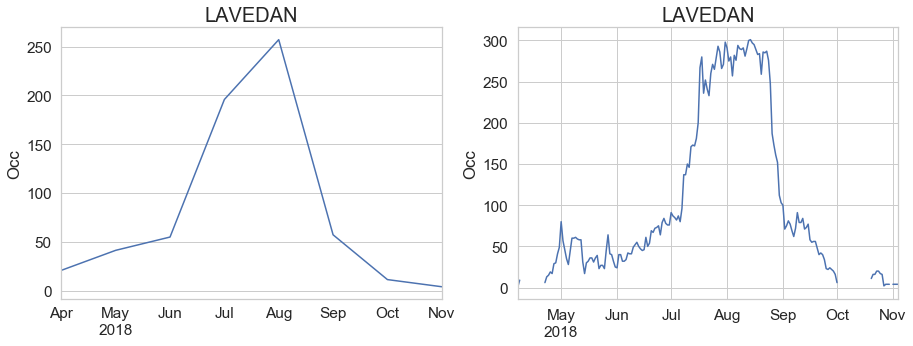

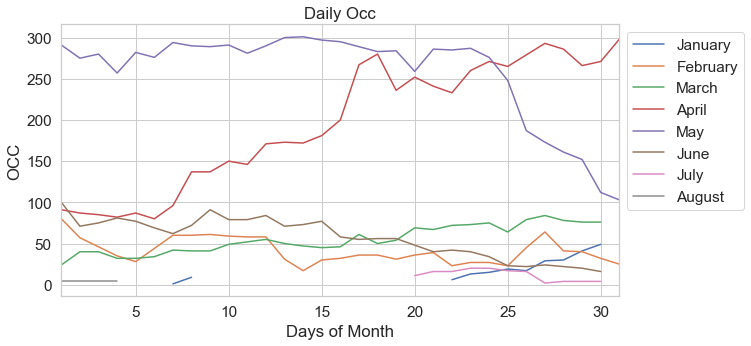

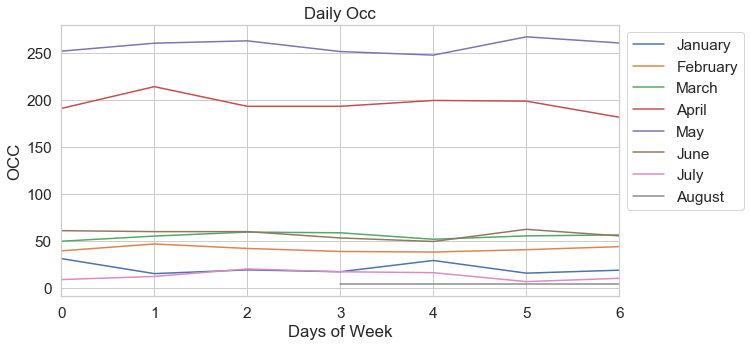



Test TS Analysis On 2019 LAVEDAN Occ.




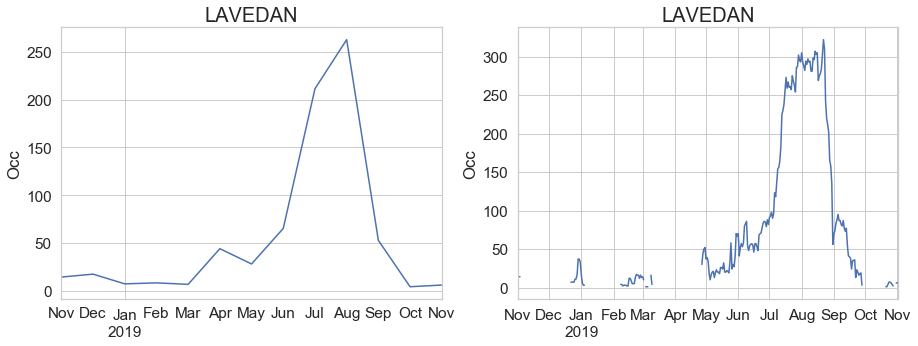

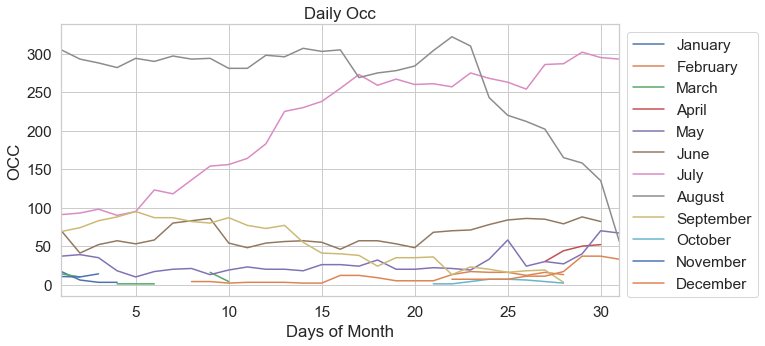

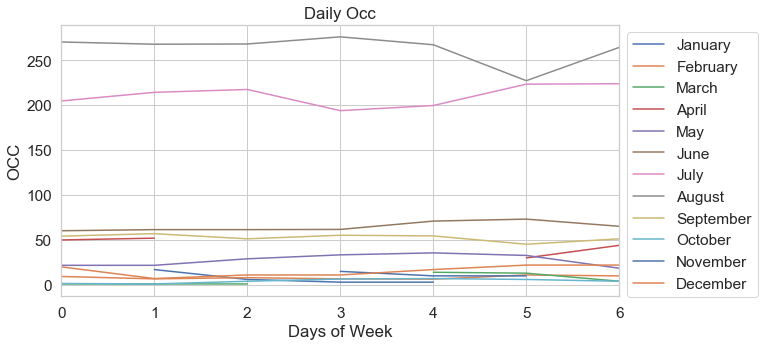

Dates range:
2018-04-07 00:00:00 - 2019-11-02 00:00:00

('X shape: ', (382, 9))
('y shape: ', (382,))
('X_train shape: ', (184, 9))
('X_test shape: ', (198, 9))
('y_train shape: ', (184,))
('y_test shape: ', (198,))
R2:	0.982
RMSE:	196.77


Train TS Analysis On 2018 PINS Occ.




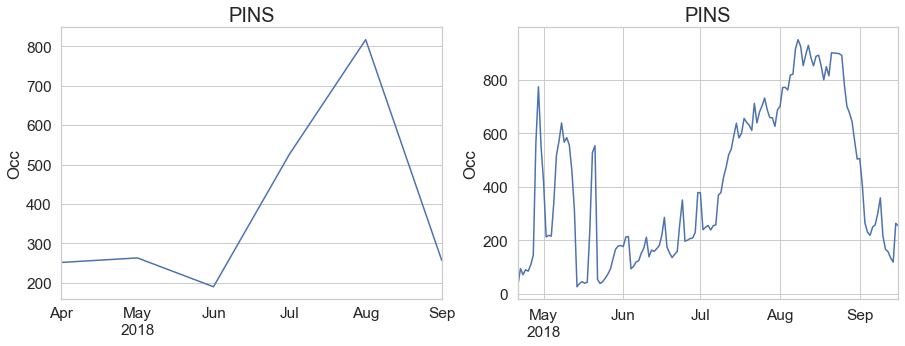

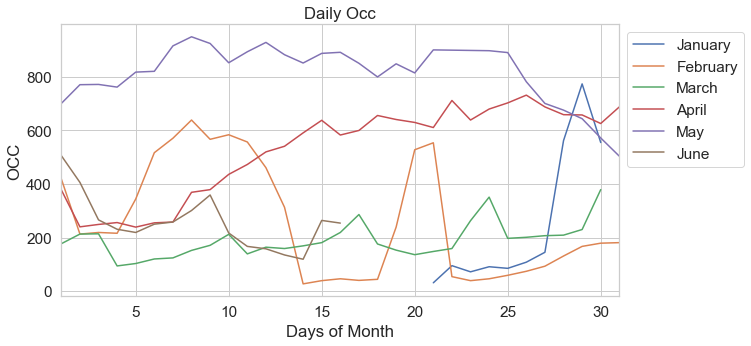

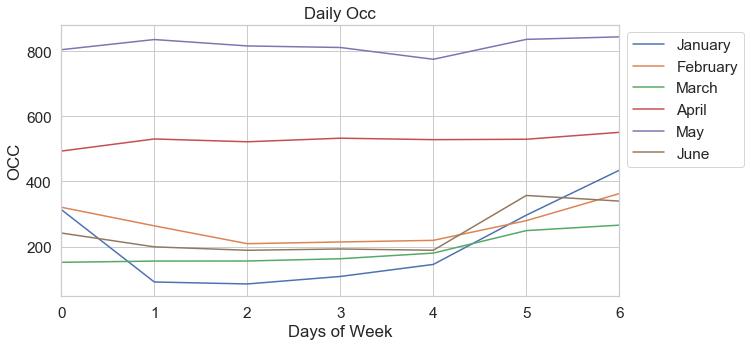



Test TS Analysis On 2019 PINS Occ.




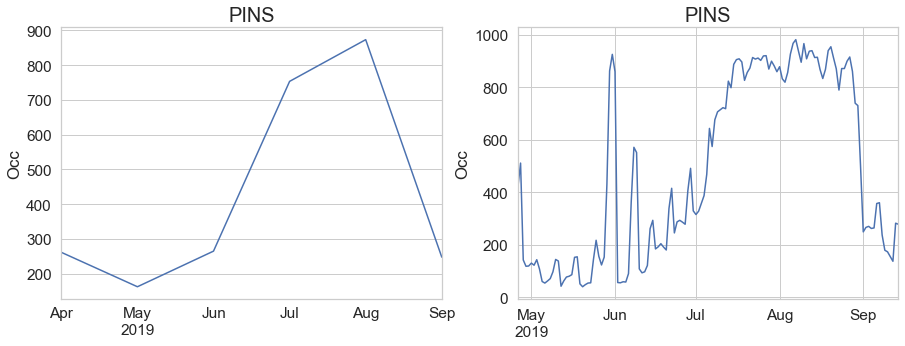

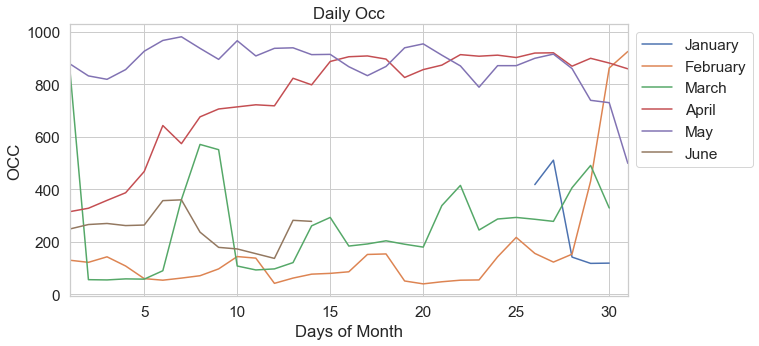

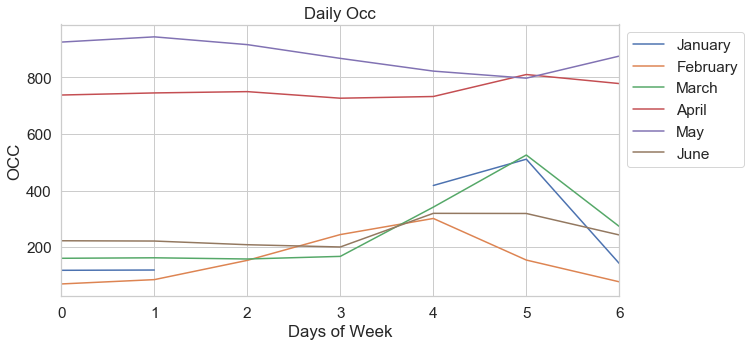

Dates range:
2018-04-21 00:00:00 - 2019-09-14 00:00:00

('X shape: ', (282, 9))
('y shape: ', (282,))
('X_train shape: ', (140, 9))
('X_test shape: ', (142, 9))
('y_train shape: ', (140,))
('y_test shape: ', (142,))
R2:	0.879
RMSE:	14049.09


Train TS Analysis On 2018 LUBERON PARC Occ.




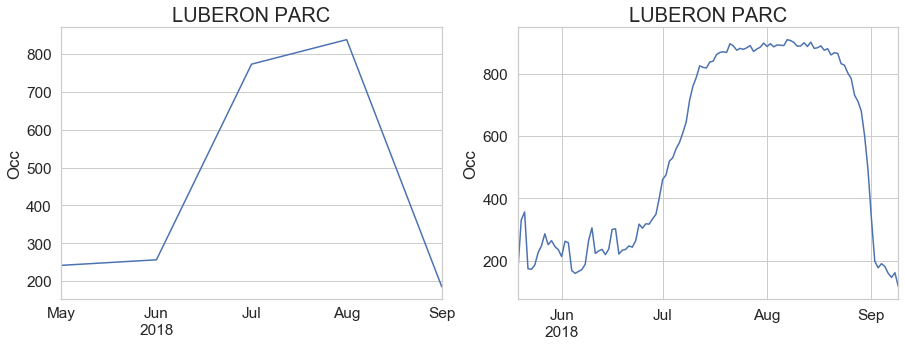

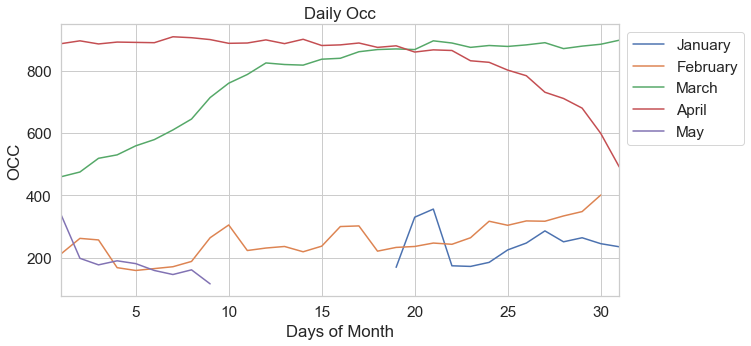

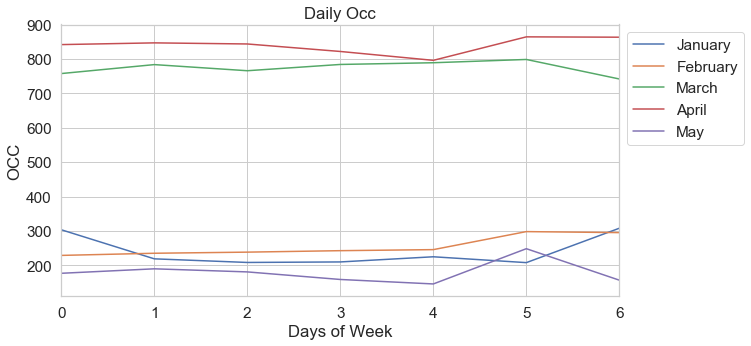



Test TS Analysis On 2019 LUBERON PARC Occ.




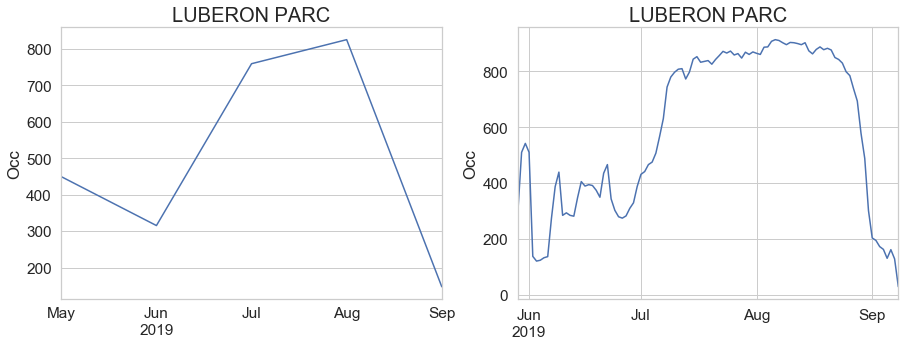

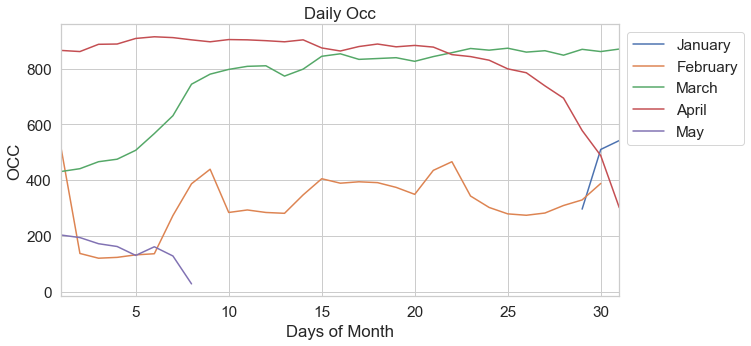

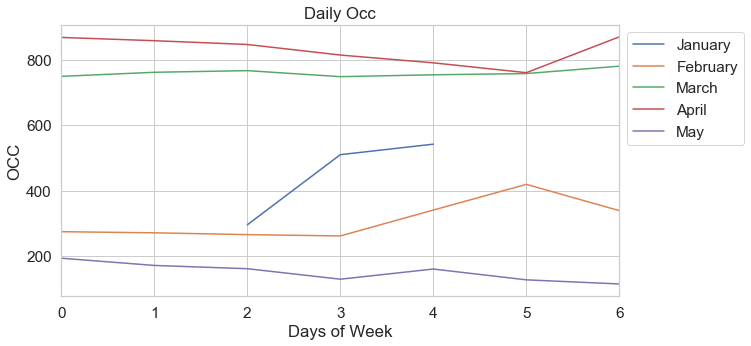

Dates range:
2018-05-19 00:00:00 - 2019-09-08 00:00:00

('X shape: ', (208, 9))
('y shape: ', (208,))
('X_train shape: ', (105, 9))
('X_test shape: ', (103, 9))
('y_train shape: ', (105,))
('y_test shape: ', (103,))
R2:	0.939
RMSE:	4776.4


Train TS Analysis On 2018 BOUT DU MONDE Occ.




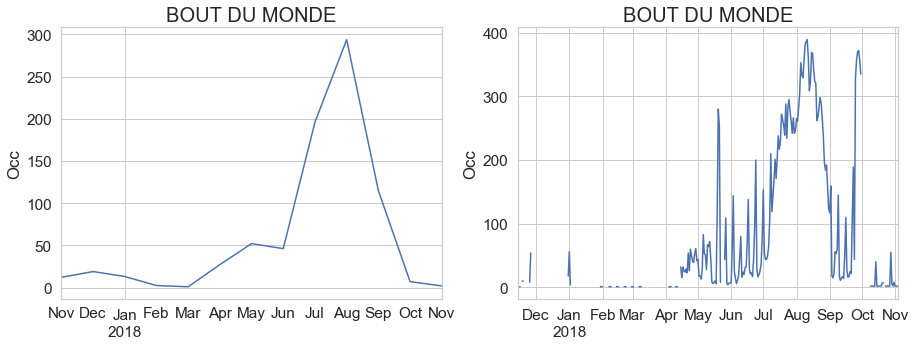

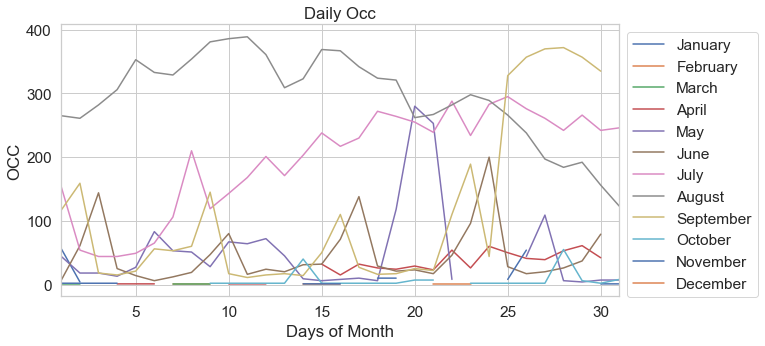

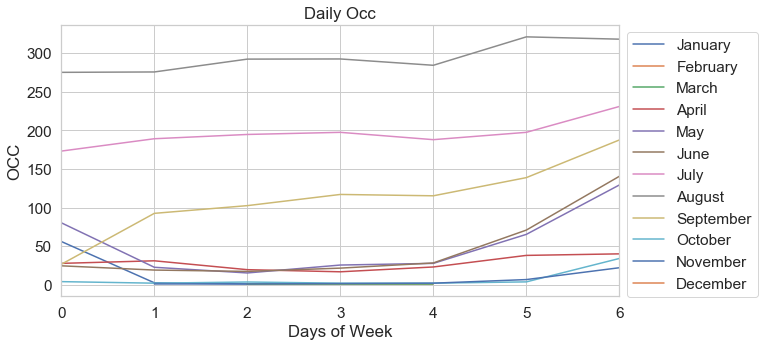



Test TS Analysis On 2019 BOUT DU MONDE Occ.




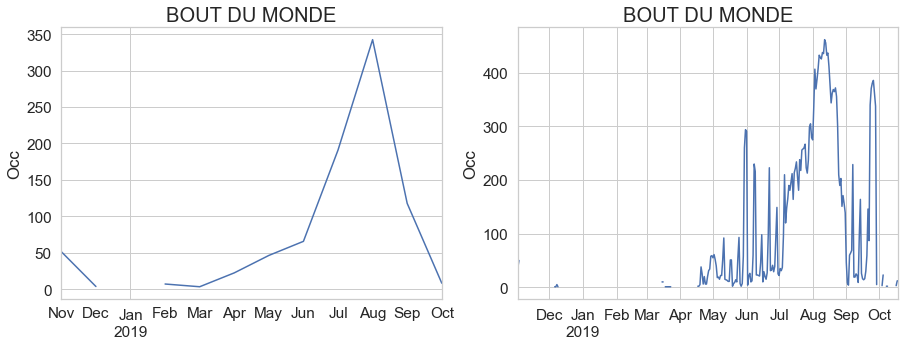

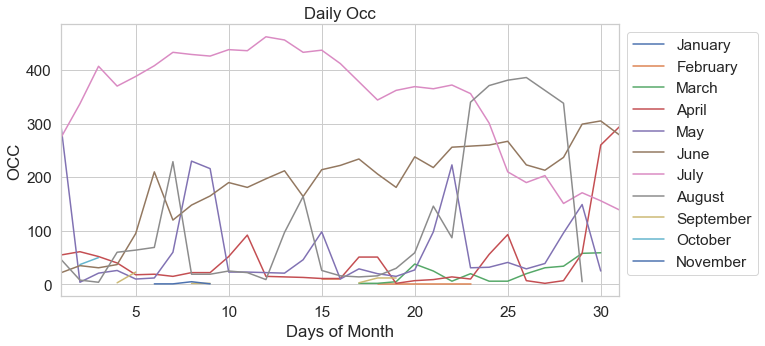

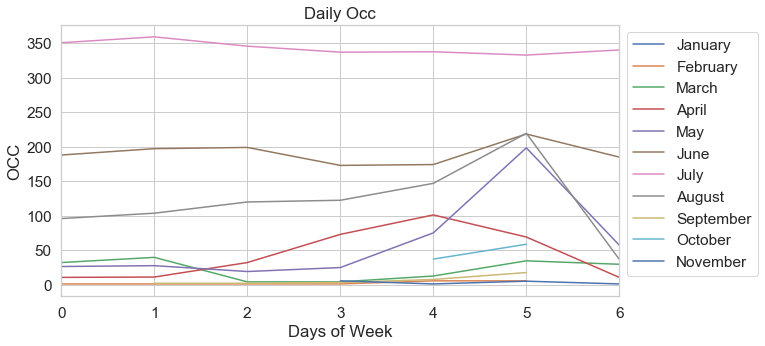

Dates range:
2017-11-14 00:00:00 - 2019-10-19 00:00:00

('X shape: ', (412, 9))
('y shape: ', (412,))
('X_train shape: ', (230, 9))
('X_test shape: ', (182, 9))
('y_train shape: ', (230,))
('y_test shape: ', (182,))
R2:	0.832
RMSE:	3337.9


Train TS Analysis On 2018 SAINT LOUIS Occ.




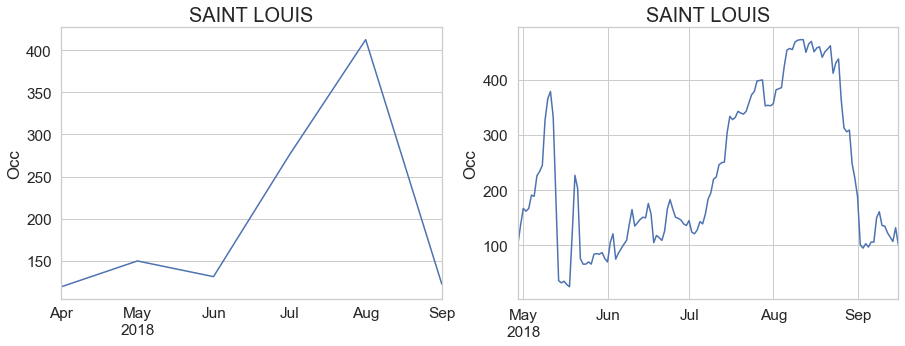

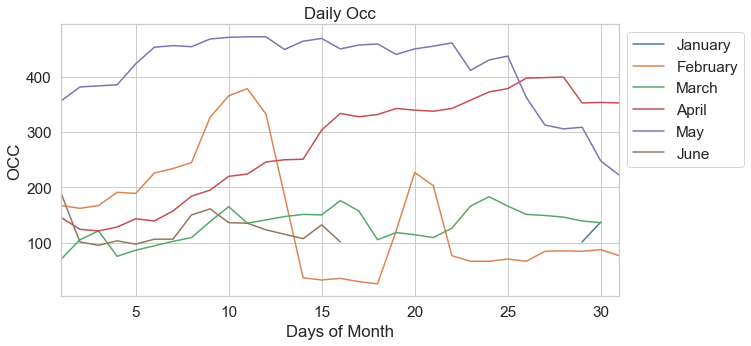

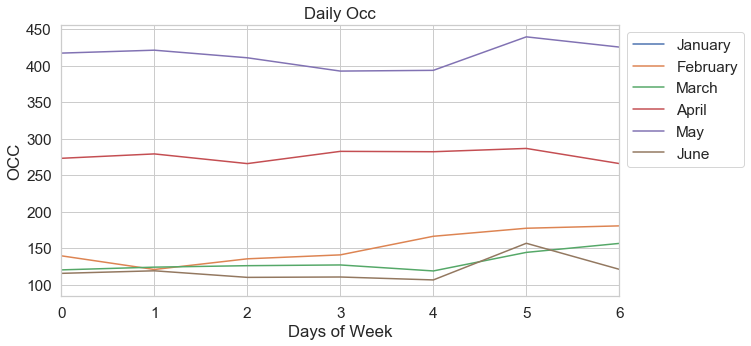



Test TS Analysis On 2019 SAINT LOUIS Occ.




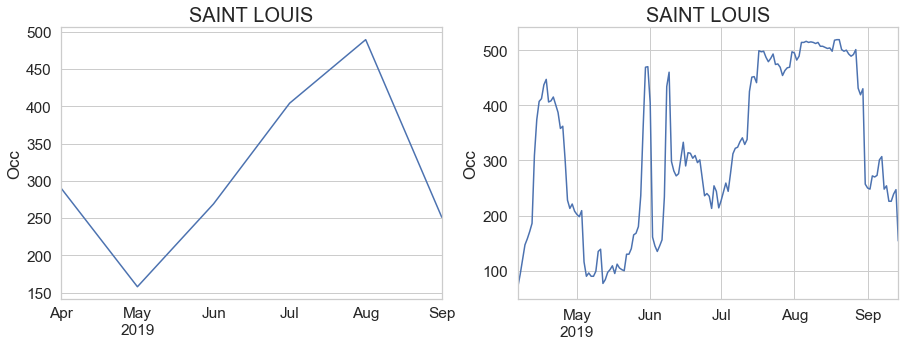

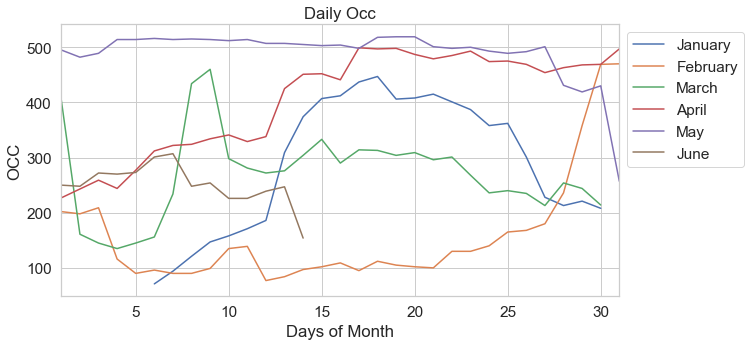

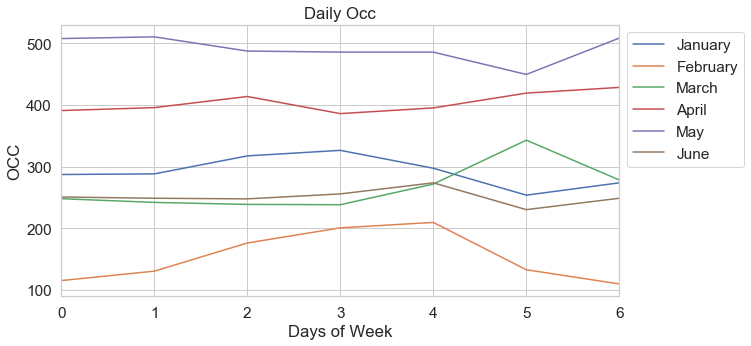

Dates range:
2018-04-29 00:00:00 - 2019-09-14 00:00:00

('X shape: ', (294, 9))
('y shape: ', (294,))
('X_train shape: ', (132, 9))
('X_test shape: ', (162, 9))
('y_train shape: ', (132,))
('y_test shape: ', (162,))
R2:	0.868
RMSE:	2668.72


Train TS Analysis On 2018 DOMAINE SAINTE CECILE Occ.




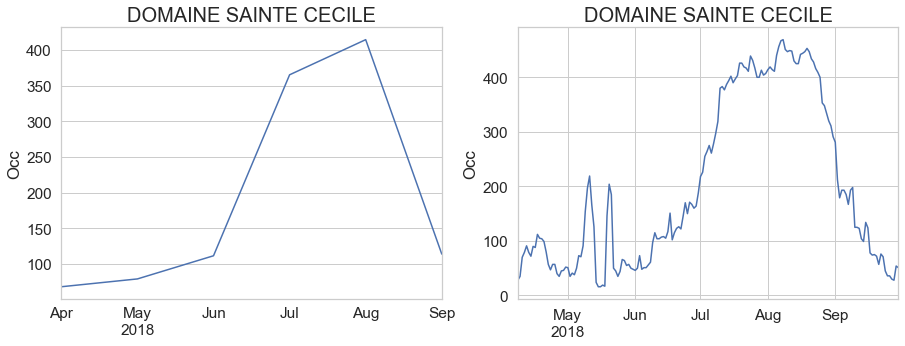

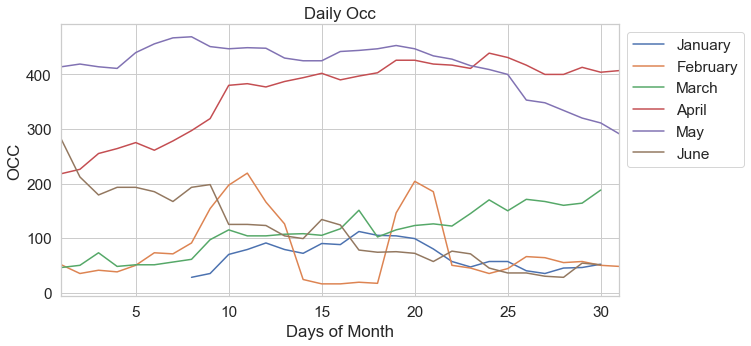

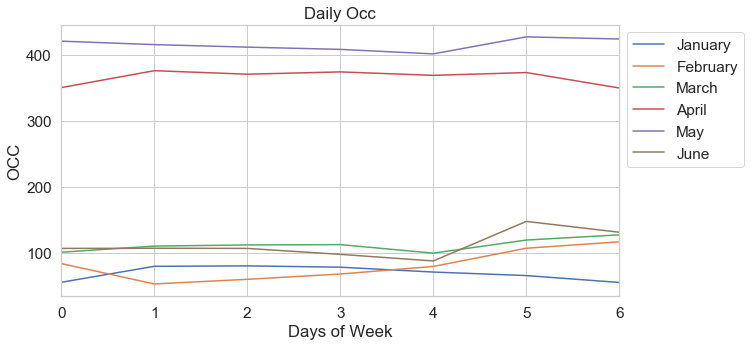



Test TS Analysis On 2019 DOMAINE SAINTE CECILE Occ.




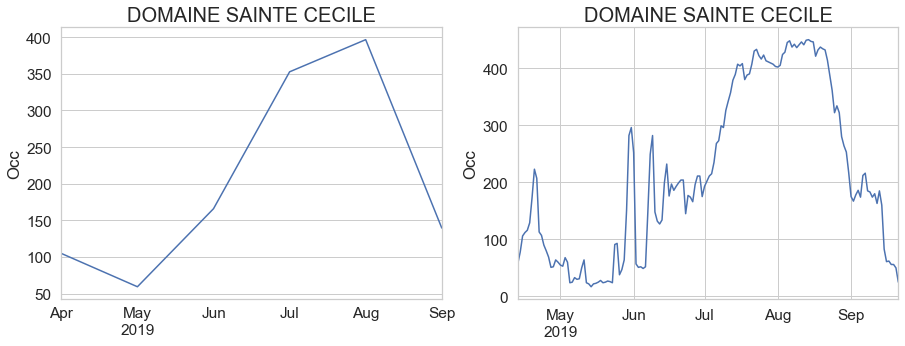

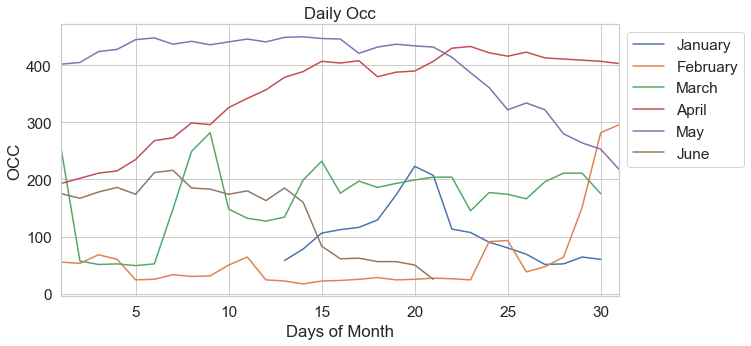

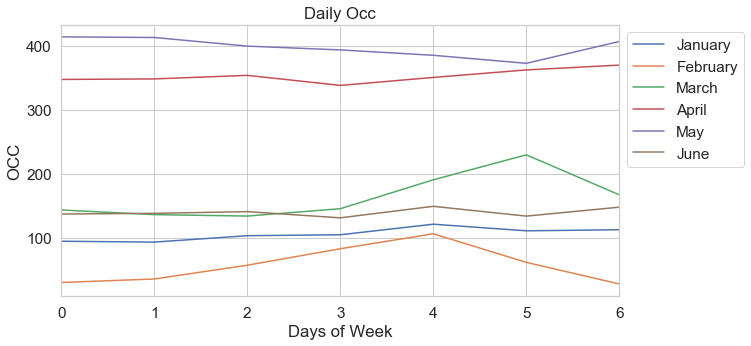

Dates range:
2018-04-08 00:00:00 - 2019-09-21 00:00:00

('X shape: ', (329, 9))
('y shape: ', (329,))
('X_train shape: ', (167, 9))
('X_test shape: ', (162, 9))
('y_train shape: ', (167,))
('y_test shape: ', (162,))
R2:	0.94
RMSE:	1276.05


Train TS Analysis On 2018 PUNTA MILA Occ.




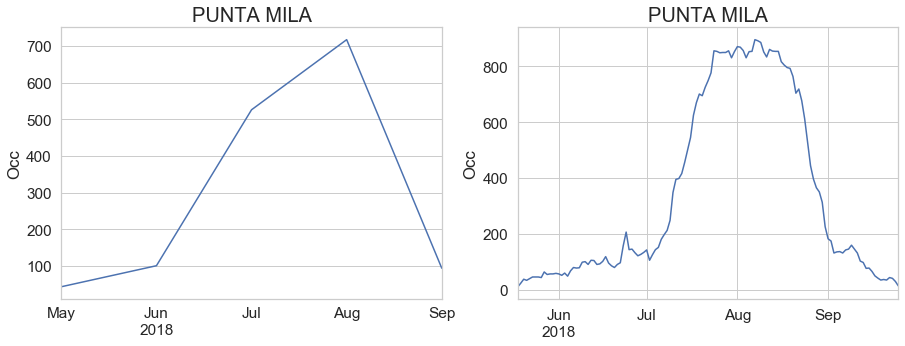

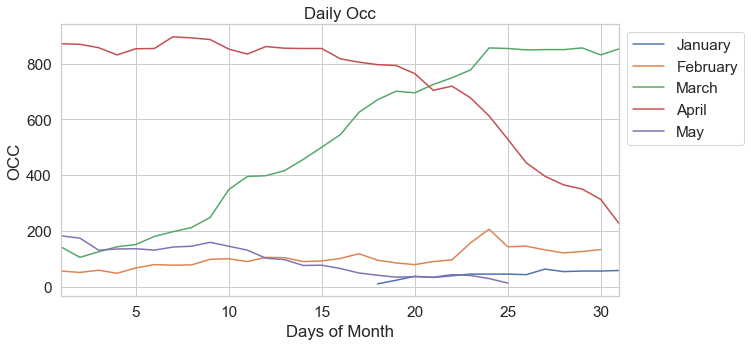

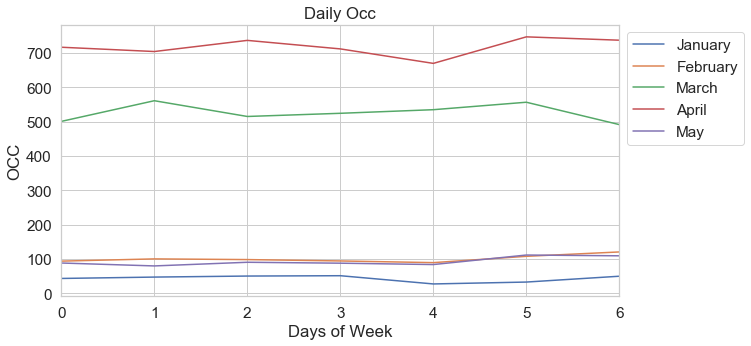



Test TS Analysis On 2019 PUNTA MILA Occ.




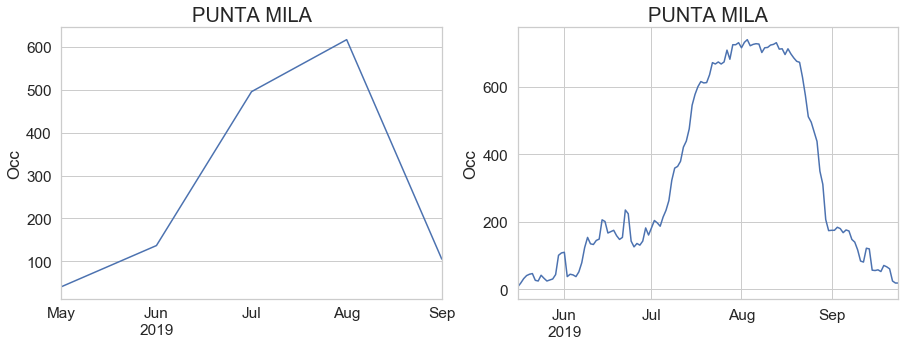

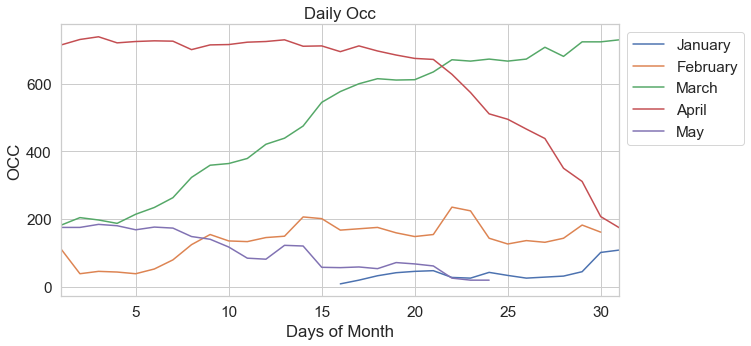

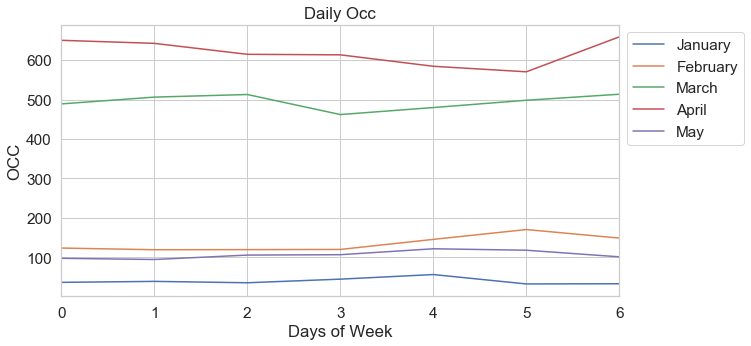

Dates range:
2018-05-18 00:00:00 - 2019-09-24 00:00:00

('X shape: ', (254, 9))
('y shape: ', (254,))
('X_train shape: ', (122, 9))
('X_test shape: ', (132, 9))
('y_train shape: ', (122,))
('y_test shape: ', (132,))
R2:	0.988
RMSE:	813.44


Train TS Analysis On 2018 EN CHAMPAGNE Occ.




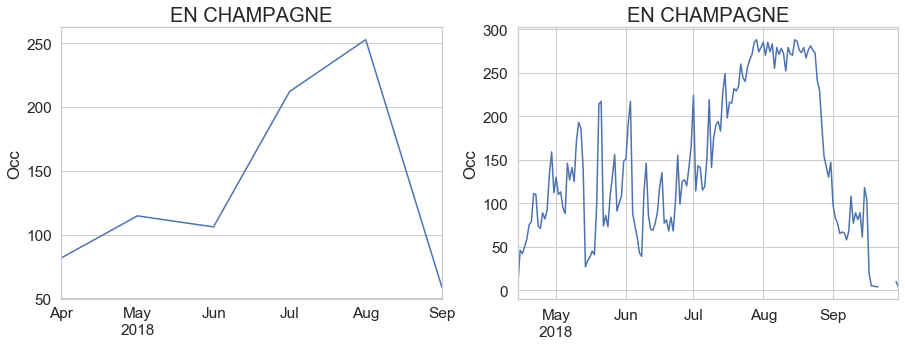

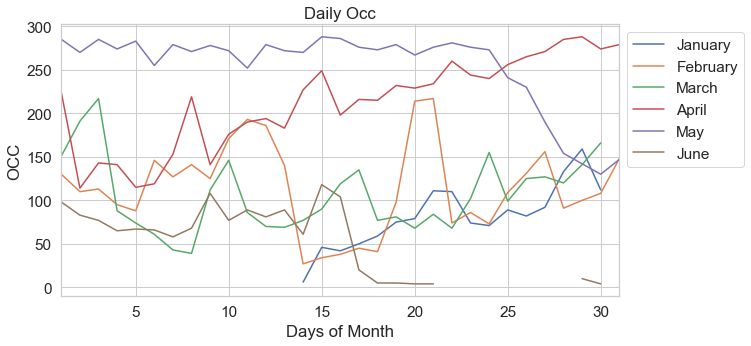

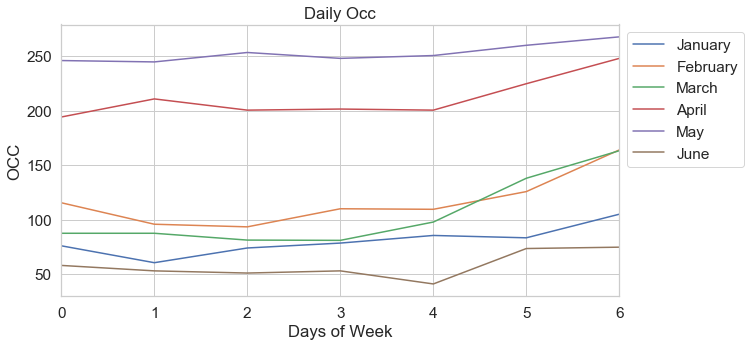



Test TS Analysis On 2019 EN CHAMPAGNE Occ.




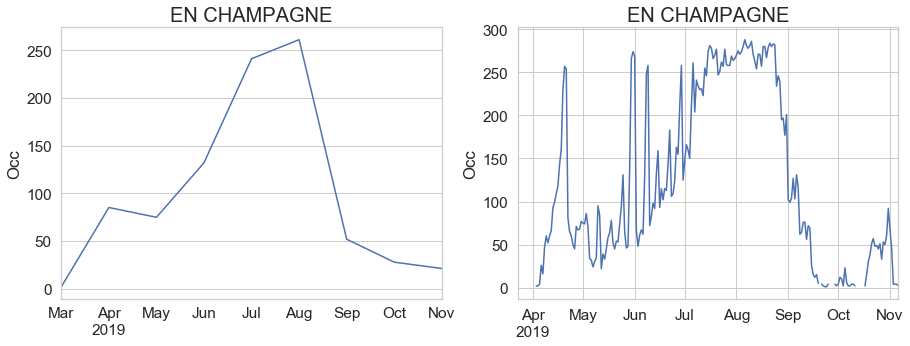

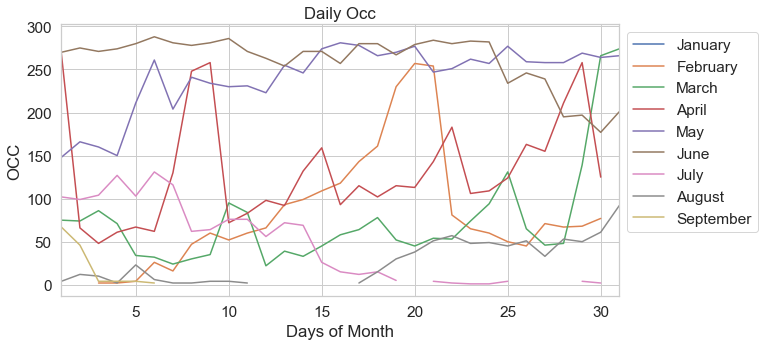

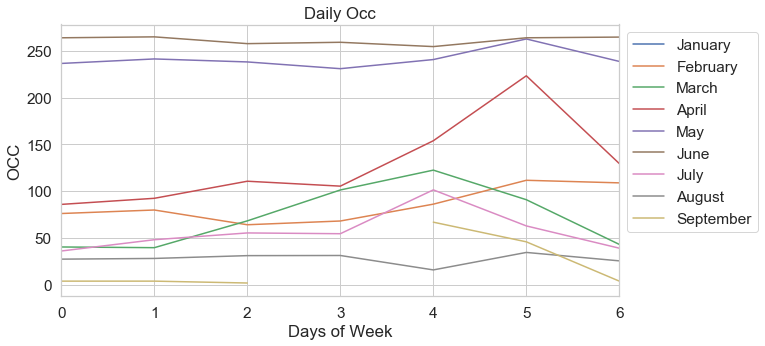

Dates range:
2018-04-14 00:00:00 - 2019-11-06 00:00:00

('X shape: ', (366, 9))
('y shape: ', (366,))
('X_train shape: ', (154, 9))
('X_test shape: ', (212, 9))
('y_train shape: ', (154,))
('y_test shape: ', (212,))
R2:	0.863
RMSE:	1355.92


Train TS Analysis On 2018 SANT POL Occ.




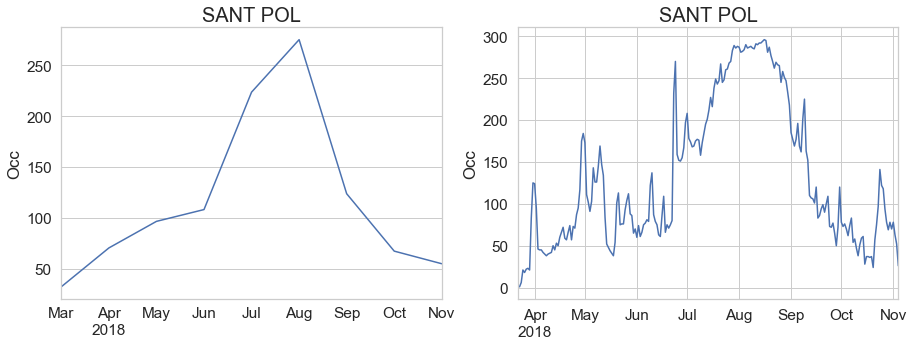

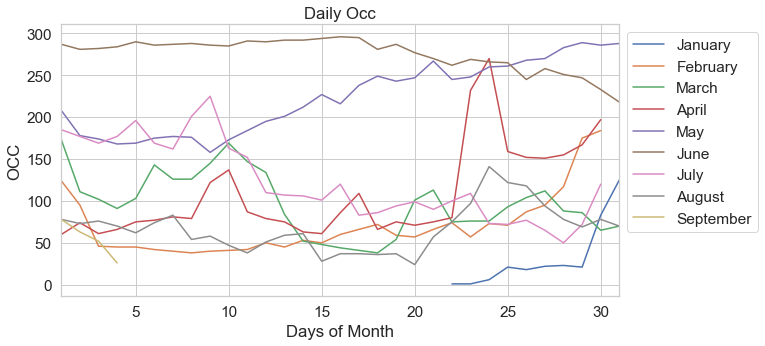

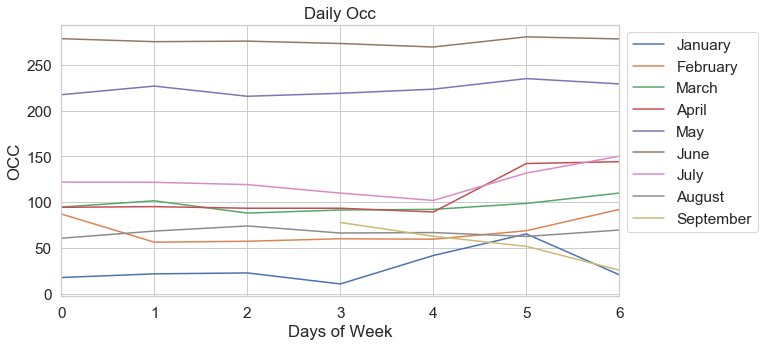



Test TS Analysis On 2019 SANT POL Occ.




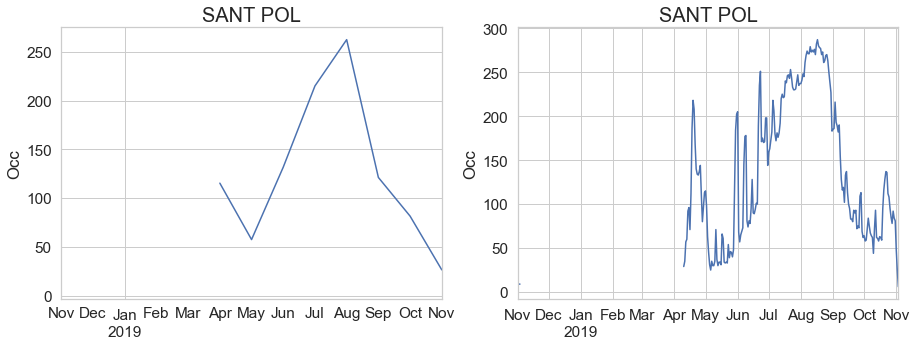

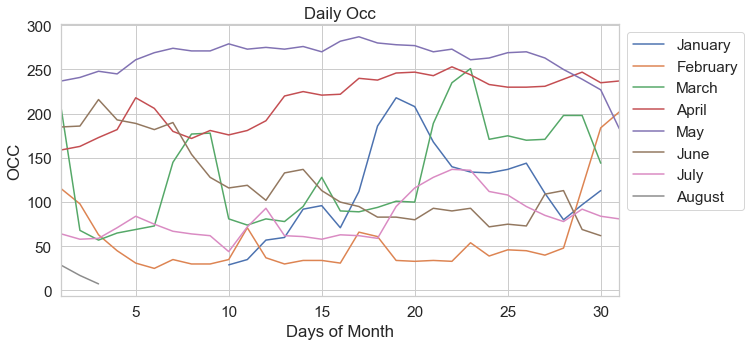

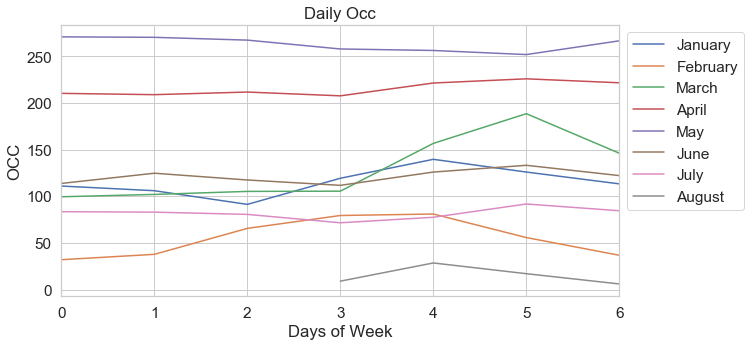

Dates range:
2018-03-22 00:00:00 - 2019-11-03 00:00:00

('X shape: ', (430, 9))
('y shape: ', (430,))
('X_train shape: ', (222, 9))
('X_test shape: ', (208, 9))
('y_train shape: ', (222,))
('y_test shape: ', (208,))
R2:	0.915
RMSE:	550.79


Train TS Analysis On 2018 LAC DES 3 VALLEES Occ.




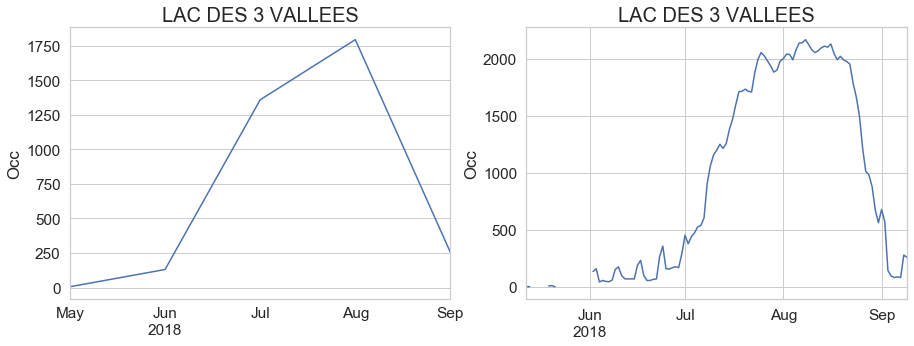

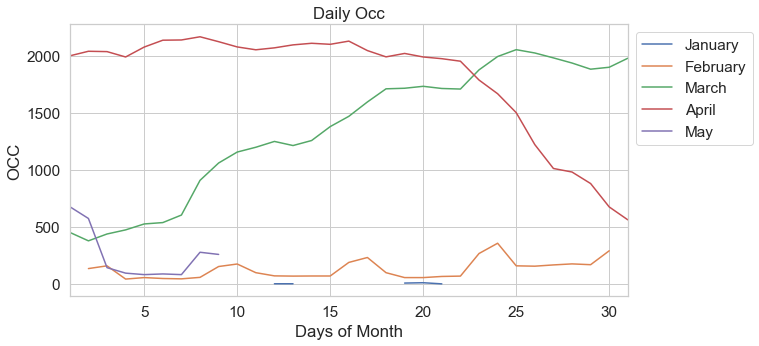

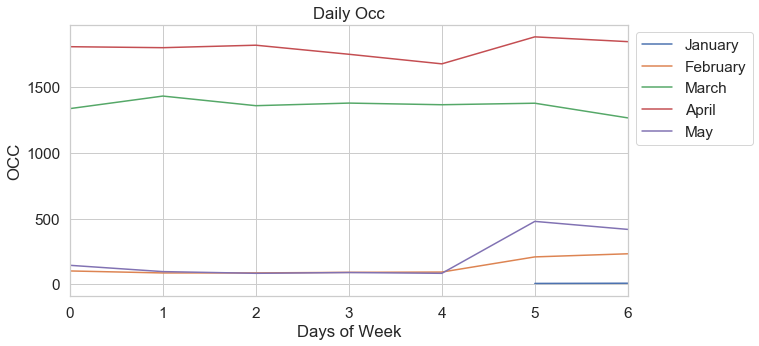



Test TS Analysis On 2019 LAC DES 3 VALLEES Occ.




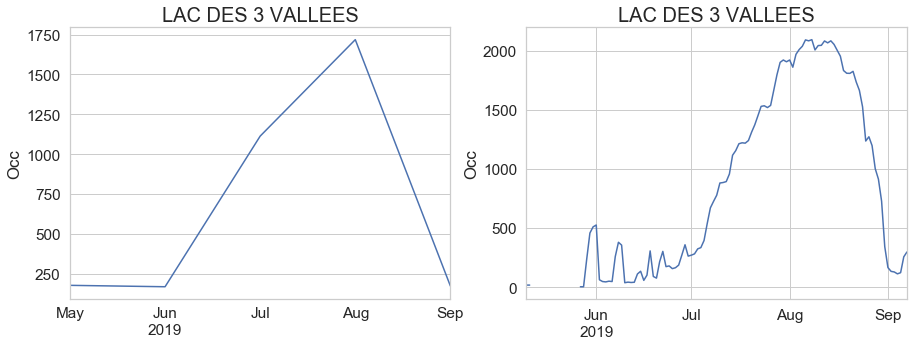

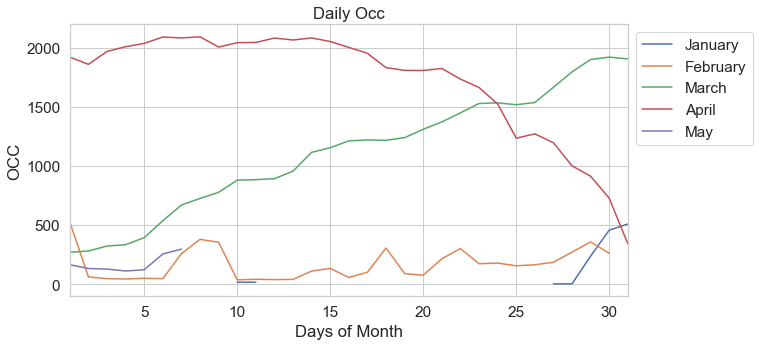

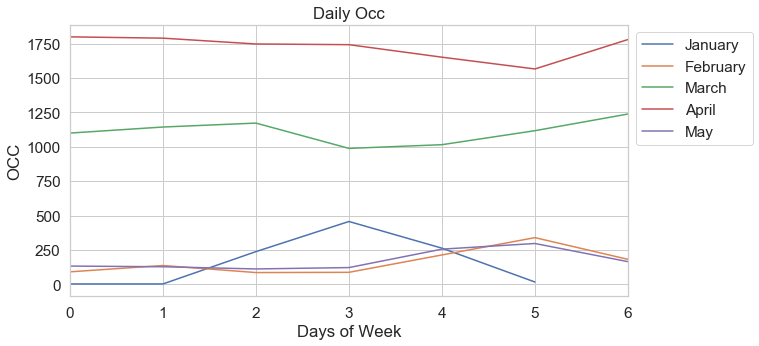

Dates range:
2018-05-12 00:00:00 - 2019-09-07 00:00:00

('X shape: ', (202, 9))
('y shape: ', (202,))
('X_train shape: ', (96, 9))
('X_test shape: ', (106, 9))
('y_train shape: ', (96,))
('y_test shape: ', (106,))
R2:	0.979
RMSE:	12122.62


Train TS Analysis On 2018 DOMAINE DU COLOMBIER Occ.




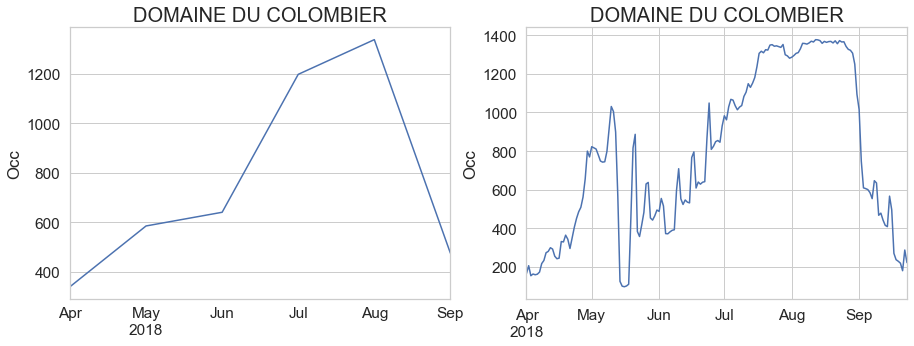

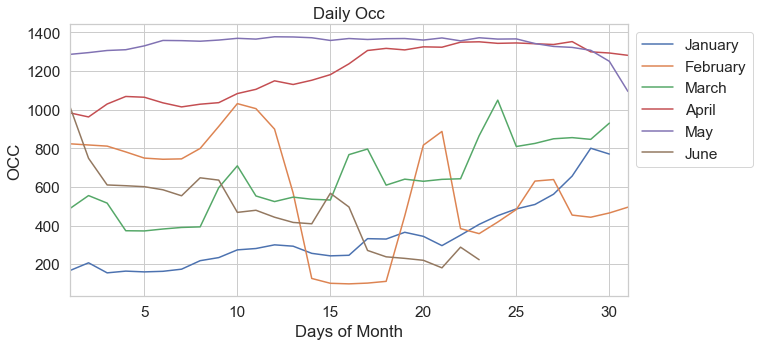

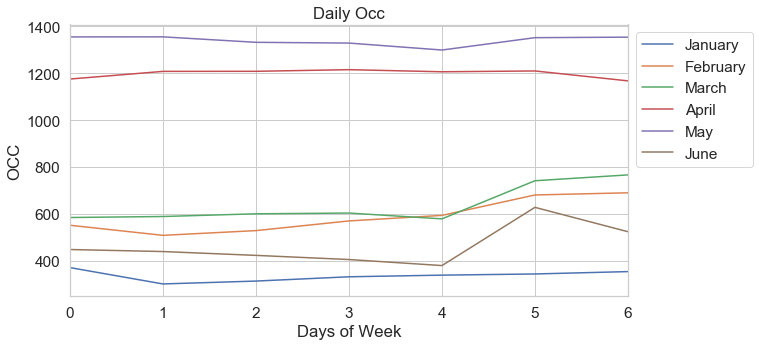



Test TS Analysis On 2019 DOMAINE DU COLOMBIER Occ.




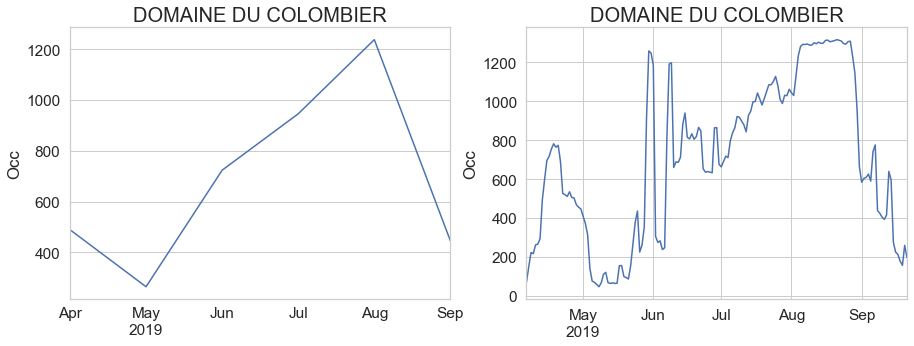

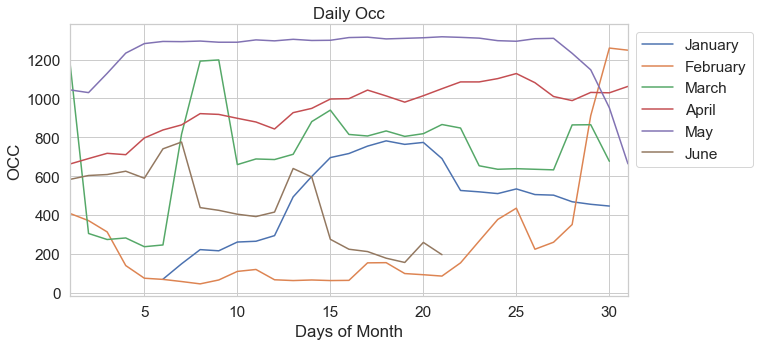

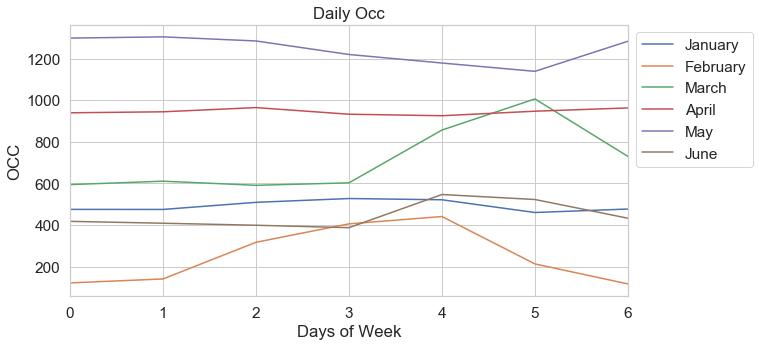

Dates range:
2018-04-01 00:00:00 - 2019-09-21 00:00:00

('X shape: ', (336, 9))
('y shape: ', (336,))
('X_train shape: ', (167, 9))
('X_test shape: ', (169, 9))
('y_train shape: ', (167,))
('y_test shape: ', (169,))
R2:	0.856
RMSE:	23035.1


Train TS Analysis On 2018 RANOLIEN Occ.




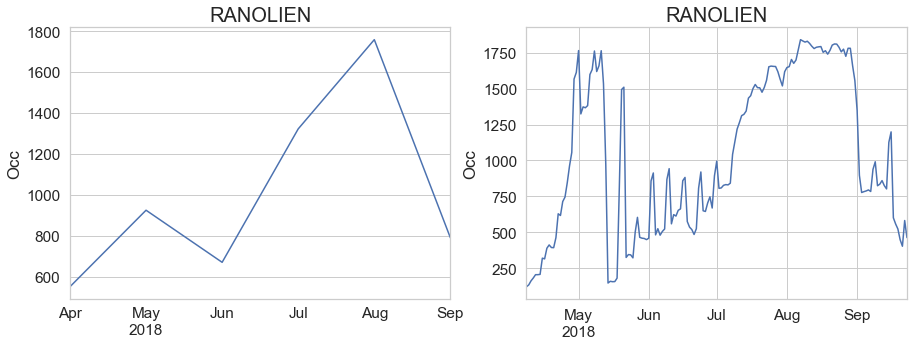

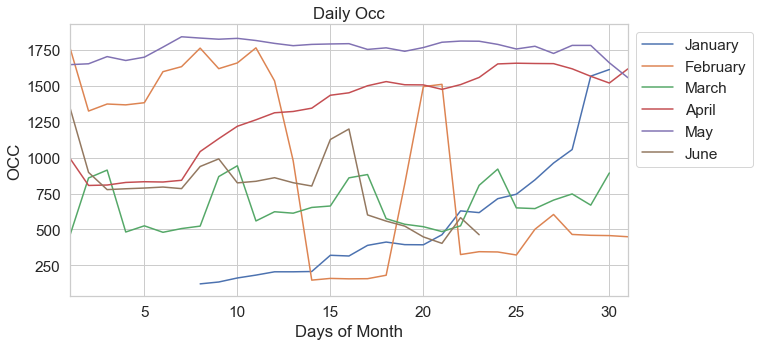

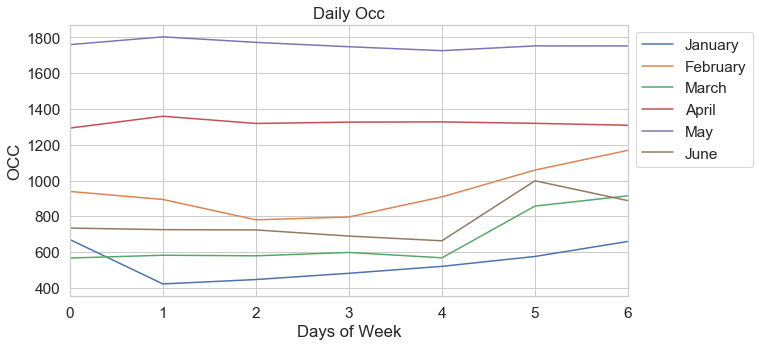



Test TS Analysis On 2019 RANOLIEN Occ.




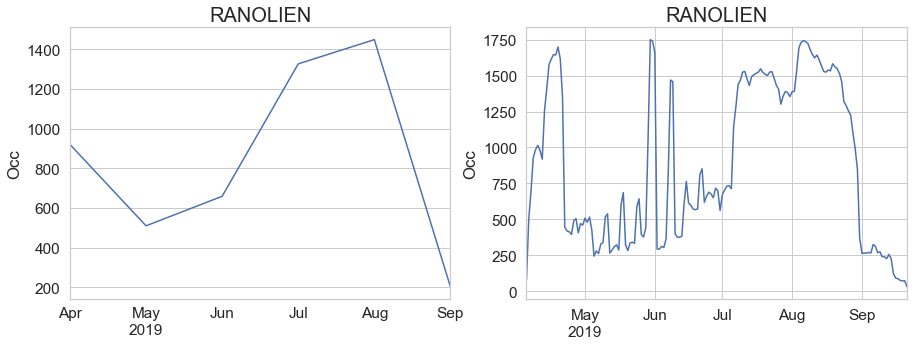

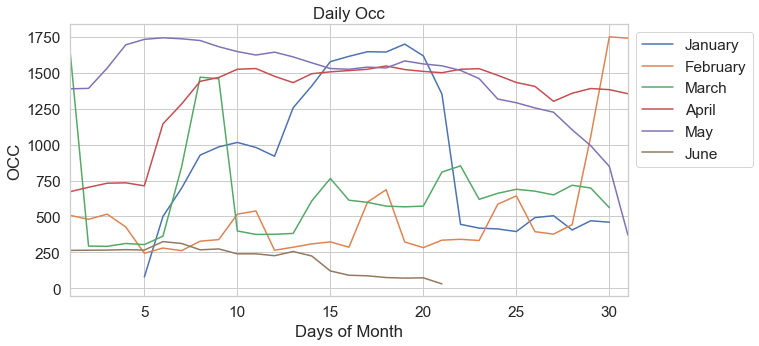

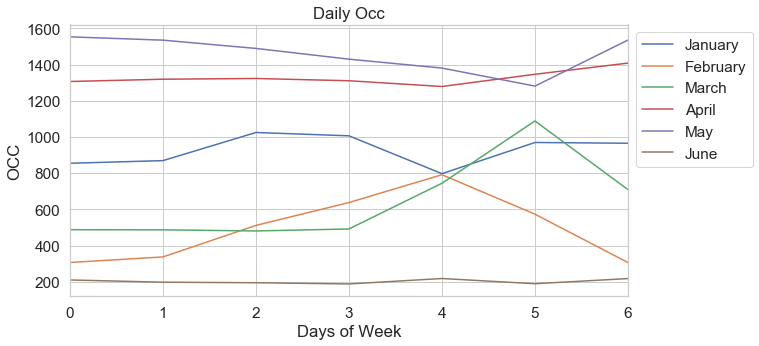

Dates range:
2018-04-08 00:00:00 - 2019-09-21 00:00:00

('X shape: ', (330, 9))
('y shape: ', (330,))
('X_train shape: ', (160, 9))
('X_test shape: ', (170, 9))
('y_train shape: ', (160,))
('y_test shape: ', (170,))
R2:	0.827
RMSE:	51768.59


Train TS Analysis On 2018 MIMOSAS Occ.




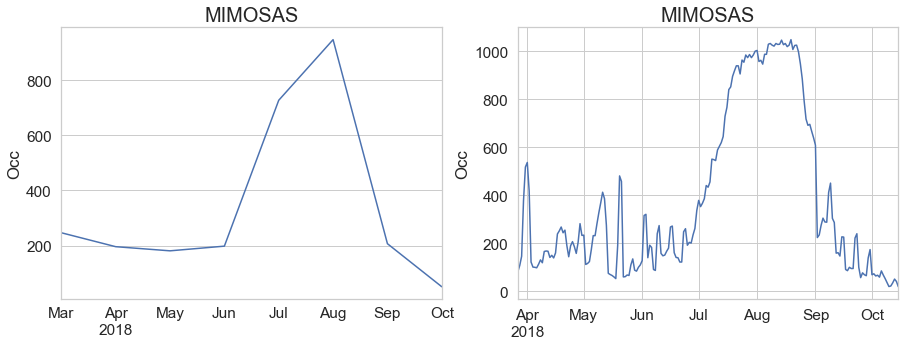

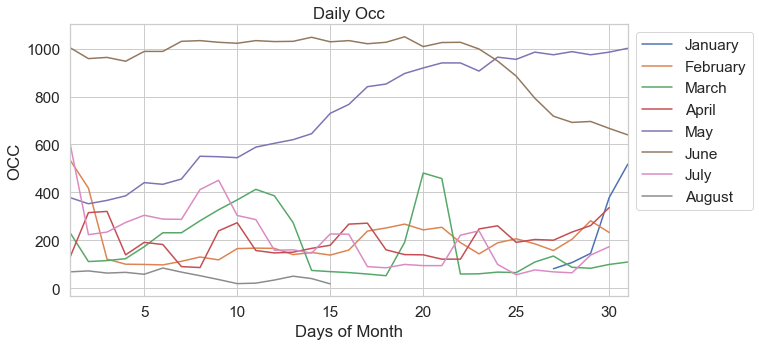

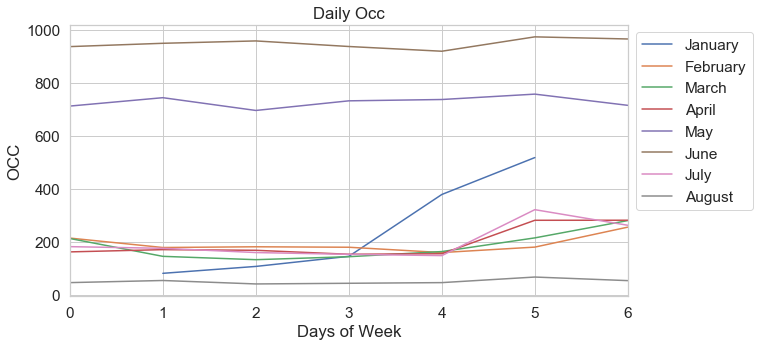



Test TS Analysis On 2019 MIMOSAS Occ.




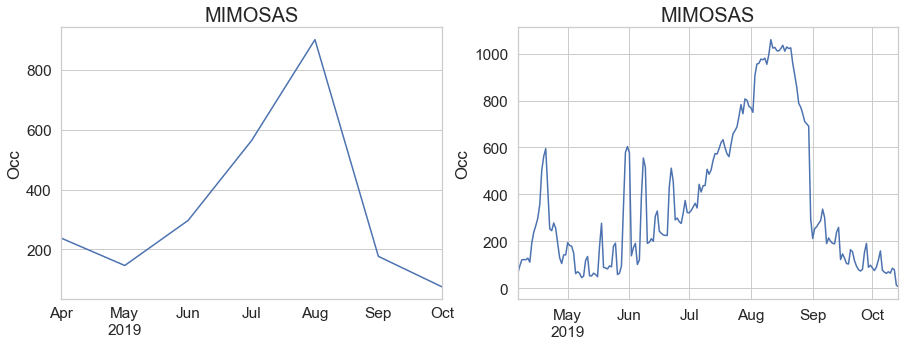

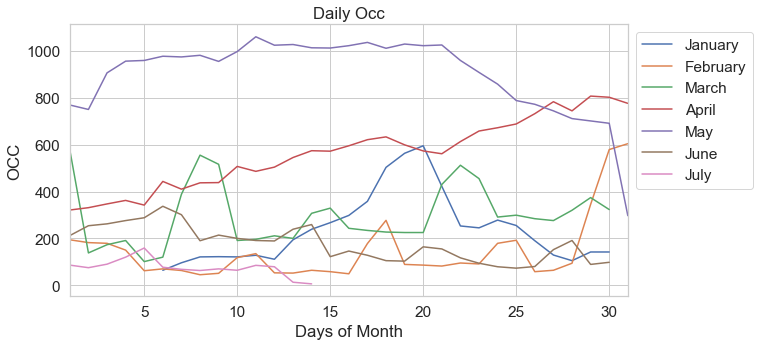

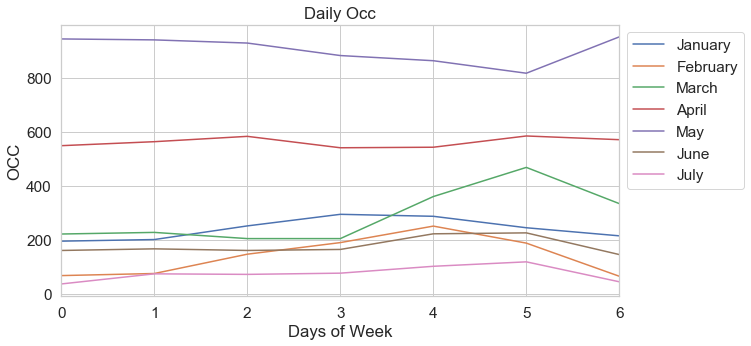

Dates range:
2018-03-27 00:00:00 - 2019-10-14 00:00:00

('X shape: ', (386, 9))
('y shape: ', (386,))
('X_train shape: ', (194, 9))
('X_test shape: ', (192, 9))
('y_train shape: ', (194,))
('y_test shape: ', (192,))
R2:	0.939
RMSE:	5630.09


Train TS Analysis On 2018 SAINT-EMILION Occ.




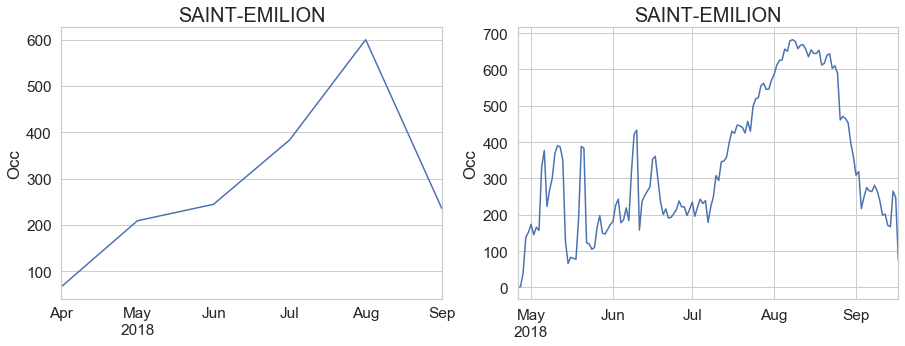

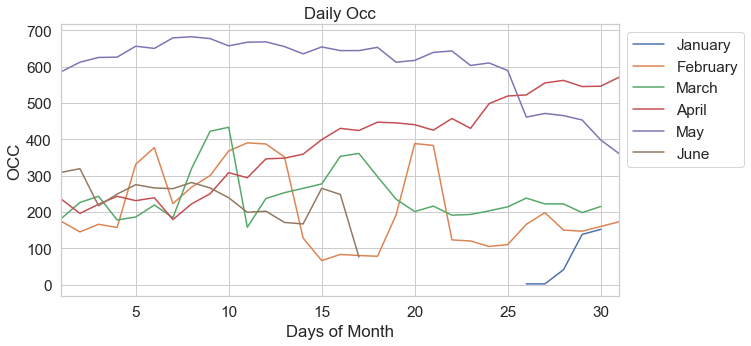

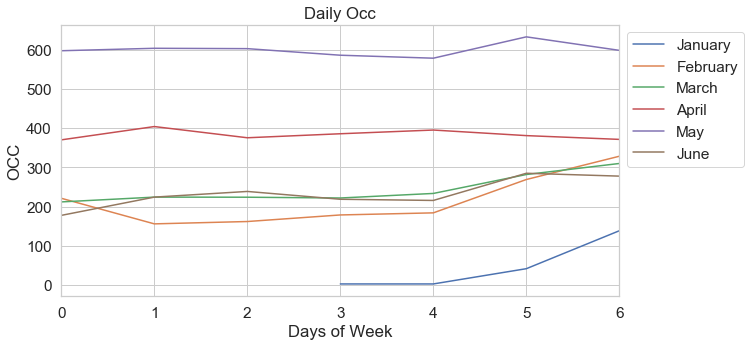



Test TS Analysis On 2019 SAINT-EMILION Occ.




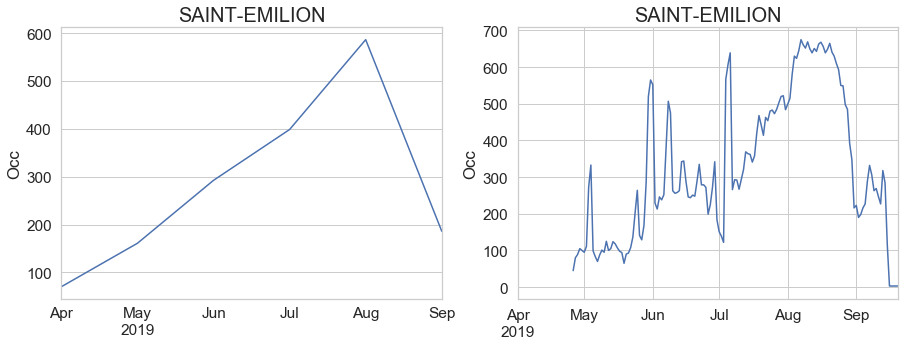

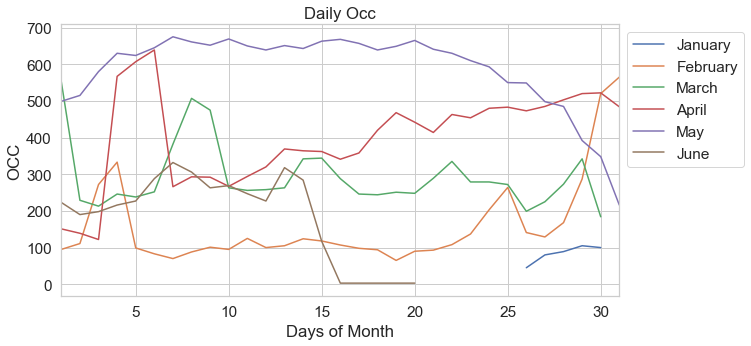

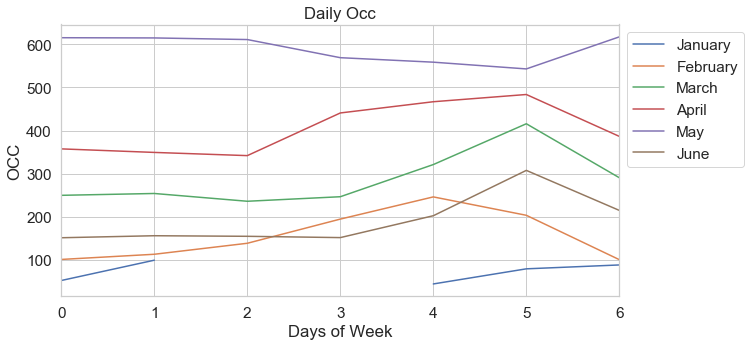

Dates range:
2018-04-26 00:00:00 - 2019-09-20 00:00:00

('X shape: ', (285, 9))
('y shape: ', (285,))
('X_train shape: ', (136, 9))
('X_test shape: ', (149, 9))
('y_train shape: ', (136,))
('y_test shape: ', (149,))
R2:	0.805
RMSE:	7493.21


Train TS Analysis On 2018 PANORAMA DU PYLA Occ.




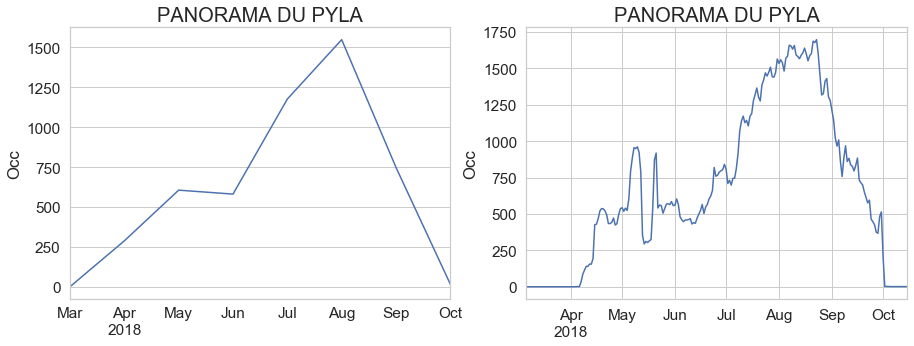

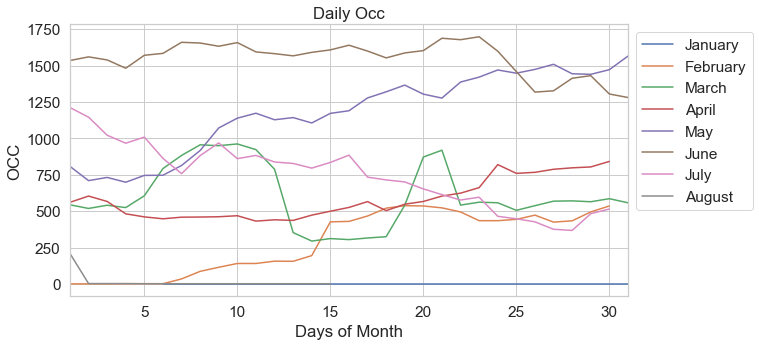

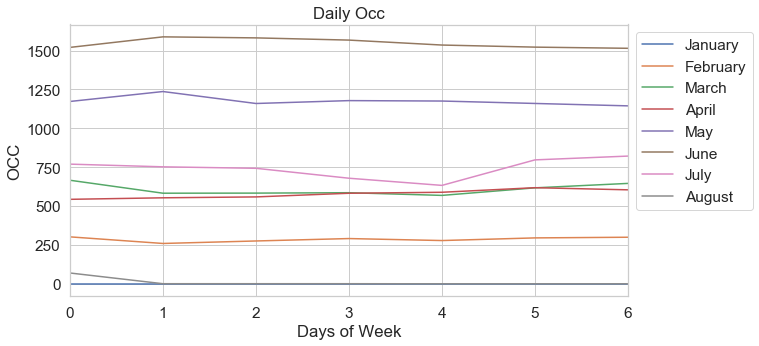



Test TS Analysis On 2019 PANORAMA DU PYLA Occ.




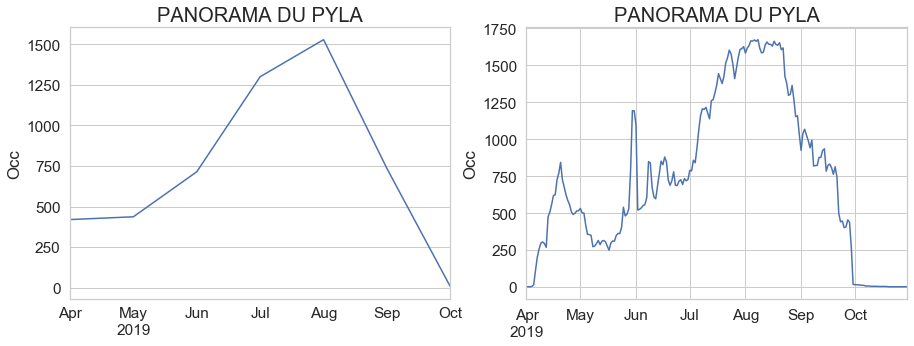

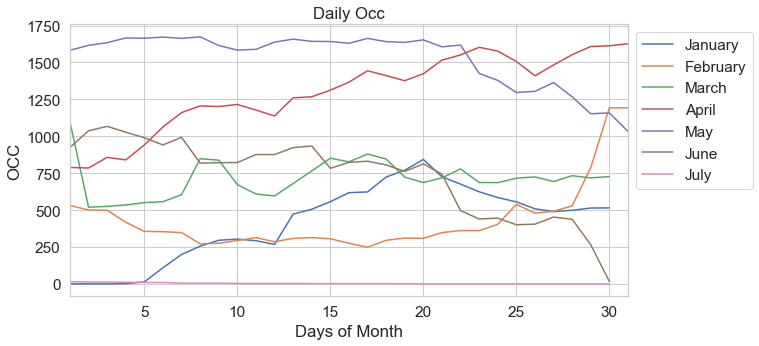

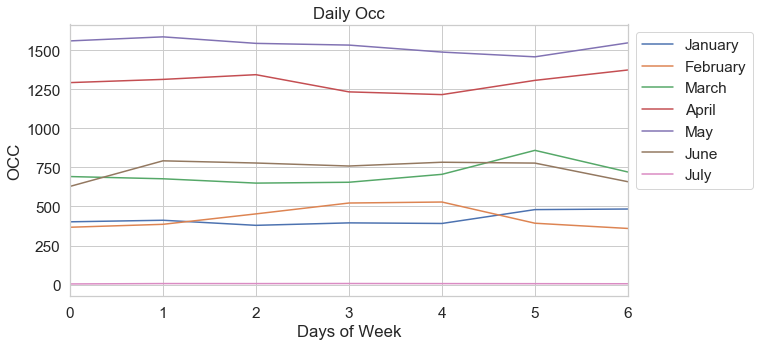

Dates range:
2018-03-06 00:00:00 - 2019-10-30 00:00:00

('X shape: ', (428, 9))
('y shape: ', (428,))
('X_train shape: ', (215, 9))
('X_test shape: ', (213, 9))
('y_train shape: ', (215,))
('y_test shape: ', (213,))
R2:	0.974
RMSE:	7277.15


Train TS Analysis On 2018 MAGUIDE Occ.




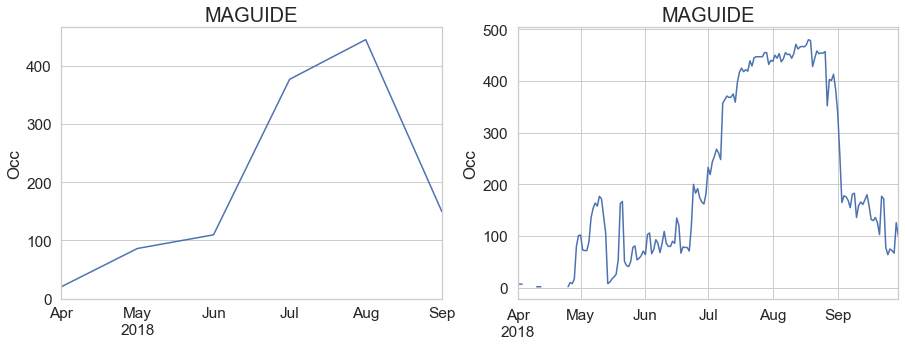

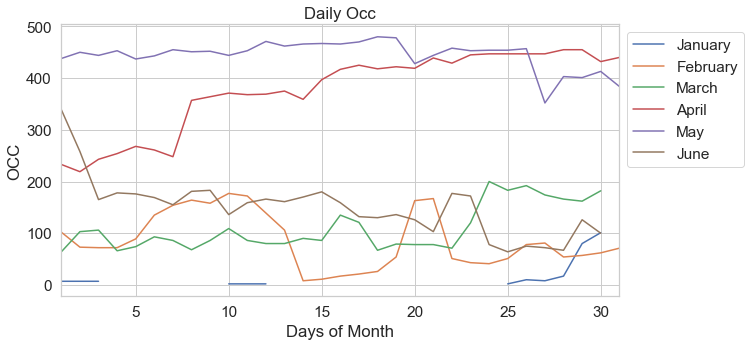

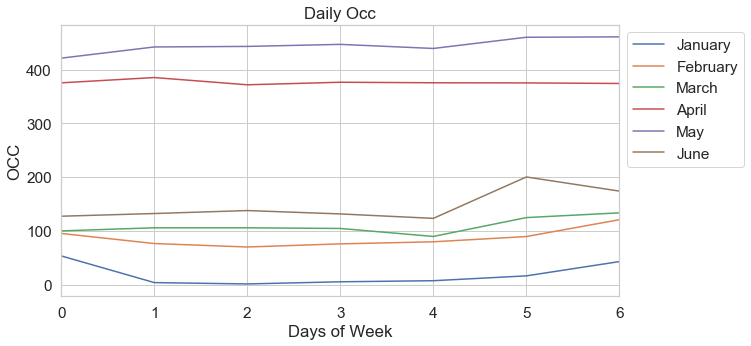



Test TS Analysis On 2019 MAGUIDE Occ.




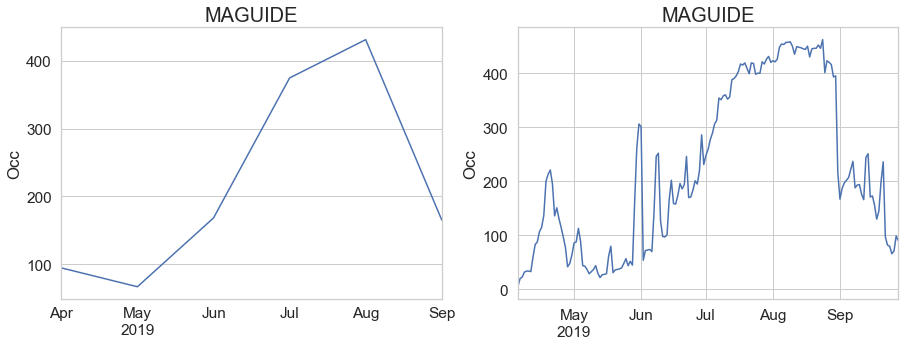

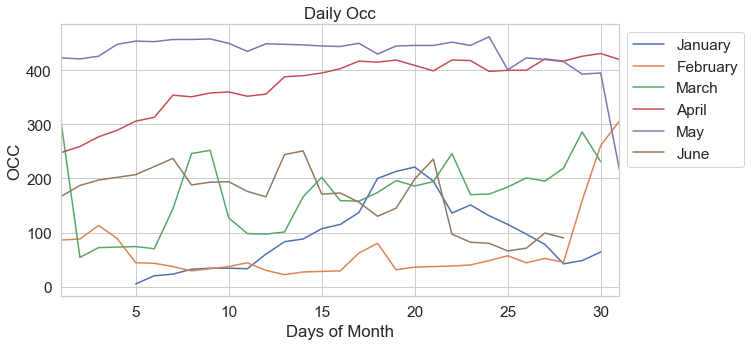

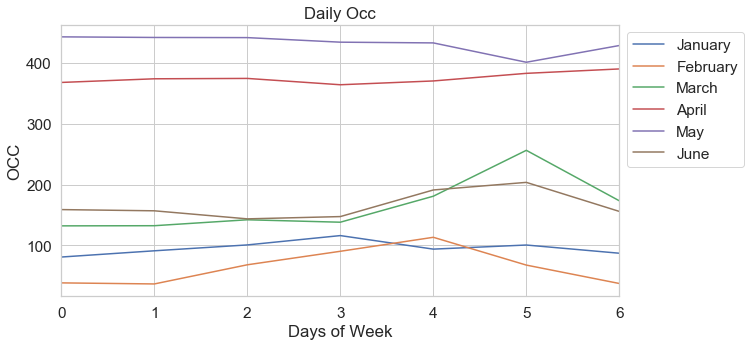

Dates range:
2018-04-01 00:00:00 - 2019-09-28 00:00:00

('X shape: ', (333, 9))
('y shape: ', (333,))
('X_train shape: ', (156, 9))
('X_test shape: ', (177, 9))
('y_train shape: ', (156,))
('y_test shape: ', (177,))
R2:	0.923
RMSE:	1739.06


Train TS Analysis On 2018 LASCAUX VACANCES Occ.




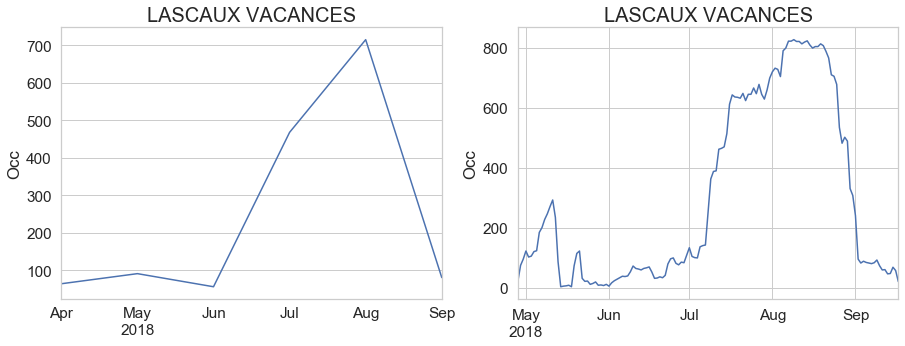

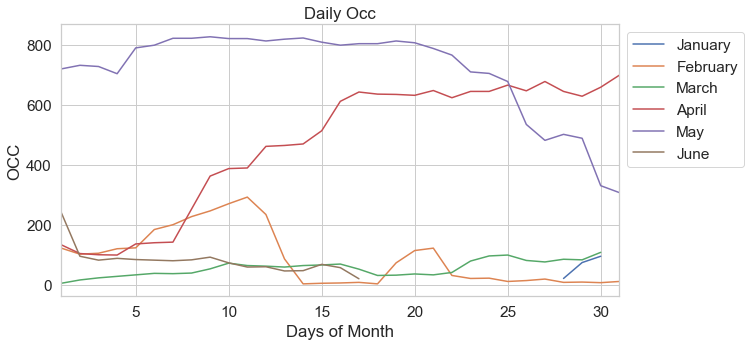

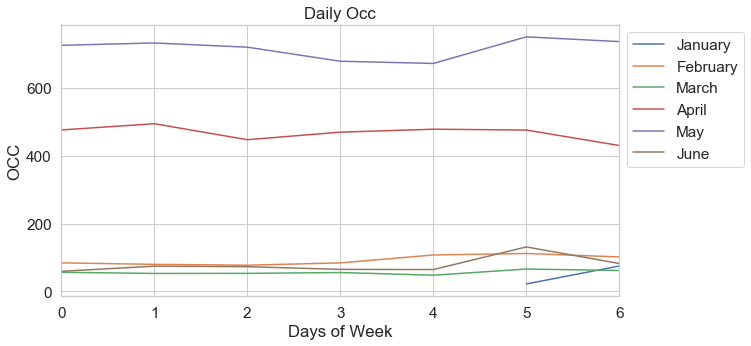



Test TS Analysis On 2019 LASCAUX VACANCES Occ.




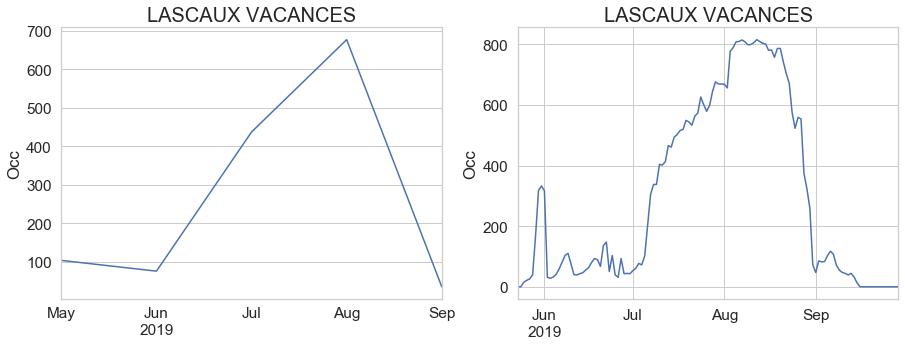

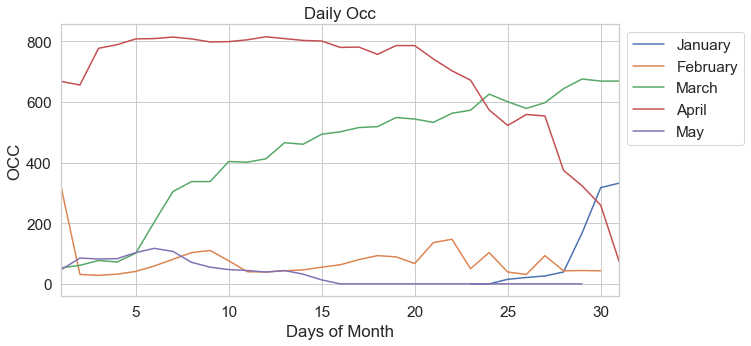

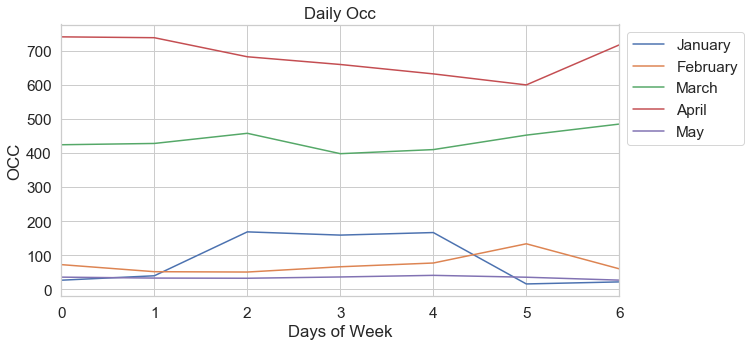

Dates range:
2018-04-28 00:00:00 - 2019-09-29 00:00:00

('X shape: ', (264, 9))
('y shape: ', (264,))
('X_train shape: ', (134, 9))
('X_test shape: ', (130, 9))
('y_train shape: ', (134,))
('y_test shape: ', (130,))
R2:	0.974
RMSE:	2276.97


Train TS Analysis On 2018 PARC DE LA COTE SAUVAGE Occ.




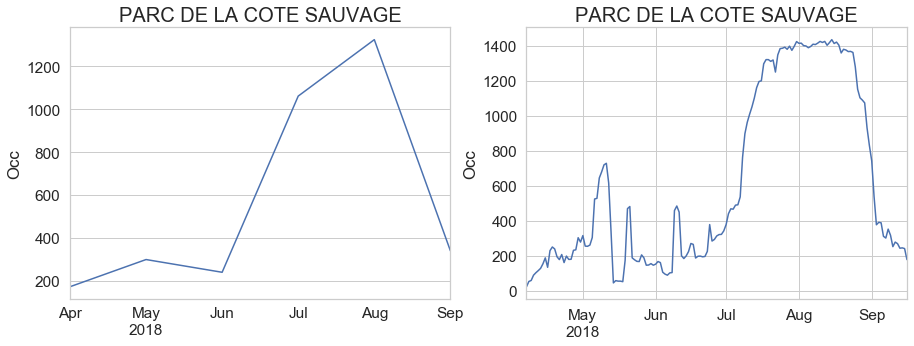

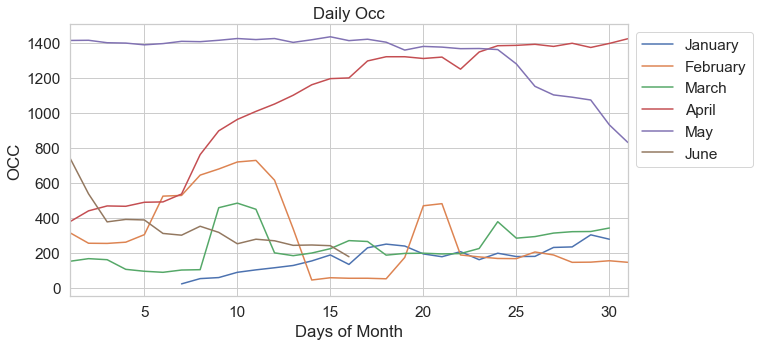

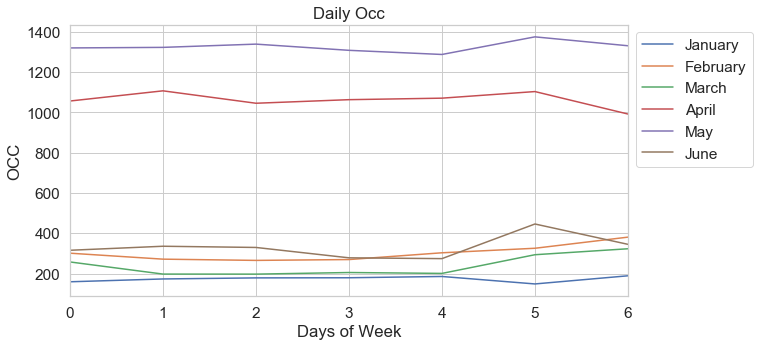



Test TS Analysis On 2019 PARC DE LA COTE SAUVAGE Occ.




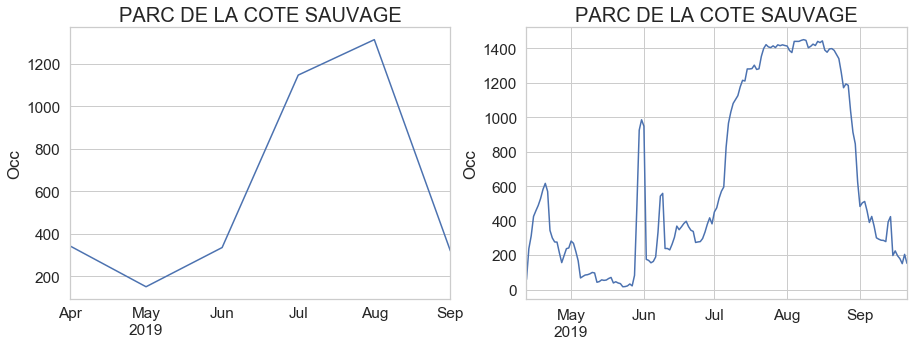

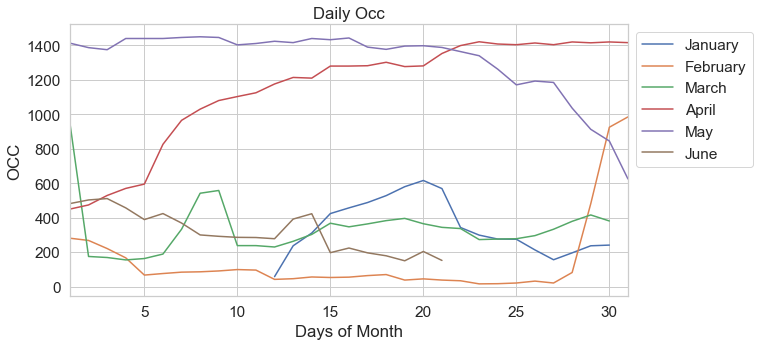

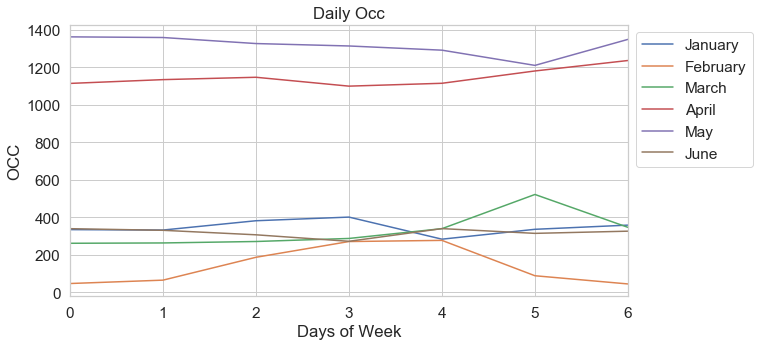

Dates range:
2018-04-07 00:00:00 - 2019-09-21 00:00:00

('X shape: ', (317, 9))
('y shape: ', (317,))
('X_train shape: ', (154, 9))
('X_test shape: ', (163, 9))
('y_train shape: ', (154,))
('y_test shape: ', (163,))
R2:	0.948
RMSE:	13725.87


Train TS Analysis On 2018 BRASILIA Occ.




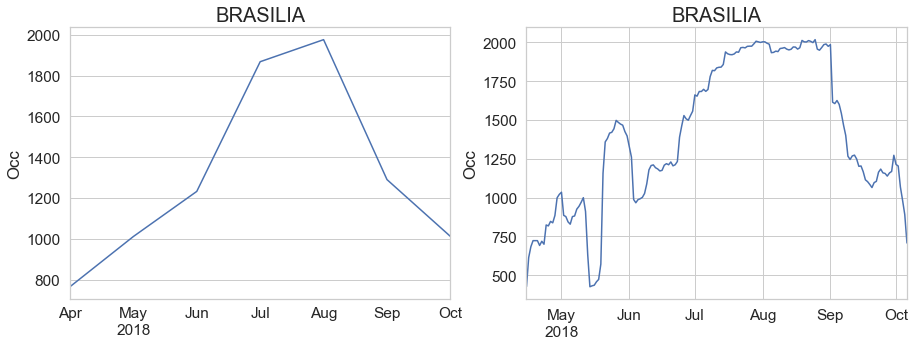

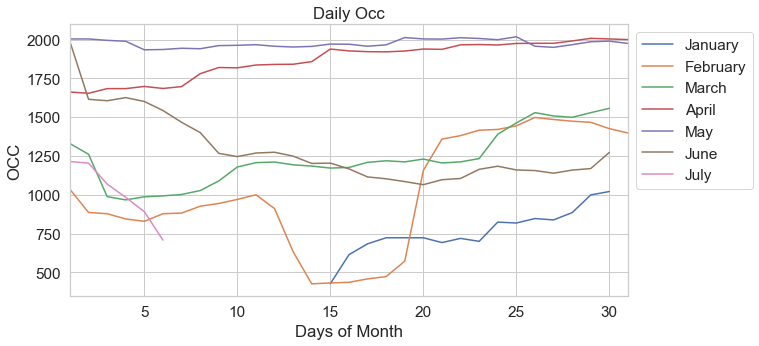

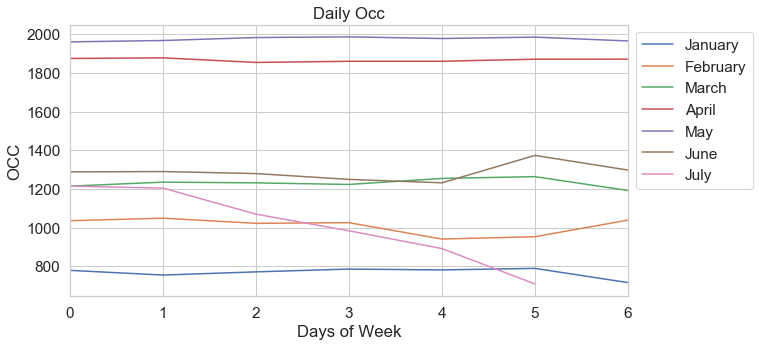



Test TS Analysis On 2019 BRASILIA Occ.




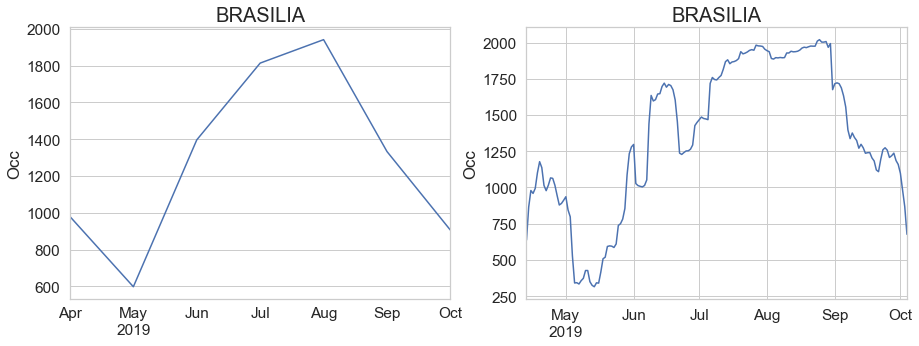

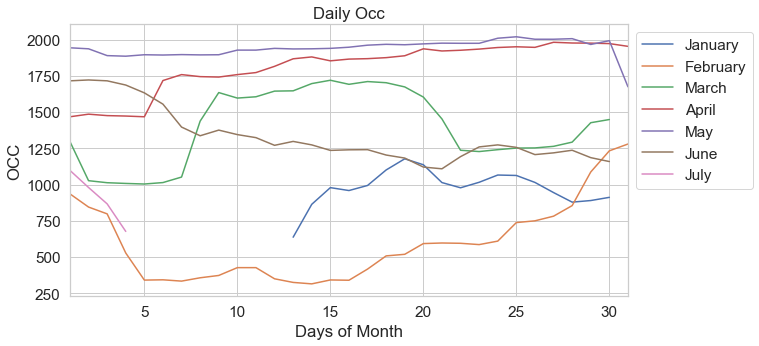

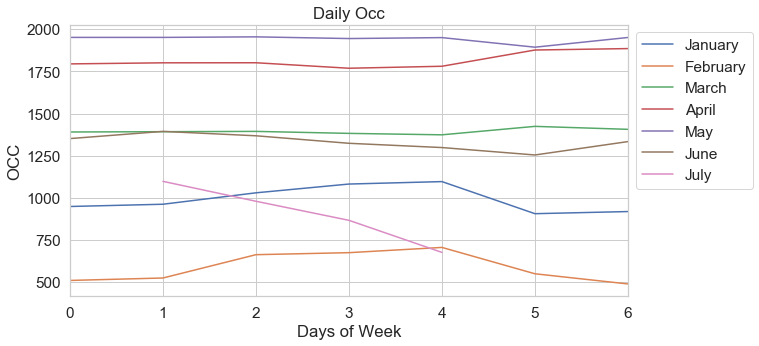

Dates range:
2018-04-15 00:00:00 - 2019-10-04 00:00:00

('X shape: ', (341, 9))
('y shape: ', (341,))
('X_train shape: ', (166, 9))
('X_test shape: ', (175, 9))
('y_train shape: ', (166,))
('y_test shape: ', (175,))
R2:	0.956
RMSE:	11207.78


Train TS Analysis On 2018 DOMAINE DE LOUVAREL Occ.




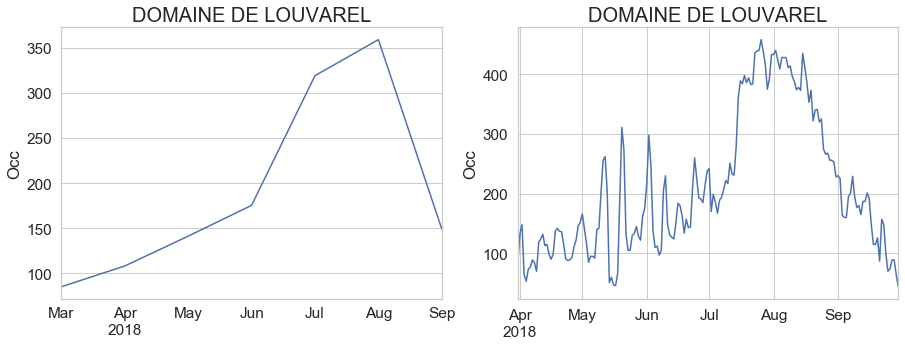

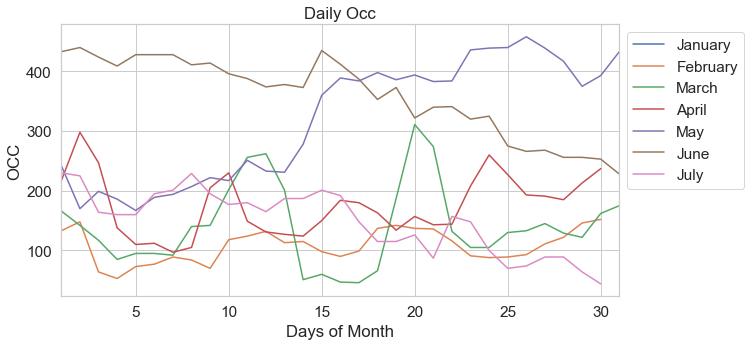

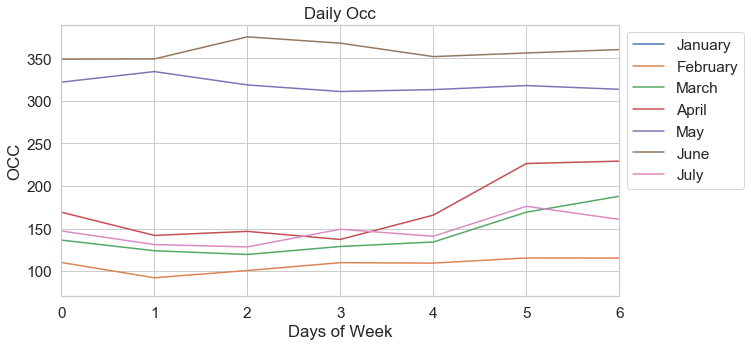



Test TS Analysis On 2019 DOMAINE DE LOUVAREL Occ.




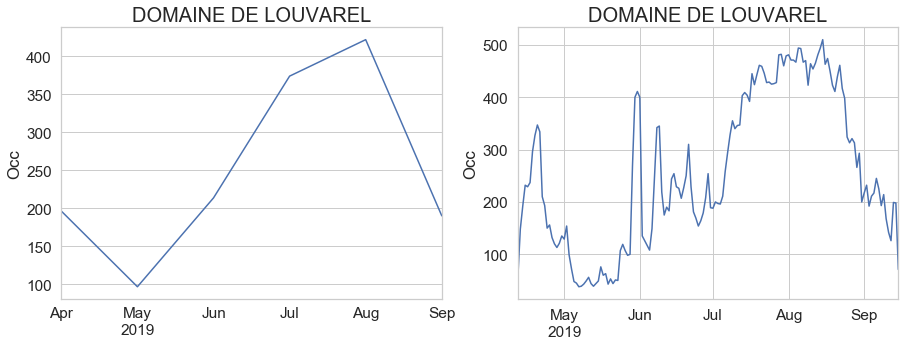

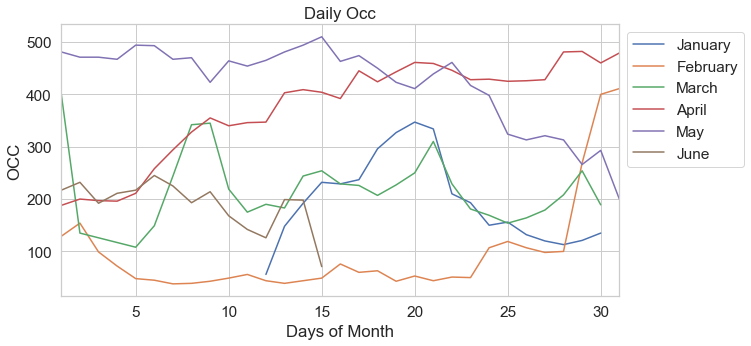

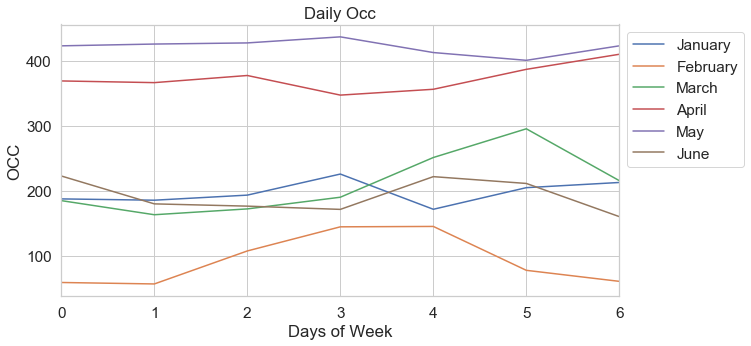

Dates range:
2018-03-31 00:00:00 - 2019-09-15 00:00:00

('X shape: ', (332, 9))
('y shape: ', (332,))
('X_train shape: ', (175, 9))
('X_test shape: ', (157, 9))
('y_train shape: ', (175,))
('y_test shape: ', (157,))
R2:	0.882
RMSE:	2460.41


Train TS Analysis On 2018 PRÉ LOMBARD Occ.




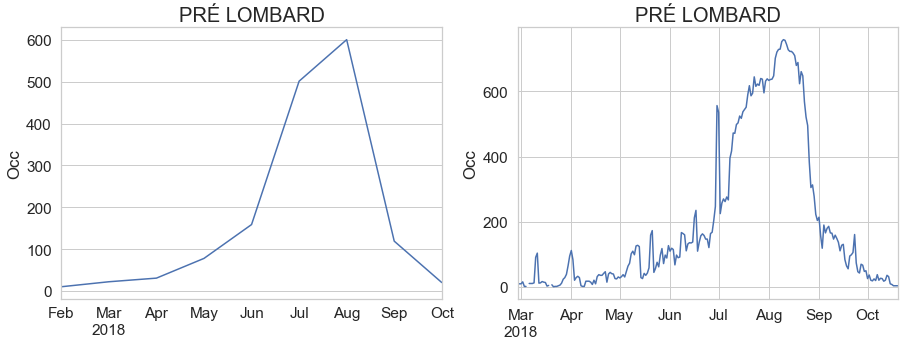

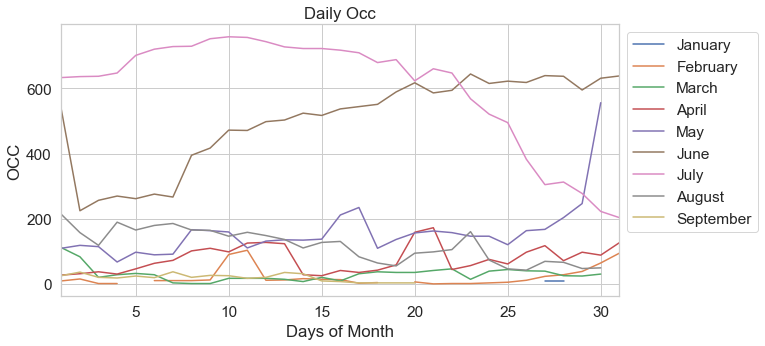

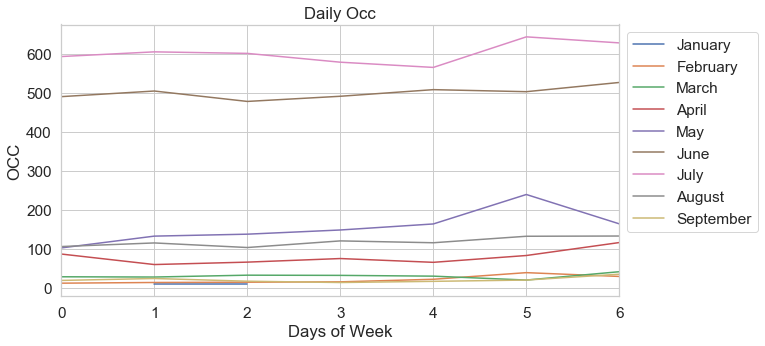



Test TS Analysis On 2019 PRÉ LOMBARD Occ.




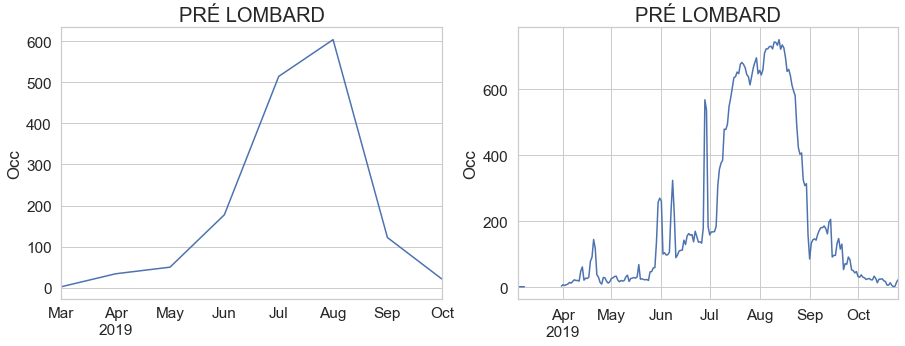

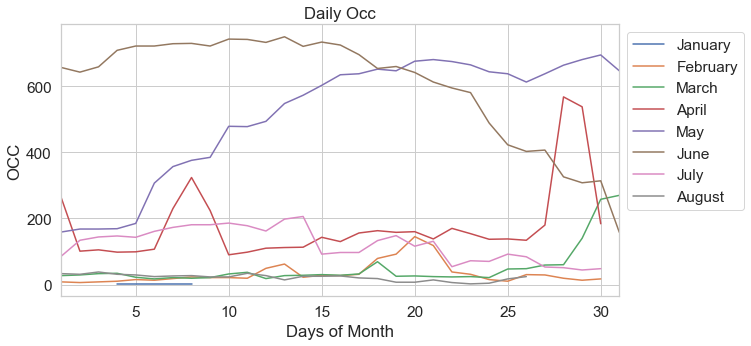

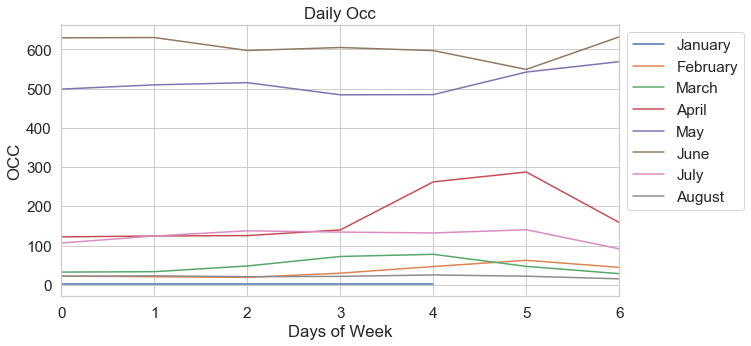

Dates range:
2018-02-27 00:00:00 - 2019-10-26 00:00:00

('X shape: ', (440, 9))
('y shape: ', (440,))
('X_train shape: ', (225, 9))
('X_test shape: ', (215, 9))
('y_train shape: ', (225,))
('y_test shape: ', (215,))
R2:	0.956
RMSE:	2742.4


Train TS Analysis On 2018 LES ILES Occ.




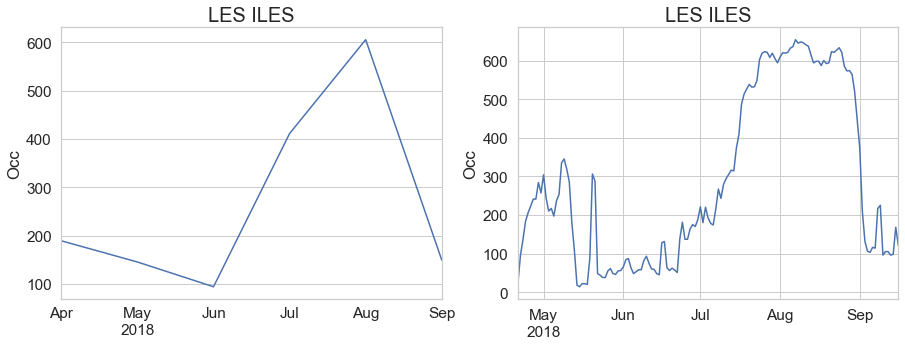

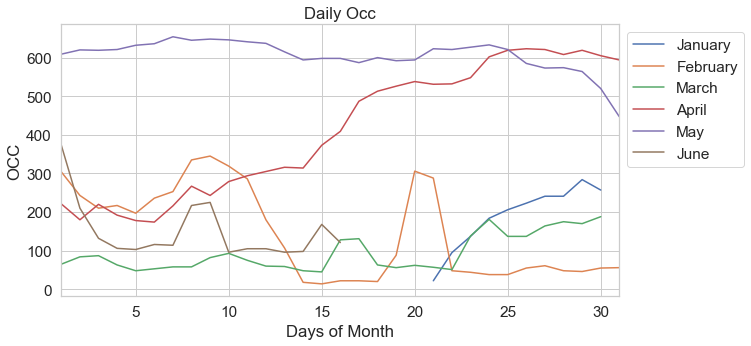

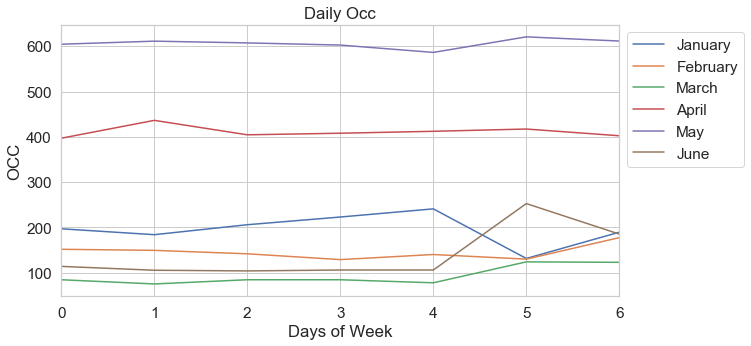



Test TS Analysis On 2019 LES ILES Occ.




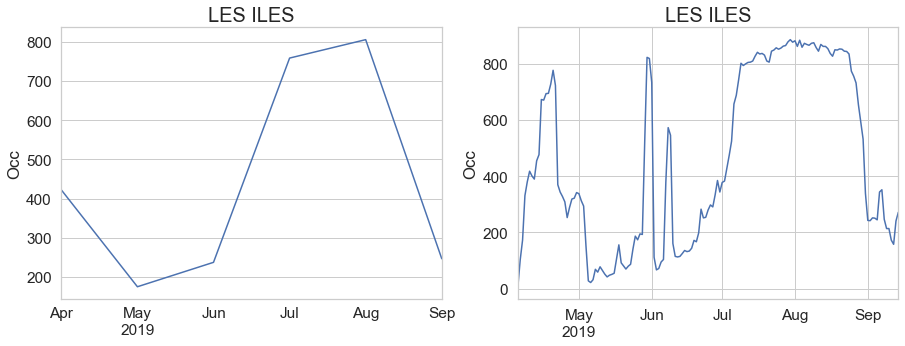

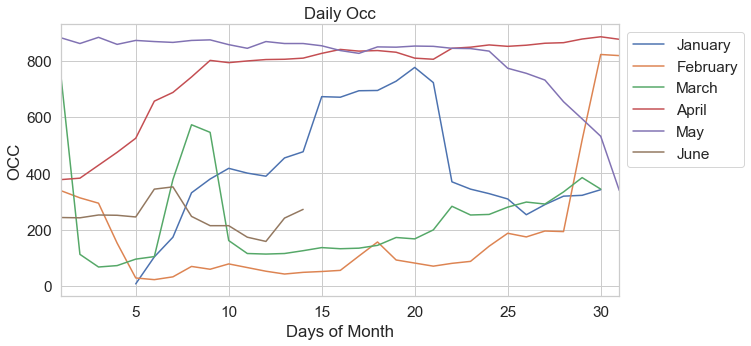

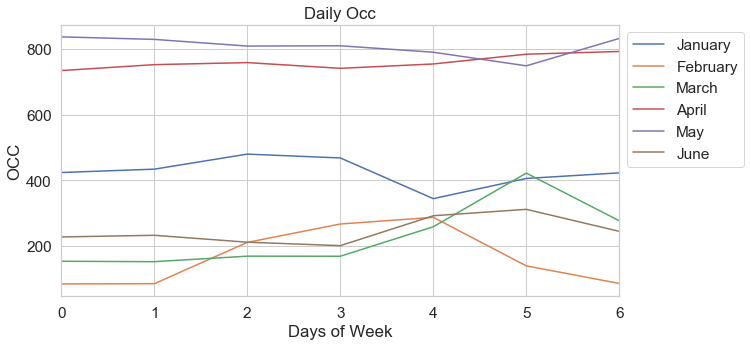

Dates range:
2018-04-21 00:00:00 - 2019-09-14 00:00:00

('X shape: ', (303, 9))
('y shape: ', (303,))
('X_train shape: ', (140, 9))
('X_test shape: ', (163, 9))
('y_train shape: ', (140,))
('y_test shape: ', (163,))
R2:	0.767
RMSE:	22005.48
['VIKINGS', 'CHATEAU DE BOISSON']


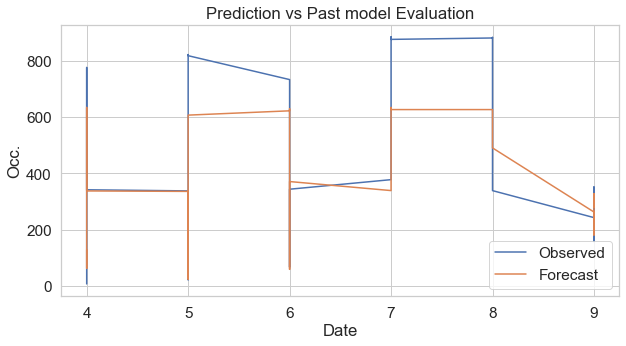

In [539]:
camps = df['camping_label'].unique().tolist()
error = []
for camp in camps:
    try:
        print(f"\n\nTrain TS Analysis On 2018 {camp} Occ.\n\n")
        train = camp_occ_calculator(df_2018, camp)
        plt.show()
        print(f"\n\nTest TS Analysis On 2019 {camp} Occ.\n\n")
        test = camp_occ_calculator(df_2019, camp)
        plt.show()
        predict = run_predicator(train, test, RandomForestRegressor)
    except Exception as e:
        print(f"\n\nError {e} for {camp}\n\n")
        error.append(camp)
print(error)